# ST1504 DEEP LEARNING CA2 PART C
NAME: EDWARD TAN YUAN CHONG

CLASS: DAAA/FT/2B/04

ADM NO.: 2214407

### IMPORT MODULES

In [1]:
# Standard libraries
import os
import time
import warnings
import re

# Data handling
import numpy as np
import pandas as pd
from PIL import Image

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib

# PyTorch basics
import torch
import torch.nn as nn
import torch.optim as optim

# PyTorch helpers for data loading and transforms
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# Metrics and evaluation
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image import InceptionScore
from torchsummary import summary

# Progress bar
from tqdm import tqdm

# Ignore warnings
warnings.filterwarnings('ignore')

### PLOTTING CUSTOMIZATIONS

In [2]:
# Change theme of charts
sns.set_theme(style='darkgrid')
# Change font of charts
sns.set(font='Century Gothic')
# Variable for color palettes
color_palette = sns.color_palette('muted')
# Increase embed limit for animation
matplotlib.rcParams['animation.embed_limit'] = 100

### IMPORT DATA

We only load the first 2000 images of the dataset.

Dataset can be found on Kaggle: https://www.kaggle.com/datasets/spandan2/cats-faces-64x64-for-generative-models/data

In [44]:
class CatImagesDataset(Dataset):
    def __init__(self, directory, transform=None, limit=2000):
        self.directory = directory
        self.transform = transform
        self.image_paths = [os.path.join(directory, fname) for fname in os.listdir(directory) if fname.endswith('.jpg')][:limit]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        with open(img_path, 'rb') as f:
            img = Image.open(f)
            img = img.convert('RGB')
            if self.transform:
                img = self.transform(img)
        return img
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])
cat_dataset = CatImagesDataset('./cat_ca2/cats', transform=transform)

batch_size = 64
cat_dataloader = DataLoader(cat_dataset, batch_size=batch_size, shuffle=True)

images = []
for batch in cat_dataloader:
    images.append(batch)

images = torch.cat(images)

### CONSTANTS

In [47]:
IMAGE_SIZE = images[0].size()[1]
CRITIC_ITERATIONS = 5
WEIGHT_CLIP = 0.01
LR = 2e-4
EPOCHS = 200
nz = 100
ndf = 128
ngf = 128
nc = 3
ngpu = 1
real_label = 1
fake_label = 0
color_palette = sns.color_palette('muted')
device = torch.device('cuda' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')
print('Device used:', device)

Device used: cuda


### VISUALIZE IMAGES

In [48]:
def normalize_images(images):
    normalized_images = [(image + 1) / 2 for image in images]
    return normalized_images


In [49]:
def plot_images(images, rows=2, cols=8):
    fig, axs = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
    axs = axs.ravel()
    for i in range(min(len(images), rows * cols)):
        axs[i].imshow(images[i].permute(1, 2, 0)) 
        axs[i].axis('off')
    plt.show()

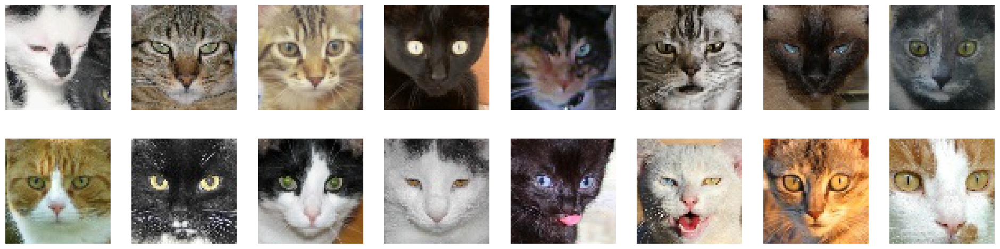

In [50]:
plot_images(normalize_images(images))

### HELPER FUNCTIONS

In [8]:
# Monitor Class for GANs
class GANMonitor:
    def __init__(self, patience=5):
        self.G_losses = []
        self.D_losses = []
        self.fid_scores = []
        self.is_scores = []
        self.best_fid_iter = 0
        self.kl_divergence = None
        self.best_fid = float('inf')
        self.improve = True
 
    def plot_loss(self):
        # Plotting
        plt.figure(figsize=(10,6))
        sns.lineplot(self.G_losses, label='Generator Loss', color=color_palette[2])
        sns.lineplot(self.D_losses, label='Discriminator Loss', color=color_palette[3])
        plt.title('Generator vs Discriminator Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()
    
    @staticmethod
    def transform(tensor):
        tensor = (tensor + 1) / 2  # Rescale to [0, 1]
        return tensor

    def calc_fid(self,real,fake,i):
        fid = FrechetInceptionDistance(feature=2048, normalize=True, reset_real_features=True).to('cuda')
        real_images_norm = self.transform(real.to('cuda'))
        fid.update(real_images_norm, real=True)
        fake_images_norm = self.transform(fake.to('cuda'))
        fid.update(fake_images_norm, real=False)
        fid_score = fid.compute()
        if fid_score < self.best_fid:
            self.best_fid = fid_score
            self.best_fid_iter = i
            self.improve = True
        else:
            self.improve = False
        return fid_score
    
    def calc_is(self,imgs):
        inception = InceptionScore(normalize=True)
        norm_imgs = self.transform(imgs.to('cpu'))
        scaled_imgs = (norm_imgs * 255).clamp(0, 255).to(torch.uint8)
        inception.update(scaled_imgs)
        return inception.compute()
    
    def plot_scores(self):
        # Convert tensors to lists using list comprehension
        fid_scores = [score.item() for score in self.fid_scores]
        inception_scores, standard_deviations = zip(*[(score.item(), std.item()) for score, std in self.is_scores])

        # Print best results
        min_fid = min(fid_scores)
        max_is = max(inception_scores)
        
        # Print results
        print(f"Minimum FID Score of {min_fid} obtained at iteration of {self.best_fid_iter}.")
        print(f"Maximum IS Score of {max_is}.")

        # Create a figure with three subplots
        fig, axes = plt.subplots(1, 3, figsize=(16, 5))

        # Define common properties for line plots
        plot_props = {'marker': 'o', 'linestyle': '-', 'x': range(len(fid_scores))}

        # FID Scores Line Plot
        sns.lineplot(y=fid_scores, color=color_palette[0], ax=axes[0], **plot_props)
        axes[0].set(title="FID Scores", xlabel="Index", ylabel="FID Score")

        # Inception Scores Line Plot
        sns.lineplot(y=inception_scores, label='Inception Score', color=color_palette[1], ax=axes[1], **plot_props)
        axes[1].set(title='Inception Scores', xlabel='Index', ylabel='Inception Score')
        axes[1].legend()
        axes[1].grid(True)

        # Standard Deviations Line Plot
        sns.lineplot(y=standard_deviations, label='Standard Deviation', color=color_palette[2], ax=axes[2], **plot_props)
        axes[2].set(title='Inception Standard Deviations', xlabel='Index', ylabel='Standard Deviation')
        axes[2].legend()
        axes[2].grid(True)

        # Change suptitle
        fig.suptitle(t='Fréchet Inception Distance and Inception Scores')

        # Show the plot
        plt.tight_layout()
        plt.show()

    def save_weights(self,i,netG, critic, filepath):
        if self.improve:
            # Define your desired file path
            model_dir = filepath
            # Check if the directory exists, and create it if it doesn't
            if not os.path.exists(model_dir):
                os.makedirs(model_dir)
            # Save generator and discriminator weights
            torch.save(netG, filepath + f"/generator-{i}.pth")
            torch.save(critic, filepath + f"/critic-{i}.pth")

    def store_print_metrics(self, real, fake,i):
        current_fid_score = self.calc_fid(real=real, fake=fake, i=i)
        current_is_score = self.calc_is(imgs=fake)
        self.fid_scores.append(current_fid_score)
        self.is_scores.append(current_is_score)
        print(f"Current scores at iteration {i} | FID: {current_fid_score} | IS: {current_is_score[0].item()}")


# ============
# |   WGAN   |
# ============

class WGANGenerator(nn.Module):
    def __init__(self):
        super(WGANGenerator, self).__init__()

        self.model = nn.Sequential(
            self._block(nz, ngf * 8, 4, 1, 0),
            self._block(ngf * 8, ngf * 4), 
            self._block(ngf * 4, ngf * 2), 
            self._block(ngf * 2, ngf),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, batch_norm=True):
        layers = [nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=not batch_norm)]
        if batch_norm:
            layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2))

        return nn.Sequential(*layers)
        
    def forward(self, z):
        return self.model(z)
    
# WGAN Critic
class WGANCritic(nn.Module):
    def __init__(self):
        super(WGANCritic, self).__init__()

        self.model = nn.Sequential(
            self._block(nc, ndf, batch_norm=False),
            self._block(ndf, ndf * 2),
            self._block(ndf * 2, ndf * 4),
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, batch_norm=True):
        layers = [nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=not batch_norm)]
        if batch_norm:
            layers.append(nn.BatchNorm2d(out_channels, momentum=0.9))
        layers.append(nn.ReLU(inplace=True))
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

class WGANTrainer(GANMonitor):
    def __init__(self, critic, netG, dataloader, device, fixed_noise, real_label, fake_label, nz, optimizerC, optimizerG, num_epochs, weight_clip, critic_iterations):
        super().__init__()
        self.critic = critic
        self.netG = netG
        self.dataloader = dataloader
        self.device = device
        self.fixed_noise = fixed_noise
        self.real_label = real_label
        self.fake_label = fake_label
        self.nz = nz
        self.optimizerC = optimizerC
        self.optimizerG = optimizerG
        self.num_epochs = num_epochs
        self.weight_clip = weight_clip
        self.critic_iterations = critic_iterations
        self.file_path = "./wgan_weights"
        self.temp_errC = []
        self.iters = 0
        self.img_list = []

    def train(self):
        print("Starting Training Loop...")
        for epoch in tqdm(range(self.num_epochs), desc="Training Progress"):
            for i, data in enumerate(self.dataloader, 0):
                start_time = time.time()
                # Train discriminator
                errC, errG, real, fake = self.train_step(data)
                # Train generator
                end_time = time.time()
                iteration_time = end_time - start_time
                # At every 50 iterations, record current loss of the Generator
                if i % self.critic_iterations == 0:
                    print('[%d/%d][%d/%d] \tLoss_D: %.4f | Loss_G: %.4f | Iteration Time: %.4f sec'
                % (epoch, self.num_epochs, i, len(self.dataloader),
                    errC.item(), errG.item(), iteration_time))
                self.check_generator_progress(epoch, i, real, fake)

    def train_step(self, data):
        # Train critic for n critic iterations
        for _ in range(self.critic_iterations):
            # Reset gradients for Discriminator
            self.critic.zero_grad()
            # Real images
            real = data.to(self.device)
            # Noise
            noise = torch.randn(data.size(0), self.nz, 1, 1, device=self.device)
            # Fake image batch generated with G
            fake_data = self.netG(noise)
            # Forward pass real batch through C
            real_output = self.critic(real).view(-1)
            # Output of C when given fake/generated data
            fake_output = self.critic(fake_data.detach()).view(-1)
            # Calculate loss for C
            errC = -(torch.mean(real_output) - torch.mean(fake_output))
            # Append to temporary array
            self.temp_errC.append(errC)
            # Backpropagate for C
            errC.backward()
            self.optimizerC.step()
            # Weight clipping for C
            for p in self.critic.parameters():
                p.data.clamp_(-self.weight_clip, self.weight_clip)
            
        # Reset gradients for Generator
        self.netG.zero_grad()
        # Since we just updated D, perform another forward pass of fake_data through D
        fake_output = self.critic(fake_data).view(-1)
        # Calculate error for G
        errG = -torch.mean(fake_output)
        # Store generator loss
        self.G_losses.append(errG.item())
        # Store average critic loss
        self.D_losses.append((sum(self.temp_errC)/len(self.temp_errC)).item())
        # Reset temp errC array
        self.temp_errC = []
        # Backpropagate for G
        errG.backward()
        self.optimizerG.step()
        return errC, errG, real, fake_data
    
    def check_generator_progress(self, epoch, i, real, fake):
        if (self.iters % 500 == 0) or ((epoch == self.num_epochs-1) and (i == len(self.dataloader)-1)):
            with torch.no_grad():
                # Calculate, store and print FID and IS score
                self.store_print_metrics(real=real, fake=fake, i=self.iters)
                # Save weights
                self.save_weights(self.iters,self.netG, self.critic, self.file_path)
                # Generate image and create image grid
                fake = self.netG(self.fixed_noise).detach().cpu()
                generated_image = np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1,2,0))
                # Plot image grid
                self.img_list.append(generated_image)
                plt.figure(figsize=(20,6))
                plt.axis("off")
                plt.title(f"Generated Images at {self.iters} iterations")
                plt.imshow(generated_image)
                plt.show()
        self.iters += 1

# ==============
# |   WGAN-GP  |
# ==============
    
class WGANGPGenerator(nn.Module):
    def __init__(self, nz=100, ngf=64, nc=3):
        super(WGANGPGenerator, self).__init__()

        self.model = nn.Sequential(
            self._block(nz, ngf * 8, 4, 1, 0),
            self._block(ngf * 8, ngf * 4), 
            self._block(ngf * 4, ngf * 2), 
            self._block(ngf * 2, ngf),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, batch_norm=True):
        layers = [nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=not batch_norm)]
        if batch_norm:
            layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2))

        return nn.Sequential(*layers)
    
    def forward(self, z):
        return self.model(z)

    
# WGAN Critic
class WGANGPCritic(nn.Module):
    def __init__(self):
        super(WGANGPCritic, self).__init__()

        self.model = nn.Sequential(
            self._block(nc, ndf, batch_norm=False),
            self._block(ndf, ndf * 2),
            self._block(ndf * 2, ndf * 4),
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, batch_norm=True):
        layers = [nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=not batch_norm)]
        if batch_norm:
            layers.append(nn.InstanceNorm2d(out_channels, momentum=0.9))
        layers.append(nn.ReLU(inplace=True))
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)
    
class WGANGPTrainer(GANMonitor):
    def __init__(self, critic, netG, dataloader, device, fixed_noise, real_label, fake_label, nz, optimizerC, optimizerG, num_epochs, critic_iterations, lambda_gp):
        super().__init__()
        self.critic = critic
        self.netG = netG
        self.dataloader = dataloader
        self.device = device
        self.fixed_noise = fixed_noise
        self.real_label = real_label
        self.fake_label = fake_label
        self.nz = nz
        self.optimizerC = optimizerC
        self.optimizerG = optimizerG
        self.num_epochs = num_epochs
        self.critic_iterations = critic_iterations
        self.lambda_gp = lambda_gp
        self.file_path = "./wgan-gp_weights"
        self.temp_errC = []
        self.iters = 0
        self.img_list = []

    def train(self):
        print("Starting Training Loop...")
        for epoch in tqdm(range(self.num_epochs), desc="Training Progress"):
            for i, data in enumerate(self.dataloader, 0):
                start_time = time.time()
                # Train discriminator
                errC, errG, real, fake = self.train_step(data)
                # Train generator
                end_time = time.time()
                iteration_time = end_time - start_time
                # At every 50 iterations, record current loss of the Generator
                if i % self.critic_iterations == 0:
                    print('[%d/%d][%d/%d] \tLoss_D: %.4f | Loss_G: %.4f | Iteration Time: %.4f sec'
                % (epoch, self.num_epochs, i, len(self.dataloader),
                    errC.item(), errG.item(), iteration_time))
                self.check_generator_progress(epoch, i, real, fake)

    def train_step(self, data):
        # Train critic for n critic iterations
        for _ in range(self.critic_iterations):
            # Reset gradients for Discriminator
            self.critic.zero_grad()
            # Real images
            real = data.to(self.device)
            # Noise
            noise = torch.randn(data.size(0), self.nz, 1, 1, device=self.device)
            # Fake image batch generated with G
            fake_data = self.netG(noise)
            # Forward pass real batch through C
            real_output = self.critic(real).view(-1)
            # Output of C when given fake/generated data
            fake_output = self.critic(fake_data.detach()).view(-1)
            # Gradient penalty
            gp = self.gradient_penalty(self.critic, real, fake_data, device=self.device)
            # Calculate loss for C
            errC = (-(torch.mean(real_output) - torch.mean(fake_output)) + self.lambda_gp * gp)
            # Append to temporary array
            self.temp_errC.append(errC)
            # Backpropagate for C
            errC.backward(retain_graph=True)
            self.optimizerC.step()
    
        # Reset gradients for Generator
        self.netG.zero_grad()
        # Since we just updated D, perform another forward pass of fake_data through D
        fake_output = self.critic(fake_data).view(-1)
        # Calculate error for G
        errG = -torch.mean(fake_output)
        # Store generator loss
        self.G_losses.append(errG.item())
        # Store average critic loss
        self.D_losses.append((sum(self.temp_errC)/len(self.temp_errC)).item())
        # Reset temp errC array
        self.temp_errC = []
        # Backpropagate for G
        errG.backward()
        self.optimizerG.step()

        return errC, errG, real, fake_data
    
    def check_generator_progress(self, epoch, i, real, fake):
        if (self.iters % 500 == 0) or ((epoch == self.num_epochs-1) and (i == len(self.dataloader)-1)):
            with torch.no_grad():
                # Calculate, store and print FID and IS score
                self.store_print_metrics(real=real, fake=fake, i=self.iters)
                # Save weights
                self.save_weights(self.iters,self.netG, self.critic, self.file_path)
                # Generate image and create image grid
                fake = self.netG(self.fixed_noise).detach().cpu()
                generated_image = np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1,2,0))
                # Plot image grid
                self.img_list.append(generated_image)
                plt.figure(figsize=(20,6))
                plt.axis("off")
                plt.title(f"Generated Images at {self.iters} iterations")
                plt.imshow(generated_image)
                plt.show()
        self.iters += 1

    @staticmethod
    def gradient_penalty(critic, real, fake, device='cpu'):
        batch_size, C, H, W = real.shape
        epsilon = torch.rand((batch_size, 1, 1, 1)).repeat(1, C, H, W).to(device) # Create interpolated images
        interpolated_images = real * epsilon + fake * (1 - epsilon) # Interpolate real image with fake image

        # Calculate critic score
        mixed_scores = critic(interpolated_images)
        gradient = torch.autograd.grad(
            inputs=interpolated_images,
            outputs=mixed_scores,
            grad_outputs=torch.ones_like(mixed_scores),
            create_graph=True,
            retain_graph=True
        )[0]
        gradient = gradient.view(gradient.shape[0], -1)
        gradient_norm = gradient.norm(2, dim=1)
        gradient_penalty = torch.mean((gradient_norm-1)**2)

        return gradient_penalty

### WGAN

#### GENERATOR

In [9]:
# Create generator
netG = WGANGenerator().to(device=device)
# Print generator
print(netG)

WGANGenerator(
  (model): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_ru

#### CRITIC

In [10]:
# Create Critic
critic = WGANCritic().to(device=device)
# Print critic
print(critic)

WGANCritic(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (4): Sigmoid()
  )
)


#### OPTIMIZERS

In [11]:
# Optimizers
optimizerC = optim.RMSprop(critic.parameters(), lr=LR, alpha=0.9)
optimizerG = optim.RMSprop(netG.parameters(), lr=LR, alpha=0.9)
# Fixed noise (latent vectors)
fixed_noise = torch.randn(IMAGE_SIZE, nz, 1, 1, device=device)

#### TRAINING

Starting Training Loop...


Training Progress:   0%|          | 0/200 [00:00<?, ?it/s]

[0/200][0/32] 	Loss_D: -0.0061 | Loss_G: -0.4950 | Iteration Time: 0.8203 sec
Current scores at iteration 0 | FID: 399.6596374511719 | IS: 1.0986696481704712


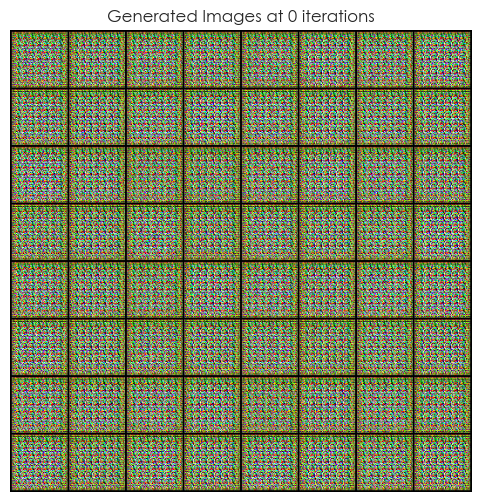

[0/200][5/32] 	Loss_D: -0.0355 | Loss_G: -0.4774 | Iteration Time: 0.0926 sec
[0/200][10/32] 	Loss_D: -0.0771 | Loss_G: -0.4552 | Iteration Time: 0.0915 sec
[0/200][15/32] 	Loss_D: -0.1251 | Loss_G: -0.4448 | Iteration Time: 0.0910 sec
[0/200][20/32] 	Loss_D: -0.1483 | Loss_G: -0.4428 | Iteration Time: 0.0895 sec
[0/200][25/32] 	Loss_D: -0.1391 | Loss_G: -0.4183 | Iteration Time: 0.0880 sec


Training Progress:   0%|          | 1/200 [00:10<34:12, 10.32s/it]

[0/200][30/32] 	Loss_D: -0.1369 | Loss_G: -0.4088 | Iteration Time: 0.0905 sec
[1/200][0/32] 	Loss_D: -0.1676 | Loss_G: -0.4215 | Iteration Time: 0.0890 sec
[1/200][5/32] 	Loss_D: -0.1389 | Loss_G: -0.4075 | Iteration Time: 0.0890 sec
[1/200][10/32] 	Loss_D: -0.1614 | Loss_G: -0.4085 | Iteration Time: 0.0890 sec
[1/200][15/32] 	Loss_D: -0.1779 | Loss_G: -0.4080 | Iteration Time: 0.0895 sec
[1/200][20/32] 	Loss_D: -0.1684 | Loss_G: -0.4107 | Iteration Time: 0.0905 sec
[1/200][25/32] 	Loss_D: -0.1813 | Loss_G: -0.4132 | Iteration Time: 0.0900 sec


Training Progress:   1%|          | 2/200 [00:14<21:25,  6.49s/it]

[1/200][30/32] 	Loss_D: -0.1916 | Loss_G: -0.4038 | Iteration Time: 0.0890 sec
[2/200][0/32] 	Loss_D: -0.1625 | Loss_G: -0.4080 | Iteration Time: 0.0895 sec
[2/200][5/32] 	Loss_D: -0.1826 | Loss_G: -0.4075 | Iteration Time: 0.0885 sec
[2/200][10/32] 	Loss_D: -0.1810 | Loss_G: -0.4110 | Iteration Time: 0.0915 sec
[2/200][15/32] 	Loss_D: -0.0916 | Loss_G: -0.4696 | Iteration Time: 0.0930 sec
[2/200][20/32] 	Loss_D: -0.1654 | Loss_G: -0.4080 | Iteration Time: 0.0900 sec
[2/200][25/32] 	Loss_D: -0.1647 | Loss_G: -0.4103 | Iteration Time: 0.0895 sec


Training Progress:   2%|▏         | 3/200 [00:17<17:19,  5.28s/it]

[2/200][30/32] 	Loss_D: -0.1698 | Loss_G: -0.4166 | Iteration Time: 0.0857 sec
[3/200][0/32] 	Loss_D: -0.1822 | Loss_G: -0.4110 | Iteration Time: 0.0900 sec
[3/200][5/32] 	Loss_D: -0.1496 | Loss_G: -0.4056 | Iteration Time: 0.0905 sec
[3/200][10/32] 	Loss_D: -0.1800 | Loss_G: -0.4053 | Iteration Time: 0.0895 sec
[3/200][15/32] 	Loss_D: -0.1468 | Loss_G: -0.4034 | Iteration Time: 0.0895 sec
[3/200][20/32] 	Loss_D: -0.1724 | Loss_G: -0.4093 | Iteration Time: 0.0890 sec
[3/200][25/32] 	Loss_D: -0.1794 | Loss_G: -0.4135 | Iteration Time: 0.0910 sec


Training Progress:   2%|▏         | 4/200 [00:21<15:22,  4.70s/it]

[3/200][30/32] 	Loss_D: -0.1670 | Loss_G: -0.4147 | Iteration Time: 0.0905 sec
[4/200][0/32] 	Loss_D: -0.1908 | Loss_G: -0.4041 | Iteration Time: 0.0915 sec
[4/200][5/32] 	Loss_D: -0.1953 | Loss_G: -0.4027 | Iteration Time: 0.0894 sec
[4/200][10/32] 	Loss_D: -0.1886 | Loss_G: -0.4071 | Iteration Time: 0.0910 sec
[4/200][15/32] 	Loss_D: -0.1660 | Loss_G: -0.4198 | Iteration Time: 0.0895 sec
[4/200][20/32] 	Loss_D: -0.1114 | Loss_G: -0.4598 | Iteration Time: 0.0895 sec
[4/200][25/32] 	Loss_D: -0.1390 | Loss_G: -0.4411 | Iteration Time: 0.0960 sec


Training Progress:   2%|▎         | 5/200 [00:25<14:19,  4.41s/it]

[4/200][30/32] 	Loss_D: -0.1584 | Loss_G: -0.4139 | Iteration Time: 0.0920 sec
[5/200][0/32] 	Loss_D: -0.0824 | Loss_G: -0.4792 | Iteration Time: 0.0920 sec
[5/200][5/32] 	Loss_D: -0.1507 | Loss_G: -0.4125 | Iteration Time: 0.0890 sec
[5/200][10/32] 	Loss_D: -0.1320 | Loss_G: -0.4096 | Iteration Time: 0.0895 sec
[5/200][15/32] 	Loss_D: -0.1489 | Loss_G: -0.4092 | Iteration Time: 0.0900 sec
[5/200][20/32] 	Loss_D: -0.1810 | Loss_G: -0.4073 | Iteration Time: 0.0930 sec
[5/200][25/32] 	Loss_D: -0.1939 | Loss_G: -0.4013 | Iteration Time: 0.0920 sec


Training Progress:   3%|▎         | 6/200 [00:29<13:42,  4.24s/it]

[5/200][30/32] 	Loss_D: -0.1260 | Loss_G: -0.4039 | Iteration Time: 0.0960 sec
[6/200][0/32] 	Loss_D: -0.1714 | Loss_G: -0.4112 | Iteration Time: 0.0980 sec
[6/200][5/32] 	Loss_D: -0.1717 | Loss_G: -0.4039 | Iteration Time: 0.0975 sec
[6/200][10/32] 	Loss_D: -0.1860 | Loss_G: -0.4061 | Iteration Time: 0.1240 sec
[6/200][15/32] 	Loss_D: -0.1920 | Loss_G: -0.4048 | Iteration Time: 0.1225 sec
[6/200][20/32] 	Loss_D: -0.1731 | Loss_G: -0.4017 | Iteration Time: 0.1430 sec
[6/200][25/32] 	Loss_D: -0.1674 | Loss_G: -0.4291 | Iteration Time: 0.1470 sec


Training Progress:   4%|▎         | 7/200 [00:34<14:29,  4.50s/it]

[6/200][30/32] 	Loss_D: -0.1190 | Loss_G: -0.4553 | Iteration Time: 0.1425 sec
[7/200][0/32] 	Loss_D: -0.1846 | Loss_G: -0.4096 | Iteration Time: 0.1594 sec
[7/200][5/32] 	Loss_D: -0.1012 | Loss_G: -0.4704 | Iteration Time: 0.1425 sec
[7/200][10/32] 	Loss_D: -0.1240 | Loss_G: -0.4018 | Iteration Time: 0.1485 sec
[7/200][15/32] 	Loss_D: -0.1407 | Loss_G: -0.4041 | Iteration Time: 0.1465 sec
[7/200][20/32] 	Loss_D: -0.1814 | Loss_G: -0.4047 | Iteration Time: 0.1485 sec
[7/200][25/32] 	Loss_D: -0.1868 | Loss_G: -0.4075 | Iteration Time: 0.1436 sec


Training Progress:   4%|▍         | 8/200 [00:40<15:36,  4.88s/it]

[7/200][30/32] 	Loss_D: -0.1759 | Loss_G: -0.4122 | Iteration Time: 0.1474 sec
[8/200][0/32] 	Loss_D: -0.1861 | Loss_G: -0.4060 | Iteration Time: 0.1480 sec
[8/200][5/32] 	Loss_D: -0.1984 | Loss_G: -0.4018 | Iteration Time: 0.1435 sec
[8/200][10/32] 	Loss_D: -0.1305 | Loss_G: -0.4062 | Iteration Time: 0.1450 sec
[8/200][15/32] 	Loss_D: -0.1596 | Loss_G: -0.4129 | Iteration Time: 0.1455 sec
[8/200][20/32] 	Loss_D: -0.1127 | Loss_G: -0.4690 | Iteration Time: 0.1450 sec
[8/200][25/32] 	Loss_D: -0.1211 | Loss_G: -0.4085 | Iteration Time: 0.1440 sec


Training Progress:   4%|▍         | 9/200 [00:45<16:18,  5.12s/it]

[8/200][30/32] 	Loss_D: -0.1634 | Loss_G: -0.4065 | Iteration Time: 0.1445 sec
[9/200][0/32] 	Loss_D: -0.1942 | Loss_G: -0.4026 | Iteration Time: 0.1490 sec
[9/200][5/32] 	Loss_D: -0.1846 | Loss_G: -0.4072 | Iteration Time: 0.1445 sec
[9/200][10/32] 	Loss_D: -0.1217 | Loss_G: -0.4173 | Iteration Time: 0.1433 sec
[9/200][15/32] 	Loss_D: -0.0614 | Loss_G: -0.4365 | Iteration Time: 0.1452 sec
[9/200][20/32] 	Loss_D: -0.1290 | Loss_G: -0.4080 | Iteration Time: 0.1435 sec
[9/200][25/32] 	Loss_D: -0.1917 | Loss_G: -0.4073 | Iteration Time: 0.1445 sec


Training Progress:   5%|▌         | 10/200 [00:51<16:46,  5.30s/it]

[9/200][30/32] 	Loss_D: -0.1980 | Loss_G: -0.4027 | Iteration Time: 0.1440 sec
[10/200][0/32] 	Loss_D: -0.0153 | Loss_G: -0.4066 | Iteration Time: 0.1660 sec
[10/200][5/32] 	Loss_D: -0.1927 | Loss_G: -0.4033 | Iteration Time: 0.1425 sec
[10/200][10/32] 	Loss_D: -0.0726 | Loss_G: -0.4442 | Iteration Time: 0.1440 sec
[10/200][15/32] 	Loss_D: -0.1633 | Loss_G: -0.4118 | Iteration Time: 0.1440 sec
[10/200][20/32] 	Loss_D: -0.0835 | Loss_G: -0.4610 | Iteration Time: 0.1466 sec
[10/200][25/32] 	Loss_D: -0.1793 | Loss_G: -0.4150 | Iteration Time: 0.1455 sec


Training Progress:   6%|▌         | 11/200 [00:57<17:03,  5.42s/it]

[10/200][30/32] 	Loss_D: -0.1700 | Loss_G: -0.4075 | Iteration Time: 0.1455 sec
[11/200][0/32] 	Loss_D: -0.0923 | Loss_G: -0.4736 | Iteration Time: 0.1515 sec
[11/200][5/32] 	Loss_D: -0.1916 | Loss_G: -0.4036 | Iteration Time: 0.1525 sec
[11/200][10/32] 	Loss_D: -0.0929 | Loss_G: -0.4559 | Iteration Time: 0.1451 sec
[11/200][15/32] 	Loss_D: -0.1470 | Loss_G: -0.4225 | Iteration Time: 0.1505 sec
[11/200][20/32] 	Loss_D: -0.1461 | Loss_G: -0.4114 | Iteration Time: 0.1460 sec
[11/200][25/32] 	Loss_D: -0.1790 | Loss_G: -0.4092 | Iteration Time: 0.1455 sec


Training Progress:   6%|▌         | 12/200 [01:03<17:13,  5.50s/it]

[11/200][30/32] 	Loss_D: -0.1562 | Loss_G: -0.4044 | Iteration Time: 0.1435 sec
[12/200][0/32] 	Loss_D: -0.0929 | Loss_G: -0.4146 | Iteration Time: 0.1560 sec
[12/200][5/32] 	Loss_D: -0.1065 | Loss_G: -0.4720 | Iteration Time: 0.1410 sec
[12/200][10/32] 	Loss_D: -0.0950 | Loss_G: -0.4536 | Iteration Time: 0.1435 sec
[12/200][15/32] 	Loss_D: -0.1709 | Loss_G: -0.4204 | Iteration Time: 0.1440 sec
[12/200][20/32] 	Loss_D: -0.1226 | Loss_G: -0.4042 | Iteration Time: 0.1465 sec
[12/200][25/32] 	Loss_D: -0.1816 | Loss_G: -0.4056 | Iteration Time: 0.1445 sec


Training Progress:   6%|▋         | 13/200 [01:08<17:15,  5.54s/it]

[12/200][30/32] 	Loss_D: -0.1481 | Loss_G: -0.4148 | Iteration Time: 0.1440 sec
[13/200][0/32] 	Loss_D: -0.1060 | Loss_G: -0.4132 | Iteration Time: 0.1640 sec
[13/200][5/32] 	Loss_D: -0.0851 | Loss_G: -0.4533 | Iteration Time: 0.1410 sec
[13/200][10/32] 	Loss_D: -0.1341 | Loss_G: -0.4155 | Iteration Time: 0.1460 sec
[13/200][15/32] 	Loss_D: -0.1659 | Loss_G: -0.4013 | Iteration Time: 0.1435 sec
[13/200][20/32] 	Loss_D: -0.1120 | Loss_G: -0.4130 | Iteration Time: 0.1475 sec
[13/200][25/32] 	Loss_D: -0.1060 | Loss_G: -0.4884 | Iteration Time: 0.1470 sec


Training Progress:   7%|▋         | 14/200 [01:14<17:18,  5.58s/it]

[13/200][30/32] 	Loss_D: -0.1708 | Loss_G: -0.4094 | Iteration Time: 0.1450 sec
[14/200][0/32] 	Loss_D: -0.0454 | Loss_G: -0.4342 | Iteration Time: 0.1470 sec
[14/200][5/32] 	Loss_D: -0.1535 | Loss_G: -0.4328 | Iteration Time: 0.1480 sec
[14/200][10/32] 	Loss_D: -0.1658 | Loss_G: -0.4135 | Iteration Time: 0.1430 sec
[14/200][15/32] 	Loss_D: -0.1126 | Loss_G: -0.4669 | Iteration Time: 0.1465 sec
[14/200][20/32] 	Loss_D: -0.0254 | Loss_G: -0.4080 | Iteration Time: 0.1420 sec
[14/200][25/32] 	Loss_D: -0.0904 | Loss_G: -0.4118 | Iteration Time: 0.1490 sec


Training Progress:   8%|▊         | 15/200 [01:19<17:16,  5.60s/it]

[14/200][30/32] 	Loss_D: -0.0563 | Loss_G: -0.4447 | Iteration Time: 0.1415 sec
[15/200][0/32] 	Loss_D: -0.1169 | Loss_G: -0.5044 | Iteration Time: 0.1545 sec
[15/200][5/32] 	Loss_D: -0.0732 | Loss_G: -0.4147 | Iteration Time: 0.1415 sec
[15/200][10/32] 	Loss_D: -0.1519 | Loss_G: -0.4331 | Iteration Time: 0.1411 sec
[15/200][15/32] 	Loss_D: -0.1455 | Loss_G: -0.4149 | Iteration Time: 0.1450 sec
[15/200][20/32] 	Loss_D: -0.1094 | Loss_G: -0.4170 | Iteration Time: 0.1430 sec
Current scores at iteration 500 | FID: 316.298095703125 | IS: 1.9010511636734009


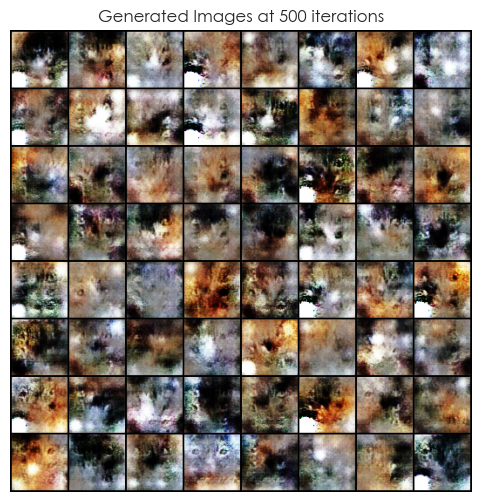

[15/200][25/32] 	Loss_D: -0.0853 | Loss_G: -0.4914 | Iteration Time: 0.1400 sec


Training Progress:   8%|▊         | 16/200 [01:30<22:09,  7.22s/it]

[15/200][30/32] 	Loss_D: -0.1873 | Loss_G: -0.4055 | Iteration Time: 0.1430 sec
[16/200][0/32] 	Loss_D: -0.1345 | Loss_G: -0.4091 | Iteration Time: 0.1525 sec
[16/200][5/32] 	Loss_D: -0.0589 | Loss_G: -0.4501 | Iteration Time: 0.1410 sec
[16/200][10/32] 	Loss_D: -0.1495 | Loss_G: -0.4212 | Iteration Time: 0.1467 sec
[16/200][15/32] 	Loss_D: -0.1256 | Loss_G: -0.4179 | Iteration Time: 0.1445 sec
[16/200][20/32] 	Loss_D: -0.1570 | Loss_G: -0.4438 | Iteration Time: 0.1445 sec
[16/200][25/32] 	Loss_D: -0.1389 | Loss_G: -0.4069 | Iteration Time: 0.1430 sec


Training Progress:   8%|▊         | 17/200 [01:36<20:35,  6.75s/it]

[16/200][30/32] 	Loss_D: -0.1859 | Loss_G: -0.4032 | Iteration Time: 0.1445 sec
[17/200][0/32] 	Loss_D: -0.1218 | Loss_G: -0.5183 | Iteration Time: 0.1605 sec
[17/200][5/32] 	Loss_D: -0.0872 | Loss_G: -0.5126 | Iteration Time: 0.1460 sec
[17/200][10/32] 	Loss_D: -0.1380 | Loss_G: -0.4197 | Iteration Time: 0.1490 sec
[17/200][15/32] 	Loss_D: -0.1151 | Loss_G: -0.4594 | Iteration Time: 0.1455 sec
[17/200][20/32] 	Loss_D: -0.1512 | Loss_G: -0.4098 | Iteration Time: 0.1445 sec
[17/200][25/32] 	Loss_D: -0.1041 | Loss_G: -0.4704 | Iteration Time: 0.1455 sec


Training Progress:   9%|▉         | 18/200 [01:42<19:29,  6.42s/it]

[17/200][30/32] 	Loss_D: -0.1132 | Loss_G: -0.4197 | Iteration Time: 0.1485 sec
[18/200][0/32] 	Loss_D: -0.1228 | Loss_G: -0.4175 | Iteration Time: 0.1430 sec
[18/200][5/32] 	Loss_D: -0.1596 | Loss_G: -0.4294 | Iteration Time: 0.1440 sec
[18/200][10/32] 	Loss_D: -0.1441 | Loss_G: -0.4239 | Iteration Time: 0.1455 sec
[18/200][15/32] 	Loss_D: -0.1643 | Loss_G: -0.4130 | Iteration Time: 0.1439 sec
[18/200][20/32] 	Loss_D: -0.1116 | Loss_G: -0.4150 | Iteration Time: 0.1416 sec
[18/200][25/32] 	Loss_D: -0.1741 | Loss_G: -0.4082 | Iteration Time: 0.1430 sec


Training Progress:  10%|▉         | 19/200 [01:47<18:38,  6.18s/it]

[18/200][30/32] 	Loss_D: -0.0650 | Loss_G: -0.4448 | Iteration Time: 0.1430 sec
[19/200][0/32] 	Loss_D: -0.1027 | Loss_G: -0.4558 | Iteration Time: 0.1500 sec
[19/200][5/32] 	Loss_D: -0.1180 | Loss_G: -0.4095 | Iteration Time: 0.1465 sec
[19/200][10/32] 	Loss_D: -0.1583 | Loss_G: -0.4159 | Iteration Time: 0.1430 sec
[19/200][15/32] 	Loss_D: -0.0911 | Loss_G: -0.4786 | Iteration Time: 0.1485 sec
[19/200][20/32] 	Loss_D: -0.1560 | Loss_G: -0.4109 | Iteration Time: 0.1450 sec
[19/200][25/32] 	Loss_D: -0.0896 | Loss_G: -0.4507 | Iteration Time: 0.1440 sec


Training Progress:  10%|█         | 20/200 [01:53<18:02,  6.01s/it]

[19/200][30/32] 	Loss_D: -0.0692 | Loss_G: -0.4592 | Iteration Time: 0.1445 sec
[20/200][0/32] 	Loss_D: -0.0784 | Loss_G: -0.4926 | Iteration Time: 0.1485 sec
[20/200][5/32] 	Loss_D: -0.1366 | Loss_G: -0.4069 | Iteration Time: 0.1465 sec
[20/200][10/32] 	Loss_D: -0.1152 | Loss_G: -0.4087 | Iteration Time: 0.1450 sec
[20/200][15/32] 	Loss_D: -0.1185 | Loss_G: -0.4182 | Iteration Time: 0.1445 sec
[20/200][20/32] 	Loss_D: -0.1028 | Loss_G: -0.4921 | Iteration Time: 0.1440 sec
[20/200][25/32] 	Loss_D: -0.1063 | Loss_G: -0.4147 | Iteration Time: 0.1435 sec


Training Progress:  10%|█         | 21/200 [01:59<17:33,  5.89s/it]

[20/200][30/32] 	Loss_D: -0.1275 | Loss_G: -0.4221 | Iteration Time: 0.1435 sec
[21/200][0/32] 	Loss_D: -0.1474 | Loss_G: -0.4107 | Iteration Time: 0.1490 sec
[21/200][5/32] 	Loss_D: -0.0379 | Loss_G: -0.4259 | Iteration Time: 0.1430 sec
[21/200][10/32] 	Loss_D: -0.1134 | Loss_G: -0.4069 | Iteration Time: 0.1430 sec
[21/200][15/32] 	Loss_D: -0.1169 | Loss_G: -0.4743 | Iteration Time: 0.1505 sec
[21/200][20/32] 	Loss_D: -0.1559 | Loss_G: -0.4361 | Iteration Time: 0.1445 sec
[21/200][25/32] 	Loss_D: -0.1244 | Loss_G: -0.4139 | Iteration Time: 0.1447 sec


Training Progress:  11%|█         | 22/200 [02:04<17:13,  5.81s/it]

[21/200][30/32] 	Loss_D: -0.1288 | Loss_G: -0.4591 | Iteration Time: 0.1430 sec
[22/200][0/32] 	Loss_D: -0.1239 | Loss_G: -0.4616 | Iteration Time: 0.1515 sec
[22/200][5/32] 	Loss_D: -0.1204 | Loss_G: -0.4086 | Iteration Time: 0.1405 sec
[22/200][10/32] 	Loss_D: -0.1080 | Loss_G: -0.4444 | Iteration Time: 0.1423 sec
[22/200][15/32] 	Loss_D: -0.0910 | Loss_G: -0.4514 | Iteration Time: 0.1460 sec
[22/200][20/32] 	Loss_D: -0.1312 | Loss_G: -0.4184 | Iteration Time: 0.1445 sec
[22/200][25/32] 	Loss_D: -0.0949 | Loss_G: -0.4148 | Iteration Time: 0.1450 sec


Training Progress:  12%|█▏        | 23/200 [02:10<16:55,  5.74s/it]

[22/200][30/32] 	Loss_D: -0.1316 | Loss_G: -0.4058 | Iteration Time: 0.1425 sec
[23/200][0/32] 	Loss_D: -0.0723 | Loss_G: -0.4202 | Iteration Time: 0.1480 sec
[23/200][5/32] 	Loss_D: -0.1239 | Loss_G: -0.4486 | Iteration Time: 0.1435 sec
[23/200][10/32] 	Loss_D: -0.1149 | Loss_G: -0.4697 | Iteration Time: 0.1440 sec
[23/200][15/32] 	Loss_D: -0.1434 | Loss_G: -0.4158 | Iteration Time: 0.1450 sec
[23/200][20/32] 	Loss_D: -0.0511 | Loss_G: -0.4440 | Iteration Time: 0.1453 sec
[23/200][25/32] 	Loss_D: -0.1158 | Loss_G: -0.4146 | Iteration Time: 0.1415 sec


Training Progress:  12%|█▏        | 24/200 [02:15<16:42,  5.69s/it]

[23/200][30/32] 	Loss_D: -0.1261 | Loss_G: -0.4105 | Iteration Time: 0.1435 sec
[24/200][0/32] 	Loss_D: -0.1284 | Loss_G: -0.4101 | Iteration Time: 0.1490 sec
[24/200][5/32] 	Loss_D: -0.0931 | Loss_G: -0.4126 | Iteration Time: 0.1500 sec
[24/200][10/32] 	Loss_D: -0.1099 | Loss_G: -0.4150 | Iteration Time: 0.1440 sec
[24/200][15/32] 	Loss_D: -0.1027 | Loss_G: -0.4753 | Iteration Time: 0.1450 sec
[24/200][20/32] 	Loss_D: -0.1146 | Loss_G: -0.4614 | Iteration Time: 0.1405 sec
[24/200][25/32] 	Loss_D: -0.1166 | Loss_G: -0.4242 | Iteration Time: 0.1444 sec


Training Progress:  12%|█▎        | 25/200 [02:21<16:30,  5.66s/it]

[24/200][30/32] 	Loss_D: -0.1083 | Loss_G: -0.4726 | Iteration Time: 0.1415 sec
[25/200][0/32] 	Loss_D: -0.1450 | Loss_G: -0.4440 | Iteration Time: 0.1505 sec
[25/200][5/32] 	Loss_D: -0.1385 | Loss_G: -0.4213 | Iteration Time: 0.1435 sec
[25/200][10/32] 	Loss_D: -0.1039 | Loss_G: -0.4134 | Iteration Time: 0.1435 sec
[25/200][15/32] 	Loss_D: -0.1245 | Loss_G: -0.4930 | Iteration Time: 0.1430 sec
[25/200][20/32] 	Loss_D: -0.1286 | Loss_G: -0.4384 | Iteration Time: 0.1440 sec
[25/200][25/32] 	Loss_D: -0.1123 | Loss_G: -0.4562 | Iteration Time: 0.1425 sec


Training Progress:  13%|█▎        | 26/200 [02:27<16:21,  5.64s/it]

[25/200][30/32] 	Loss_D: -0.0806 | Loss_G: -0.4207 | Iteration Time: 0.1445 sec
[26/200][0/32] 	Loss_D: -0.0880 | Loss_G: -0.4179 | Iteration Time: 0.1510 sec
[26/200][5/32] 	Loss_D: -0.0932 | Loss_G: -0.4137 | Iteration Time: 0.1440 sec
[26/200][10/32] 	Loss_D: -0.1093 | Loss_G: -0.4503 | Iteration Time: 0.1435 sec
[26/200][15/32] 	Loss_D: -0.1112 | Loss_G: -0.4090 | Iteration Time: 0.1445 sec
[26/200][20/32] 	Loss_D: -0.1081 | Loss_G: -0.4411 | Iteration Time: 0.1440 sec
[26/200][25/32] 	Loss_D: -0.0918 | Loss_G: -0.4812 | Iteration Time: 0.1440 sec


Training Progress:  14%|█▎        | 27/200 [02:32<16:13,  5.63s/it]

[26/200][30/32] 	Loss_D: -0.1211 | Loss_G: -0.4332 | Iteration Time: 0.1422 sec
[27/200][0/32] 	Loss_D: -0.1023 | Loss_G: -0.4743 | Iteration Time: 0.1491 sec
[27/200][5/32] 	Loss_D: -0.1169 | Loss_G: -0.4690 | Iteration Time: 0.1470 sec
[27/200][10/32] 	Loss_D: -0.0857 | Loss_G: -0.4785 | Iteration Time: 0.1445 sec
[27/200][15/32] 	Loss_D: -0.1115 | Loss_G: -0.4180 | Iteration Time: 0.1435 sec
[27/200][20/32] 	Loss_D: -0.0997 | Loss_G: -0.4133 | Iteration Time: 0.1440 sec
[27/200][25/32] 	Loss_D: -0.0809 | Loss_G: -0.4624 | Iteration Time: 0.1445 sec


Training Progress:  14%|█▍        | 28/200 [02:38<16:07,  5.63s/it]

[27/200][30/32] 	Loss_D: -0.1052 | Loss_G: -0.4774 | Iteration Time: 0.1443 sec
[28/200][0/32] 	Loss_D: -0.1003 | Loss_G: -0.4564 | Iteration Time: 0.1470 sec
[28/200][5/32] 	Loss_D: -0.1018 | Loss_G: -0.4789 | Iteration Time: 0.1440 sec
[28/200][10/32] 	Loss_D: -0.0930 | Loss_G: -0.4208 | Iteration Time: 0.1415 sec
[28/200][15/32] 	Loss_D: -0.1102 | Loss_G: -0.4119 | Iteration Time: 0.1450 sec
[28/200][20/32] 	Loss_D: -0.1066 | Loss_G: -0.4120 | Iteration Time: 0.1430 sec
[28/200][25/32] 	Loss_D: -0.1047 | Loss_G: -0.4600 | Iteration Time: 0.1450 sec


Training Progress:  14%|█▍        | 29/200 [02:43<15:59,  5.61s/it]

[28/200][30/32] 	Loss_D: -0.1177 | Loss_G: -0.4123 | Iteration Time: 0.1500 sec
[29/200][0/32] 	Loss_D: -0.1124 | Loss_G: -0.4134 | Iteration Time: 0.1460 sec
[29/200][5/32] 	Loss_D: -0.0980 | Loss_G: -0.4620 | Iteration Time: 0.1460 sec
[29/200][10/32] 	Loss_D: -0.1322 | Loss_G: -0.4139 | Iteration Time: 0.1450 sec
[29/200][15/32] 	Loss_D: -0.1264 | Loss_G: -0.4121 | Iteration Time: 0.1420 sec
[29/200][20/32] 	Loss_D: -0.0587 | Loss_G: -0.4444 | Iteration Time: 0.1435 sec
[29/200][25/32] 	Loss_D: -0.1133 | Loss_G: -0.4355 | Iteration Time: 0.1391 sec


Training Progress:  15%|█▌        | 30/200 [02:49<15:52,  5.60s/it]

[29/200][30/32] 	Loss_D: -0.0664 | Loss_G: -0.4154 | Iteration Time: 0.1460 sec
[30/200][0/32] 	Loss_D: -0.1064 | Loss_G: -0.4100 | Iteration Time: 0.1440 sec
[30/200][5/32] 	Loss_D: -0.0840 | Loss_G: -0.4801 | Iteration Time: 0.1416 sec
[30/200][10/32] 	Loss_D: -0.1324 | Loss_G: -0.4422 | Iteration Time: 0.1409 sec
[30/200][15/32] 	Loss_D: -0.1052 | Loss_G: -0.4517 | Iteration Time: 0.1438 sec
[30/200][20/32] 	Loss_D: -0.0590 | Loss_G: -0.4825 | Iteration Time: 0.1505 sec
[30/200][25/32] 	Loss_D: -0.1010 | Loss_G: -0.4077 | Iteration Time: 0.1435 sec


Training Progress:  16%|█▌        | 31/200 [02:55<15:45,  5.59s/it]

[30/200][30/32] 	Loss_D: -0.1350 | Loss_G: -0.4297 | Iteration Time: 0.1435 sec
[31/200][0/32] 	Loss_D: -0.1302 | Loss_G: -0.4071 | Iteration Time: 0.1475 sec
[31/200][5/32] 	Loss_D: -0.0946 | Loss_G: -0.4834 | Iteration Time: 0.1440 sec
Current scores at iteration 1000 | FID: 300.595458984375 | IS: 2.152280330657959


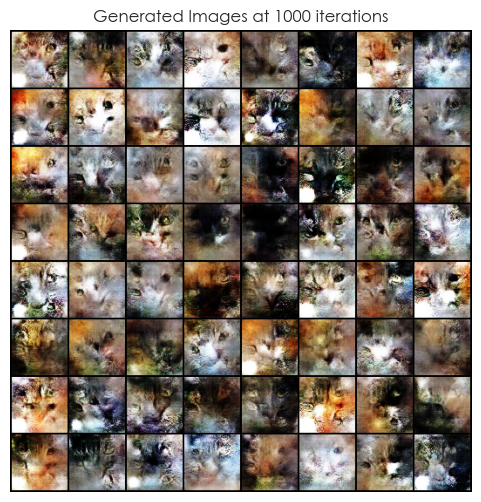

[31/200][10/32] 	Loss_D: -0.0760 | Loss_G: -0.4654 | Iteration Time: 0.1420 sec
[31/200][15/32] 	Loss_D: -0.0789 | Loss_G: -0.4203 | Iteration Time: 0.1420 sec
[31/200][20/32] 	Loss_D: -0.1160 | Loss_G: -0.4095 | Iteration Time: 0.1405 sec
[31/200][25/32] 	Loss_D: -0.1083 | Loss_G: -0.4276 | Iteration Time: 0.1600 sec


Training Progress:  16%|█▌        | 32/200 [03:05<20:08,  7.19s/it]

[31/200][30/32] 	Loss_D: -0.0804 | Loss_G: -0.4237 | Iteration Time: 0.1405 sec
[32/200][0/32] 	Loss_D: -0.0721 | Loss_G: -0.4259 | Iteration Time: 0.1525 sec
[32/200][5/32] 	Loss_D: -0.0812 | Loss_G: -0.4779 | Iteration Time: 0.1395 sec
[32/200][10/32] 	Loss_D: -0.1007 | Loss_G: -0.4195 | Iteration Time: 0.1415 sec
[32/200][15/32] 	Loss_D: -0.1116 | Loss_G: -0.4888 | Iteration Time: 0.1425 sec
[32/200][20/32] 	Loss_D: -0.0920 | Loss_G: -0.4757 | Iteration Time: 0.1450 sec
[32/200][25/32] 	Loss_D: -0.1301 | Loss_G: -0.4289 | Iteration Time: 0.1475 sec


Training Progress:  16%|█▋        | 33/200 [03:11<18:39,  6.71s/it]

[32/200][30/32] 	Loss_D: -0.0940 | Loss_G: -0.4206 | Iteration Time: 0.1425 sec
[33/200][0/32] 	Loss_D: -0.1153 | Loss_G: -0.4114 | Iteration Time: 0.1475 sec
[33/200][5/32] 	Loss_D: -0.1078 | Loss_G: -0.4426 | Iteration Time: 0.1415 sec
[33/200][10/32] 	Loss_D: -0.0832 | Loss_G: -0.4987 | Iteration Time: 0.1430 sec
[33/200][15/32] 	Loss_D: -0.1041 | Loss_G: -0.4077 | Iteration Time: 0.1450 sec
[33/200][20/32] 	Loss_D: -0.1018 | Loss_G: -0.4074 | Iteration Time: 0.1445 sec
[33/200][25/32] 	Loss_D: -0.1037 | Loss_G: -0.4802 | Iteration Time: 0.1420 sec


Training Progress:  17%|█▋        | 34/200 [03:17<17:32,  6.34s/it]

[33/200][30/32] 	Loss_D: -0.1108 | Loss_G: -0.4592 | Iteration Time: 0.1415 sec
[34/200][0/32] 	Loss_D: -0.0872 | Loss_G: -0.4673 | Iteration Time: 0.1530 sec
[34/200][5/32] 	Loss_D: -0.0687 | Loss_G: -0.4808 | Iteration Time: 0.1435 sec
[34/200][10/32] 	Loss_D: -0.1005 | Loss_G: -0.4154 | Iteration Time: 0.1455 sec
[34/200][15/32] 	Loss_D: -0.0916 | Loss_G: -0.4832 | Iteration Time: 0.1430 sec
[34/200][20/32] 	Loss_D: -0.1196 | Loss_G: -0.4177 | Iteration Time: 0.1450 sec
[34/200][25/32] 	Loss_D: -0.0493 | Loss_G: -0.4516 | Iteration Time: 0.1445 sec


Training Progress:  18%|█▊        | 35/200 [03:22<16:47,  6.11s/it]

[34/200][30/32] 	Loss_D: -0.0968 | Loss_G: -0.4148 | Iteration Time: 0.1420 sec
[35/200][0/32] 	Loss_D: -0.0846 | Loss_G: -0.4191 | Iteration Time: 0.1585 sec
[35/200][5/32] 	Loss_D: -0.1058 | Loss_G: -0.4123 | Iteration Time: 0.1415 sec
[35/200][10/32] 	Loss_D: -0.0853 | Loss_G: -0.4115 | Iteration Time: 0.1445 sec
[35/200][15/32] 	Loss_D: -0.1189 | Loss_G: -0.4158 | Iteration Time: 0.1425 sec
[35/200][20/32] 	Loss_D: -0.1031 | Loss_G: -0.4376 | Iteration Time: 0.1420 sec
[35/200][25/32] 	Loss_D: -0.0966 | Loss_G: -0.4664 | Iteration Time: 0.1455 sec


Training Progress:  18%|█▊        | 36/200 [03:28<16:13,  5.93s/it]

[35/200][30/32] 	Loss_D: -0.1075 | Loss_G: -0.4166 | Iteration Time: 0.1435 sec
[36/200][0/32] 	Loss_D: -0.1002 | Loss_G: -0.4663 | Iteration Time: 0.1525 sec
[36/200][5/32] 	Loss_D: -0.1105 | Loss_G: -0.4096 | Iteration Time: 0.1435 sec
[36/200][10/32] 	Loss_D: -0.0929 | Loss_G: -0.4688 | Iteration Time: 0.1415 sec
[36/200][15/32] 	Loss_D: -0.0875 | Loss_G: -0.4251 | Iteration Time: 0.1460 sec
[36/200][20/32] 	Loss_D: -0.0843 | Loss_G: -0.5043 | Iteration Time: 0.1435 sec
[36/200][25/32] 	Loss_D: -0.0819 | Loss_G: -0.4711 | Iteration Time: 0.1430 sec


Training Progress:  18%|█▊        | 37/200 [03:33<15:48,  5.82s/it]

[36/200][30/32] 	Loss_D: -0.0771 | Loss_G: -0.5002 | Iteration Time: 0.1430 sec
[37/200][0/32] 	Loss_D: -0.0955 | Loss_G: -0.4132 | Iteration Time: 0.1480 sec
[37/200][5/32] 	Loss_D: -0.0887 | Loss_G: -0.4121 | Iteration Time: 0.1410 sec
[37/200][10/32] 	Loss_D: -0.1016 | Loss_G: -0.4718 | Iteration Time: 0.1435 sec
[37/200][15/32] 	Loss_D: -0.0950 | Loss_G: -0.4188 | Iteration Time: 0.1440 sec
[37/200][20/32] 	Loss_D: -0.1116 | Loss_G: -0.5193 | Iteration Time: 0.1435 sec
[37/200][25/32] 	Loss_D: -0.1016 | Loss_G: -0.4170 | Iteration Time: 0.1430 sec


Training Progress:  19%|█▉        | 38/200 [03:39<15:28,  5.73s/it]

[37/200][30/32] 	Loss_D: -0.0872 | Loss_G: -0.4721 | Iteration Time: 0.1435 sec
[38/200][0/32] 	Loss_D: -0.1076 | Loss_G: -0.4690 | Iteration Time: 0.1596 sec
[38/200][5/32] 	Loss_D: -0.0876 | Loss_G: -0.4169 | Iteration Time: 0.1424 sec
[38/200][10/32] 	Loss_D: -0.1202 | Loss_G: -0.4140 | Iteration Time: 0.1425 sec
[38/200][15/32] 	Loss_D: -0.0919 | Loss_G: -0.4703 | Iteration Time: 0.1420 sec
[38/200][20/32] 	Loss_D: -0.0901 | Loss_G: -0.4089 | Iteration Time: 0.1425 sec
[38/200][25/32] 	Loss_D: -0.0995 | Loss_G: -0.4597 | Iteration Time: 0.1505 sec


Training Progress:  20%|█▉        | 39/200 [03:44<15:13,  5.68s/it]

[38/200][30/32] 	Loss_D: -0.0714 | Loss_G: -0.4200 | Iteration Time: 0.1450 sec
[39/200][0/32] 	Loss_D: -0.0889 | Loss_G: -0.4225 | Iteration Time: 0.1525 sec
[39/200][5/32] 	Loss_D: -0.1151 | Loss_G: -0.4458 | Iteration Time: 0.1396 sec
[39/200][10/32] 	Loss_D: -0.0954 | Loss_G: -0.4109 | Iteration Time: 0.1401 sec
[39/200][15/32] 	Loss_D: -0.1029 | Loss_G: -0.4324 | Iteration Time: 0.1465 sec
[39/200][20/32] 	Loss_D: -0.0585 | Loss_G: -0.4943 | Iteration Time: 0.1440 sec
[39/200][25/32] 	Loss_D: -0.0897 | Loss_G: -0.4272 | Iteration Time: 0.1435 sec


Training Progress:  20%|██        | 40/200 [03:50<15:01,  5.64s/it]

[39/200][30/32] 	Loss_D: -0.0802 | Loss_G: -0.5299 | Iteration Time: 0.1430 sec
[40/200][0/32] 	Loss_D: -0.0654 | Loss_G: -0.4934 | Iteration Time: 0.1480 sec
[40/200][5/32] 	Loss_D: -0.0922 | Loss_G: -0.4891 | Iteration Time: 0.1465 sec
[40/200][10/32] 	Loss_D: -0.1135 | Loss_G: -0.4180 | Iteration Time: 0.1402 sec
[40/200][15/32] 	Loss_D: -0.0873 | Loss_G: -0.4662 | Iteration Time: 0.1395 sec
[40/200][20/32] 	Loss_D: -0.0815 | Loss_G: -0.4172 | Iteration Time: 0.1485 sec
[40/200][25/32] 	Loss_D: -0.0940 | Loss_G: -0.4830 | Iteration Time: 0.1446 sec


Training Progress:  20%|██        | 41/200 [03:55<14:51,  5.61s/it]

[40/200][30/32] 	Loss_D: -0.0820 | Loss_G: -0.4245 | Iteration Time: 0.1445 sec
[41/200][0/32] 	Loss_D: -0.1053 | Loss_G: -0.4879 | Iteration Time: 0.1460 sec
[41/200][5/32] 	Loss_D: -0.0723 | Loss_G: -0.4231 | Iteration Time: 0.1440 sec
[41/200][10/32] 	Loss_D: -0.0882 | Loss_G: -0.4217 | Iteration Time: 0.1445 sec
[41/200][15/32] 	Loss_D: -0.1080 | Loss_G: -0.4448 | Iteration Time: 0.1425 sec
[41/200][20/32] 	Loss_D: -0.1124 | Loss_G: -0.4180 | Iteration Time: 0.1445 sec
[41/200][25/32] 	Loss_D: -0.0832 | Loss_G: -0.4713 | Iteration Time: 0.1430 sec


Training Progress:  21%|██        | 42/200 [04:01<14:44,  5.60s/it]

[41/200][30/32] 	Loss_D: -0.0493 | Loss_G: -0.4333 | Iteration Time: 0.1435 sec
[42/200][0/32] 	Loss_D: -0.1061 | Loss_G: -0.4187 | Iteration Time: 0.1641 sec
[42/200][5/32] 	Loss_D: -0.0836 | Loss_G: -0.4176 | Iteration Time: 0.1450 sec
[42/200][10/32] 	Loss_D: -0.0858 | Loss_G: -0.4889 | Iteration Time: 0.1470 sec
[42/200][15/32] 	Loss_D: -0.0863 | Loss_G: -0.4188 | Iteration Time: 0.1425 sec
[42/200][20/32] 	Loss_D: -0.0934 | Loss_G: -0.4841 | Iteration Time: 0.1455 sec
[42/200][25/32] 	Loss_D: -0.0865 | Loss_G: -0.4241 | Iteration Time: 0.1431 sec


Training Progress:  22%|██▏       | 43/200 [04:06<14:37,  5.59s/it]

[42/200][30/32] 	Loss_D: -0.0821 | Loss_G: -0.4882 | Iteration Time: 0.1430 sec
[43/200][0/32] 	Loss_D: -0.0509 | Loss_G: -0.4619 | Iteration Time: 0.1550 sec
[43/200][5/32] 	Loss_D: -0.1017 | Loss_G: -0.4294 | Iteration Time: 0.1418 sec
[43/200][10/32] 	Loss_D: -0.0938 | Loss_G: -0.4961 | Iteration Time: 0.1450 sec
[43/200][15/32] 	Loss_D: -0.0948 | Loss_G: -0.4947 | Iteration Time: 0.1440 sec
[43/200][20/32] 	Loss_D: -0.0827 | Loss_G: -0.4212 | Iteration Time: 0.1435 sec
[43/200][25/32] 	Loss_D: -0.0739 | Loss_G: -0.4194 | Iteration Time: 0.1455 sec


Training Progress:  22%|██▏       | 44/200 [04:12<14:29,  5.57s/it]

[43/200][30/32] 	Loss_D: -0.0963 | Loss_G: -0.4709 | Iteration Time: 0.1420 sec
[44/200][0/32] 	Loss_D: -0.0855 | Loss_G: -0.4699 | Iteration Time: 0.1475 sec
[44/200][5/32] 	Loss_D: -0.0900 | Loss_G: -0.4797 | Iteration Time: 0.1415 sec
[44/200][10/32] 	Loss_D: -0.0842 | Loss_G: -0.4135 | Iteration Time: 0.1405 sec
[44/200][15/32] 	Loss_D: -0.1061 | Loss_G: -0.4739 | Iteration Time: 0.1455 sec
[44/200][20/32] 	Loss_D: -0.0949 | Loss_G: -0.4670 | Iteration Time: 0.1420 sec
[44/200][25/32] 	Loss_D: -0.0664 | Loss_G: -0.4215 | Iteration Time: 0.1425 sec


Training Progress:  22%|██▎       | 45/200 [04:18<14:22,  5.57s/it]

[44/200][30/32] 	Loss_D: -0.1079 | Loss_G: -0.4316 | Iteration Time: 0.1480 sec
[45/200][0/32] 	Loss_D: -0.0867 | Loss_G: -0.4958 | Iteration Time: 0.1450 sec
[45/200][5/32] 	Loss_D: -0.0868 | Loss_G: -0.4222 | Iteration Time: 0.1420 sec
[45/200][10/32] 	Loss_D: -0.0666 | Loss_G: -0.4255 | Iteration Time: 0.1430 sec
[45/200][15/32] 	Loss_D: -0.0993 | Loss_G: -0.4607 | Iteration Time: 0.1430 sec
[45/200][20/32] 	Loss_D: -0.0946 | Loss_G: -0.4760 | Iteration Time: 0.1450 sec
[45/200][25/32] 	Loss_D: -0.1037 | Loss_G: -0.4339 | Iteration Time: 0.1435 sec


Training Progress:  23%|██▎       | 46/200 [04:23<14:15,  5.55s/it]

[45/200][30/32] 	Loss_D: -0.0981 | Loss_G: -0.4734 | Iteration Time: 0.1420 sec
[46/200][0/32] 	Loss_D: -0.0903 | Loss_G: -0.4822 | Iteration Time: 0.1607 sec
[46/200][5/32] 	Loss_D: -0.0714 | Loss_G: -0.4307 | Iteration Time: 0.1425 sec
[46/200][10/32] 	Loss_D: -0.0514 | Loss_G: -0.4994 | Iteration Time: 0.1445 sec
[46/200][15/32] 	Loss_D: -0.0883 | Loss_G: -0.4927 | Iteration Time: 0.1425 sec
[46/200][20/32] 	Loss_D: -0.0992 | Loss_G: -0.4100 | Iteration Time: 0.1415 sec
[46/200][25/32] 	Loss_D: -0.0591 | Loss_G: -0.4678 | Iteration Time: 0.1475 sec
Current scores at iteration 1500 | FID: 205.14955139160156 | IS: 2.455692768096924


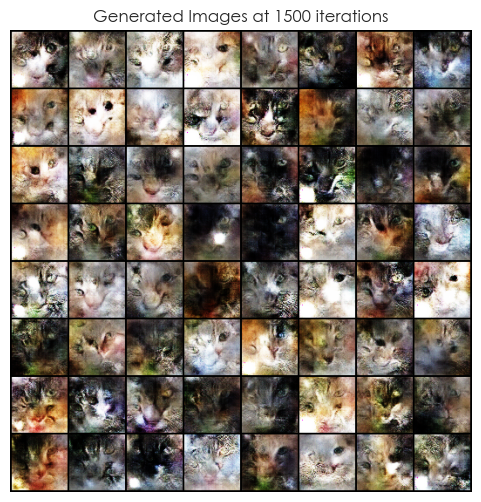

Training Progress:  24%|██▎       | 47/200 [04:34<18:18,  7.18s/it]

[46/200][30/32] 	Loss_D: -0.1065 | Loss_G: -0.4136 | Iteration Time: 0.1385 sec
[47/200][0/32] 	Loss_D: -0.0996 | Loss_G: -0.4376 | Iteration Time: 0.1590 sec
[47/200][5/32] 	Loss_D: -0.0969 | Loss_G: -0.4693 | Iteration Time: 0.1420 sec
[47/200][10/32] 	Loss_D: -0.0727 | Loss_G: -0.4622 | Iteration Time: 0.1430 sec
[47/200][15/32] 	Loss_D: -0.0603 | Loss_G: -0.4962 | Iteration Time: 0.1405 sec
[47/200][20/32] 	Loss_D: -0.1055 | Loss_G: -0.4656 | Iteration Time: 0.1395 sec
[47/200][25/32] 	Loss_D: -0.0996 | Loss_G: -0.4163 | Iteration Time: 0.1425 sec


Training Progress:  24%|██▍       | 48/200 [04:40<16:57,  6.69s/it]

[47/200][30/32] 	Loss_D: -0.0865 | Loss_G: -0.4261 | Iteration Time: 0.1430 sec
[48/200][0/32] 	Loss_D: -0.0907 | Loss_G: -0.4632 | Iteration Time: 0.1475 sec
[48/200][5/32] 	Loss_D: -0.0966 | Loss_G: -0.4374 | Iteration Time: 0.1420 sec
[48/200][10/32] 	Loss_D: -0.0808 | Loss_G: -0.4266 | Iteration Time: 0.1410 sec
[48/200][15/32] 	Loss_D: -0.0845 | Loss_G: -0.5066 | Iteration Time: 0.1430 sec
[48/200][20/32] 	Loss_D: -0.0732 | Loss_G: -0.4250 | Iteration Time: 0.1415 sec
[48/200][25/32] 	Loss_D: -0.0901 | Loss_G: -0.4811 | Iteration Time: 0.1415 sec


Training Progress:  24%|██▍       | 49/200 [04:45<15:55,  6.33s/it]

[48/200][30/32] 	Loss_D: -0.0732 | Loss_G: -0.4275 | Iteration Time: 0.1450 sec
[49/200][0/32] 	Loss_D: -0.0700 | Loss_G: -0.4282 | Iteration Time: 0.1600 sec
[49/200][5/32] 	Loss_D: -0.0664 | Loss_G: -0.4191 | Iteration Time: 0.1415 sec
[49/200][10/32] 	Loss_D: -0.0849 | Loss_G: -0.4711 | Iteration Time: 0.1435 sec
[49/200][15/32] 	Loss_D: -0.0860 | Loss_G: -0.4245 | Iteration Time: 0.1400 sec
[49/200][20/32] 	Loss_D: -0.0891 | Loss_G: -0.4102 | Iteration Time: 0.1410 sec
[49/200][25/32] 	Loss_D: -0.0949 | Loss_G: -0.5068 | Iteration Time: 0.1445 sec


Training Progress:  25%|██▌       | 50/200 [04:51<15:10,  6.07s/it]

[49/200][30/32] 	Loss_D: -0.0945 | Loss_G: -0.4807 | Iteration Time: 0.1400 sec
[50/200][0/32] 	Loss_D: -0.0927 | Loss_G: -0.4735 | Iteration Time: 0.1495 sec
[50/200][5/32] 	Loss_D: -0.1210 | Loss_G: -0.4179 | Iteration Time: 0.1450 sec
[50/200][10/32] 	Loss_D: -0.1210 | Loss_G: -0.4430 | Iteration Time: 0.1400 sec
[50/200][15/32] 	Loss_D: -0.0772 | Loss_G: -0.4189 | Iteration Time: 0.1445 sec
[50/200][20/32] 	Loss_D: -0.0772 | Loss_G: -0.4180 | Iteration Time: 0.1450 sec
[50/200][25/32] 	Loss_D: -0.0988 | Loss_G: -0.4793 | Iteration Time: 0.1430 sec


Training Progress:  26%|██▌       | 51/200 [04:56<14:39,  5.90s/it]

[50/200][30/32] 	Loss_D: -0.0799 | Loss_G: -0.4806 | Iteration Time: 0.1409 sec
[51/200][0/32] 	Loss_D: -0.0899 | Loss_G: -0.4688 | Iteration Time: 0.1550 sec
[51/200][5/32] 	Loss_D: -0.0909 | Loss_G: -0.4177 | Iteration Time: 0.1395 sec
[51/200][10/32] 	Loss_D: -0.0907 | Loss_G: -0.4618 | Iteration Time: 0.1415 sec
[51/200][15/32] 	Loss_D: -0.1178 | Loss_G: -0.4290 | Iteration Time: 0.1420 sec
[51/200][20/32] 	Loss_D: -0.1021 | Loss_G: -0.4280 | Iteration Time: 0.1425 sec
[51/200][25/32] 	Loss_D: -0.0827 | Loss_G: -0.4887 | Iteration Time: 0.1435 sec


Training Progress:  26%|██▌       | 52/200 [05:02<14:16,  5.78s/it]

[51/200][30/32] 	Loss_D: -0.0899 | Loss_G: -0.4283 | Iteration Time: 0.1425 sec
[52/200][0/32] 	Loss_D: -0.0637 | Loss_G: -0.4317 | Iteration Time: 0.1410 sec
[52/200][5/32] 	Loss_D: -0.0854 | Loss_G: -0.4633 | Iteration Time: 0.1480 sec
[52/200][10/32] 	Loss_D: -0.0855 | Loss_G: -0.4189 | Iteration Time: 0.1415 sec
[52/200][15/32] 	Loss_D: -0.0541 | Loss_G: -0.4639 | Iteration Time: 0.1445 sec
[52/200][20/32] 	Loss_D: -0.0739 | Loss_G: -0.4358 | Iteration Time: 0.1410 sec
[52/200][25/32] 	Loss_D: -0.0824 | Loss_G: -0.4856 | Iteration Time: 0.1455 sec


Training Progress:  26%|██▋       | 53/200 [05:07<14:00,  5.71s/it]

[52/200][30/32] 	Loss_D: -0.0747 | Loss_G: -0.4251 | Iteration Time: 0.1495 sec
[53/200][0/32] 	Loss_D: -0.1172 | Loss_G: -0.4147 | Iteration Time: 0.1450 sec
[53/200][5/32] 	Loss_D: -0.0977 | Loss_G: -0.4255 | Iteration Time: 0.1432 sec
[53/200][10/32] 	Loss_D: -0.0783 | Loss_G: -0.4213 | Iteration Time: 0.1410 sec
[53/200][15/32] 	Loss_D: -0.0882 | Loss_G: -0.4609 | Iteration Time: 0.1425 sec
[53/200][20/32] 	Loss_D: -0.0917 | Loss_G: -0.4196 | Iteration Time: 0.1460 sec
[53/200][25/32] 	Loss_D: -0.0438 | Loss_G: -0.4861 | Iteration Time: 0.1450 sec


Training Progress:  27%|██▋       | 54/200 [05:13<13:47,  5.67s/it]

[53/200][30/32] 	Loss_D: -0.1222 | Loss_G: -0.4746 | Iteration Time: 0.1435 sec
[54/200][0/32] 	Loss_D: -0.1023 | Loss_G: -0.4702 | Iteration Time: 0.1595 sec
[54/200][5/32] 	Loss_D: -0.0903 | Loss_G: -0.4163 | Iteration Time: 0.1445 sec
[54/200][10/32] 	Loss_D: -0.0924 | Loss_G: -0.4818 | Iteration Time: 0.1450 sec
[54/200][15/32] 	Loss_D: -0.0989 | Loss_G: -0.4724 | Iteration Time: 0.1425 sec
[54/200][20/32] 	Loss_D: -0.0761 | Loss_G: -0.4904 | Iteration Time: 0.1455 sec
[54/200][25/32] 	Loss_D: -0.0801 | Loss_G: -0.4221 | Iteration Time: 0.1430 sec


Training Progress:  28%|██▊       | 55/200 [05:18<13:36,  5.63s/it]

[54/200][30/32] 	Loss_D: -0.1069 | Loss_G: -0.4632 | Iteration Time: 0.1415 sec
[55/200][0/32] 	Loss_D: -0.0723 | Loss_G: -0.4850 | Iteration Time: 0.1526 sec
[55/200][5/32] 	Loss_D: -0.0855 | Loss_G: -0.4683 | Iteration Time: 0.1430 sec
[55/200][10/32] 	Loss_D: -0.0799 | Loss_G: -0.4232 | Iteration Time: 0.1450 sec
[55/200][15/32] 	Loss_D: -0.0764 | Loss_G: -0.4834 | Iteration Time: 0.1440 sec
[55/200][20/32] 	Loss_D: -0.0669 | Loss_G: -0.4818 | Iteration Time: 0.1460 sec
[55/200][25/32] 	Loss_D: -0.0895 | Loss_G: -0.4666 | Iteration Time: 0.1460 sec


Training Progress:  28%|██▊       | 56/200 [05:24<13:28,  5.61s/it]

[55/200][30/32] 	Loss_D: -0.0778 | Loss_G: -0.4279 | Iteration Time: 0.1438 sec
[56/200][0/32] 	Loss_D: -0.0842 | Loss_G: -0.4238 | Iteration Time: 0.1490 sec
[56/200][5/32] 	Loss_D: -0.0869 | Loss_G: -0.4777 | Iteration Time: 0.1440 sec
[56/200][10/32] 	Loss_D: -0.0914 | Loss_G: -0.4712 | Iteration Time: 0.1420 sec
[56/200][15/32] 	Loss_D: -0.0785 | Loss_G: -0.4668 | Iteration Time: 0.1495 sec
[56/200][20/32] 	Loss_D: -0.0762 | Loss_G: -0.4208 | Iteration Time: 0.1430 sec
[56/200][25/32] 	Loss_D: -0.0774 | Loss_G: -0.4294 | Iteration Time: 0.1450 sec


Training Progress:  28%|██▊       | 57/200 [05:29<13:20,  5.60s/it]

[56/200][30/32] 	Loss_D: -0.0908 | Loss_G: -0.4195 | Iteration Time: 0.1420 sec
[57/200][0/32] 	Loss_D: -0.0980 | Loss_G: -0.4142 | Iteration Time: 0.1480 sec
[57/200][5/32] 	Loss_D: -0.0805 | Loss_G: -0.4785 | Iteration Time: 0.1455 sec
[57/200][10/32] 	Loss_D: -0.0941 | Loss_G: -0.4647 | Iteration Time: 0.1405 sec
[57/200][15/32] 	Loss_D: -0.0878 | Loss_G: -0.4193 | Iteration Time: 0.1440 sec
[57/200][20/32] 	Loss_D: -0.0836 | Loss_G: -0.4724 | Iteration Time: 0.1429 sec
[57/200][25/32] 	Loss_D: -0.0815 | Loss_G: -0.4214 | Iteration Time: 0.1440 sec


Training Progress:  29%|██▉       | 58/200 [05:35<13:13,  5.59s/it]

[57/200][30/32] 	Loss_D: -0.0839 | Loss_G: -0.4883 | Iteration Time: 0.1495 sec
[58/200][0/32] 	Loss_D: -0.0807 | Loss_G: -0.4657 | Iteration Time: 0.1435 sec
[58/200][5/32] 	Loss_D: -0.1002 | Loss_G: -0.4213 | Iteration Time: 0.1460 sec
[58/200][10/32] 	Loss_D: -0.0807 | Loss_G: -0.4335 | Iteration Time: 0.1407 sec
[58/200][15/32] 	Loss_D: -0.0611 | Loss_G: -0.4245 | Iteration Time: 0.1450 sec
[58/200][20/32] 	Loss_D: -0.0845 | Loss_G: -0.4151 | Iteration Time: 0.1455 sec
[58/200][25/32] 	Loss_D: -0.0965 | Loss_G: -0.4702 | Iteration Time: 0.1410 sec


Training Progress:  30%|██▉       | 59/200 [05:40<13:05,  5.57s/it]

[58/200][30/32] 	Loss_D: -0.0772 | Loss_G: -0.4192 | Iteration Time: 0.1410 sec
[59/200][0/32] 	Loss_D: -0.0897 | Loss_G: -0.4945 | Iteration Time: 0.1595 sec
[59/200][5/32] 	Loss_D: -0.0765 | Loss_G: -0.4976 | Iteration Time: 0.1425 sec
[59/200][10/32] 	Loss_D: -0.0732 | Loss_G: -0.4934 | Iteration Time: 0.1450 sec
[59/200][15/32] 	Loss_D: -0.0620 | Loss_G: -0.4973 | Iteration Time: 0.1430 sec
[59/200][20/32] 	Loss_D: -0.0883 | Loss_G: -0.4579 | Iteration Time: 0.1435 sec
[59/200][25/32] 	Loss_D: -0.0919 | Loss_G: -0.4726 | Iteration Time: 0.1430 sec


Training Progress:  30%|███       | 60/200 [05:46<12:59,  5.57s/it]

[59/200][30/32] 	Loss_D: -0.0895 | Loss_G: -0.4228 | Iteration Time: 0.1430 sec
[60/200][0/32] 	Loss_D: -0.1014 | Loss_G: -0.4219 | Iteration Time: 0.1530 sec
[60/200][5/32] 	Loss_D: -0.0795 | Loss_G: -0.4842 | Iteration Time: 0.1440 sec
[60/200][10/32] 	Loss_D: -0.0981 | Loss_G: -0.4526 | Iteration Time: 0.1440 sec
[60/200][15/32] 	Loss_D: -0.0655 | Loss_G: -0.4236 | Iteration Time: 0.1415 sec
[60/200][20/32] 	Loss_D: -0.0782 | Loss_G: -0.4804 | Iteration Time: 0.1440 sec
[60/200][25/32] 	Loss_D: -0.0789 | Loss_G: -0.4368 | Iteration Time: 0.1480 sec


Training Progress:  30%|███       | 61/200 [05:52<12:54,  5.57s/it]

[60/200][30/32] 	Loss_D: -0.0651 | Loss_G: -0.4201 | Iteration Time: 0.1440 sec
[61/200][0/32] 	Loss_D: -0.0936 | Loss_G: -0.4267 | Iteration Time: 0.1520 sec
[61/200][5/32] 	Loss_D: -0.0642 | Loss_G: -0.4800 | Iteration Time: 0.1424 sec
[61/200][10/32] 	Loss_D: -0.0982 | Loss_G: -0.4814 | Iteration Time: 0.1400 sec
[61/200][15/32] 	Loss_D: -0.0797 | Loss_G: -0.4277 | Iteration Time: 0.1445 sec
[61/200][20/32] 	Loss_D: -0.0833 | Loss_G: -0.4255 | Iteration Time: 0.1410 sec
[61/200][25/32] 	Loss_D: -0.0840 | Loss_G: -0.4860 | Iteration Time: 0.1424 sec


Training Progress:  31%|███       | 62/200 [05:57<12:47,  5.56s/it]

[61/200][30/32] 	Loss_D: -0.0744 | Loss_G: -0.4259 | Iteration Time: 0.1490 sec
[62/200][0/32] 	Loss_D: -0.1000 | Loss_G: -0.4543 | Iteration Time: 0.1445 sec
[62/200][5/32] 	Loss_D: -0.0910 | Loss_G: -0.4315 | Iteration Time: 0.1430 sec
[62/200][10/32] 	Loss_D: -0.1048 | Loss_G: -0.4770 | Iteration Time: 0.1450 sec
[62/200][15/32] 	Loss_D: -0.0805 | Loss_G: -0.4714 | Iteration Time: 0.1435 sec
Current scores at iteration 2000 | FID: 239.5519561767578 | IS: 2.228182554244995


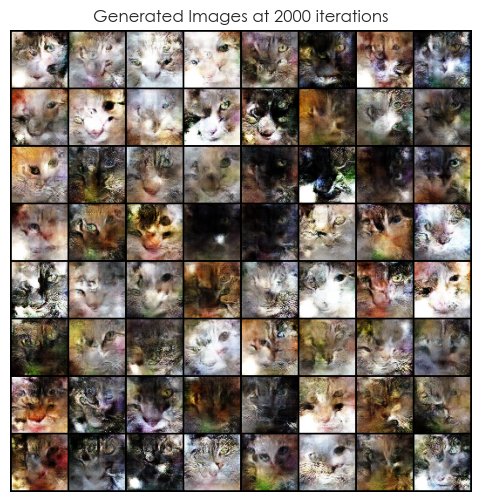

[62/200][20/32] 	Loss_D: -0.0842 | Loss_G: -0.4169 | Iteration Time: 0.1375 sec
[62/200][25/32] 	Loss_D: -0.0734 | Loss_G: -0.4728 | Iteration Time: 0.1445 sec


Training Progress:  32%|███▏      | 63/200 [06:08<16:18,  7.14s/it]

[62/200][30/32] 	Loss_D: -0.0816 | Loss_G: -0.5041 | Iteration Time: 0.1426 sec
[63/200][0/32] 	Loss_D: -0.0586 | Loss_G: -0.4839 | Iteration Time: 0.1465 sec
[63/200][5/32] 	Loss_D: -0.0898 | Loss_G: -0.4233 | Iteration Time: 0.1475 sec
[63/200][10/32] 	Loss_D: -0.0875 | Loss_G: -0.4606 | Iteration Time: 0.1405 sec
[63/200][15/32] 	Loss_D: -0.0849 | Loss_G: -0.4209 | Iteration Time: 0.1415 sec
[63/200][20/32] 	Loss_D: -0.0792 | Loss_G: -0.4194 | Iteration Time: 0.1420 sec
[63/200][25/32] 	Loss_D: -0.0778 | Loss_G: -0.4836 | Iteration Time: 0.1415 sec


Training Progress:  32%|███▏      | 64/200 [06:13<15:06,  6.66s/it]

[63/200][30/32] 	Loss_D: -0.0824 | Loss_G: -0.4875 | Iteration Time: 0.1477 sec
[64/200][0/32] 	Loss_D: -0.0842 | Loss_G: -0.4681 | Iteration Time: 0.1435 sec
[64/200][5/32] 	Loss_D: -0.0938 | Loss_G: -0.4262 | Iteration Time: 0.1395 sec
[64/200][10/32] 	Loss_D: -0.0828 | Loss_G: -0.4720 | Iteration Time: 0.1430 sec
[64/200][15/32] 	Loss_D: -0.0751 | Loss_G: -0.4766 | Iteration Time: 0.1450 sec
[64/200][20/32] 	Loss_D: -0.0584 | Loss_G: -0.4979 | Iteration Time: 0.1475 sec
[64/200][25/32] 	Loss_D: -0.0742 | Loss_G: -0.4857 | Iteration Time: 0.1445 sec


Training Progress:  32%|███▎      | 65/200 [06:19<14:15,  6.34s/it]

[64/200][30/32] 	Loss_D: -0.0926 | Loss_G: -0.4238 | Iteration Time: 0.1455 sec
[65/200][0/32] 	Loss_D: -0.1058 | Loss_G: -0.4600 | Iteration Time: 0.1470 sec
[65/200][5/32] 	Loss_D: -0.0892 | Loss_G: -0.4822 | Iteration Time: 0.1436 sec
[65/200][10/32] 	Loss_D: -0.0805 | Loss_G: -0.4251 | Iteration Time: 0.1470 sec
[65/200][15/32] 	Loss_D: -0.0988 | Loss_G: -0.4892 | Iteration Time: 0.1425 sec
[65/200][20/32] 	Loss_D: -0.0837 | Loss_G: -0.4211 | Iteration Time: 0.1430 sec
[65/200][25/32] 	Loss_D: -0.0815 | Loss_G: -0.4697 | Iteration Time: 0.1415 sec


Training Progress:  33%|███▎      | 66/200 [06:25<13:37,  6.10s/it]

[65/200][30/32] 	Loss_D: -0.0646 | Loss_G: -0.4761 | Iteration Time: 0.1415 sec
[66/200][0/32] 	Loss_D: -0.0838 | Loss_G: -0.4771 | Iteration Time: 0.1590 sec
[66/200][5/32] 	Loss_D: -0.0832 | Loss_G: -0.4248 | Iteration Time: 0.1410 sec
[66/200][10/32] 	Loss_D: -0.0891 | Loss_G: -0.4285 | Iteration Time: 0.1430 sec
[66/200][15/32] 	Loss_D: -0.0868 | Loss_G: -0.4735 | Iteration Time: 0.1450 sec
[66/200][20/32] 	Loss_D: -0.0832 | Loss_G: -0.4263 | Iteration Time: 0.1445 sec
[66/200][25/32] 	Loss_D: -0.0980 | Loss_G: -0.4480 | Iteration Time: 0.1460 sec


Training Progress:  34%|███▎      | 67/200 [06:30<13:11,  5.95s/it]

[66/200][30/32] 	Loss_D: -0.0728 | Loss_G: -0.4710 | Iteration Time: 0.1450 sec
[67/200][0/32] 	Loss_D: -0.0772 | Loss_G: -0.4710 | Iteration Time: 0.1595 sec
[67/200][5/32] 	Loss_D: -0.1023 | Loss_G: -0.4562 | Iteration Time: 0.1450 sec
[67/200][10/32] 	Loss_D: -0.0757 | Loss_G: -0.4234 | Iteration Time: 0.1432 sec
[67/200][15/32] 	Loss_D: -0.0625 | Loss_G: -0.5013 | Iteration Time: 0.1405 sec
[67/200][20/32] 	Loss_D: -0.0805 | Loss_G: -0.4209 | Iteration Time: 0.1415 sec
[67/200][25/32] 	Loss_D: -0.0840 | Loss_G: -0.4814 | Iteration Time: 0.1453 sec


Training Progress:  34%|███▍      | 68/200 [06:36<12:48,  5.82s/it]

[67/200][30/32] 	Loss_D: -0.0825 | Loss_G: -0.4788 | Iteration Time: 0.1395 sec
[68/200][0/32] 	Loss_D: -0.0772 | Loss_G: -0.4824 | Iteration Time: 0.1505 sec
[68/200][5/32] 	Loss_D: -0.0670 | Loss_G: -0.4911 | Iteration Time: 0.1450 sec
[68/200][10/32] 	Loss_D: -0.0698 | Loss_G: -0.4768 | Iteration Time: 0.1440 sec
[68/200][15/32] 	Loss_D: -0.0772 | Loss_G: -0.4723 | Iteration Time: 0.1470 sec
[68/200][20/32] 	Loss_D: -0.0931 | Loss_G: -0.4496 | Iteration Time: 0.1430 sec
[68/200][25/32] 	Loss_D: -0.0856 | Loss_G: -0.4639 | Iteration Time: 0.1400 sec


Training Progress:  34%|███▍      | 69/200 [06:41<12:31,  5.74s/it]

[68/200][30/32] 	Loss_D: -0.0702 | Loss_G: -0.4818 | Iteration Time: 0.1410 sec
[69/200][0/32] 	Loss_D: -0.0788 | Loss_G: -0.4864 | Iteration Time: 0.1485 sec
[69/200][5/32] 	Loss_D: -0.0715 | Loss_G: -0.4777 | Iteration Time: 0.1440 sec
[69/200][10/32] 	Loss_D: -0.0778 | Loss_G: -0.4297 | Iteration Time: 0.1450 sec
[69/200][15/32] 	Loss_D: -0.0931 | Loss_G: -0.4497 | Iteration Time: 0.1430 sec
[69/200][20/32] 	Loss_D: -0.0725 | Loss_G: -0.4266 | Iteration Time: 0.1430 sec
[69/200][25/32] 	Loss_D: -0.0891 | Loss_G: -0.4713 | Iteration Time: 0.1430 sec


Training Progress:  35%|███▌      | 70/200 [06:47<12:19,  5.69s/it]

[69/200][30/32] 	Loss_D: -0.0684 | Loss_G: -0.4964 | Iteration Time: 0.1475 sec
[70/200][0/32] 	Loss_D: -0.0648 | Loss_G: -0.4192 | Iteration Time: 0.1465 sec
[70/200][5/32] 	Loss_D: -0.0818 | Loss_G: -0.4752 | Iteration Time: 0.1421 sec
[70/200][10/32] 	Loss_D: -0.0948 | Loss_G: -0.4387 | Iteration Time: 0.1430 sec
[70/200][15/32] 	Loss_D: -0.0835 | Loss_G: -0.4811 | Iteration Time: 0.1435 sec
[70/200][20/32] 	Loss_D: -0.0592 | Loss_G: -0.4702 | Iteration Time: 0.1520 sec
[70/200][25/32] 	Loss_D: -0.1028 | Loss_G: -0.4315 | Iteration Time: 0.1440 sec


Training Progress:  36%|███▌      | 71/200 [06:52<12:10,  5.66s/it]

[70/200][30/32] 	Loss_D: -0.0773 | Loss_G: -0.4873 | Iteration Time: 0.1480 sec
[71/200][0/32] 	Loss_D: -0.0860 | Loss_G: -0.4227 | Iteration Time: 0.1470 sec
[71/200][5/32] 	Loss_D: -0.0860 | Loss_G: -0.4361 | Iteration Time: 0.1450 sec
[71/200][10/32] 	Loss_D: -0.0842 | Loss_G: -0.5079 | Iteration Time: 0.1410 sec
[71/200][15/32] 	Loss_D: -0.0926 | Loss_G: -0.4769 | Iteration Time: 0.1450 sec
[71/200][20/32] 	Loss_D: -0.0659 | Loss_G: -0.4904 | Iteration Time: 0.1490 sec
[71/200][25/32] 	Loss_D: -0.0747 | Loss_G: -0.4355 | Iteration Time: 0.1432 sec


Training Progress:  36%|███▌      | 72/200 [06:58<12:01,  5.64s/it]

[71/200][30/32] 	Loss_D: -0.0808 | Loss_G: -0.4259 | Iteration Time: 0.1450 sec
[72/200][0/32] 	Loss_D: -0.1029 | Loss_G: -0.4514 | Iteration Time: 0.1600 sec
[72/200][5/32] 	Loss_D: -0.0702 | Loss_G: -0.4933 | Iteration Time: 0.1415 sec
[72/200][10/32] 	Loss_D: -0.0929 | Loss_G: -0.4765 | Iteration Time: 0.1460 sec
[72/200][15/32] 	Loss_D: -0.0365 | Loss_G: -0.4552 | Iteration Time: 0.1395 sec
[72/200][20/32] 	Loss_D: -0.0892 | Loss_G: -0.4902 | Iteration Time: 0.1445 sec
[72/200][25/32] 	Loss_D: -0.0818 | Loss_G: -0.4865 | Iteration Time: 0.1435 sec


Training Progress:  36%|███▋      | 73/200 [07:04<11:52,  5.61s/it]

[72/200][30/32] 	Loss_D: -0.0730 | Loss_G: -0.4307 | Iteration Time: 0.1420 sec
[73/200][0/32] 	Loss_D: -0.0801 | Loss_G: -0.4914 | Iteration Time: 0.1575 sec
[73/200][5/32] 	Loss_D: -0.0823 | Loss_G: -0.4994 | Iteration Time: 0.1444 sec
[73/200][10/32] 	Loss_D: -0.0700 | Loss_G: -0.4889 | Iteration Time: 0.1440 sec
[73/200][15/32] 	Loss_D: -0.0664 | Loss_G: -0.4992 | Iteration Time: 0.1435 sec
[73/200][20/32] 	Loss_D: -0.0729 | Loss_G: -0.4982 | Iteration Time: 0.1435 sec
[73/200][25/32] 	Loss_D: -0.0811 | Loss_G: -0.4838 | Iteration Time: 0.1470 sec


Training Progress:  37%|███▋      | 74/200 [07:09<11:44,  5.59s/it]

[73/200][30/32] 	Loss_D: -0.0838 | Loss_G: -0.4974 | Iteration Time: 0.1435 sec
[74/200][0/32] 	Loss_D: -0.0842 | Loss_G: -0.4859 | Iteration Time: 0.1510 sec
[74/200][5/32] 	Loss_D: -0.0853 | Loss_G: -0.4566 | Iteration Time: 0.1415 sec
[74/200][10/32] 	Loss_D: -0.0669 | Loss_G: -0.4261 | Iteration Time: 0.1420 sec
[74/200][15/32] 	Loss_D: -0.0968 | Loss_G: -0.4318 | Iteration Time: 0.1430 sec
[74/200][20/32] 	Loss_D: -0.0711 | Loss_G: -0.4220 | Iteration Time: 0.1425 sec
[74/200][25/32] 	Loss_D: -0.0688 | Loss_G: -0.4880 | Iteration Time: 0.1440 sec


Training Progress:  38%|███▊      | 75/200 [07:15<11:37,  5.58s/it]

[74/200][30/32] 	Loss_D: -0.0960 | Loss_G: -0.4441 | Iteration Time: 0.1410 sec
[75/200][0/32] 	Loss_D: -0.0885 | Loss_G: -0.4784 | Iteration Time: 0.1515 sec
[75/200][5/32] 	Loss_D: -0.0872 | Loss_G: -0.4802 | Iteration Time: 0.1445 sec
[75/200][10/32] 	Loss_D: -0.0724 | Loss_G: -0.4357 | Iteration Time: 0.1435 sec
[75/200][15/32] 	Loss_D: -0.0875 | Loss_G: -0.4149 | Iteration Time: 0.1420 sec
[75/200][20/32] 	Loss_D: -0.0747 | Loss_G: -0.4884 | Iteration Time: 0.1452 sec
[75/200][25/32] 	Loss_D: -0.0808 | Loss_G: -0.4647 | Iteration Time: 0.1420 sec


Training Progress:  38%|███▊      | 76/200 [07:20<11:30,  5.57s/it]

[75/200][30/32] 	Loss_D: -0.0695 | Loss_G: -0.4216 | Iteration Time: 0.1445 sec
[76/200][0/32] 	Loss_D: -0.0849 | Loss_G: -0.4782 | Iteration Time: 0.1600 sec
[76/200][5/32] 	Loss_D: -0.0708 | Loss_G: -0.4375 | Iteration Time: 0.1435 sec
[76/200][10/32] 	Loss_D: -0.0755 | Loss_G: -0.4705 | Iteration Time: 0.1438 sec
[76/200][15/32] 	Loss_D: -0.0750 | Loss_G: -0.4917 | Iteration Time: 0.1405 sec
[76/200][20/32] 	Loss_D: -0.0675 | Loss_G: -0.4829 | Iteration Time: 0.1430 sec
[76/200][25/32] 	Loss_D: -0.0792 | Loss_G: -0.4264 | Iteration Time: 0.1490 sec


Training Progress:  38%|███▊      | 77/200 [07:26<11:22,  5.55s/it]

[76/200][30/32] 	Loss_D: -0.0955 | Loss_G: -0.4523 | Iteration Time: 0.1420 sec
[77/200][0/32] 	Loss_D: -0.0656 | Loss_G: -0.4143 | Iteration Time: 0.1515 sec
[77/200][5/32] 	Loss_D: -0.0662 | Loss_G: -0.4791 | Iteration Time: 0.1435 sec
[77/200][10/32] 	Loss_D: -0.0836 | Loss_G: -0.4678 | Iteration Time: 0.1445 sec
[77/200][15/32] 	Loss_D: -0.0865 | Loss_G: -0.4803 | Iteration Time: 0.1480 sec
[77/200][20/32] 	Loss_D: -0.0862 | Loss_G: -0.4701 | Iteration Time: 0.1435 sec
[77/200][25/32] 	Loss_D: -0.0833 | Loss_G: -0.4259 | Iteration Time: 0.1426 sec


Training Progress:  39%|███▉      | 78/200 [07:31<11:17,  5.56s/it]

[77/200][30/32] 	Loss_D: -0.0750 | Loss_G: -0.4664 | Iteration Time: 0.1415 sec
[78/200][0/32] 	Loss_D: -0.0876 | Loss_G: -0.4486 | Iteration Time: 0.1455 sec
Current scores at iteration 2500 | FID: 207.3428955078125 | IS: 2.4028067588806152


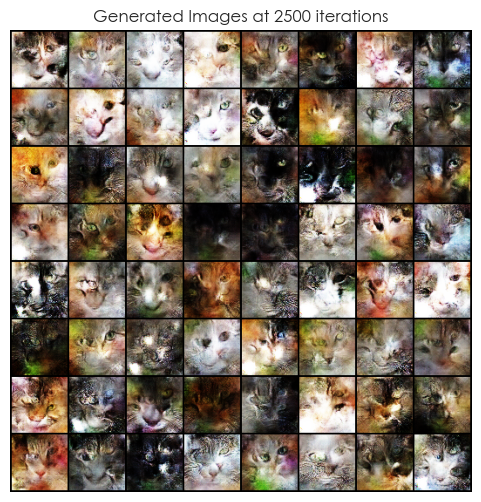

[78/200][5/32] 	Loss_D: -0.1071 | Loss_G: -0.4344 | Iteration Time: 0.3388 sec
[78/200][10/32] 	Loss_D: -0.0676 | Loss_G: -0.4229 | Iteration Time: 0.1444 sec
[78/200][15/32] 	Loss_D: -0.0841 | Loss_G: -0.4249 | Iteration Time: 0.1430 sec
[78/200][20/32] 	Loss_D: -0.0659 | Loss_G: -0.4689 | Iteration Time: 0.1400 sec
[78/200][25/32] 	Loss_D: -0.0723 | Loss_G: -0.5320 | Iteration Time: 0.1425 sec


Training Progress:  40%|███▉      | 79/200 [07:42<14:22,  7.12s/it]

[78/200][30/32] 	Loss_D: -0.0858 | Loss_G: -0.4394 | Iteration Time: 0.1440 sec
[79/200][0/32] 	Loss_D: -0.0946 | Loss_G: -0.4687 | Iteration Time: 0.1485 sec
[79/200][5/32] 	Loss_D: -0.0817 | Loss_G: -0.4215 | Iteration Time: 0.1425 sec
[79/200][10/32] 	Loss_D: -0.0717 | Loss_G: -0.4828 | Iteration Time: 0.1435 sec
[79/200][15/32] 	Loss_D: -0.0743 | Loss_G: -0.4147 | Iteration Time: 0.1445 sec
[79/200][20/32] 	Loss_D: -0.0722 | Loss_G: -0.4849 | Iteration Time: 0.1445 sec
[79/200][25/32] 	Loss_D: -0.0652 | Loss_G: -0.4771 | Iteration Time: 0.1450 sec


Training Progress:  40%|████      | 80/200 [07:48<13:18,  6.65s/it]

[79/200][30/32] 	Loss_D: -0.0928 | Loss_G: -0.4856 | Iteration Time: 0.1468 sec
[80/200][0/32] 	Loss_D: -0.0873 | Loss_G: -0.4500 | Iteration Time: 0.1425 sec
[80/200][5/32] 	Loss_D: -0.0737 | Loss_G: -0.4963 | Iteration Time: 0.1439 sec
[80/200][10/32] 	Loss_D: -0.0978 | Loss_G: -0.4339 | Iteration Time: 0.1420 sec
[80/200][15/32] 	Loss_D: -0.0764 | Loss_G: -0.4859 | Iteration Time: 0.1412 sec
[80/200][20/32] 	Loss_D: -0.0854 | Loss_G: -0.5065 | Iteration Time: 0.1425 sec
[80/200][25/32] 	Loss_D: -0.0695 | Loss_G: -0.4239 | Iteration Time: 0.1430 sec


Training Progress:  40%|████      | 81/200 [07:53<12:31,  6.32s/it]

[80/200][30/32] 	Loss_D: -0.0745 | Loss_G: -0.4701 | Iteration Time: 0.1407 sec
[81/200][0/32] 	Loss_D: -0.0874 | Loss_G: -0.4242 | Iteration Time: 0.1535 sec
[81/200][5/32] 	Loss_D: -0.0870 | Loss_G: -0.4481 | Iteration Time: 0.1400 sec
[81/200][10/32] 	Loss_D: -0.0737 | Loss_G: -0.4218 | Iteration Time: 0.1440 sec
[81/200][15/32] 	Loss_D: -0.0747 | Loss_G: -0.4829 | Iteration Time: 0.1445 sec
[81/200][20/32] 	Loss_D: -0.0795 | Loss_G: -0.4866 | Iteration Time: 0.1460 sec
[81/200][25/32] 	Loss_D: -0.0679 | Loss_G: -0.4821 | Iteration Time: 0.1515 sec


Training Progress:  41%|████      | 82/200 [07:59<11:58,  6.09s/it]

[81/200][30/32] 	Loss_D: -0.0894 | Loss_G: -0.4704 | Iteration Time: 0.1420 sec
[82/200][0/32] 	Loss_D: -0.0966 | Loss_G: -0.4251 | Iteration Time: 0.1505 sec
[82/200][5/32] 	Loss_D: -0.0736 | Loss_G: -0.4875 | Iteration Time: 0.1450 sec
[82/200][10/32] 	Loss_D: -0.0809 | Loss_G: -0.4851 | Iteration Time: 0.1403 sec
[82/200][15/32] 	Loss_D: -0.0796 | Loss_G: -0.4209 | Iteration Time: 0.1445 sec
[82/200][20/32] 	Loss_D: -0.0737 | Loss_G: -0.4770 | Iteration Time: 0.1410 sec
[82/200][25/32] 	Loss_D: -0.0899 | Loss_G: -0.4275 | Iteration Time: 0.1425 sec


Training Progress:  42%|████▏     | 83/200 [08:04<11:33,  5.93s/it]

[82/200][30/32] 	Loss_D: -0.0608 | Loss_G: -0.4217 | Iteration Time: 0.1445 sec
[83/200][0/32] 	Loss_D: -0.0838 | Loss_G: -0.5023 | Iteration Time: 0.1495 sec
[83/200][5/32] 	Loss_D: -0.0572 | Loss_G: -0.4986 | Iteration Time: 0.1470 sec
[83/200][10/32] 	Loss_D: -0.0866 | Loss_G: -0.4302 | Iteration Time: 0.1425 sec
[83/200][15/32] 	Loss_D: -0.0905 | Loss_G: -0.4750 | Iteration Time: 0.1445 sec
[83/200][20/32] 	Loss_D: -0.0864 | Loss_G: -0.4741 | Iteration Time: 0.1450 sec
[83/200][25/32] 	Loss_D: -0.0893 | Loss_G: -0.4382 | Iteration Time: 0.1460 sec


Training Progress:  42%|████▏     | 84/200 [08:10<11:14,  5.82s/it]

[83/200][30/32] 	Loss_D: -0.0800 | Loss_G: -0.4255 | Iteration Time: 0.1480 sec
[84/200][0/32] 	Loss_D: -0.0581 | Loss_G: -0.4261 | Iteration Time: 0.1440 sec
[84/200][5/32] 	Loss_D: -0.0831 | Loss_G: -0.4848 | Iteration Time: 0.1429 sec
[84/200][10/32] 	Loss_D: -0.0916 | Loss_G: -0.4790 | Iteration Time: 0.1410 sec
[84/200][15/32] 	Loss_D: -0.0729 | Loss_G: -0.4887 | Iteration Time: 0.1410 sec
[84/200][20/32] 	Loss_D: -0.0788 | Loss_G: -0.4305 | Iteration Time: 0.1455 sec
[84/200][25/32] 	Loss_D: -0.0959 | Loss_G: -0.4600 | Iteration Time: 0.1419 sec


Training Progress:  42%|████▎     | 85/200 [08:15<10:59,  5.73s/it]

[84/200][30/32] 	Loss_D: -0.0775 | Loss_G: -0.4608 | Iteration Time: 0.1442 sec
[85/200][0/32] 	Loss_D: -0.0875 | Loss_G: -0.4896 | Iteration Time: 0.1580 sec
[85/200][5/32] 	Loss_D: -0.0837 | Loss_G: -0.4899 | Iteration Time: 0.1435 sec
[85/200][10/32] 	Loss_D: -0.0827 | Loss_G: -0.4890 | Iteration Time: 0.1435 sec
[85/200][15/32] 	Loss_D: -0.0780 | Loss_G: -0.4245 | Iteration Time: 0.1430 sec
[85/200][20/32] 	Loss_D: -0.1037 | Loss_G: -0.4402 | Iteration Time: 0.1425 sec
[85/200][25/32] 	Loss_D: -0.0706 | Loss_G: -0.4804 | Iteration Time: 0.1475 sec


Training Progress:  43%|████▎     | 86/200 [08:21<10:46,  5.67s/it]

[85/200][30/32] 	Loss_D: -0.0686 | Loss_G: -0.4228 | Iteration Time: 0.1400 sec
[86/200][0/32] 	Loss_D: -0.0896 | Loss_G: -0.4499 | Iteration Time: 0.1495 sec
[86/200][5/32] 	Loss_D: -0.0953 | Loss_G: -0.4463 | Iteration Time: 0.1435 sec
[86/200][10/32] 	Loss_D: -0.0762 | Loss_G: -0.4394 | Iteration Time: 0.1405 sec
[86/200][15/32] 	Loss_D: -0.0832 | Loss_G: -0.4732 | Iteration Time: 0.1421 sec
[86/200][20/32] 	Loss_D: -0.0923 | Loss_G: -0.4605 | Iteration Time: 0.1397 sec
[86/200][25/32] 	Loss_D: -0.0662 | Loss_G: -0.4924 | Iteration Time: 0.1420 sec


Training Progress:  44%|████▎     | 87/200 [08:26<10:35,  5.63s/it]

[86/200][30/32] 	Loss_D: -0.0529 | Loss_G: -0.4790 | Iteration Time: 0.1460 sec
[87/200][0/32] 	Loss_D: -0.0707 | Loss_G: -0.4271 | Iteration Time: 0.1445 sec
[87/200][5/32] 	Loss_D: -0.0824 | Loss_G: -0.4811 | Iteration Time: 0.1415 sec
[87/200][10/32] 	Loss_D: -0.0745 | Loss_G: -0.4205 | Iteration Time: 0.1405 sec
[87/200][15/32] 	Loss_D: -0.0900 | Loss_G: -0.4684 | Iteration Time: 0.1435 sec
[87/200][20/32] 	Loss_D: -0.0840 | Loss_G: -0.4818 | Iteration Time: 0.1450 sec
[87/200][25/32] 	Loss_D: -0.0441 | Loss_G: -0.4720 | Iteration Time: 0.1405 sec


Training Progress:  44%|████▍     | 88/200 [08:32<10:27,  5.60s/it]

[87/200][30/32] 	Loss_D: -0.0885 | Loss_G: -0.4395 | Iteration Time: 0.1445 sec
[88/200][0/32] 	Loss_D: -0.0688 | Loss_G: -0.4274 | Iteration Time: 0.1628 sec
[88/200][5/32] 	Loss_D: -0.0622 | Loss_G: -0.4786 | Iteration Time: 0.1440 sec
[88/200][10/32] 	Loss_D: -0.0895 | Loss_G: -0.4383 | Iteration Time: 0.1414 sec
[88/200][15/32] 	Loss_D: -0.0699 | Loss_G: -0.4866 | Iteration Time: 0.1435 sec
[88/200][20/32] 	Loss_D: -0.0849 | Loss_G: -0.4905 | Iteration Time: 0.1425 sec
[88/200][25/32] 	Loss_D: -0.0782 | Loss_G: -0.4251 | Iteration Time: 0.1477 sec


Training Progress:  44%|████▍     | 89/200 [08:38<10:20,  5.59s/it]

[88/200][30/32] 	Loss_D: -0.0443 | Loss_G: -0.4832 | Iteration Time: 0.1470 sec
[89/200][0/32] 	Loss_D: -0.0789 | Loss_G: -0.4262 | Iteration Time: 0.1595 sec
[89/200][5/32] 	Loss_D: -0.0950 | Loss_G: -0.4376 | Iteration Time: 0.1440 sec
[89/200][10/32] 	Loss_D: -0.0578 | Loss_G: -0.4777 | Iteration Time: 0.1495 sec
[89/200][15/32] 	Loss_D: -0.0694 | Loss_G: -0.4864 | Iteration Time: 0.1510 sec
[89/200][20/32] 	Loss_D: -0.0596 | Loss_G: -0.4247 | Iteration Time: 0.1490 sec
[89/200][25/32] 	Loss_D: -0.0834 | Loss_G: -0.4366 | Iteration Time: 0.1525 sec


Training Progress:  45%|████▌     | 90/200 [08:43<10:21,  5.65s/it]

[89/200][30/32] 	Loss_D: -0.0728 | Loss_G: -0.4295 | Iteration Time: 0.1505 sec
[90/200][0/32] 	Loss_D: -0.0967 | Loss_G: -0.4567 | Iteration Time: 0.1635 sec
[90/200][5/32] 	Loss_D: -0.0843 | Loss_G: -0.4260 | Iteration Time: 0.1515 sec
[90/200][10/32] 	Loss_D: -0.0806 | Loss_G: -0.4197 | Iteration Time: 0.1495 sec
[90/200][15/32] 	Loss_D: -0.0852 | Loss_G: -0.4407 | Iteration Time: 0.1465 sec
[90/200][20/32] 	Loss_D: -0.0790 | Loss_G: -0.4215 | Iteration Time: 0.1520 sec
[90/200][25/32] 	Loss_D: -0.0818 | Loss_G: -0.4264 | Iteration Time: 0.1485 sec


Training Progress:  46%|████▌     | 91/200 [08:49<10:20,  5.69s/it]

[90/200][30/32] 	Loss_D: -0.0795 | Loss_G: -0.4638 | Iteration Time: 0.1360 sec
[91/200][0/32] 	Loss_D: -0.0763 | Loss_G: -0.4908 | Iteration Time: 0.0955 sec
[91/200][5/32] 	Loss_D: -0.0847 | Loss_G: -0.5072 | Iteration Time: 0.0960 sec
[91/200][10/32] 	Loss_D: -0.1006 | Loss_G: -0.4248 | Iteration Time: 0.1130 sec
[91/200][15/32] 	Loss_D: -0.0763 | Loss_G: -0.4290 | Iteration Time: 0.1400 sec
[91/200][20/32] 	Loss_D: -0.0888 | Loss_G: -0.4377 | Iteration Time: 0.1500 sec
[91/200][25/32] 	Loss_D: -0.0776 | Loss_G: -0.4733 | Iteration Time: 0.1530 sec


Training Progress:  46%|████▌     | 92/200 [08:54<09:56,  5.52s/it]

[91/200][30/32] 	Loss_D: -0.0755 | Loss_G: -0.4866 | Iteration Time: 0.1485 sec
[92/200][0/32] 	Loss_D: -0.1008 | Loss_G: -0.4514 | Iteration Time: 0.1590 sec
[92/200][5/32] 	Loss_D: -0.0802 | Loss_G: -0.4720 | Iteration Time: 0.1500 sec
[92/200][10/32] 	Loss_D: -0.0695 | Loss_G: -0.4973 | Iteration Time: 0.1445 sec
[92/200][15/32] 	Loss_D: -0.0801 | Loss_G: -0.4400 | Iteration Time: 0.1455 sec
[92/200][20/32] 	Loss_D: -0.0791 | Loss_G: -0.4809 | Iteration Time: 0.1445 sec
[92/200][25/32] 	Loss_D: -0.0908 | Loss_G: -0.4368 | Iteration Time: 0.1450 sec


Training Progress:  46%|████▋     | 93/200 [09:00<09:53,  5.55s/it]

[92/200][30/32] 	Loss_D: -0.0909 | Loss_G: -0.4625 | Iteration Time: 0.1440 sec
[93/200][0/32] 	Loss_D: -0.0957 | Loss_G: -0.4287 | Iteration Time: 0.1455 sec
[93/200][5/32] 	Loss_D: -0.0887 | Loss_G: -0.4253 | Iteration Time: 0.1505 sec
[93/200][10/32] 	Loss_D: -0.0767 | Loss_G: -0.4246 | Iteration Time: 0.1430 sec
[93/200][15/32] 	Loss_D: -0.0725 | Loss_G: -0.4218 | Iteration Time: 0.1455 sec
[93/200][20/32] 	Loss_D: -0.0800 | Loss_G: -0.4830 | Iteration Time: 0.1415 sec
Current scores at iteration 3000 | FID: 195.464111328125 | IS: 2.2515273094177246


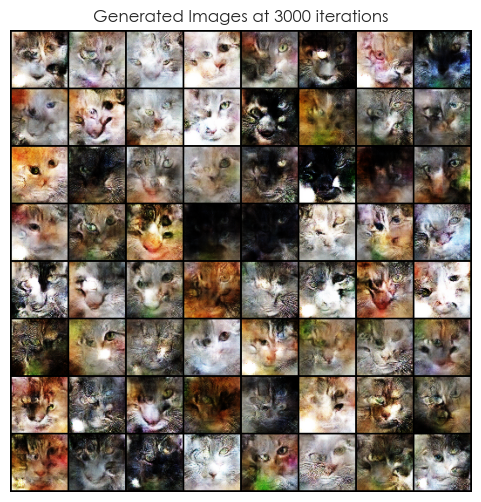

[93/200][25/32] 	Loss_D: -0.0888 | Loss_G: -0.4783 | Iteration Time: 0.4081 sec


Training Progress:  47%|████▋     | 94/200 [09:11<12:46,  7.24s/it]

[93/200][30/32] 	Loss_D: -0.0681 | Loss_G: -0.4252 | Iteration Time: 0.1420 sec
[94/200][0/32] 	Loss_D: -0.0821 | Loss_G: -0.4579 | Iteration Time: 0.1456 sec
[94/200][5/32] 	Loss_D: -0.0788 | Loss_G: -0.4762 | Iteration Time: 0.1435 sec
[94/200][10/32] 	Loss_D: -0.0731 | Loss_G: -0.4831 | Iteration Time: 0.1445 sec
[94/200][15/32] 	Loss_D: -0.0826 | Loss_G: -0.4479 | Iteration Time: 0.1440 sec
[94/200][20/32] 	Loss_D: -0.0820 | Loss_G: -0.4290 | Iteration Time: 0.1405 sec
[94/200][25/32] 	Loss_D: -0.0796 | Loss_G: -0.4865 | Iteration Time: 0.1470 sec


Training Progress:  48%|████▊     | 95/200 [09:17<11:50,  6.77s/it]

[94/200][30/32] 	Loss_D: -0.0765 | Loss_G: -0.4276 | Iteration Time: 0.1435 sec
[95/200][0/32] 	Loss_D: -0.0836 | Loss_G: -0.4705 | Iteration Time: 0.1490 sec
[95/200][5/32] 	Loss_D: -0.0863 | Loss_G: -0.4770 | Iteration Time: 0.1420 sec
[95/200][10/32] 	Loss_D: -0.0781 | Loss_G: -0.4323 | Iteration Time: 0.1420 sec
[95/200][15/32] 	Loss_D: -0.0899 | Loss_G: -0.4336 | Iteration Time: 0.1405 sec
[95/200][20/32] 	Loss_D: -0.0596 | Loss_G: -0.4726 | Iteration Time: 0.1410 sec
[95/200][25/32] 	Loss_D: -0.0771 | Loss_G: -0.4280 | Iteration Time: 0.1390 sec


Training Progress:  48%|████▊     | 96/200 [09:22<11:02,  6.37s/it]

[95/200][30/32] 	Loss_D: -0.0617 | Loss_G: -0.4928 | Iteration Time: 0.1410 sec
[96/200][0/32] 	Loss_D: -0.0682 | Loss_G: -0.4807 | Iteration Time: 0.1565 sec
[96/200][5/32] 	Loss_D: -0.0758 | Loss_G: -0.4295 | Iteration Time: 0.1400 sec
[96/200][10/32] 	Loss_D: -0.0800 | Loss_G: -0.4343 | Iteration Time: 0.1400 sec
[96/200][15/32] 	Loss_D: -0.0780 | Loss_G: -0.4251 | Iteration Time: 0.1410 sec
[96/200][20/32] 	Loss_D: -0.0666 | Loss_G: -0.4270 | Iteration Time: 0.1425 sec
[96/200][25/32] 	Loss_D: -0.0684 | Loss_G: -0.4803 | Iteration Time: 0.1425 sec


Training Progress:  48%|████▊     | 97/200 [09:28<10:28,  6.10s/it]

[96/200][30/32] 	Loss_D: -0.0769 | Loss_G: -0.4791 | Iteration Time: 0.1425 sec
[97/200][0/32] 	Loss_D: -0.0895 | Loss_G: -0.4277 | Iteration Time: 0.1480 sec
[97/200][5/32] 	Loss_D: -0.0793 | Loss_G: -0.4805 | Iteration Time: 0.1440 sec
[97/200][10/32] 	Loss_D: -0.0770 | Loss_G: -0.4242 | Iteration Time: 0.1395 sec
[97/200][15/32] 	Loss_D: -0.0991 | Loss_G: -0.4347 | Iteration Time: 0.1400 sec
[97/200][20/32] 	Loss_D: -0.0574 | Loss_G: -0.4895 | Iteration Time: 0.1415 sec
[97/200][25/32] 	Loss_D: -0.0748 | Loss_G: -0.4274 | Iteration Time: 0.1435 sec


Training Progress:  49%|████▉     | 98/200 [09:33<10:02,  5.91s/it]

[97/200][30/32] 	Loss_D: -0.0836 | Loss_G: -0.4818 | Iteration Time: 0.1395 sec
[98/200][0/32] 	Loss_D: -0.0817 | Loss_G: -0.4471 | Iteration Time: 0.1480 sec
[98/200][5/32] 	Loss_D: -0.0962 | Loss_G: -0.4845 | Iteration Time: 0.1405 sec
[98/200][10/32] 	Loss_D: -0.0852 | Loss_G: -0.4750 | Iteration Time: 0.1380 sec
[98/200][15/32] 	Loss_D: -0.0855 | Loss_G: -0.4300 | Iteration Time: 0.1435 sec
[98/200][20/32] 	Loss_D: -0.0906 | Loss_G: -0.4547 | Iteration Time: 0.1480 sec
[98/200][25/32] 	Loss_D: -0.0720 | Loss_G: -0.4196 | Iteration Time: 0.1410 sec


Training Progress:  50%|████▉     | 99/200 [09:39<09:43,  5.77s/it]

[98/200][30/32] 	Loss_D: -0.0834 | Loss_G: -0.4315 | Iteration Time: 0.1405 sec
[99/200][0/32] 	Loss_D: -0.0771 | Loss_G: -0.4917 | Iteration Time: 0.1535 sec
[99/200][5/32] 	Loss_D: -0.0849 | Loss_G: -0.4224 | Iteration Time: 0.1390 sec
[99/200][10/32] 	Loss_D: -0.0813 | Loss_G: -0.4322 | Iteration Time: 0.1385 sec
[99/200][15/32] 	Loss_D: -0.0693 | Loss_G: -0.4270 | Iteration Time: 0.1435 sec
[99/200][20/32] 	Loss_D: -0.0765 | Loss_G: -0.4924 | Iteration Time: 0.1405 sec
[99/200][25/32] 	Loss_D: -0.0635 | Loss_G: -0.4812 | Iteration Time: 0.1400 sec


Training Progress:  50%|█████     | 100/200 [09:44<09:26,  5.66s/it]

[99/200][30/32] 	Loss_D: -0.0940 | Loss_G: -0.4551 | Iteration Time: 0.1425 sec
[100/200][0/32] 	Loss_D: -0.0838 | Loss_G: -0.4813 | Iteration Time: 0.1550 sec
[100/200][5/32] 	Loss_D: -0.0729 | Loss_G: -0.4225 | Iteration Time: 0.1432 sec
[100/200][10/32] 	Loss_D: -0.0749 | Loss_G: -0.4343 | Iteration Time: 0.1445 sec
[100/200][15/32] 	Loss_D: -0.0851 | Loss_G: -0.4621 | Iteration Time: 0.1420 sec
[100/200][20/32] 	Loss_D: -0.0662 | Loss_G: -0.4263 | Iteration Time: 0.1400 sec
[100/200][25/32] 	Loss_D: -0.0816 | Loss_G: -0.4912 | Iteration Time: 0.1410 sec


Training Progress:  50%|█████     | 101/200 [09:49<09:15,  5.61s/it]

[100/200][30/32] 	Loss_D: -0.0794 | Loss_G: -0.4849 | Iteration Time: 0.1395 sec
[101/200][0/32] 	Loss_D: -0.0797 | Loss_G: -0.4764 | Iteration Time: 0.1465 sec
[101/200][5/32] 	Loss_D: -0.0650 | Loss_G: -0.4293 | Iteration Time: 0.1410 sec
[101/200][10/32] 	Loss_D: -0.0828 | Loss_G: -0.4328 | Iteration Time: 0.1425 sec
[101/200][15/32] 	Loss_D: -0.0727 | Loss_G: -0.4816 | Iteration Time: 0.1390 sec
[101/200][20/32] 	Loss_D: -0.0854 | Loss_G: -0.4912 | Iteration Time: 0.1440 sec
[101/200][25/32] 	Loss_D: -0.0755 | Loss_G: -0.4754 | Iteration Time: 0.1425 sec


Training Progress:  51%|█████     | 102/200 [09:55<09:05,  5.57s/it]

[101/200][30/32] 	Loss_D: -0.0813 | Loss_G: -0.4631 | Iteration Time: 0.1425 sec
[102/200][0/32] 	Loss_D: -0.0783 | Loss_G: -0.4366 | Iteration Time: 0.1505 sec
[102/200][5/32] 	Loss_D: -0.0752 | Loss_G: -0.4995 | Iteration Time: 0.1425 sec
[102/200][10/32] 	Loss_D: -0.0991 | Loss_G: -0.4269 | Iteration Time: 0.1440 sec
[102/200][15/32] 	Loss_D: -0.0673 | Loss_G: -0.4779 | Iteration Time: 0.1445 sec
[102/200][20/32] 	Loss_D: -0.0870 | Loss_G: -0.4684 | Iteration Time: 0.1410 sec
[102/200][25/32] 	Loss_D: -0.0863 | Loss_G: -0.4379 | Iteration Time: 0.1430 sec


Training Progress:  52%|█████▏    | 103/200 [10:00<08:57,  5.54s/it]

[102/200][30/32] 	Loss_D: -0.0807 | Loss_G: -0.4706 | Iteration Time: 0.1455 sec
[103/200][0/32] 	Loss_D: -0.0596 | Loss_G: -0.4855 | Iteration Time: 0.1465 sec
[103/200][5/32] 	Loss_D: -0.0716 | Loss_G: -0.4757 | Iteration Time: 0.1435 sec
[103/200][10/32] 	Loss_D: -0.0763 | Loss_G: -0.4269 | Iteration Time: 0.1485 sec
[103/200][15/32] 	Loss_D: -0.0857 | Loss_G: -0.4242 | Iteration Time: 0.1425 sec
[103/200][20/32] 	Loss_D: -0.0797 | Loss_G: -0.4760 | Iteration Time: 0.1440 sec
[103/200][25/32] 	Loss_D: -0.0693 | Loss_G: -0.5097 | Iteration Time: 0.1390 sec


Training Progress:  52%|█████▏    | 104/200 [10:06<08:50,  5.53s/it]

[103/200][30/32] 	Loss_D: -0.0720 | Loss_G: -0.4719 | Iteration Time: 0.1435 sec
[104/200][0/32] 	Loss_D: -0.0904 | Loss_G: -0.4301 | Iteration Time: 0.1465 sec
[104/200][5/32] 	Loss_D: -0.0983 | Loss_G: -0.4477 | Iteration Time: 0.1420 sec
[104/200][10/32] 	Loss_D: -0.0798 | Loss_G: -0.4239 | Iteration Time: 0.1420 sec
[104/200][15/32] 	Loss_D: -0.0686 | Loss_G: -0.4884 | Iteration Time: 0.1430 sec
[104/200][20/32] 	Loss_D: -0.0938 | Loss_G: -0.4509 | Iteration Time: 0.1420 sec
[104/200][25/32] 	Loss_D: -0.0785 | Loss_G: -0.4275 | Iteration Time: 0.1435 sec


Training Progress:  52%|█████▎    | 105/200 [10:11<08:44,  5.52s/it]

[104/200][30/32] 	Loss_D: -0.0752 | Loss_G: -0.4833 | Iteration Time: 0.1455 sec
[105/200][0/32] 	Loss_D: -0.0790 | Loss_G: -0.4713 | Iteration Time: 0.1448 sec
[105/200][5/32] 	Loss_D: -0.0791 | Loss_G: -0.5030 | Iteration Time: 0.1425 sec
[105/200][10/32] 	Loss_D: -0.0839 | Loss_G: -0.4812 | Iteration Time: 0.1450 sec
[105/200][15/32] 	Loss_D: -0.0752 | Loss_G: -0.4307 | Iteration Time: 0.1410 sec
[105/200][20/32] 	Loss_D: -0.0697 | Loss_G: -0.4656 | Iteration Time: 0.1400 sec
[105/200][25/32] 	Loss_D: -0.0880 | Loss_G: -0.4425 | Iteration Time: 0.1425 sec


Training Progress:  53%|█████▎    | 106/200 [10:17<08:36,  5.50s/it]

[105/200][30/32] 	Loss_D: -0.0824 | Loss_G: -0.4649 | Iteration Time: 0.1395 sec
[106/200][0/32] 	Loss_D: -0.0689 | Loss_G: -0.4989 | Iteration Time: 0.1455 sec
[106/200][5/32] 	Loss_D: -0.0831 | Loss_G: -0.4701 | Iteration Time: 0.1445 sec
[106/200][10/32] 	Loss_D: -0.0825 | Loss_G: -0.4854 | Iteration Time: 0.1390 sec
[106/200][15/32] 	Loss_D: -0.0704 | Loss_G: -0.4733 | Iteration Time: 0.1430 sec
[106/200][20/32] 	Loss_D: -0.0804 | Loss_G: -0.4708 | Iteration Time: 0.1460 sec
[106/200][25/32] 	Loss_D: -0.0811 | Loss_G: -0.4611 | Iteration Time: 0.1415 sec


Training Progress:  54%|█████▎    | 107/200 [10:22<08:30,  5.49s/it]

[106/200][30/32] 	Loss_D: -0.0804 | Loss_G: -0.4625 | Iteration Time: 0.1410 sec
[107/200][0/32] 	Loss_D: -0.0643 | Loss_G: -0.4708 | Iteration Time: 0.1556 sec
[107/200][5/32] 	Loss_D: -0.0738 | Loss_G: -0.4349 | Iteration Time: 0.1425 sec
[107/200][10/32] 	Loss_D: -0.0950 | Loss_G: -0.4563 | Iteration Time: 0.1430 sec
[107/200][15/32] 	Loss_D: -0.0855 | Loss_G: -0.4343 | Iteration Time: 0.1420 sec
[107/200][20/32] 	Loss_D: -0.0790 | Loss_G: -0.4313 | Iteration Time: 0.1420 sec
[107/200][25/32] 	Loss_D: -0.0712 | Loss_G: -0.4706 | Iteration Time: 0.1455 sec


Training Progress:  54%|█████▍    | 108/200 [10:28<08:25,  5.49s/it]

[107/200][30/32] 	Loss_D: -0.0899 | Loss_G: -0.4254 | Iteration Time: 0.1400 sec
[108/200][0/32] 	Loss_D: -0.0970 | Loss_G: -0.4517 | Iteration Time: 0.1475 sec
[108/200][5/32] 	Loss_D: -0.0794 | Loss_G: -0.4307 | Iteration Time: 0.1440 sec
[108/200][10/32] 	Loss_D: -0.0854 | Loss_G: -0.4725 | Iteration Time: 0.1415 sec
[108/200][15/32] 	Loss_D: -0.0914 | Loss_G: -0.4530 | Iteration Time: 0.1415 sec
[108/200][20/32] 	Loss_D: -0.0747 | Loss_G: -0.4814 | Iteration Time: 0.1460 sec
[108/200][25/32] 	Loss_D: -0.0702 | Loss_G: -0.4824 | Iteration Time: 0.1425 sec


Training Progress:  55%|█████▍    | 109/200 [10:33<08:20,  5.50s/it]

[108/200][30/32] 	Loss_D: -0.0746 | Loss_G: -0.4304 | Iteration Time: 0.1446 sec
[109/200][0/32] 	Loss_D: -0.0799 | Loss_G: -0.4743 | Iteration Time: 0.1605 sec
[109/200][5/32] 	Loss_D: -0.0821 | Loss_G: -0.4207 | Iteration Time: 0.1410 sec
[109/200][10/32] 	Loss_D: -0.0996 | Loss_G: -0.4329 | Iteration Time: 0.1425 sec
Current scores at iteration 3500 | FID: 204.6544647216797 | IS: 2.431602954864502


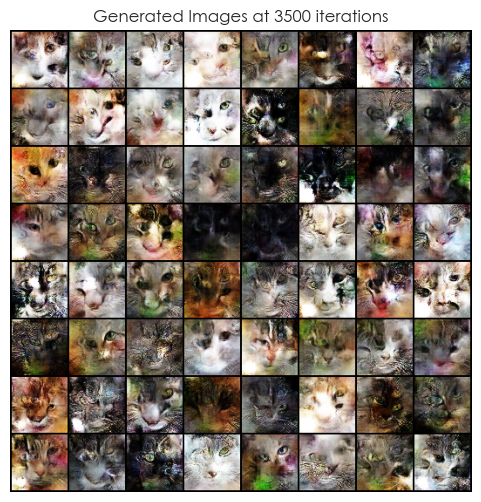

[109/200][15/32] 	Loss_D: -0.0919 | Loss_G: -0.4413 | Iteration Time: 0.1385 sec
[109/200][20/32] 	Loss_D: -0.0910 | Loss_G: -0.4246 | Iteration Time: 0.1450 sec
[109/200][25/32] 	Loss_D: -0.0797 | Loss_G: -0.4323 | Iteration Time: 0.1435 sec


Training Progress:  55%|█████▌    | 110/200 [10:44<10:44,  7.16s/it]

[109/200][30/32] 	Loss_D: -0.0825 | Loss_G: -0.4264 | Iteration Time: 0.1450 sec
[110/200][0/32] 	Loss_D: -0.0917 | Loss_G: -0.4648 | Iteration Time: 0.1545 sec
[110/200][5/32] 	Loss_D: -0.0773 | Loss_G: -0.4858 | Iteration Time: 0.1440 sec
[110/200][10/32] 	Loss_D: -0.0710 | Loss_G: -0.4304 | Iteration Time: 0.1470 sec
[110/200][15/32] 	Loss_D: -0.0952 | Loss_G: -0.4327 | Iteration Time: 0.1435 sec
[110/200][20/32] 	Loss_D: -0.0755 | Loss_G: -0.4229 | Iteration Time: 0.1425 sec
[110/200][25/32] 	Loss_D: -0.0889 | Loss_G: -0.4491 | Iteration Time: 0.1445 sec


Training Progress:  56%|█████▌    | 111/200 [10:50<09:53,  6.67s/it]

[110/200][30/32] 	Loss_D: -0.0713 | Loss_G: -0.4712 | Iteration Time: 0.1445 sec
[111/200][0/32] 	Loss_D: -0.0853 | Loss_G: -0.4873 | Iteration Time: 0.1540 sec
[111/200][5/32] 	Loss_D: -0.0841 | Loss_G: -0.4299 | Iteration Time: 0.1410 sec
[111/200][10/32] 	Loss_D: -0.0591 | Loss_G: -0.4845 | Iteration Time: 0.1435 sec
[111/200][15/32] 	Loss_D: -0.0822 | Loss_G: -0.4942 | Iteration Time: 0.1480 sec
[111/200][20/32] 	Loss_D: -0.0952 | Loss_G: -0.4624 | Iteration Time: 0.1445 sec
[111/200][25/32] 	Loss_D: -0.0947 | Loss_G: -0.4663 | Iteration Time: 0.1450 sec


Training Progress:  56%|█████▌    | 112/200 [10:55<09:17,  6.33s/it]

[111/200][30/32] 	Loss_D: -0.0732 | Loss_G: -0.4229 | Iteration Time: 0.1435 sec
[112/200][0/32] 	Loss_D: -0.0905 | Loss_G: -0.4562 | Iteration Time: 0.1475 sec
[112/200][5/32] 	Loss_D: -0.0720 | Loss_G: -0.4939 | Iteration Time: 0.1440 sec
[112/200][10/32] 	Loss_D: -0.0710 | Loss_G: -0.4215 | Iteration Time: 0.1415 sec
[112/200][15/32] 	Loss_D: -0.0752 | Loss_G: -0.4772 | Iteration Time: 0.1455 sec
[112/200][20/32] 	Loss_D: -0.0661 | Loss_G: -0.4823 | Iteration Time: 0.1425 sec
[112/200][25/32] 	Loss_D: -0.0837 | Loss_G: -0.4363 | Iteration Time: 0.1415 sec


Training Progress:  56%|█████▋    | 113/200 [11:01<08:50,  6.09s/it]

[112/200][30/32] 	Loss_D: -0.0794 | Loss_G: -0.4813 | Iteration Time: 0.1444 sec
[113/200][0/32] 	Loss_D: -0.0831 | Loss_G: -0.4814 | Iteration Time: 0.1455 sec
[113/200][5/32] 	Loss_D: -0.0685 | Loss_G: -0.4756 | Iteration Time: 0.1415 sec
[113/200][10/32] 	Loss_D: -0.0637 | Loss_G: -0.4660 | Iteration Time: 0.1460 sec
[113/200][15/32] 	Loss_D: -0.0596 | Loss_G: -0.4847 | Iteration Time: 0.1420 sec
[113/200][20/32] 	Loss_D: -0.0711 | Loss_G: -0.4873 | Iteration Time: 0.1430 sec
[113/200][25/32] 	Loss_D: -0.0677 | Loss_G: -0.4909 | Iteration Time: 0.1440 sec


Training Progress:  57%|█████▋    | 114/200 [11:07<08:29,  5.93s/it]

[113/200][30/32] 	Loss_D: -0.0783 | Loss_G: -0.4258 | Iteration Time: 0.1440 sec
[114/200][0/32] 	Loss_D: -0.0738 | Loss_G: -0.4299 | Iteration Time: 0.1565 sec
[114/200][5/32] 	Loss_D: -0.0761 | Loss_G: -0.4836 | Iteration Time: 0.1445 sec
[114/200][10/32] 	Loss_D: -0.0775 | Loss_G: -0.4280 | Iteration Time: 0.1480 sec
[114/200][15/32] 	Loss_D: -0.0851 | Loss_G: -0.4788 | Iteration Time: 0.1440 sec
[114/200][20/32] 	Loss_D: -0.0737 | Loss_G: -0.4259 | Iteration Time: 0.1415 sec
[114/200][25/32] 	Loss_D: -0.0655 | Loss_G: -0.4817 | Iteration Time: 0.1455 sec


Training Progress:  57%|█████▊    | 115/200 [11:12<08:14,  5.81s/it]

[114/200][30/32] 	Loss_D: -0.0635 | Loss_G: -0.4843 | Iteration Time: 0.1420 sec
[115/200][0/32] 	Loss_D: -0.0685 | Loss_G: -0.4245 | Iteration Time: 0.1550 sec
[115/200][5/32] 	Loss_D: -0.0694 | Loss_G: -0.4775 | Iteration Time: 0.1430 sec
[115/200][10/32] 	Loss_D: -0.0765 | Loss_G: -0.4289 | Iteration Time: 0.1420 sec
[115/200][15/32] 	Loss_D: -0.0832 | Loss_G: -0.4845 | Iteration Time: 0.1445 sec
[115/200][20/32] 	Loss_D: -0.0759 | Loss_G: -0.4756 | Iteration Time: 0.1400 sec
[115/200][25/32] 	Loss_D: -0.0591 | Loss_G: -0.4778 | Iteration Time: 0.1445 sec


Training Progress:  58%|█████▊    | 116/200 [11:18<08:01,  5.73s/it]

[115/200][30/32] 	Loss_D: -0.0697 | Loss_G: -0.4237 | Iteration Time: 0.1450 sec
[116/200][0/32] 	Loss_D: -0.0798 | Loss_G: -0.4921 | Iteration Time: 0.1501 sec
[116/200][5/32] 	Loss_D: -0.0888 | Loss_G: -0.4382 | Iteration Time: 0.1470 sec
[116/200][10/32] 	Loss_D: -0.0634 | Loss_G: -0.4270 | Iteration Time: 0.1460 sec
[116/200][15/32] 	Loss_D: -0.0927 | Loss_G: -0.4244 | Iteration Time: 0.1460 sec
[116/200][20/32] 	Loss_D: -0.0831 | Loss_G: -0.4702 | Iteration Time: 0.1425 sec
[116/200][25/32] 	Loss_D: -0.0747 | Loss_G: -0.4271 | Iteration Time: 0.1405 sec


Training Progress:  58%|█████▊    | 117/200 [11:23<07:51,  5.68s/it]

[116/200][30/32] 	Loss_D: -0.0875 | Loss_G: -0.4717 | Iteration Time: 0.1465 sec
[117/200][0/32] 	Loss_D: -0.0640 | Loss_G: -0.4714 | Iteration Time: 0.1465 sec
[117/200][5/32] 	Loss_D: -0.0806 | Loss_G: -0.4986 | Iteration Time: 0.1410 sec
[117/200][10/32] 	Loss_D: -0.0727 | Loss_G: -0.4774 | Iteration Time: 0.1415 sec
[117/200][15/32] 	Loss_D: -0.0747 | Loss_G: -0.4840 | Iteration Time: 0.1420 sec
[117/200][20/32] 	Loss_D: -0.0909 | Loss_G: -0.4482 | Iteration Time: 0.1440 sec
[117/200][25/32] 	Loss_D: -0.0768 | Loss_G: -0.4244 | Iteration Time: 0.1430 sec


Training Progress:  59%|█████▉    | 118/200 [11:29<07:42,  5.64s/it]

[117/200][30/32] 	Loss_D: -0.0765 | Loss_G: -0.4860 | Iteration Time: 0.1445 sec
[118/200][0/32] 	Loss_D: -0.0837 | Loss_G: -0.4402 | Iteration Time: 0.1585 sec
[118/200][5/32] 	Loss_D: -0.0890 | Loss_G: -0.4654 | Iteration Time: 0.1440 sec
[118/200][10/32] 	Loss_D: -0.0620 | Loss_G: -0.4963 | Iteration Time: 0.1485 sec
[118/200][15/32] 	Loss_D: -0.0761 | Loss_G: -0.4916 | Iteration Time: 0.1455 sec
[118/200][20/32] 	Loss_D: -0.0874 | Loss_G: -0.4697 | Iteration Time: 0.1430 sec
[118/200][25/32] 	Loss_D: -0.0687 | Loss_G: -0.4773 | Iteration Time: 0.1560 sec


Training Progress:  60%|█████▉    | 119/200 [11:34<07:36,  5.63s/it]

[118/200][30/32] 	Loss_D: -0.0785 | Loss_G: -0.4264 | Iteration Time: 0.1445 sec
[119/200][0/32] 	Loss_D: -0.0764 | Loss_G: -0.4475 | Iteration Time: 0.1600 sec
[119/200][5/32] 	Loss_D: -0.0731 | Loss_G: -0.4354 | Iteration Time: 0.1500 sec
[119/200][10/32] 	Loss_D: -0.0765 | Loss_G: -0.4202 | Iteration Time: 0.1445 sec
[119/200][15/32] 	Loss_D: -0.0855 | Loss_G: -0.4744 | Iteration Time: 0.1441 sec
[119/200][20/32] 	Loss_D: -0.0850 | Loss_G: -0.4853 | Iteration Time: 0.1460 sec
[119/200][25/32] 	Loss_D: -0.0756 | Loss_G: -0.4744 | Iteration Time: 0.1445 sec


Training Progress:  60%|██████    | 120/200 [11:40<07:29,  5.62s/it]

[119/200][30/32] 	Loss_D: -0.0797 | Loss_G: -0.4280 | Iteration Time: 0.1445 sec
[120/200][0/32] 	Loss_D: -0.0795 | Loss_G: -0.4791 | Iteration Time: 0.1605 sec
[120/200][5/32] 	Loss_D: -0.0677 | Loss_G: -0.4289 | Iteration Time: 0.1400 sec
[120/200][10/32] 	Loss_D: -0.0858 | Loss_G: -0.4276 | Iteration Time: 0.1485 sec
[120/200][15/32] 	Loss_D: -0.0761 | Loss_G: -0.4315 | Iteration Time: 0.1440 sec
[120/200][20/32] 	Loss_D: -0.0825 | Loss_G: -0.4651 | Iteration Time: 0.1460 sec
[120/200][25/32] 	Loss_D: -0.0679 | Loss_G: -0.4251 | Iteration Time: 0.1435 sec


Training Progress:  60%|██████    | 121/200 [11:46<07:22,  5.61s/it]

[120/200][30/32] 	Loss_D: -0.0751 | Loss_G: -0.4415 | Iteration Time: 0.1450 sec
[121/200][0/32] 	Loss_D: -0.0740 | Loss_G: -0.4808 | Iteration Time: 0.1570 sec
[121/200][5/32] 	Loss_D: -0.0755 | Loss_G: -0.4183 | Iteration Time: 0.1460 sec
[121/200][10/32] 	Loss_D: -0.0765 | Loss_G: -0.4601 | Iteration Time: 0.1450 sec
[121/200][15/32] 	Loss_D: -0.0659 | Loss_G: -0.4867 | Iteration Time: 0.1450 sec
[121/200][20/32] 	Loss_D: -0.0588 | Loss_G: -0.5024 | Iteration Time: 0.1435 sec
[121/200][25/32] 	Loss_D: -0.0680 | Loss_G: -0.4283 | Iteration Time: 0.1490 sec


Training Progress:  61%|██████    | 122/200 [11:51<07:16,  5.59s/it]

[121/200][30/32] 	Loss_D: -0.0903 | Loss_G: -0.4285 | Iteration Time: 0.1445 sec
[122/200][0/32] 	Loss_D: -0.0742 | Loss_G: -0.4803 | Iteration Time: 0.1515 sec
[122/200][5/32] 	Loss_D: -0.0474 | Loss_G: -0.4849 | Iteration Time: 0.1400 sec
[122/200][10/32] 	Loss_D: -0.0881 | Loss_G: -0.4486 | Iteration Time: 0.1440 sec
[122/200][15/32] 	Loss_D: -0.0941 | Loss_G: -0.4868 | Iteration Time: 0.1490 sec
[122/200][20/32] 	Loss_D: -0.0736 | Loss_G: -0.4902 | Iteration Time: 0.1430 sec
[122/200][25/32] 	Loss_D: -0.0726 | Loss_G: -0.4248 | Iteration Time: 0.1470 sec


Training Progress:  62%|██████▏   | 123/200 [11:57<07:09,  5.58s/it]

[122/200][30/32] 	Loss_D: -0.0741 | Loss_G: -0.4276 | Iteration Time: 0.1410 sec
[123/200][0/32] 	Loss_D: -0.0768 | Loss_G: -0.4853 | Iteration Time: 0.1465 sec
[123/200][5/32] 	Loss_D: -0.0742 | Loss_G: -0.4963 | Iteration Time: 0.1485 sec
[123/200][10/32] 	Loss_D: -0.0795 | Loss_G: -0.4429 | Iteration Time: 0.1450 sec
[123/200][15/32] 	Loss_D: -0.0815 | Loss_G: -0.4639 | Iteration Time: 0.1440 sec
[123/200][20/32] 	Loss_D: -0.0794 | Loss_G: -0.4684 | Iteration Time: 0.1435 sec
[123/200][25/32] 	Loss_D: -0.0718 | Loss_G: -0.4814 | Iteration Time: 0.1435 sec


Training Progress:  62%|██████▏   | 124/200 [12:02<07:03,  5.58s/it]

[123/200][30/32] 	Loss_D: -0.0677 | Loss_G: -0.4433 | Iteration Time: 0.1495 sec
[124/200][0/32] 	Loss_D: -0.0844 | Loss_G: -0.4368 | Iteration Time: 0.1470 sec
[124/200][5/32] 	Loss_D: -0.0635 | Loss_G: -0.4732 | Iteration Time: 0.1435 sec
[124/200][10/32] 	Loss_D: -0.0717 | Loss_G: -0.4366 | Iteration Time: 0.1445 sec
[124/200][15/32] 	Loss_D: -0.0903 | Loss_G: -0.4325 | Iteration Time: 0.1454 sec
[124/200][20/32] 	Loss_D: -0.0713 | Loss_G: -0.4804 | Iteration Time: 0.1410 sec
[124/200][25/32] 	Loss_D: -0.0602 | Loss_G: -0.4285 | Iteration Time: 0.1445 sec


Training Progress:  62%|██████▎   | 125/200 [12:08<06:58,  5.58s/it]

[124/200][30/32] 	Loss_D: -0.0552 | Loss_G: -0.4727 | Iteration Time: 0.1470 sec
[125/200][0/32] 	Loss_D: -0.0918 | Loss_G: -0.4607 | Iteration Time: 0.1460 sec
Current scores at iteration 4000 | FID: 194.5837860107422 | IS: 2.361433506011963


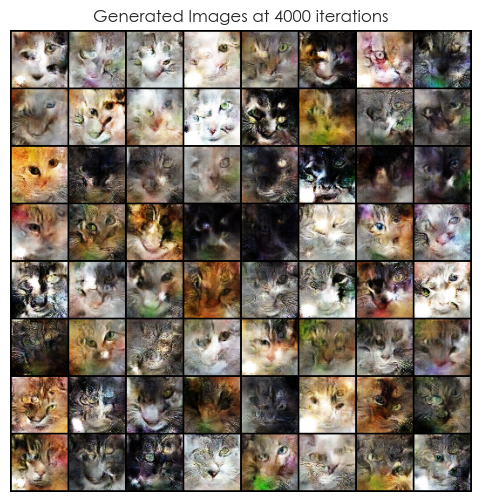

[125/200][5/32] 	Loss_D: -0.0843 | Loss_G: -0.4592 | Iteration Time: 0.1395 sec
[125/200][10/32] 	Loss_D: -0.0914 | Loss_G: -0.4853 | Iteration Time: 0.1425 sec
[125/200][15/32] 	Loss_D: -0.0732 | Loss_G: -0.4778 | Iteration Time: 0.1425 sec
[125/200][20/32] 	Loss_D: -0.0720 | Loss_G: -0.4345 | Iteration Time: 0.1440 sec
[125/200][25/32] 	Loss_D: -0.0903 | Loss_G: -0.4229 | Iteration Time: 0.1445 sec


Training Progress:  63%|██████▎   | 126/200 [12:19<08:55,  7.24s/it]

[125/200][30/32] 	Loss_D: -0.0824 | Loss_G: -0.4703 | Iteration Time: 0.1440 sec
[126/200][0/32] 	Loss_D: -0.0732 | Loss_G: -0.4791 | Iteration Time: 0.1550 sec
[126/200][5/32] 	Loss_D: -0.0741 | Loss_G: -0.4876 | Iteration Time: 0.1455 sec
[126/200][10/32] 	Loss_D: -0.0741 | Loss_G: -0.4820 | Iteration Time: 0.1425 sec
[126/200][15/32] 	Loss_D: -0.0640 | Loss_G: -0.4284 | Iteration Time: 0.1430 sec
[126/200][20/32] 	Loss_D: -0.0699 | Loss_G: -0.4336 | Iteration Time: 0.1405 sec
[126/200][25/32] 	Loss_D: -0.0690 | Loss_G: -0.4766 | Iteration Time: 0.1465 sec


Training Progress:  64%|██████▎   | 127/200 [12:24<08:11,  6.73s/it]

[126/200][30/32] 	Loss_D: -0.0809 | Loss_G: -0.4711 | Iteration Time: 0.1456 sec
[127/200][0/32] 	Loss_D: -0.0856 | Loss_G: -0.4243 | Iteration Time: 0.1485 sec
[127/200][5/32] 	Loss_D: -0.0736 | Loss_G: -0.4523 | Iteration Time: 0.1415 sec
[127/200][10/32] 	Loss_D: -0.0701 | Loss_G: -0.4689 | Iteration Time: 0.1430 sec
[127/200][15/32] 	Loss_D: -0.0496 | Loss_G: -0.4818 | Iteration Time: 0.1490 sec
[127/200][20/32] 	Loss_D: -0.0673 | Loss_G: -0.4965 | Iteration Time: 0.1445 sec
[127/200][25/32] 	Loss_D: -0.0626 | Loss_G: -0.4865 | Iteration Time: 0.1455 sec


Training Progress:  64%|██████▍   | 128/200 [12:30<07:39,  6.38s/it]

[127/200][30/32] 	Loss_D: -0.0723 | Loss_G: -0.4795 | Iteration Time: 0.1450 sec
[128/200][0/32] 	Loss_D: -0.0693 | Loss_G: -0.4836 | Iteration Time: 0.1450 sec
[128/200][5/32] 	Loss_D: -0.0774 | Loss_G: -0.4268 | Iteration Time: 0.1465 sec
[128/200][10/32] 	Loss_D: -0.0675 | Loss_G: -0.4334 | Iteration Time: 0.1445 sec
[128/200][15/32] 	Loss_D: -0.0880 | Loss_G: -0.4272 | Iteration Time: 0.1451 sec
[128/200][20/32] 	Loss_D: -0.0825 | Loss_G: -0.4598 | Iteration Time: 0.1440 sec
[128/200][25/32] 	Loss_D: -0.0698 | Loss_G: -0.4913 | Iteration Time: 0.1435 sec


Training Progress:  64%|██████▍   | 129/200 [12:36<07:15,  6.14s/it]

[128/200][30/32] 	Loss_D: -0.0773 | Loss_G: -0.4763 | Iteration Time: 0.1475 sec
[129/200][0/32] 	Loss_D: -0.0720 | Loss_G: -0.4879 | Iteration Time: 0.1430 sec
[129/200][5/32] 	Loss_D: -0.0810 | Loss_G: -0.4519 | Iteration Time: 0.1450 sec
[129/200][10/32] 	Loss_D: -0.0756 | Loss_G: -0.4857 | Iteration Time: 0.1400 sec
[129/200][15/32] 	Loss_D: -0.0740 | Loss_G: -0.4279 | Iteration Time: 0.1435 sec
[129/200][20/32] 	Loss_D: -0.0657 | Loss_G: -0.4836 | Iteration Time: 0.1435 sec
[129/200][25/32] 	Loss_D: -0.0670 | Loss_G: -0.4903 | Iteration Time: 0.1410 sec


Training Progress:  65%|██████▌   | 130/200 [12:41<06:55,  5.94s/it]

[129/200][30/32] 	Loss_D: -0.0713 | Loss_G: -0.4851 | Iteration Time: 0.1400 sec
[130/200][0/32] 	Loss_D: -0.0691 | Loss_G: -0.4903 | Iteration Time: 0.1530 sec
[130/200][5/32] 	Loss_D: -0.0773 | Loss_G: -0.4310 | Iteration Time: 0.1430 sec
[130/200][10/32] 	Loss_D: -0.0726 | Loss_G: -0.4993 | Iteration Time: 0.1425 sec
[130/200][15/32] 	Loss_D: -0.0754 | Loss_G: -0.4779 | Iteration Time: 0.1465 sec
[130/200][20/32] 	Loss_D: -0.0808 | Loss_G: -0.4793 | Iteration Time: 0.1455 sec
[130/200][25/32] 	Loss_D: -0.0907 | Loss_G: -0.4509 | Iteration Time: 0.1455 sec


Training Progress:  66%|██████▌   | 131/200 [12:47<06:41,  5.82s/it]

[130/200][30/32] 	Loss_D: -0.0778 | Loss_G: -0.4349 | Iteration Time: 0.1415 sec
[131/200][0/32] 	Loss_D: -0.0872 | Loss_G: -0.4392 | Iteration Time: 0.1505 sec
[131/200][5/32] 	Loss_D: -0.0621 | Loss_G: -0.4844 | Iteration Time: 0.1455 sec
[131/200][10/32] 	Loss_D: -0.0642 | Loss_G: -0.4257 | Iteration Time: 0.1395 sec
[131/200][15/32] 	Loss_D: -0.0832 | Loss_G: -0.4753 | Iteration Time: 0.1435 sec
[131/200][20/32] 	Loss_D: -0.0752 | Loss_G: -0.4283 | Iteration Time: 0.1445 sec
[131/200][25/32] 	Loss_D: -0.0701 | Loss_G: -0.4332 | Iteration Time: 0.1410 sec


Training Progress:  66%|██████▌   | 132/200 [12:52<06:30,  5.74s/it]

[131/200][30/32] 	Loss_D: -0.0853 | Loss_G: -0.4518 | Iteration Time: 0.1455 sec
[132/200][0/32] 	Loss_D: -0.0903 | Loss_G: -0.4404 | Iteration Time: 0.1485 sec
[132/200][5/32] 	Loss_D: -0.0811 | Loss_G: -0.4714 | Iteration Time: 0.1410 sec
[132/200][10/32] 	Loss_D: -0.0757 | Loss_G: -0.4706 | Iteration Time: 0.1485 sec
[132/200][15/32] 	Loss_D: -0.0773 | Loss_G: -0.4621 | Iteration Time: 0.1401 sec
[132/200][20/32] 	Loss_D: -0.0783 | Loss_G: -0.4814 | Iteration Time: 0.1403 sec
[132/200][25/32] 	Loss_D: -0.0818 | Loss_G: -0.4302 | Iteration Time: 0.1390 sec


Training Progress:  66%|██████▋   | 133/200 [12:58<06:19,  5.67s/it]

[132/200][30/32] 	Loss_D: -0.0742 | Loss_G: -0.4424 | Iteration Time: 0.1400 sec
[133/200][0/32] 	Loss_D: -0.0934 | Loss_G: -0.4351 | Iteration Time: 0.1495 sec
[133/200][5/32] 	Loss_D: -0.0843 | Loss_G: -0.4807 | Iteration Time: 0.1415 sec
[133/200][10/32] 	Loss_D: -0.0816 | Loss_G: -0.4329 | Iteration Time: 0.1420 sec
[133/200][15/32] 	Loss_D: -0.0960 | Loss_G: -0.4358 | Iteration Time: 0.1470 sec
[133/200][20/32] 	Loss_D: -0.0845 | Loss_G: -0.4295 | Iteration Time: 0.1405 sec
[133/200][25/32] 	Loss_D: -0.0681 | Loss_G: -0.4805 | Iteration Time: 0.1460 sec


Training Progress:  67%|██████▋   | 134/200 [13:03<06:11,  5.63s/it]

[133/200][30/32] 	Loss_D: -0.0709 | Loss_G: -0.4707 | Iteration Time: 0.1418 sec
[134/200][0/32] 	Loss_D: -0.0646 | Loss_G: -0.4855 | Iteration Time: 0.1490 sec
[134/200][5/32] 	Loss_D: -0.0733 | Loss_G: -0.4259 | Iteration Time: 0.1460 sec
[134/200][10/32] 	Loss_D: -0.0815 | Loss_G: -0.4902 | Iteration Time: 0.1450 sec
[134/200][15/32] 	Loss_D: -0.0892 | Loss_G: -0.4347 | Iteration Time: 0.1435 sec
[134/200][20/32] 	Loss_D: -0.0955 | Loss_G: -0.4656 | Iteration Time: 0.1440 sec
[134/200][25/32] 	Loss_D: -0.0862 | Loss_G: -0.4800 | Iteration Time: 0.1440 sec


Training Progress:  68%|██████▊   | 135/200 [13:09<06:04,  5.61s/it]

[134/200][30/32] 	Loss_D: -0.0681 | Loss_G: -0.4847 | Iteration Time: 0.1455 sec
[135/200][0/32] 	Loss_D: -0.0725 | Loss_G: -0.4879 | Iteration Time: 0.1450 sec
[135/200][5/32] 	Loss_D: -0.0688 | Loss_G: -0.5047 | Iteration Time: 0.1415 sec
[135/200][10/32] 	Loss_D: -0.0387 | Loss_G: -0.4675 | Iteration Time: 0.1425 sec
[135/200][15/32] 	Loss_D: -0.0725 | Loss_G: -0.4208 | Iteration Time: 0.1455 sec
[135/200][20/32] 	Loss_D: -0.0665 | Loss_G: -0.4843 | Iteration Time: 0.1475 sec
[135/200][25/32] 	Loss_D: -0.0802 | Loss_G: -0.4296 | Iteration Time: 0.1445 sec


Training Progress:  68%|██████▊   | 136/200 [13:14<05:58,  5.60s/it]

[135/200][30/32] 	Loss_D: -0.0658 | Loss_G: -0.5026 | Iteration Time: 0.1460 sec
[136/200][0/32] 	Loss_D: -0.0739 | Loss_G: -0.4435 | Iteration Time: 0.1605 sec
[136/200][5/32] 	Loss_D: -0.0690 | Loss_G: -0.4748 | Iteration Time: 0.1450 sec
[136/200][10/32] 	Loss_D: -0.0622 | Loss_G: -0.4880 | Iteration Time: 0.1480 sec
[136/200][15/32] 	Loss_D: -0.0810 | Loss_G: -0.4785 | Iteration Time: 0.1440 sec
[136/200][20/32] 	Loss_D: -0.0687 | Loss_G: -0.4871 | Iteration Time: 0.1425 sec
[136/200][25/32] 	Loss_D: -0.0622 | Loss_G: -0.4775 | Iteration Time: 0.1435 sec


Training Progress:  68%|██████▊   | 137/200 [13:20<05:51,  5.58s/it]

[136/200][30/32] 	Loss_D: -0.0637 | Loss_G: -0.4255 | Iteration Time: 0.1405 sec
[137/200][0/32] 	Loss_D: -0.0725 | Loss_G: -0.4815 | Iteration Time: 0.1560 sec
[137/200][5/32] 	Loss_D: -0.0639 | Loss_G: -0.4321 | Iteration Time: 0.1400 sec
[137/200][10/32] 	Loss_D: -0.0638 | Loss_G: -0.4891 | Iteration Time: 0.1437 sec
[137/200][15/32] 	Loss_D: -0.0630 | Loss_G: -0.4927 | Iteration Time: 0.1488 sec
[137/200][20/32] 	Loss_D: -0.0684 | Loss_G: -0.4198 | Iteration Time: 0.1420 sec
[137/200][25/32] 	Loss_D: -0.0680 | Loss_G: -0.4263 | Iteration Time: 0.1445 sec


Training Progress:  69%|██████▉   | 138/200 [13:25<05:45,  5.57s/it]

[137/200][30/32] 	Loss_D: -0.0702 | Loss_G: -0.4876 | Iteration Time: 0.1450 sec
[138/200][0/32] 	Loss_D: -0.0748 | Loss_G: -0.4713 | Iteration Time: 0.1485 sec
[138/200][5/32] 	Loss_D: -0.0691 | Loss_G: -0.4937 | Iteration Time: 0.1480 sec
[138/200][10/32] 	Loss_D: -0.0797 | Loss_G: -0.4262 | Iteration Time: 0.1415 sec
[138/200][15/32] 	Loss_D: -0.0758 | Loss_G: -0.4802 | Iteration Time: 0.1440 sec
[138/200][20/32] 	Loss_D: -0.0845 | Loss_G: -0.4577 | Iteration Time: 0.1460 sec
[138/200][25/32] 	Loss_D: -0.0748 | Loss_G: -0.4819 | Iteration Time: 0.1409 sec


Training Progress:  70%|██████▉   | 139/200 [13:31<05:38,  5.55s/it]

[138/200][30/32] 	Loss_D: -0.0781 | Loss_G: -0.4741 | Iteration Time: 0.1455 sec
[139/200][0/32] 	Loss_D: -0.0968 | Loss_G: -0.4384 | Iteration Time: 0.1570 sec
[139/200][5/32] 	Loss_D: -0.0635 | Loss_G: -0.4840 | Iteration Time: 0.1435 sec
[139/200][10/32] 	Loss_D: -0.0800 | Loss_G: -0.4758 | Iteration Time: 0.1445 sec
[139/200][15/32] 	Loss_D: -0.0755 | Loss_G: -0.4809 | Iteration Time: 0.1430 sec
[139/200][20/32] 	Loss_D: -0.0843 | Loss_G: -0.4325 | Iteration Time: 0.1440 sec
[139/200][25/32] 	Loss_D: -0.0619 | Loss_G: -0.4899 | Iteration Time: 0.1440 sec


Training Progress:  70%|███████   | 140/200 [13:36<05:32,  5.55s/it]

[139/200][30/32] 	Loss_D: -0.0771 | Loss_G: -0.4908 | Iteration Time: 0.1440 sec
[140/200][0/32] 	Loss_D: -0.0836 | Loss_G: -0.4344 | Iteration Time: 0.1555 sec
[140/200][5/32] 	Loss_D: -0.0894 | Loss_G: -0.4430 | Iteration Time: 0.1530 sec
[140/200][10/32] 	Loss_D: -0.0602 | Loss_G: -0.4470 | Iteration Time: 0.1560 sec
[140/200][15/32] 	Loss_D: -0.0730 | Loss_G: -0.4648 | Iteration Time: 0.1472 sec
[140/200][20/32] 	Loss_D: -0.0803 | Loss_G: -0.4763 | Iteration Time: 0.1575 sec
Current scores at iteration 4500 | FID: 171.5572509765625 | IS: 2.464463710784912


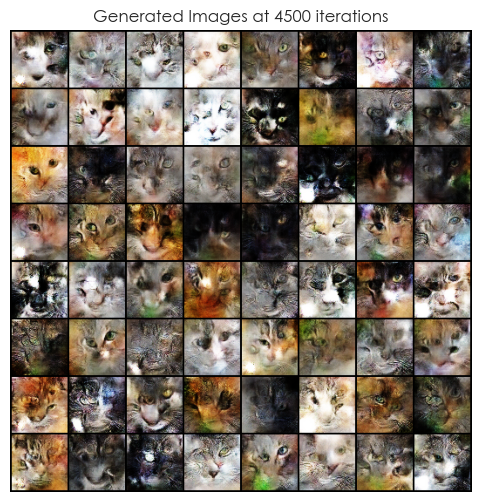

[140/200][25/32] 	Loss_D: -0.0624 | Loss_G: -0.4812 | Iteration Time: 0.1430 sec


Training Progress:  70%|███████   | 141/200 [13:48<07:07,  7.25s/it]

[140/200][30/32] 	Loss_D: -0.0964 | Loss_G: -0.4857 | Iteration Time: 0.1455 sec
[141/200][0/32] 	Loss_D: -0.0847 | Loss_G: -0.4347 | Iteration Time: 0.1598 sec
[141/200][5/32] 	Loss_D: -0.0721 | Loss_G: -0.4935 | Iteration Time: 0.1440 sec
[141/200][10/32] 	Loss_D: -0.0605 | Loss_G: -0.4264 | Iteration Time: 0.1500 sec
[141/200][15/32] 	Loss_D: -0.0721 | Loss_G: -0.4262 | Iteration Time: 0.1485 sec
[141/200][20/32] 	Loss_D: -0.0561 | Loss_G: -0.4318 | Iteration Time: 0.1475 sec
[141/200][25/32] 	Loss_D: -0.0668 | Loss_G: -0.4281 | Iteration Time: 0.1505 sec


Training Progress:  71%|███████   | 142/200 [13:53<06:33,  6.79s/it]

[141/200][30/32] 	Loss_D: -0.0569 | Loss_G: -0.4281 | Iteration Time: 0.1445 sec
[142/200][0/32] 	Loss_D: -0.0675 | Loss_G: -0.4810 | Iteration Time: 0.1470 sec
[142/200][5/32] 	Loss_D: -0.0671 | Loss_G: -0.4786 | Iteration Time: 0.1465 sec
[142/200][10/32] 	Loss_D: -0.0734 | Loss_G: -0.4977 | Iteration Time: 0.1400 sec
[142/200][15/32] 	Loss_D: -0.0862 | Loss_G: -0.4295 | Iteration Time: 0.1425 sec
[142/200][20/32] 	Loss_D: -0.0731 | Loss_G: -0.4878 | Iteration Time: 0.1475 sec
[142/200][25/32] 	Loss_D: -0.0766 | Loss_G: -0.4813 | Iteration Time: 0.1425 sec


Training Progress:  72%|███████▏  | 143/200 [13:59<06:05,  6.41s/it]

[142/200][30/32] 	Loss_D: -0.0708 | Loss_G: -0.4706 | Iteration Time: 0.1445 sec
[143/200][0/32] 	Loss_D: -0.0919 | Loss_G: -0.4449 | Iteration Time: 0.1540 sec
[143/200][5/32] 	Loss_D: -0.0681 | Loss_G: -0.4932 | Iteration Time: 0.1420 sec
[143/200][10/32] 	Loss_D: -0.0688 | Loss_G: -0.4813 | Iteration Time: 0.1475 sec
[143/200][15/32] 	Loss_D: -0.0834 | Loss_G: -0.4739 | Iteration Time: 0.1535 sec
[143/200][20/32] 	Loss_D: -0.0866 | Loss_G: -0.4530 | Iteration Time: 0.1485 sec
[143/200][25/32] 	Loss_D: -0.0710 | Loss_G: -0.4267 | Iteration Time: 0.1480 sec


Training Progress:  72%|███████▏  | 144/200 [14:05<05:47,  6.20s/it]

[143/200][30/32] 	Loss_D: -0.0721 | Loss_G: -0.4882 | Iteration Time: 0.1480 sec
[144/200][0/32] 	Loss_D: -0.0821 | Loss_G: -0.4876 | Iteration Time: 0.1535 sec
[144/200][5/32] 	Loss_D: -0.0646 | Loss_G: -0.4920 | Iteration Time: 0.1395 sec
[144/200][10/32] 	Loss_D: -0.0735 | Loss_G: -0.4711 | Iteration Time: 0.1395 sec
[144/200][15/32] 	Loss_D: -0.0604 | Loss_G: -0.4777 | Iteration Time: 0.1445 sec
[144/200][20/32] 	Loss_D: -0.0914 | Loss_G: -0.4444 | Iteration Time: 0.1430 sec
[144/200][25/32] 	Loss_D: -0.0750 | Loss_G: -0.4796 | Iteration Time: 0.1440 sec


Training Progress:  72%|███████▎  | 145/200 [14:10<05:29,  6.00s/it]

[144/200][30/32] 	Loss_D: -0.0671 | Loss_G: -0.4743 | Iteration Time: 0.1475 sec
[145/200][0/32] 	Loss_D: -0.0811 | Loss_G: -0.4356 | Iteration Time: 0.1470 sec
[145/200][5/32] 	Loss_D: -0.0766 | Loss_G: -0.4872 | Iteration Time: 0.1525 sec
[145/200][10/32] 	Loss_D: -0.0856 | Loss_G: -0.4478 | Iteration Time: 0.1430 sec
[145/200][15/32] 	Loss_D: -0.0735 | Loss_G: -0.4826 | Iteration Time: 0.1425 sec
[145/200][20/32] 	Loss_D: -0.0744 | Loss_G: -0.4909 | Iteration Time: 0.1440 sec
[145/200][25/32] 	Loss_D: -0.0820 | Loss_G: -0.4735 | Iteration Time: 0.1420 sec


Training Progress:  73%|███████▎  | 146/200 [14:16<05:17,  5.88s/it]

[145/200][30/32] 	Loss_D: -0.0738 | Loss_G: -0.4871 | Iteration Time: 0.1470 sec
[146/200][0/32] 	Loss_D: -0.0797 | Loss_G: -0.4247 | Iteration Time: 0.1445 sec
[146/200][5/32] 	Loss_D: -0.0737 | Loss_G: -0.4866 | Iteration Time: 0.1425 sec
[146/200][10/32] 	Loss_D: -0.0715 | Loss_G: -0.4686 | Iteration Time: 0.1425 sec
[146/200][15/32] 	Loss_D: -0.0826 | Loss_G: -0.4502 | Iteration Time: 0.1435 sec
[146/200][20/32] 	Loss_D: -0.0766 | Loss_G: -0.4573 | Iteration Time: 0.1460 sec
[146/200][25/32] 	Loss_D: -0.0616 | Loss_G: -0.4264 | Iteration Time: 0.1445 sec


Training Progress:  74%|███████▎  | 147/200 [14:21<05:06,  5.78s/it]

[146/200][30/32] 	Loss_D: -0.0728 | Loss_G: -0.4485 | Iteration Time: 0.1470 sec
[147/200][0/32] 	Loss_D: -0.0739 | Loss_G: -0.4896 | Iteration Time: 0.1545 sec
[147/200][5/32] 	Loss_D: -0.0601 | Loss_G: -0.4883 | Iteration Time: 0.1425 sec
[147/200][10/32] 	Loss_D: -0.0662 | Loss_G: -0.4692 | Iteration Time: 0.1465 sec
[147/200][15/32] 	Loss_D: -0.0743 | Loss_G: -0.4692 | Iteration Time: 0.1420 sec
[147/200][20/32] 	Loss_D: -0.0744 | Loss_G: -0.4880 | Iteration Time: 0.1445 sec
[147/200][25/32] 	Loss_D: -0.0857 | Loss_G: -0.4747 | Iteration Time: 0.1410 sec


Training Progress:  74%|███████▍  | 148/200 [14:27<04:56,  5.71s/it]

[147/200][30/32] 	Loss_D: -0.0742 | Loss_G: -0.4590 | Iteration Time: 0.1485 sec
[148/200][0/32] 	Loss_D: -0.0663 | Loss_G: -0.4775 | Iteration Time: 0.1565 sec
[148/200][5/32] 	Loss_D: -0.0832 | Loss_G: -0.4668 | Iteration Time: 0.1425 sec
[148/200][10/32] 	Loss_D: -0.0844 | Loss_G: -0.4539 | Iteration Time: 0.1425 sec
[148/200][15/32] 	Loss_D: -0.0665 | Loss_G: -0.4953 | Iteration Time: 0.1450 sec
[148/200][20/32] 	Loss_D: -0.0554 | Loss_G: -0.4929 | Iteration Time: 0.1415 sec
[148/200][25/32] 	Loss_D: -0.0697 | Loss_G: -0.4836 | Iteration Time: 0.1470 sec


Training Progress:  74%|███████▍  | 149/200 [14:32<04:48,  5.66s/it]

[148/200][30/32] 	Loss_D: -0.0694 | Loss_G: -0.4935 | Iteration Time: 0.1400 sec
[149/200][0/32] 	Loss_D: -0.0842 | Loss_G: -0.4389 | Iteration Time: 0.1480 sec
[149/200][5/32] 	Loss_D: -0.0703 | Loss_G: -0.4279 | Iteration Time: 0.1465 sec
[149/200][10/32] 	Loss_D: -0.0875 | Loss_G: -0.4348 | Iteration Time: 0.1415 sec
[149/200][15/32] 	Loss_D: -0.0781 | Loss_G: -0.4718 | Iteration Time: 0.1440 sec
[149/200][20/32] 	Loss_D: -0.0864 | Loss_G: -0.4621 | Iteration Time: 0.1435 sec
[149/200][25/32] 	Loss_D: -0.0666 | Loss_G: -0.4292 | Iteration Time: 0.1415 sec


Training Progress:  75%|███████▌  | 150/200 [14:38<04:41,  5.62s/it]

[149/200][30/32] 	Loss_D: -0.0562 | Loss_G: -0.4669 | Iteration Time: 0.1470 sec
[150/200][0/32] 	Loss_D: -0.0848 | Loss_G: -0.4625 | Iteration Time: 0.1465 sec
[150/200][5/32] 	Loss_D: -0.0734 | Loss_G: -0.4791 | Iteration Time: 0.1425 sec
[150/200][10/32] 	Loss_D: -0.0713 | Loss_G: -0.4668 | Iteration Time: 0.1440 sec
[150/200][15/32] 	Loss_D: -0.0684 | Loss_G: -0.4805 | Iteration Time: 0.1455 sec
[150/200][20/32] 	Loss_D: -0.0795 | Loss_G: -0.4243 | Iteration Time: 0.1467 sec
[150/200][25/32] 	Loss_D: -0.0777 | Loss_G: -0.4790 | Iteration Time: 0.1420 sec


Training Progress:  76%|███████▌  | 151/200 [14:43<04:34,  5.60s/it]

[150/200][30/32] 	Loss_D: -0.0694 | Loss_G: -0.4817 | Iteration Time: 0.1435 sec
[151/200][0/32] 	Loss_D: -0.0790 | Loss_G: -0.4504 | Iteration Time: 0.1610 sec
[151/200][5/32] 	Loss_D: -0.0693 | Loss_G: -0.4303 | Iteration Time: 0.1395 sec
[151/200][10/32] 	Loss_D: -0.0886 | Loss_G: -0.4769 | Iteration Time: 0.1446 sec
[151/200][15/32] 	Loss_D: -0.0817 | Loss_G: -0.4733 | Iteration Time: 0.1430 sec
[151/200][20/32] 	Loss_D: -0.0722 | Loss_G: -0.4321 | Iteration Time: 0.1460 sec
[151/200][25/32] 	Loss_D: -0.0784 | Loss_G: -0.4516 | Iteration Time: 0.1465 sec


Training Progress:  76%|███████▌  | 152/200 [14:49<04:27,  5.57s/it]

[151/200][30/32] 	Loss_D: -0.0694 | Loss_G: -0.4851 | Iteration Time: 0.1425 sec
[152/200][0/32] 	Loss_D: -0.0615 | Loss_G: -0.4832 | Iteration Time: 0.1480 sec
[152/200][5/32] 	Loss_D: -0.0617 | Loss_G: -0.4303 | Iteration Time: 0.1420 sec
[152/200][10/32] 	Loss_D: -0.0853 | Loss_G: -0.4945 | Iteration Time: 0.1420 sec
[152/200][15/32] 	Loss_D: -0.0609 | Loss_G: -0.4345 | Iteration Time: 0.1460 sec
[152/200][20/32] 	Loss_D: -0.0669 | Loss_G: -0.4423 | Iteration Time: 0.1430 sec
[152/200][25/32] 	Loss_D: -0.0778 | Loss_G: -0.4919 | Iteration Time: 0.1400 sec


Training Progress:  76%|███████▋  | 153/200 [14:55<04:21,  5.56s/it]

[152/200][30/32] 	Loss_D: -0.0767 | Loss_G: -0.4822 | Iteration Time: 0.1500 sec
[153/200][0/32] 	Loss_D: -0.0846 | Loss_G: -0.4478 | Iteration Time: 0.1445 sec
[153/200][5/32] 	Loss_D: -0.0806 | Loss_G: -0.4342 | Iteration Time: 0.1446 sec
[153/200][10/32] 	Loss_D: -0.0783 | Loss_G: -0.4779 | Iteration Time: 0.1435 sec
[153/200][15/32] 	Loss_D: -0.0766 | Loss_G: -0.4587 | Iteration Time: 0.1455 sec
[153/200][20/32] 	Loss_D: -0.0788 | Loss_G: -0.4815 | Iteration Time: 0.1450 sec
[153/200][25/32] 	Loss_D: -0.0722 | Loss_G: -0.4822 | Iteration Time: 0.1405 sec


Training Progress:  77%|███████▋  | 154/200 [15:00<04:16,  5.57s/it]

[153/200][30/32] 	Loss_D: -0.0647 | Loss_G: -0.4266 | Iteration Time: 0.1520 sec
[154/200][0/32] 	Loss_D: -0.0632 | Loss_G: -0.4880 | Iteration Time: 0.1500 sec
[154/200][5/32] 	Loss_D: -0.0669 | Loss_G: -0.4842 | Iteration Time: 0.1415 sec
[154/200][10/32] 	Loss_D: -0.0850 | Loss_G: -0.4458 | Iteration Time: 0.1357 sec
[154/200][15/32] 	Loss_D: -0.0830 | Loss_G: -0.4770 | Iteration Time: 0.1295 sec
[154/200][20/32] 	Loss_D: -0.0771 | Loss_G: -0.4728 | Iteration Time: 0.1520 sec
[154/200][25/32] 	Loss_D: -0.0810 | Loss_G: -0.4266 | Iteration Time: 0.1380 sec


Training Progress:  78%|███████▊  | 155/200 [15:06<04:09,  5.54s/it]

[154/200][30/32] 	Loss_D: -0.0748 | Loss_G: -0.4762 | Iteration Time: 0.1450 sec
[155/200][0/32] 	Loss_D: -0.0792 | Loss_G: -0.4748 | Iteration Time: 0.1520 sec
[155/200][5/32] 	Loss_D: -0.0772 | Loss_G: -0.4261 | Iteration Time: 0.1450 sec
[155/200][10/32] 	Loss_D: -0.0673 | Loss_G: -0.4899 | Iteration Time: 0.1450 sec
[155/200][15/32] 	Loss_D: -0.0670 | Loss_G: -0.4904 | Iteration Time: 0.1465 sec
[155/200][20/32] 	Loss_D: -0.0676 | Loss_G: -0.4950 | Iteration Time: 0.1495 sec
[155/200][25/32] 	Loss_D: -0.0522 | Loss_G: -0.4758 | Iteration Time: 0.1655 sec


Training Progress:  78%|███████▊  | 156/200 [15:11<04:05,  5.57s/it]

[155/200][30/32] 	Loss_D: -0.0815 | Loss_G: -0.4500 | Iteration Time: 0.1010 sec
[156/200][0/32] 	Loss_D: -0.0805 | Loss_G: -0.4813 | Iteration Time: 0.1030 sec
[156/200][5/32] 	Loss_D: -0.0713 | Loss_G: -0.4272 | Iteration Time: 0.0900 sec
Current scores at iteration 5000 | FID: 172.36561584472656 | IS: 2.257277011871338


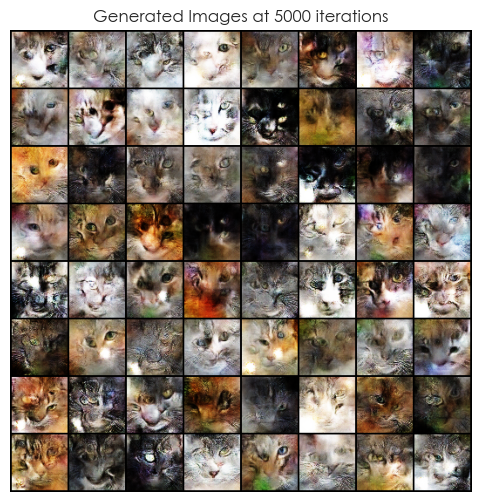

[156/200][10/32] 	Loss_D: -0.0711 | Loss_G: -0.4901 | Iteration Time: 0.0990 sec
[156/200][15/32] 	Loss_D: -0.0634 | Loss_G: -0.4960 | Iteration Time: 0.0915 sec
[156/200][20/32] 	Loss_D: -0.0674 | Loss_G: -0.4299 | Iteration Time: 0.0875 sec
[156/200][25/32] 	Loss_D: -0.0700 | Loss_G: -0.4936 | Iteration Time: 0.0915 sec


Training Progress:  78%|███████▊  | 157/200 [15:20<04:43,  6.58s/it]

[156/200][30/32] 	Loss_D: -0.0842 | Loss_G: -0.4332 | Iteration Time: 0.0880 sec
[157/200][0/32] 	Loss_D: -0.0758 | Loss_G: -0.4726 | Iteration Time: 0.0910 sec
[157/200][5/32] 	Loss_D: -0.0666 | Loss_G: -0.4902 | Iteration Time: 0.0879 sec
[157/200][10/32] 	Loss_D: -0.0689 | Loss_G: -0.4314 | Iteration Time: 0.0900 sec
[157/200][15/32] 	Loss_D: -0.0714 | Loss_G: -0.4341 | Iteration Time: 0.0895 sec
[157/200][20/32] 	Loss_D: -0.0824 | Loss_G: -0.4586 | Iteration Time: 0.0900 sec
[157/200][25/32] 	Loss_D: -0.0714 | Loss_G: -0.4761 | Iteration Time: 0.0890 sec


Training Progress:  79%|███████▉  | 158/200 [15:24<04:00,  5.72s/it]

[157/200][30/32] 	Loss_D: -0.0752 | Loss_G: -0.4817 | Iteration Time: 0.0915 sec
[158/200][0/32] 	Loss_D: -0.0756 | Loss_G: -0.4749 | Iteration Time: 0.0880 sec
[158/200][5/32] 	Loss_D: -0.0826 | Loss_G: -0.4798 | Iteration Time: 0.0875 sec
[158/200][10/32] 	Loss_D: -0.0548 | Loss_G: -0.4871 | Iteration Time: 0.0895 sec
[158/200][15/32] 	Loss_D: -0.0599 | Loss_G: -0.4226 | Iteration Time: 0.0915 sec
[158/200][20/32] 	Loss_D: -0.0759 | Loss_G: -0.4773 | Iteration Time: 0.0915 sec
[158/200][25/32] 	Loss_D: -0.0818 | Loss_G: -0.4937 | Iteration Time: 0.0895 sec


Training Progress:  80%|███████▉  | 159/200 [15:28<03:30,  5.13s/it]

[158/200][30/32] 	Loss_D: -0.0854 | Loss_G: -0.4349 | Iteration Time: 0.0885 sec
[159/200][0/32] 	Loss_D: -0.0692 | Loss_G: -0.4422 | Iteration Time: 0.0920 sec
[159/200][5/32] 	Loss_D: -0.0872 | Loss_G: -0.4783 | Iteration Time: 0.0885 sec
[159/200][10/32] 	Loss_D: -0.0798 | Loss_G: -0.4636 | Iteration Time: 0.0895 sec
[159/200][15/32] 	Loss_D: -0.0743 | Loss_G: -0.4739 | Iteration Time: 0.0890 sec
[159/200][20/32] 	Loss_D: -0.0737 | Loss_G: -0.4835 | Iteration Time: 0.0890 sec
[159/200][25/32] 	Loss_D: -0.0710 | Loss_G: -0.4787 | Iteration Time: 0.0910 sec


Training Progress:  80%|████████  | 160/200 [15:31<03:08,  4.71s/it]

[159/200][30/32] 	Loss_D: -0.0718 | Loss_G: -0.4720 | Iteration Time: 0.0895 sec
[160/200][0/32] 	Loss_D: -0.0725 | Loss_G: -0.4922 | Iteration Time: 0.0890 sec
[160/200][5/32] 	Loss_D: -0.0898 | Loss_G: -0.4621 | Iteration Time: 0.0890 sec
[160/200][10/32] 	Loss_D: -0.0756 | Loss_G: -0.4686 | Iteration Time: 0.0915 sec
[160/200][15/32] 	Loss_D: -0.0734 | Loss_G: -0.4782 | Iteration Time: 0.0905 sec
[160/200][20/32] 	Loss_D: -0.0863 | Loss_G: -0.4467 | Iteration Time: 0.0915 sec
[160/200][25/32] 	Loss_D: -0.0738 | Loss_G: -0.4213 | Iteration Time: 0.0895 sec


Training Progress:  80%|████████  | 161/200 [15:35<02:52,  4.42s/it]

[160/200][30/32] 	Loss_D: -0.0612 | Loss_G: -0.4309 | Iteration Time: 0.0890 sec
[161/200][0/32] 	Loss_D: -0.0820 | Loss_G: -0.4420 | Iteration Time: 0.0895 sec
[161/200][5/32] 	Loss_D: -0.0498 | Loss_G: -0.4924 | Iteration Time: 0.0890 sec
[161/200][10/32] 	Loss_D: -0.0474 | Loss_G: -0.4832 | Iteration Time: 0.0900 sec
[161/200][15/32] 	Loss_D: -0.0681 | Loss_G: -0.4967 | Iteration Time: 0.0900 sec
[161/200][20/32] 	Loss_D: -0.0782 | Loss_G: -0.4896 | Iteration Time: 0.0890 sec
[161/200][25/32] 	Loss_D: -0.0668 | Loss_G: -0.4691 | Iteration Time: 0.0895 sec


Training Progress:  81%|████████  | 162/200 [15:39<02:40,  4.22s/it]

[161/200][30/32] 	Loss_D: -0.0672 | Loss_G: -0.4423 | Iteration Time: 0.0945 sec
[162/200][0/32] 	Loss_D: -0.0643 | Loss_G: -0.4865 | Iteration Time: 0.0920 sec
[162/200][5/32] 	Loss_D: -0.0686 | Loss_G: -0.4287 | Iteration Time: 0.0925 sec
[162/200][10/32] 	Loss_D: -0.0873 | Loss_G: -0.4567 | Iteration Time: 0.0940 sec
[162/200][15/32] 	Loss_D: -0.0629 | Loss_G: -0.4904 | Iteration Time: 0.1010 sec
[162/200][20/32] 	Loss_D: -0.0768 | Loss_G: -0.4770 | Iteration Time: 0.1220 sec
[162/200][25/32] 	Loss_D: -0.0632 | Loss_G: -0.4905 | Iteration Time: 0.1375 sec


Training Progress:  82%|████████▏ | 163/200 [15:43<02:38,  4.29s/it]

[162/200][30/32] 	Loss_D: -0.0597 | Loss_G: -0.4222 | Iteration Time: 0.1460 sec
[163/200][0/32] 	Loss_D: -0.0568 | Loss_G: -0.4922 | Iteration Time: 0.1445 sec
[163/200][5/32] 	Loss_D: -0.0850 | Loss_G: -0.4233 | Iteration Time: 0.1470 sec
[163/200][10/32] 	Loss_D: -0.0783 | Loss_G: -0.4894 | Iteration Time: 0.1405 sec
[163/200][15/32] 	Loss_D: -0.0769 | Loss_G: -0.4358 | Iteration Time: 0.1505 sec
[163/200][20/32] 	Loss_D: -0.0691 | Loss_G: -0.4373 | Iteration Time: 0.1525 sec
[163/200][25/32] 	Loss_D: -0.0837 | Loss_G: -0.4752 | Iteration Time: 0.1495 sec


Training Progress:  82%|████████▏ | 164/200 [15:49<02:49,  4.71s/it]

[163/200][30/32] 	Loss_D: -0.0535 | Loss_G: -0.4895 | Iteration Time: 0.1460 sec
[164/200][0/32] 	Loss_D: -0.0796 | Loss_G: -0.4699 | Iteration Time: 0.1570 sec
[164/200][5/32] 	Loss_D: -0.0793 | Loss_G: -0.4345 | Iteration Time: 0.1430 sec
[164/200][10/32] 	Loss_D: -0.0718 | Loss_G: -0.5009 | Iteration Time: 0.1475 sec
[164/200][15/32] 	Loss_D: -0.0740 | Loss_G: -0.4766 | Iteration Time: 0.1435 sec
[164/200][20/32] 	Loss_D: -0.0689 | Loss_G: -0.4794 | Iteration Time: 0.1425 sec
[164/200][25/32] 	Loss_D: -0.0731 | Loss_G: -0.4870 | Iteration Time: 0.1450 sec


Training Progress:  82%|████████▎ | 165/200 [15:55<02:54,  4.97s/it]

[164/200][30/32] 	Loss_D: -0.0794 | Loss_G: -0.4328 | Iteration Time: 0.1400 sec
[165/200][0/32] 	Loss_D: -0.0849 | Loss_G: -0.4627 | Iteration Time: 0.1460 sec
[165/200][5/32] 	Loss_D: -0.0900 | Loss_G: -0.4706 | Iteration Time: 0.1450 sec
[165/200][10/32] 	Loss_D: -0.0798 | Loss_G: -0.4726 | Iteration Time: 0.1435 sec
[165/200][15/32] 	Loss_D: -0.0782 | Loss_G: -0.4376 | Iteration Time: 0.1475 sec
[165/200][20/32] 	Loss_D: -0.0850 | Loss_G: -0.4783 | Iteration Time: 0.1455 sec
[165/200][25/32] 	Loss_D: -0.0677 | Loss_G: -0.4865 | Iteration Time: 0.1450 sec


Training Progress:  83%|████████▎ | 166/200 [16:00<02:55,  5.15s/it]

[165/200][30/32] 	Loss_D: -0.0843 | Loss_G: -0.4468 | Iteration Time: 0.1425 sec
[166/200][0/32] 	Loss_D: -0.0598 | Loss_G: -0.4793 | Iteration Time: 0.1395 sec
[166/200][5/32] 	Loss_D: -0.0777 | Loss_G: -0.4707 | Iteration Time: 0.1380 sec
[166/200][10/32] 	Loss_D: -0.0709 | Loss_G: -0.4309 | Iteration Time: 0.1375 sec
[166/200][15/32] 	Loss_D: -0.0665 | Loss_G: -0.4401 | Iteration Time: 0.1400 sec
[166/200][20/32] 	Loss_D: -0.0852 | Loss_G: -0.4510 | Iteration Time: 0.1350 sec
[166/200][25/32] 	Loss_D: -0.0688 | Loss_G: -0.4862 | Iteration Time: 0.1400 sec


Training Progress:  84%|████████▎ | 167/200 [16:05<02:51,  5.21s/it]

[166/200][30/32] 	Loss_D: -0.0791 | Loss_G: -0.4725 | Iteration Time: 0.1385 sec
[167/200][0/32] 	Loss_D: -0.0550 | Loss_G: -0.4765 | Iteration Time: 0.1370 sec
[167/200][5/32] 	Loss_D: -0.0698 | Loss_G: -0.4260 | Iteration Time: 0.1355 sec
[167/200][10/32] 	Loss_D: -0.0672 | Loss_G: -0.4788 | Iteration Time: 0.1485 sec
[167/200][15/32] 	Loss_D: -0.0642 | Loss_G: -0.4455 | Iteration Time: 0.1380 sec
[167/200][20/32] 	Loss_D: -0.0776 | Loss_G: -0.4263 | Iteration Time: 0.1450 sec
[167/200][25/32] 	Loss_D: -0.0600 | Loss_G: -0.4986 | Iteration Time: 0.1455 sec


Training Progress:  84%|████████▍ | 168/200 [16:11<02:49,  5.29s/it]

[167/200][30/32] 	Loss_D: -0.0849 | Loss_G: -0.4623 | Iteration Time: 0.1446 sec
[168/200][0/32] 	Loss_D: -0.0784 | Loss_G: -0.4374 | Iteration Time: 0.1490 sec
[168/200][5/32] 	Loss_D: -0.0568 | Loss_G: -0.4870 | Iteration Time: 0.1465 sec
[168/200][10/32] 	Loss_D: -0.0477 | Loss_G: -0.4858 | Iteration Time: 0.1445 sec
[168/200][15/32] 	Loss_D: -0.0645 | Loss_G: -0.4846 | Iteration Time: 0.1445 sec
[168/200][20/32] 	Loss_D: -0.0776 | Loss_G: -0.4722 | Iteration Time: 0.1460 sec
[168/200][25/32] 	Loss_D: -0.0695 | Loss_G: -0.4792 | Iteration Time: 0.1460 sec


Training Progress:  84%|████████▍ | 169/200 [16:17<02:47,  5.40s/it]

[168/200][30/32] 	Loss_D: -0.0777 | Loss_G: -0.4419 | Iteration Time: 0.1460 sec
[169/200][0/32] 	Loss_D: -0.0834 | Loss_G: -0.4597 | Iteration Time: 0.1555 sec
[169/200][5/32] 	Loss_D: -0.0724 | Loss_G: -0.4297 | Iteration Time: 0.1450 sec
[169/200][10/32] 	Loss_D: -0.0781 | Loss_G: -0.4758 | Iteration Time: 0.1445 sec
[169/200][15/32] 	Loss_D: -0.0736 | Loss_G: -0.4942 | Iteration Time: 0.1425 sec
[169/200][20/32] 	Loss_D: -0.0774 | Loss_G: -0.4801 | Iteration Time: 0.1435 sec
[169/200][25/32] 	Loss_D: -0.0680 | Loss_G: -0.4266 | Iteration Time: 0.1505 sec


Training Progress:  85%|████████▌ | 170/200 [16:22<02:43,  5.45s/it]

[169/200][30/32] 	Loss_D: -0.0520 | Loss_G: -0.4780 | Iteration Time: 0.1435 sec
[170/200][0/32] 	Loss_D: -0.0799 | Loss_G: -0.4855 | Iteration Time: 0.1520 sec
[170/200][5/32] 	Loss_D: -0.0835 | Loss_G: -0.4641 | Iteration Time: 0.1445 sec
[170/200][10/32] 	Loss_D: -0.0501 | Loss_G: -0.4881 | Iteration Time: 0.1450 sec
[170/200][15/32] 	Loss_D: -0.0769 | Loss_G: -0.4800 | Iteration Time: 0.1445 sec
[170/200][20/32] 	Loss_D: -0.0863 | Loss_G: -0.4655 | Iteration Time: 0.1425 sec
[170/200][25/32] 	Loss_D: -0.0798 | Loss_G: -0.4321 | Iteration Time: 0.1485 sec


Training Progress:  86%|████████▌ | 171/200 [16:28<02:39,  5.49s/it]

[170/200][30/32] 	Loss_D: -0.0606 | Loss_G: -0.4620 | Iteration Time: 0.1420 sec
[171/200][0/32] 	Loss_D: -0.0787 | Loss_G: -0.4579 | Iteration Time: 0.1540 sec
[171/200][5/32] 	Loss_D: -0.0739 | Loss_G: -0.4286 | Iteration Time: 0.1475 sec
[171/200][10/32] 	Loss_D: -0.0768 | Loss_G: -0.4460 | Iteration Time: 0.1390 sec
[171/200][15/32] 	Loss_D: -0.0815 | Loss_G: -0.4408 | Iteration Time: 0.1331 sec
[171/200][20/32] 	Loss_D: -0.0659 | Loss_G: -0.4956 | Iteration Time: 0.1425 sec
[171/200][25/32] 	Loss_D: -0.0492 | Loss_G: -0.4866 | Iteration Time: 0.1590 sec
Current scores at iteration 5500 | FID: 163.41358947753906 | IS: 2.4548110961914062


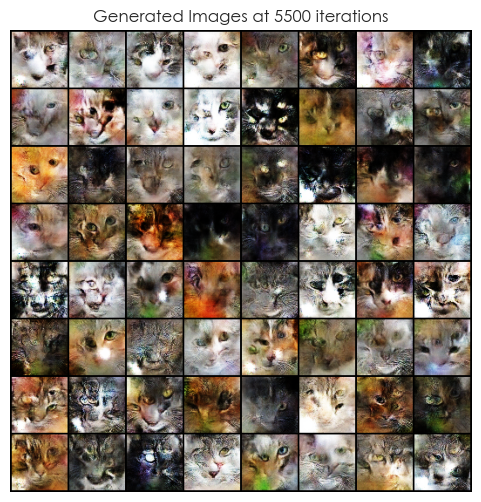

Training Progress:  86%|████████▌ | 172/200 [16:39<03:22,  7.22s/it]

[171/200][30/32] 	Loss_D: -0.0719 | Loss_G: -0.4825 | Iteration Time: 0.1410 sec
[172/200][0/32] 	Loss_D: -0.0751 | Loss_G: -0.4671 | Iteration Time: 0.1610 sec
[172/200][5/32] 	Loss_D: -0.0884 | Loss_G: -0.4438 | Iteration Time: 0.1395 sec
[172/200][10/32] 	Loss_D: -0.0624 | Loss_G: -0.4389 | Iteration Time: 0.1545 sec
[172/200][15/32] 	Loss_D: -0.0796 | Loss_G: -0.4829 | Iteration Time: 0.1440 sec
[172/200][20/32] 	Loss_D: -0.0840 | Loss_G: -0.4323 | Iteration Time: 0.1495 sec
[172/200][25/32] 	Loss_D: -0.0761 | Loss_G: -0.4910 | Iteration Time: 0.1470 sec


Training Progress:  86%|████████▋ | 173/200 [16:45<03:02,  6.75s/it]

[172/200][30/32] 	Loss_D: -0.0558 | Loss_G: -0.4840 | Iteration Time: 0.1445 sec
[173/200][0/32] 	Loss_D: -0.0808 | Loss_G: -0.4405 | Iteration Time: 0.1510 sec
[173/200][5/32] 	Loss_D: -0.0731 | Loss_G: -0.4358 | Iteration Time: 0.1455 sec
[173/200][10/32] 	Loss_D: -0.0600 | Loss_G: -0.4389 | Iteration Time: 0.1435 sec
[173/200][15/32] 	Loss_D: -0.0821 | Loss_G: -0.4912 | Iteration Time: 0.1445 sec
[173/200][20/32] 	Loss_D: -0.0706 | Loss_G: -0.4747 | Iteration Time: 0.1460 sec
[173/200][25/32] 	Loss_D: -0.0714 | Loss_G: -0.4348 | Iteration Time: 0.1445 sec


Training Progress:  87%|████████▋ | 174/200 [16:50<02:46,  6.41s/it]

[173/200][30/32] 	Loss_D: -0.0729 | Loss_G: -0.4328 | Iteration Time: 0.1430 sec
[174/200][0/32] 	Loss_D: -0.0685 | Loss_G: -0.4841 | Iteration Time: 0.1490 sec
[174/200][5/32] 	Loss_D: -0.0770 | Loss_G: -0.4629 | Iteration Time: 0.1460 sec
[174/200][10/32] 	Loss_D: -0.0750 | Loss_G: -0.4305 | Iteration Time: 0.1395 sec
[174/200][15/32] 	Loss_D: -0.0758 | Loss_G: -0.4832 | Iteration Time: 0.1460 sec
[174/200][20/32] 	Loss_D: -0.0672 | Loss_G: -0.4928 | Iteration Time: 0.1475 sec
[174/200][25/32] 	Loss_D: -0.0702 | Loss_G: -0.4816 | Iteration Time: 0.1440 sec


Training Progress:  88%|████████▊ | 175/200 [16:56<02:34,  6.18s/it]

[174/200][30/32] 	Loss_D: -0.0755 | Loss_G: -0.4867 | Iteration Time: 0.1470 sec
[175/200][0/32] 	Loss_D: -0.0846 | Loss_G: -0.4298 | Iteration Time: 0.1500 sec
[175/200][5/32] 	Loss_D: -0.0790 | Loss_G: -0.4801 | Iteration Time: 0.1460 sec
[175/200][10/32] 	Loss_D: -0.0714 | Loss_G: -0.4918 | Iteration Time: 0.1445 sec
[175/200][15/32] 	Loss_D: -0.0681 | Loss_G: -0.4837 | Iteration Time: 0.1505 sec
[175/200][20/32] 	Loss_D: -0.0717 | Loss_G: -0.4868 | Iteration Time: 0.1435 sec
[175/200][25/32] 	Loss_D: -0.0629 | Loss_G: -0.4355 | Iteration Time: 0.1440 sec


Training Progress:  88%|████████▊ | 176/200 [17:02<02:23,  6.00s/it]

[175/200][30/32] 	Loss_D: -0.0600 | Loss_G: -0.4375 | Iteration Time: 0.1440 sec
[176/200][0/32] 	Loss_D: -0.0763 | Loss_G: -0.4830 | Iteration Time: 0.1480 sec
[176/200][5/32] 	Loss_D: -0.0775 | Loss_G: -0.4937 | Iteration Time: 0.1475 sec
[176/200][10/32] 	Loss_D: -0.0797 | Loss_G: -0.4716 | Iteration Time: 0.1440 sec
[176/200][15/32] 	Loss_D: -0.0800 | Loss_G: -0.4703 | Iteration Time: 0.1445 sec
[176/200][20/32] 	Loss_D: -0.0757 | Loss_G: -0.4268 | Iteration Time: 0.1440 sec
[176/200][25/32] 	Loss_D: -0.0563 | Loss_G: -0.4295 | Iteration Time: 0.1350 sec


Training Progress:  88%|████████▊ | 177/200 [17:07<02:14,  5.84s/it]

[176/200][30/32] 	Loss_D: -0.0779 | Loss_G: -0.4434 | Iteration Time: 0.1340 sec
[177/200][0/32] 	Loss_D: -0.0853 | Loss_G: -0.4484 | Iteration Time: 0.1430 sec
[177/200][5/32] 	Loss_D: -0.0708 | Loss_G: -0.4874 | Iteration Time: 0.1500 sec
[177/200][10/32] 	Loss_D: -0.0734 | Loss_G: -0.4869 | Iteration Time: 0.1420 sec
[177/200][15/32] 	Loss_D: -0.0571 | Loss_G: -0.4407 | Iteration Time: 0.1465 sec
[177/200][20/32] 	Loss_D: -0.0715 | Loss_G: -0.4350 | Iteration Time: 0.1500 sec
[177/200][25/32] 	Loss_D: -0.0726 | Loss_G: -0.4736 | Iteration Time: 0.1515 sec


Training Progress:  89%|████████▉ | 178/200 [17:12<02:05,  5.72s/it]

[177/200][30/32] 	Loss_D: -0.0684 | Loss_G: -0.4765 | Iteration Time: 0.0990 sec
[178/200][0/32] 	Loss_D: -0.0652 | Loss_G: -0.4274 | Iteration Time: 0.0935 sec
[178/200][5/32] 	Loss_D: -0.0780 | Loss_G: -0.4707 | Iteration Time: 0.0980 sec
[178/200][10/32] 	Loss_D: -0.0780 | Loss_G: -0.4664 | Iteration Time: 0.0985 sec
[178/200][15/32] 	Loss_D: -0.0690 | Loss_G: -0.4391 | Iteration Time: 0.1145 sec
[178/200][20/32] 	Loss_D: -0.0848 | Loss_G: -0.4440 | Iteration Time: 0.1335 sec
[178/200][25/32] 	Loss_D: -0.0613 | Loss_G: -0.4859 | Iteration Time: 0.1450 sec


Training Progress:  90%|████████▉ | 179/200 [17:17<01:54,  5.45s/it]

[178/200][30/32] 	Loss_D: -0.0716 | Loss_G: -0.4773 | Iteration Time: 0.1440 sec
[179/200][0/32] 	Loss_D: -0.0785 | Loss_G: -0.4867 | Iteration Time: 0.1526 sec
[179/200][5/32] 	Loss_D: -0.0744 | Loss_G: -0.4785 | Iteration Time: 0.1460 sec
[179/200][10/32] 	Loss_D: -0.0697 | Loss_G: -0.4324 | Iteration Time: 0.1445 sec
[179/200][15/32] 	Loss_D: -0.0674 | Loss_G: -0.4815 | Iteration Time: 0.1395 sec
[179/200][20/32] 	Loss_D: -0.0759 | Loss_G: -0.4769 | Iteration Time: 0.1405 sec
[179/200][25/32] 	Loss_D: -0.0732 | Loss_G: -0.4760 | Iteration Time: 0.1405 sec


Training Progress:  90%|█████████ | 180/200 [17:23<01:50,  5.50s/it]

[179/200][30/32] 	Loss_D: -0.0669 | Loss_G: -0.4277 | Iteration Time: 0.1465 sec
[180/200][0/32] 	Loss_D: -0.0889 | Loss_G: -0.4718 | Iteration Time: 0.1445 sec
[180/200][5/32] 	Loss_D: -0.0784 | Loss_G: -0.4646 | Iteration Time: 0.1385 sec
[180/200][10/32] 	Loss_D: -0.0790 | Loss_G: -0.4331 | Iteration Time: 0.1430 sec
[180/200][15/32] 	Loss_D: -0.0710 | Loss_G: -0.4775 | Iteration Time: 0.1375 sec
[180/200][20/32] 	Loss_D: -0.0875 | Loss_G: -0.4247 | Iteration Time: 0.1360 sec
[180/200][25/32] 	Loss_D: -0.0746 | Loss_G: -0.4387 | Iteration Time: 0.1410 sec


Training Progress:  90%|█████████ | 181/200 [17:28<01:44,  5.48s/it]

[180/200][30/32] 	Loss_D: -0.0820 | Loss_G: -0.4467 | Iteration Time: 0.1365 sec
[181/200][0/32] 	Loss_D: -0.0747 | Loss_G: -0.4312 | Iteration Time: 0.1450 sec
[181/200][5/32] 	Loss_D: -0.0706 | Loss_G: -0.4783 | Iteration Time: 0.1425 sec
[181/200][10/32] 	Loss_D: -0.0637 | Loss_G: -0.4332 | Iteration Time: 0.1390 sec
[181/200][15/32] 	Loss_D: -0.0591 | Loss_G: -0.4866 | Iteration Time: 0.1350 sec
[181/200][20/32] 	Loss_D: -0.0732 | Loss_G: -0.4429 | Iteration Time: 0.1400 sec
[181/200][25/32] 	Loss_D: -0.0733 | Loss_G: -0.4795 | Iteration Time: 0.1580 sec


Training Progress:  91%|█████████ | 182/200 [17:34<01:38,  5.49s/it]

[181/200][30/32] 	Loss_D: -0.0689 | Loss_G: -0.4378 | Iteration Time: 0.1530 sec
[182/200][0/32] 	Loss_D: -0.0647 | Loss_G: -0.4814 | Iteration Time: 0.1670 sec
[182/200][5/32] 	Loss_D: -0.0719 | Loss_G: -0.4839 | Iteration Time: 0.1460 sec
[182/200][10/32] 	Loss_D: -0.0737 | Loss_G: -0.4699 | Iteration Time: 0.1480 sec
[182/200][15/32] 	Loss_D: -0.0645 | Loss_G: -0.4885 | Iteration Time: 0.1475 sec
[182/200][20/32] 	Loss_D: -0.0850 | Loss_G: -0.4587 | Iteration Time: 0.1495 sec
[182/200][25/32] 	Loss_D: -0.0830 | Loss_G: -0.4705 | Iteration Time: 0.1455 sec


Training Progress:  92%|█████████▏| 183/200 [17:40<01:34,  5.55s/it]

[182/200][30/32] 	Loss_D: -0.0816 | Loss_G: -0.4630 | Iteration Time: 0.1455 sec
[183/200][0/32] 	Loss_D: -0.0669 | Loss_G: -0.4594 | Iteration Time: 0.1505 sec
[183/200][5/32] 	Loss_D: -0.0685 | Loss_G: -0.4375 | Iteration Time: 0.1475 sec
[183/200][10/32] 	Loss_D: -0.0933 | Loss_G: -0.4501 | Iteration Time: 0.1450 sec
[183/200][15/32] 	Loss_D: -0.0624 | Loss_G: -0.4672 | Iteration Time: 0.1445 sec
[183/200][20/32] 	Loss_D: -0.0499 | Loss_G: -0.4736 | Iteration Time: 0.1430 sec
[183/200][25/32] 	Loss_D: -0.0853 | Loss_G: -0.4341 | Iteration Time: 0.1455 sec


Training Progress:  92%|█████████▏| 184/200 [17:45<01:29,  5.57s/it]

[183/200][30/32] 	Loss_D: -0.0635 | Loss_G: -0.4820 | Iteration Time: 0.1450 sec
[184/200][0/32] 	Loss_D: -0.0767 | Loss_G: -0.4779 | Iteration Time: 0.1525 sec
[184/200][5/32] 	Loss_D: -0.0743 | Loss_G: -0.4833 | Iteration Time: 0.1433 sec
[184/200][10/32] 	Loss_D: -0.0832 | Loss_G: -0.4577 | Iteration Time: 0.1455 sec
[184/200][15/32] 	Loss_D: -0.0614 | Loss_G: -0.4296 | Iteration Time: 0.1450 sec
[184/200][20/32] 	Loss_D: -0.0677 | Loss_G: -0.4871 | Iteration Time: 0.1435 sec
[184/200][25/32] 	Loss_D: -0.0800 | Loss_G: -0.4779 | Iteration Time: 0.1515 sec


Training Progress:  92%|█████████▎| 185/200 [17:51<01:23,  5.59s/it]

[184/200][30/32] 	Loss_D: -0.0732 | Loss_G: -0.4901 | Iteration Time: 0.1445 sec
[185/200][0/32] 	Loss_D: -0.0733 | Loss_G: -0.4700 | Iteration Time: 0.1575 sec
[185/200][5/32] 	Loss_D: -0.0793 | Loss_G: -0.4292 | Iteration Time: 0.1425 sec
[185/200][10/32] 	Loss_D: -0.0800 | Loss_G: -0.4421 | Iteration Time: 0.1465 sec
[185/200][15/32] 	Loss_D: -0.0682 | Loss_G: -0.4260 | Iteration Time: 0.1430 sec
[185/200][20/32] 	Loss_D: -0.0563 | Loss_G: -0.5028 | Iteration Time: 0.1415 sec
[185/200][25/32] 	Loss_D: -0.0706 | Loss_G: -0.4330 | Iteration Time: 0.1460 sec


Training Progress:  93%|█████████▎| 186/200 [17:56<01:18,  5.60s/it]

[185/200][30/32] 	Loss_D: -0.0689 | Loss_G: -0.4725 | Iteration Time: 0.1450 sec
[186/200][0/32] 	Loss_D: -0.0733 | Loss_G: -0.4638 | Iteration Time: 0.1775 sec
[186/200][5/32] 	Loss_D: -0.0877 | Loss_G: -0.4368 | Iteration Time: 0.1450 sec
[186/200][10/32] 	Loss_D: -0.0644 | Loss_G: -0.4866 | Iteration Time: 0.1450 sec
[186/200][15/32] 	Loss_D: -0.0737 | Loss_G: -0.4342 | Iteration Time: 0.1455 sec
[186/200][20/32] 	Loss_D: -0.0712 | Loss_G: -0.4643 | Iteration Time: 0.1425 sec
[186/200][25/32] 	Loss_D: -0.0773 | Loss_G: -0.4530 | Iteration Time: 0.1435 sec


Training Progress:  94%|█████████▎| 187/200 [18:02<01:13,  5.63s/it]

[186/200][30/32] 	Loss_D: -0.0629 | Loss_G: -0.4816 | Iteration Time: 0.1470 sec
[187/200][0/32] 	Loss_D: -0.0649 | Loss_G: -0.4839 | Iteration Time: 0.1535 sec
[187/200][5/32] 	Loss_D: -0.0689 | Loss_G: -0.4823 | Iteration Time: 0.1495 sec
[187/200][10/32] 	Loss_D: -0.0822 | Loss_G: -0.4817 | Iteration Time: 0.1478 sec
[187/200][15/32] 	Loss_D: -0.0871 | Loss_G: -0.4597 | Iteration Time: 0.1475 sec
Current scores at iteration 6000 | FID: 160.5990753173828 | IS: 2.26871919631958


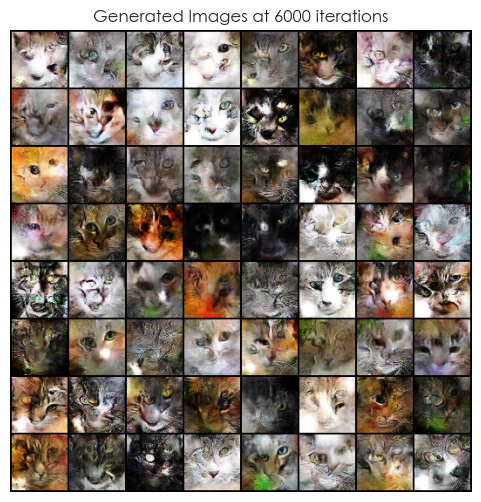

[187/200][20/32] 	Loss_D: -0.0642 | Loss_G: -0.4861 | Iteration Time: 0.1440 sec
[187/200][25/32] 	Loss_D: -0.0662 | Loss_G: -0.4813 | Iteration Time: 0.1495 sec


Training Progress:  94%|█████████▍| 188/200 [18:13<01:26,  7.21s/it]

[187/200][30/32] 	Loss_D: -0.0729 | Loss_G: -0.4325 | Iteration Time: 0.1485 sec
[188/200][0/32] 	Loss_D: -0.0573 | Loss_G: -0.4760 | Iteration Time: 0.1520 sec
[188/200][5/32] 	Loss_D: -0.0830 | Loss_G: -0.4532 | Iteration Time: 0.1460 sec
[188/200][10/32] 	Loss_D: -0.0729 | Loss_G: -0.4864 | Iteration Time: 0.1440 sec
[188/200][15/32] 	Loss_D: -0.0664 | Loss_G: -0.4907 | Iteration Time: 0.1490 sec
[188/200][20/32] 	Loss_D: -0.0739 | Loss_G: -0.4338 | Iteration Time: 0.1515 sec
[188/200][25/32] 	Loss_D: -0.0575 | Loss_G: -0.4812 | Iteration Time: 0.1330 sec


Training Progress:  94%|█████████▍| 189/200 [18:19<01:13,  6.70s/it]

[188/200][30/32] 	Loss_D: -0.0649 | Loss_G: -0.4932 | Iteration Time: 0.1315 sec
[189/200][0/32] 	Loss_D: -0.0733 | Loss_G: -0.4801 | Iteration Time: 0.1370 sec
[189/200][5/32] 	Loss_D: -0.0931 | Loss_G: -0.4529 | Iteration Time: 0.1460 sec
[189/200][10/32] 	Loss_D: -0.0850 | Loss_G: -0.4699 | Iteration Time: 0.1405 sec
[189/200][15/32] 	Loss_D: -0.0660 | Loss_G: -0.4306 | Iteration Time: 0.1455 sec
[189/200][20/32] 	Loss_D: -0.0819 | Loss_G: -0.4639 | Iteration Time: 0.1495 sec
[189/200][25/32] 	Loss_D: -0.0802 | Loss_G: -0.4630 | Iteration Time: 0.1340 sec


Training Progress:  95%|█████████▌| 190/200 [18:24<01:03,  6.33s/it]

[189/200][30/32] 	Loss_D: -0.0614 | Loss_G: -0.4956 | Iteration Time: 0.1480 sec
[190/200][0/32] 	Loss_D: -0.0742 | Loss_G: -0.4937 | Iteration Time: 0.1425 sec
[190/200][5/32] 	Loss_D: -0.0574 | Loss_G: -0.4843 | Iteration Time: 0.1340 sec
[190/200][10/32] 	Loss_D: -0.0783 | Loss_G: -0.4483 | Iteration Time: 0.1335 sec
[190/200][15/32] 	Loss_D: -0.0798 | Loss_G: -0.4322 | Iteration Time: 0.1430 sec
[190/200][20/32] 	Loss_D: -0.0767 | Loss_G: -0.4718 | Iteration Time: 0.1385 sec
[190/200][25/32] 	Loss_D: -0.0825 | Loss_G: -0.4509 | Iteration Time: 0.1355 sec


Training Progress:  96%|█████████▌| 191/200 [18:29<00:54,  6.03s/it]

[190/200][30/32] 	Loss_D: -0.0803 | Loss_G: -0.4289 | Iteration Time: 0.1308 sec
[191/200][0/32] 	Loss_D: -0.0735 | Loss_G: -0.4824 | Iteration Time: 0.1390 sec
[191/200][5/32] 	Loss_D: -0.0884 | Loss_G: -0.4541 | Iteration Time: 0.1334 sec
[191/200][10/32] 	Loss_D: -0.0804 | Loss_G: -0.4611 | Iteration Time: 0.1342 sec
[191/200][15/32] 	Loss_D: -0.0647 | Loss_G: -0.4334 | Iteration Time: 0.1357 sec
[191/200][20/32] 	Loss_D: -0.0698 | Loss_G: -0.4852 | Iteration Time: 0.1342 sec
[191/200][25/32] 	Loss_D: -0.0625 | Loss_G: -0.4280 | Iteration Time: 0.1340 sec


Training Progress:  96%|█████████▌| 192/200 [18:34<00:46,  5.77s/it]

[191/200][30/32] 	Loss_D: -0.0566 | Loss_G: -0.4909 | Iteration Time: 0.1313 sec
[192/200][0/32] 	Loss_D: -0.0821 | Loss_G: -0.4362 | Iteration Time: 0.1385 sec
[192/200][5/32] 	Loss_D: -0.0750 | Loss_G: -0.4739 | Iteration Time: 0.1310 sec
[192/200][10/32] 	Loss_D: -0.0695 | Loss_G: -0.4698 | Iteration Time: 0.1355 sec
[192/200][15/32] 	Loss_D: -0.0579 | Loss_G: -0.4887 | Iteration Time: 0.1360 sec
[192/200][20/32] 	Loss_D: -0.0707 | Loss_G: -0.4885 | Iteration Time: 0.1375 sec
[192/200][25/32] 	Loss_D: -0.0743 | Loss_G: -0.4344 | Iteration Time: 0.1380 sec


Training Progress:  96%|█████████▋| 193/200 [18:40<00:39,  5.61s/it]

[192/200][30/32] 	Loss_D: -0.0629 | Loss_G: -0.4834 | Iteration Time: 0.1365 sec
[193/200][0/32] 	Loss_D: -0.0769 | Loss_G: -0.4801 | Iteration Time: 0.1395 sec
[193/200][5/32] 	Loss_D: -0.0734 | Loss_G: -0.4306 | Iteration Time: 0.1375 sec
[193/200][10/32] 	Loss_D: -0.0796 | Loss_G: -0.4590 | Iteration Time: 0.1315 sec
[193/200][15/32] 	Loss_D: -0.0732 | Loss_G: -0.4788 | Iteration Time: 0.1315 sec
[193/200][20/32] 	Loss_D: -0.0764 | Loss_G: -0.4405 | Iteration Time: 0.1335 sec
[193/200][25/32] 	Loss_D: -0.0649 | Loss_G: -0.4376 | Iteration Time: 0.1295 sec


Training Progress:  97%|█████████▋| 194/200 [18:45<00:33,  5.50s/it]

[193/200][30/32] 	Loss_D: -0.0732 | Loss_G: -0.4440 | Iteration Time: 0.1325 sec
[194/200][0/32] 	Loss_D: -0.0674 | Loss_G: -0.4900 | Iteration Time: 0.1377 sec
[194/200][5/32] 	Loss_D: -0.0705 | Loss_G: -0.4766 | Iteration Time: 0.1340 sec
[194/200][10/32] 	Loss_D: -0.0615 | Loss_G: -0.4826 | Iteration Time: 0.1337 sec
[194/200][15/32] 	Loss_D: -0.0684 | Loss_G: -0.4377 | Iteration Time: 0.1350 sec
[194/200][20/32] 	Loss_D: -0.0766 | Loss_G: -0.4667 | Iteration Time: 0.1330 sec
[194/200][25/32] 	Loss_D: -0.0604 | Loss_G: -0.4992 | Iteration Time: 0.1356 sec


Training Progress:  98%|█████████▊| 195/200 [18:50<00:27,  5.41s/it]

[194/200][30/32] 	Loss_D: -0.0804 | Loss_G: -0.4414 | Iteration Time: 0.1320 sec
[195/200][0/32] 	Loss_D: -0.0624 | Loss_G: -0.4914 | Iteration Time: 0.1400 sec
[195/200][5/32] 	Loss_D: -0.0642 | Loss_G: -0.4858 | Iteration Time: 0.1340 sec
[195/200][10/32] 	Loss_D: -0.0864 | Loss_G: -0.4565 | Iteration Time: 0.1350 sec
[195/200][15/32] 	Loss_D: -0.0790 | Loss_G: -0.4502 | Iteration Time: 0.1340 sec
[195/200][20/32] 	Loss_D: -0.0660 | Loss_G: -0.4834 | Iteration Time: 0.1310 sec
[195/200][25/32] 	Loss_D: -0.0572 | Loss_G: -0.4919 | Iteration Time: 0.1295 sec


Training Progress:  98%|█████████▊| 196/200 [18:55<00:21,  5.33s/it]

[195/200][30/32] 	Loss_D: -0.0682 | Loss_G: -0.4869 | Iteration Time: 0.1303 sec
[196/200][0/32] 	Loss_D: -0.0740 | Loss_G: -0.4433 | Iteration Time: 0.1335 sec
[196/200][5/32] 	Loss_D: -0.0809 | Loss_G: -0.4517 | Iteration Time: 0.1320 sec
[196/200][10/32] 	Loss_D: -0.0769 | Loss_G: -0.4931 | Iteration Time: 0.1356 sec
[196/200][15/32] 	Loss_D: -0.0804 | Loss_G: -0.4270 | Iteration Time: 0.1360 sec
[196/200][20/32] 	Loss_D: -0.0831 | Loss_G: -0.4540 | Iteration Time: 0.1345 sec
[196/200][25/32] 	Loss_D: -0.0759 | Loss_G: -0.4463 | Iteration Time: 0.1335 sec


Training Progress:  98%|█████████▊| 197/200 [19:00<00:15,  5.27s/it]

[196/200][30/32] 	Loss_D: -0.0728 | Loss_G: -0.4914 | Iteration Time: 0.1355 sec
[197/200][0/32] 	Loss_D: -0.0749 | Loss_G: -0.4364 | Iteration Time: 0.1425 sec
[197/200][5/32] 	Loss_D: -0.0858 | Loss_G: -0.4688 | Iteration Time: 0.1328 sec
[197/200][10/32] 	Loss_D: -0.0840 | Loss_G: -0.4466 | Iteration Time: 0.1305 sec
[197/200][15/32] 	Loss_D: -0.0770 | Loss_G: -0.4465 | Iteration Time: 0.1319 sec
[197/200][20/32] 	Loss_D: -0.0700 | Loss_G: -0.4857 | Iteration Time: 0.1315 sec
[197/200][25/32] 	Loss_D: -0.0758 | Loss_G: -0.4734 | Iteration Time: 0.1350 sec


Training Progress:  99%|█████████▉| 198/200 [19:06<00:10,  5.25s/it]

[197/200][30/32] 	Loss_D: -0.0669 | Loss_G: -0.4321 | Iteration Time: 0.1334 sec
[198/200][0/32] 	Loss_D: -0.0751 | Loss_G: -0.4819 | Iteration Time: 0.1500 sec
[198/200][5/32] 	Loss_D: -0.0654 | Loss_G: -0.4884 | Iteration Time: 0.1320 sec
[198/200][10/32] 	Loss_D: -0.0667 | Loss_G: -0.4256 | Iteration Time: 0.1304 sec
[198/200][15/32] 	Loss_D: -0.0739 | Loss_G: -0.4502 | Iteration Time: 0.1330 sec
[198/200][20/32] 	Loss_D: -0.0845 | Loss_G: -0.4466 | Iteration Time: 0.1320 sec
[198/200][25/32] 	Loss_D: -0.0647 | Loss_G: -0.4835 | Iteration Time: 0.1320 sec


Training Progress: 100%|█████████▉| 199/200 [19:11<00:05,  5.22s/it]

[198/200][30/32] 	Loss_D: -0.0796 | Loss_G: -0.4674 | Iteration Time: 0.1341 sec
[199/200][0/32] 	Loss_D: -0.0699 | Loss_G: -0.4888 | Iteration Time: 0.1445 sec
[199/200][5/32] 	Loss_D: -0.0697 | Loss_G: -0.4792 | Iteration Time: 0.1305 sec
[199/200][10/32] 	Loss_D: -0.0606 | Loss_G: -0.4890 | Iteration Time: 0.1310 sec
[199/200][15/32] 	Loss_D: -0.0678 | Loss_G: -0.4326 | Iteration Time: 0.1290 sec
[199/200][20/32] 	Loss_D: -0.0640 | Loss_G: -0.4932 | Iteration Time: 0.1355 sec
[199/200][25/32] 	Loss_D: -0.0550 | Loss_G: -0.4324 | Iteration Time: 0.1330 sec
[199/200][30/32] 	Loss_D: -0.0712 | Loss_G: -0.4888 | Iteration Time: 0.1307 sec
Current scores at iteration 6399 | FID: 209.2201385498047 | IS: 1.5033737421035767


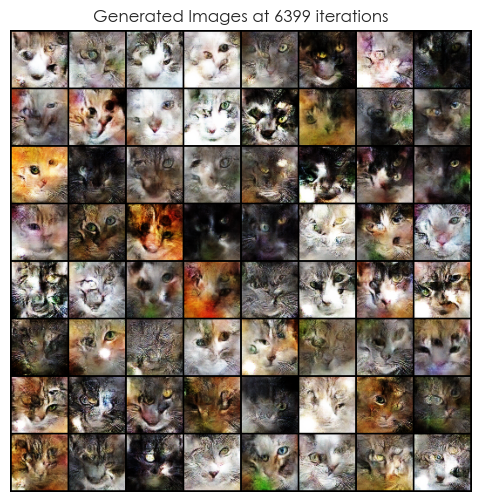

Training Progress: 100%|██████████| 200/200 [19:19<00:00,  5.80s/it]


In [12]:
wgan_trainer = WGANTrainer(critic, netG, cat_dataloader, device, fixed_noise, real_label, fake_label, nz, optimizerC, optimizerG, EPOCHS, WEIGHT_CLIP, CRITIC_ITERATIONS)
wgan_trainer.train()

#### LOSS PLOT

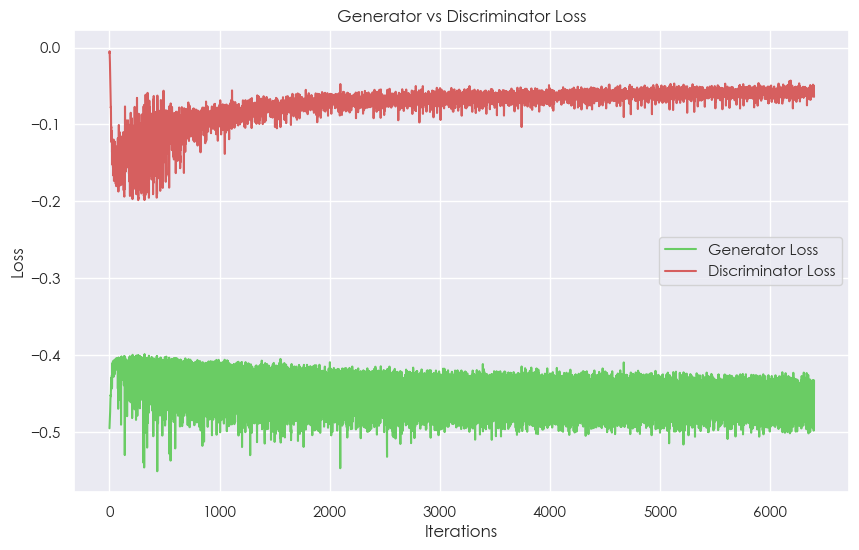

In [93]:
wgan_trainer.plot_loss()

#### SCORE PLOT

Minimum FID Score of 160.5990753173828 obtained at iteration of 6000.
Maximum IS Score of 2.464463710784912.


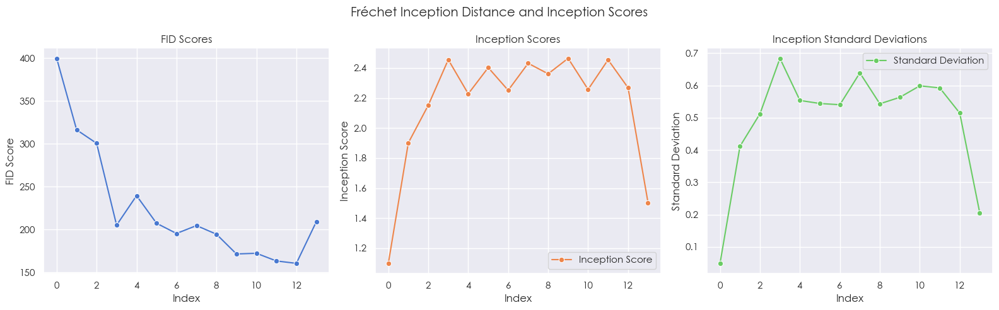

In [94]:
wgan_trainer.plot_scores()

### WGAN-GP

#### GENERATOR

In [69]:
# Create generator
netG = WGANGPGenerator().to(device=device)
# Print generator
print(netG)

WGANGPGenerator(
  (model): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runni

#### CRITIC

In [70]:
# Create Critic
critic = WGANGPCritic().to(device=device)
# Print critic
print(critic)

WGANGPCritic(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.9, affine=False, track_running_stats=False)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.9, affine=False, track_running_stats=False)
      (2): ReLU(inplace=True)
    )
    (3): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (4): Sigmoid()
  )
)


#### OPTIMIZERS AND HYPERPARAMETERS

In [71]:
# Optimizers
optimizerC = optim.Adam(critic.parameters(), lr=LR, betas=(0.0, 0.9)) 
optimizerG = optim.Adam(netG.parameters(), lr=LR, betas=(0.0, 0.9))
# Fixed noise (latent vectors)
fixed_noise = torch.randn(IMAGE_SIZE, nz, 1, 1, device=device)
# Lambda
lambda_gp = 10

#### TRAINING

Starting Training Loop...


Training Progress:   0%|          | 0/200 [00:00<?, ?it/s]

[0/200][0/32] 	Loss_D: 0.3098 | Loss_G: -0.4351 | Iteration Time: 1.6757 sec
Current scores at iteration 0 | FID: 363.68902587890625 | IS: 1.1739404201507568


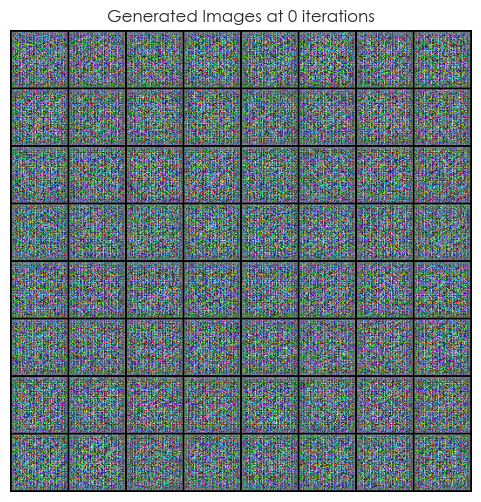

[0/200][5/32] 	Loss_D: 0.0249 | Loss_G: -0.2451 | Iteration Time: 1.1456 sec
[0/200][10/32] 	Loss_D: -0.2798 | Loss_G: -0.2202 | Iteration Time: 0.9056 sec
[0/200][15/32] 	Loss_D: 0.3199 | Loss_G: -0.3168 | Iteration Time: 1.1264 sec
[0/200][20/32] 	Loss_D: -0.2145 | Loss_G: -0.2528 | Iteration Time: 0.9751 sec
[0/200][25/32] 	Loss_D: -0.2108 | Loss_G: -0.3601 | Iteration Time: 1.2558 sec


Training Progress:   0%|          | 1/200 [00:43<2:22:58, 43.11s/it]

[0/200][30/32] 	Loss_D: -0.1920 | Loss_G: -0.3887 | Iteration Time: 0.9213 sec
[1/200][0/32] 	Loss_D: -0.0512 | Loss_G: -0.3675 | Iteration Time: 0.9041 sec
[1/200][5/32] 	Loss_D: 0.0098 | Loss_G: -0.3825 | Iteration Time: 1.0291 sec
[1/200][10/32] 	Loss_D: -0.1522 | Loss_G: -0.3452 | Iteration Time: 1.2386 sec
[1/200][15/32] 	Loss_D: -0.2318 | Loss_G: -0.3863 | Iteration Time: 0.9996 sec
[1/200][20/32] 	Loss_D: -0.0175 | Loss_G: -0.3134 | Iteration Time: 0.9616 sec
[1/200][25/32] 	Loss_D: -0.1546 | Loss_G: -0.3689 | Iteration Time: 0.9581 sec


Training Progress:   1%|          | 2/200 [01:16<2:04:04, 37.60s/it]

[1/200][30/32] 	Loss_D: -0.1740 | Loss_G: -0.2294 | Iteration Time: 1.3574 sec
[2/200][0/32] 	Loss_D: -0.2770 | Loss_G: -0.3015 | Iteration Time: 0.9561 sec
[2/200][5/32] 	Loss_D: -0.1375 | Loss_G: -0.2809 | Iteration Time: 1.0056 sec
[2/200][10/32] 	Loss_D: -0.1035 | Loss_G: -0.3684 | Iteration Time: 1.3871 sec
[2/200][15/32] 	Loss_D: 0.0478 | Loss_G: -0.3379 | Iteration Time: 1.4082 sec
[2/200][20/32] 	Loss_D: -0.0658 | Loss_G: -0.3135 | Iteration Time: 0.6466 sec
[2/200][25/32] 	Loss_D: -0.0204 | Loss_G: -0.4139 | Iteration Time: 0.9207 sec


Training Progress:   2%|▏         | 3/200 [01:52<1:59:53, 36.51s/it]

[2/200][30/32] 	Loss_D: -0.1665 | Loss_G: -0.3810 | Iteration Time: 1.2556 sec
[3/200][0/32] 	Loss_D: -0.2015 | Loss_G: -0.3510 | Iteration Time: 0.9406 sec
[3/200][5/32] 	Loss_D: -0.0989 | Loss_G: -0.2984 | Iteration Time: 1.0134 sec
[3/200][10/32] 	Loss_D: -0.1801 | Loss_G: -0.4507 | Iteration Time: 1.3761 sec
[3/200][15/32] 	Loss_D: 0.2196 | Loss_G: -0.2984 | Iteration Time: 1.3361 sec
[3/200][20/32] 	Loss_D: -0.1878 | Loss_G: -0.3951 | Iteration Time: 0.6381 sec
[3/200][25/32] 	Loss_D: -0.0354 | Loss_G: -0.2700 | Iteration Time: 0.9196 sec


Training Progress:   2%|▏         | 4/200 [02:26<1:57:10, 35.87s/it]

[3/200][30/32] 	Loss_D: -0.0964 | Loss_G: -0.3597 | Iteration Time: 1.2347 sec
[4/200][0/32] 	Loss_D: 0.0774 | Loss_G: -0.2425 | Iteration Time: 0.8976 sec
[4/200][5/32] 	Loss_D: -0.1144 | Loss_G: -0.4004 | Iteration Time: 1.0236 sec
[4/200][10/32] 	Loss_D: -0.0220 | Loss_G: -0.2667 | Iteration Time: 1.3866 sec
[4/200][15/32] 	Loss_D: -0.0438 | Loss_G: -0.3837 | Iteration Time: 1.3280 sec
[4/200][20/32] 	Loss_D: -0.1342 | Loss_G: -0.3197 | Iteration Time: 0.6346 sec
[4/200][25/32] 	Loss_D: -0.1326 | Loss_G: -0.3963 | Iteration Time: 0.9021 sec


Training Progress:   2%|▎         | 5/200 [03:01<1:55:09, 35.43s/it]

[4/200][30/32] 	Loss_D: -0.0922 | Loss_G: -0.3720 | Iteration Time: 1.2381 sec
[5/200][0/32] 	Loss_D: -0.1220 | Loss_G: -0.4142 | Iteration Time: 0.9501 sec
[5/200][5/32] 	Loss_D: -0.0134 | Loss_G: -0.4536 | Iteration Time: 1.0036 sec
[5/200][10/32] 	Loss_D: -0.1493 | Loss_G: -0.4380 | Iteration Time: 1.3831 sec
[5/200][15/32] 	Loss_D: -0.1112 | Loss_G: -0.3367 | Iteration Time: 1.3387 sec
[5/200][20/32] 	Loss_D: -0.1664 | Loss_G: -0.5221 | Iteration Time: 0.6471 sec
[5/200][25/32] 	Loss_D: -0.0973 | Loss_G: -0.4194 | Iteration Time: 0.9081 sec


Training Progress:   3%|▎         | 6/200 [03:36<1:54:06, 35.29s/it]

[5/200][30/32] 	Loss_D: -0.1136 | Loss_G: -0.4890 | Iteration Time: 1.2731 sec
[6/200][0/32] 	Loss_D: -0.0771 | Loss_G: -0.4711 | Iteration Time: 0.9710 sec
[6/200][5/32] 	Loss_D: -0.1785 | Loss_G: -0.4337 | Iteration Time: 0.9816 sec
[6/200][10/32] 	Loss_D: -0.1549 | Loss_G: -0.4595 | Iteration Time: 1.3902 sec
[6/200][15/32] 	Loss_D: -0.0855 | Loss_G: -0.5951 | Iteration Time: 1.3377 sec
[6/200][20/32] 	Loss_D: -0.1111 | Loss_G: -0.3803 | Iteration Time: 0.6401 sec
[6/200][25/32] 	Loss_D: -0.1443 | Loss_G: -0.4325 | Iteration Time: 0.9176 sec


Training Progress:   4%|▎         | 7/200 [04:11<1:53:00, 35.13s/it]

[6/200][30/32] 	Loss_D: -0.1148 | Loss_G: -0.4189 | Iteration Time: 1.2586 sec
[7/200][0/32] 	Loss_D: -0.1612 | Loss_G: -0.4112 | Iteration Time: 0.9771 sec
[7/200][5/32] 	Loss_D: -0.0969 | Loss_G: -0.4863 | Iteration Time: 1.0075 sec
[7/200][10/32] 	Loss_D: -0.1229 | Loss_G: -0.4548 | Iteration Time: 1.3907 sec
[7/200][15/32] 	Loss_D: -0.1137 | Loss_G: -0.4576 | Iteration Time: 1.3529 sec
[7/200][20/32] 	Loss_D: -0.0158 | Loss_G: -0.4644 | Iteration Time: 0.6366 sec
[7/200][25/32] 	Loss_D: -0.0823 | Loss_G: -0.4096 | Iteration Time: 0.9306 sec


Training Progress:   4%|▍         | 8/200 [04:46<1:52:28, 35.15s/it]

[7/200][30/32] 	Loss_D: 0.0843 | Loss_G: -0.3684 | Iteration Time: 1.2553 sec
[8/200][0/32] 	Loss_D: -0.1176 | Loss_G: -0.4164 | Iteration Time: 0.9646 sec
[8/200][5/32] 	Loss_D: -0.0800 | Loss_G: -0.5981 | Iteration Time: 1.0146 sec
[8/200][10/32] 	Loss_D: -0.1235 | Loss_G: -0.4388 | Iteration Time: 1.3771 sec
[8/200][15/32] 	Loss_D: -0.0955 | Loss_G: -0.4880 | Iteration Time: 1.3349 sec
[8/200][20/32] 	Loss_D: -0.0860 | Loss_G: -0.4237 | Iteration Time: 0.6381 sec
[8/200][25/32] 	Loss_D: -0.1152 | Loss_G: -0.3863 | Iteration Time: 0.9302 sec


Training Progress:   4%|▍         | 9/200 [05:21<1:51:39, 35.07s/it]

[8/200][30/32] 	Loss_D: -0.1318 | Loss_G: -0.4093 | Iteration Time: 1.2479 sec
[9/200][0/32] 	Loss_D: -0.0857 | Loss_G: -0.4608 | Iteration Time: 0.9651 sec
[9/200][5/32] 	Loss_D: -0.0864 | Loss_G: -0.4807 | Iteration Time: 1.0086 sec
[9/200][10/32] 	Loss_D: -0.0241 | Loss_G: -0.4763 | Iteration Time: 1.3606 sec
[9/200][15/32] 	Loss_D: -0.1166 | Loss_G: -0.4407 | Iteration Time: 1.3293 sec
[9/200][20/32] 	Loss_D: 0.1159 | Loss_G: -0.6701 | Iteration Time: 0.6267 sec
[9/200][25/32] 	Loss_D: -0.0690 | Loss_G: -0.4210 | Iteration Time: 0.8859 sec


Training Progress:   5%|▌         | 10/200 [05:56<1:50:36, 34.93s/it]

[9/200][30/32] 	Loss_D: -0.0946 | Loss_G: -0.3827 | Iteration Time: 1.2314 sec
[10/200][0/32] 	Loss_D: -0.0124 | Loss_G: -0.3112 | Iteration Time: 0.9471 sec
[10/200][5/32] 	Loss_D: 0.0124 | Loss_G: -0.5385 | Iteration Time: 1.0172 sec
[10/200][10/32] 	Loss_D: -0.0951 | Loss_G: -0.4214 | Iteration Time: 1.3752 sec
[10/200][15/32] 	Loss_D: -0.1094 | Loss_G: -0.4464 | Iteration Time: 1.3472 sec
[10/200][20/32] 	Loss_D: -0.0843 | Loss_G: -0.4272 | Iteration Time: 0.6466 sec
[10/200][25/32] 	Loss_D: -0.0340 | Loss_G: -0.4351 | Iteration Time: 0.9111 sec


Training Progress:   6%|▌         | 11/200 [06:31<1:49:59, 34.92s/it]

[10/200][30/32] 	Loss_D: -0.0652 | Loss_G: -0.3638 | Iteration Time: 1.2526 sec
[11/200][0/32] 	Loss_D: -0.0601 | Loss_G: -0.4535 | Iteration Time: 0.9481 sec
[11/200][5/32] 	Loss_D: -0.0823 | Loss_G: -0.4332 | Iteration Time: 1.0561 sec
[11/200][10/32] 	Loss_D: -0.0545 | Loss_G: -0.4387 | Iteration Time: 1.3731 sec
[11/200][15/32] 	Loss_D: -0.0715 | Loss_G: -0.5404 | Iteration Time: 1.3434 sec
[11/200][20/32] 	Loss_D: -0.0811 | Loss_G: -0.3960 | Iteration Time: 0.6426 sec
[11/200][25/32] 	Loss_D: -0.1035 | Loss_G: -0.4209 | Iteration Time: 0.9086 sec


Training Progress:   6%|▌         | 12/200 [07:06<1:49:32, 34.96s/it]

[11/200][30/32] 	Loss_D: -0.0459 | Loss_G: -0.3893 | Iteration Time: 1.2521 sec
[12/200][0/32] 	Loss_D: -0.1138 | Loss_G: -0.4139 | Iteration Time: 0.9771 sec
[12/200][5/32] 	Loss_D: -0.0818 | Loss_G: -0.4387 | Iteration Time: 1.0346 sec
[12/200][10/32] 	Loss_D: -0.0812 | Loss_G: -0.4780 | Iteration Time: 1.3986 sec
[12/200][15/32] 	Loss_D: -0.1237 | Loss_G: -0.4095 | Iteration Time: 1.3644 sec
[12/200][20/32] 	Loss_D: 0.0313 | Loss_G: -0.6228 | Iteration Time: 0.6416 sec
[12/200][25/32] 	Loss_D: -0.0875 | Loss_G: -0.4559 | Iteration Time: 0.9574 sec


Training Progress:   6%|▋         | 13/200 [07:41<1:49:22, 35.09s/it]

[12/200][30/32] 	Loss_D: 0.0121 | Loss_G: -0.5668 | Iteration Time: 1.2731 sec
[13/200][0/32] 	Loss_D: -0.0910 | Loss_G: -0.3128 | Iteration Time: 0.9476 sec
[13/200][5/32] 	Loss_D: -0.0985 | Loss_G: -0.4242 | Iteration Time: 1.0252 sec
[13/200][10/32] 	Loss_D: -0.0353 | Loss_G: -0.1654 | Iteration Time: 1.3841 sec
[13/200][15/32] 	Loss_D: -0.1046 | Loss_G: -0.4235 | Iteration Time: 1.3451 sec
[13/200][20/32] 	Loss_D: -0.0808 | Loss_G: -0.3720 | Iteration Time: 0.6428 sec
[13/200][25/32] 	Loss_D: -0.0295 | Loss_G: -0.4877 | Iteration Time: 0.9198 sec


Training Progress:   7%|▋         | 14/200 [08:16<1:48:40, 35.05s/it]

[13/200][30/32] 	Loss_D: -0.0840 | Loss_G: -0.4613 | Iteration Time: 1.2421 sec
[14/200][0/32] 	Loss_D: -0.0928 | Loss_G: -0.4558 | Iteration Time: 0.9436 sec
[14/200][5/32] 	Loss_D: -0.0977 | Loss_G: -0.4544 | Iteration Time: 1.0060 sec
[14/200][10/32] 	Loss_D: -0.0591 | Loss_G: -0.5080 | Iteration Time: 1.3752 sec
[14/200][15/32] 	Loss_D: -0.0978 | Loss_G: -0.4767 | Iteration Time: 1.3263 sec
[14/200][20/32] 	Loss_D: -0.0672 | Loss_G: -0.5308 | Iteration Time: 0.6411 sec
[14/200][25/32] 	Loss_D: -0.0747 | Loss_G: -0.4503 | Iteration Time: 0.8941 sec


Training Progress:   8%|▊         | 15/200 [08:51<1:47:48, 34.96s/it]

[14/200][30/32] 	Loss_D: -0.0658 | Loss_G: -0.4928 | Iteration Time: 1.2375 sec
[15/200][0/32] 	Loss_D: -0.0907 | Loss_G: -0.4216 | Iteration Time: 0.9046 sec
[15/200][5/32] 	Loss_D: -0.0516 | Loss_G: -0.3966 | Iteration Time: 1.0165 sec
[15/200][10/32] 	Loss_D: -0.0996 | Loss_G: -0.4709 | Iteration Time: 1.3767 sec
[15/200][15/32] 	Loss_D: -0.0689 | Loss_G: -0.5159 | Iteration Time: 1.3411 sec
[15/200][20/32] 	Loss_D: -0.1127 | Loss_G: -0.4399 | Iteration Time: 0.6326 sec
Current scores at iteration 500 | FID: 168.53553771972656 | IS: 2.5484938621520996


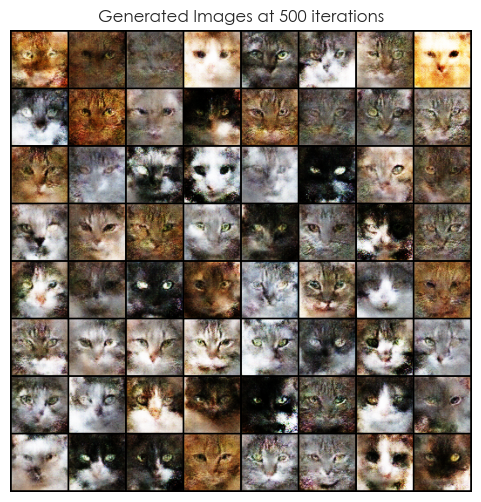

[15/200][25/32] 	Loss_D: -0.0703 | Loss_G: -0.4271 | Iteration Time: 1.0491 sec


Training Progress:   8%|▊         | 16/200 [09:32<1:53:30, 37.01s/it]

[15/200][30/32] 	Loss_D: -0.1149 | Loss_G: -0.4652 | Iteration Time: 1.3072 sec
[16/200][0/32] 	Loss_D: -0.0857 | Loss_G: -0.4771 | Iteration Time: 1.3777 sec
[16/200][5/32] 	Loss_D: -0.0447 | Loss_G: -0.6009 | Iteration Time: 1.4067 sec
[16/200][10/32] 	Loss_D: -0.0962 | Loss_G: -0.4312 | Iteration Time: 1.3918 sec
[16/200][15/32] 	Loss_D: -0.1101 | Loss_G: -0.4426 | Iteration Time: 1.0831 sec
[16/200][20/32] 	Loss_D: -0.0971 | Loss_G: -0.4105 | Iteration Time: 0.9861 sec
[16/200][25/32] 	Loss_D: -0.0847 | Loss_G: -0.3714 | Iteration Time: 1.4057 sec


Training Progress:   8%|▊         | 17/200 [10:08<1:51:14, 36.47s/it]

[16/200][30/32] 	Loss_D: -0.1125 | Loss_G: -0.4568 | Iteration Time: 1.0281 sec
[17/200][0/32] 	Loss_D: -0.0513 | Loss_G: -0.5506 | Iteration Time: 1.3802 sec
[17/200][5/32] 	Loss_D: -0.0833 | Loss_G: -0.5310 | Iteration Time: 1.3899 sec
[17/200][10/32] 	Loss_D: -0.0798 | Loss_G: -0.4724 | Iteration Time: 1.4192 sec
[17/200][15/32] 	Loss_D: -0.1110 | Loss_G: -0.4370 | Iteration Time: 1.0320 sec
[17/200][20/32] 	Loss_D: -0.0837 | Loss_G: -0.4125 | Iteration Time: 1.0191 sec
[17/200][25/32] 	Loss_D: -0.0249 | Loss_G: -0.2358 | Iteration Time: 1.4124 sec


Training Progress:   9%|▉         | 18/200 [10:43<1:49:43, 36.17s/it]

[17/200][30/32] 	Loss_D: -0.0846 | Loss_G: -0.5503 | Iteration Time: 1.0307 sec
[18/200][0/32] 	Loss_D: -0.1126 | Loss_G: -0.4352 | Iteration Time: 1.3712 sec
[18/200][5/32] 	Loss_D: -0.1261 | Loss_G: -0.4844 | Iteration Time: 1.3516 sec
[18/200][10/32] 	Loss_D: -0.0771 | Loss_G: -0.4095 | Iteration Time: 1.3977 sec
[18/200][15/32] 	Loss_D: -0.0669 | Loss_G: -0.2815 | Iteration Time: 1.0341 sec
[18/200][20/32] 	Loss_D: -0.0790 | Loss_G: -0.3343 | Iteration Time: 1.0181 sec
[18/200][25/32] 	Loss_D: -0.0829 | Loss_G: -0.3600 | Iteration Time: 1.4011 sec


Training Progress:  10%|▉         | 19/200 [11:18<1:48:08, 35.85s/it]

[18/200][30/32] 	Loss_D: -0.0697 | Loss_G: -0.3238 | Iteration Time: 1.0122 sec
[19/200][0/32] 	Loss_D: -0.1214 | Loss_G: -0.3958 | Iteration Time: 1.3422 sec
[19/200][5/32] 	Loss_D: -0.0735 | Loss_G: -0.4933 | Iteration Time: 1.4017 sec
[19/200][10/32] 	Loss_D: -0.0532 | Loss_G: -0.3845 | Iteration Time: 1.3911 sec
[19/200][15/32] 	Loss_D: -0.1045 | Loss_G: -0.4483 | Iteration Time: 1.0118 sec
[19/200][20/32] 	Loss_D: -0.1134 | Loss_G: -0.4568 | Iteration Time: 0.9901 sec
[19/200][25/32] 	Loss_D: -0.0757 | Loss_G: -0.4264 | Iteration Time: 1.3806 sec


Training Progress:  10%|█         | 20/200 [11:53<1:46:50, 35.62s/it]

[19/200][30/32] 	Loss_D: -0.0840 | Loss_G: -0.4354 | Iteration Time: 1.0232 sec
[20/200][0/32] 	Loss_D: -0.0836 | Loss_G: -0.3862 | Iteration Time: 1.3501 sec
[20/200][5/32] 	Loss_D: -0.0776 | Loss_G: -0.4016 | Iteration Time: 1.4182 sec
[20/200][10/32] 	Loss_D: -0.0534 | Loss_G: -0.3652 | Iteration Time: 1.3957 sec
[20/200][15/32] 	Loss_D: -0.1097 | Loss_G: -0.3610 | Iteration Time: 1.0284 sec
[20/200][20/32] 	Loss_D: -0.0389 | Loss_G: -0.3986 | Iteration Time: 1.0066 sec
[20/200][25/32] 	Loss_D: -0.0962 | Loss_G: -0.5122 | Iteration Time: 1.3793 sec


Training Progress:  10%|█         | 21/200 [12:28<1:45:43, 35.44s/it]

[20/200][30/32] 	Loss_D: -0.0899 | Loss_G: -0.5555 | Iteration Time: 1.0246 sec
[21/200][0/32] 	Loss_D: -0.0477 | Loss_G: -0.3788 | Iteration Time: 1.3327 sec
[21/200][5/32] 	Loss_D: -0.1133 | Loss_G: -0.4392 | Iteration Time: 1.4302 sec
[21/200][10/32] 	Loss_D: -0.0942 | Loss_G: -0.4255 | Iteration Time: 1.3926 sec
[21/200][15/32] 	Loss_D: -0.1277 | Loss_G: -0.4432 | Iteration Time: 1.0262 sec
[21/200][20/32] 	Loss_D: -0.1334 | Loss_G: -0.4600 | Iteration Time: 0.9986 sec
[21/200][25/32] 	Loss_D: -0.0353 | Loss_G: -0.2876 | Iteration Time: 1.3896 sec


Training Progress:  11%|█         | 22/200 [13:03<1:44:49, 35.33s/it]

[21/200][30/32] 	Loss_D: -0.1033 | Loss_G: -0.4043 | Iteration Time: 1.0108 sec
[22/200][0/32] 	Loss_D: -0.1214 | Loss_G: -0.4062 | Iteration Time: 1.3621 sec
[22/200][5/32] 	Loss_D: -0.1357 | Loss_G: -0.4350 | Iteration Time: 1.4111 sec
[22/200][10/32] 	Loss_D: 0.0370 | Loss_G: -0.3954 | Iteration Time: 1.4196 sec
[22/200][15/32] 	Loss_D: -0.1389 | Loss_G: -0.4476 | Iteration Time: 1.0416 sec
[22/200][20/32] 	Loss_D: -0.1117 | Loss_G: -0.3724 | Iteration Time: 1.0066 sec
[22/200][25/32] 	Loss_D: -0.0311 | Loss_G: -0.4473 | Iteration Time: 1.4086 sec


Training Progress:  12%|█▏        | 23/200 [13:39<1:44:27, 35.41s/it]

[22/200][30/32] 	Loss_D: -0.1296 | Loss_G: -0.4454 | Iteration Time: 1.0227 sec
[23/200][0/32] 	Loss_D: -0.1247 | Loss_G: -0.4381 | Iteration Time: 1.3596 sec
[23/200][5/32] 	Loss_D: -0.1275 | Loss_G: -0.3945 | Iteration Time: 1.4420 sec
[23/200][10/32] 	Loss_D: -0.1031 | Loss_G: -0.4624 | Iteration Time: 1.4193 sec
[23/200][15/32] 	Loss_D: -0.1182 | Loss_G: -0.3833 | Iteration Time: 1.0353 sec
[23/200][20/32] 	Loss_D: -0.1303 | Loss_G: -0.3854 | Iteration Time: 1.0036 sec
[23/200][25/32] 	Loss_D: -0.1266 | Loss_G: -0.4442 | Iteration Time: 1.3457 sec


Training Progress:  12%|█▏        | 24/200 [14:14<1:43:44, 35.36s/it]

[23/200][30/32] 	Loss_D: -0.0822 | Loss_G: -0.3798 | Iteration Time: 1.0197 sec
[24/200][0/32] 	Loss_D: -0.1006 | Loss_G: -0.4286 | Iteration Time: 1.3437 sec
[24/200][5/32] 	Loss_D: -0.0998 | Loss_G: -0.4154 | Iteration Time: 1.3923 sec
[24/200][10/32] 	Loss_D: -0.0932 | Loss_G: -0.3336 | Iteration Time: 1.3706 sec
[24/200][15/32] 	Loss_D: -0.0520 | Loss_G: -0.4326 | Iteration Time: 1.0162 sec
[24/200][20/32] 	Loss_D: -0.1124 | Loss_G: -0.3251 | Iteration Time: 1.0052 sec
[24/200][25/32] 	Loss_D: -0.1101 | Loss_G: -0.4458 | Iteration Time: 1.3792 sec


Training Progress:  12%|█▎        | 25/200 [14:49<1:42:53, 35.27s/it]

[24/200][30/32] 	Loss_D: -0.1307 | Loss_G: -0.3526 | Iteration Time: 1.0316 sec
[25/200][0/32] 	Loss_D: -0.1359 | Loss_G: -0.4661 | Iteration Time: 1.3651 sec
[25/200][5/32] 	Loss_D: -0.0830 | Loss_G: -0.3759 | Iteration Time: 1.3817 sec
[25/200][10/32] 	Loss_D: -0.1253 | Loss_G: -0.4656 | Iteration Time: 1.3937 sec
[25/200][15/32] 	Loss_D: -0.0794 | Loss_G: -0.3542 | Iteration Time: 1.0241 sec
[25/200][20/32] 	Loss_D: -0.1476 | Loss_G: -0.4157 | Iteration Time: 1.0002 sec
[25/200][25/32] 	Loss_D: -0.0747 | Loss_G: -0.4354 | Iteration Time: 1.4061 sec


Training Progress:  13%|█▎        | 26/200 [15:24<1:42:11, 35.24s/it]

[25/200][30/32] 	Loss_D: -0.0963 | Loss_G: -0.4746 | Iteration Time: 1.0222 sec
[26/200][0/32] 	Loss_D: -0.1062 | Loss_G: -0.3967 | Iteration Time: 1.3766 sec
[26/200][5/32] 	Loss_D: -0.1234 | Loss_G: -0.4710 | Iteration Time: 1.3916 sec
[26/200][10/32] 	Loss_D: -0.1149 | Loss_G: -0.4288 | Iteration Time: 1.4182 sec
[26/200][15/32] 	Loss_D: -0.0960 | Loss_G: -0.3864 | Iteration Time: 1.0131 sec
[26/200][20/32] 	Loss_D: -0.1175 | Loss_G: -0.5002 | Iteration Time: 0.9972 sec
[26/200][25/32] 	Loss_D: -0.1164 | Loss_G: -0.4315 | Iteration Time: 1.3892 sec


Training Progress:  14%|█▎        | 27/200 [16:00<1:41:28, 35.19s/it]

[26/200][30/32] 	Loss_D: -0.1085 | Loss_G: -0.4015 | Iteration Time: 1.0206 sec
[27/200][0/32] 	Loss_D: -0.1260 | Loss_G: -0.4259 | Iteration Time: 1.3111 sec
[27/200][5/32] 	Loss_D: -0.1152 | Loss_G: -0.3448 | Iteration Time: 1.3997 sec
[27/200][10/32] 	Loss_D: -0.0800 | Loss_G: -0.2494 | Iteration Time: 1.4091 sec
[27/200][15/32] 	Loss_D: -0.1565 | Loss_G: -0.3480 | Iteration Time: 1.0386 sec
[27/200][20/32] 	Loss_D: -0.0811 | Loss_G: -0.3992 | Iteration Time: 1.0138 sec
[27/200][25/32] 	Loss_D: -0.1399 | Loss_G: -0.4594 | Iteration Time: 1.5092 sec


Training Progress:  14%|█▍        | 28/200 [16:35<1:41:11, 35.30s/it]

[27/200][30/32] 	Loss_D: -0.1229 | Loss_G: -0.4321 | Iteration Time: 1.0436 sec
[28/200][0/32] 	Loss_D: -0.1235 | Loss_G: -0.4287 | Iteration Time: 1.3776 sec
[28/200][5/32] 	Loss_D: -0.1055 | Loss_G: -0.3755 | Iteration Time: 1.3836 sec
[28/200][10/32] 	Loss_D: -0.1048 | Loss_G: -0.2856 | Iteration Time: 1.3919 sec
[28/200][15/32] 	Loss_D: -0.1303 | Loss_G: -0.5023 | Iteration Time: 1.0249 sec
[28/200][20/32] 	Loss_D: -0.1213 | Loss_G: -0.4673 | Iteration Time: 1.0011 sec
[28/200][25/32] 	Loss_D: -0.1460 | Loss_G: -0.4056 | Iteration Time: 1.4028 sec


Training Progress:  14%|█▍        | 29/200 [17:10<1:40:32, 35.28s/it]

[28/200][30/32] 	Loss_D: -0.0211 | Loss_G: -0.6940 | Iteration Time: 1.0131 sec
[29/200][0/32] 	Loss_D: -0.1251 | Loss_G: -0.4349 | Iteration Time: 1.3446 sec
[29/200][5/32] 	Loss_D: -0.1055 | Loss_G: -0.4424 | Iteration Time: 1.3917 sec
[29/200][10/32] 	Loss_D: -0.1474 | Loss_G: -0.4066 | Iteration Time: 1.3792 sec
[29/200][15/32] 	Loss_D: -0.1475 | Loss_G: -0.3044 | Iteration Time: 1.0114 sec
[29/200][20/32] 	Loss_D: -0.1287 | Loss_G: -0.4198 | Iteration Time: 0.9926 sec
[29/200][25/32] 	Loss_D: -0.1260 | Loss_G: -0.3923 | Iteration Time: 1.3809 sec


Training Progress:  15%|█▌        | 30/200 [17:45<1:39:45, 35.21s/it]

[29/200][30/32] 	Loss_D: -0.0744 | Loss_G: -0.3826 | Iteration Time: 1.0331 sec
[30/200][0/32] 	Loss_D: -0.1364 | Loss_G: -0.3989 | Iteration Time: 1.3522 sec
[30/200][5/32] 	Loss_D: -0.1247 | Loss_G: -0.5166 | Iteration Time: 1.4064 sec
[30/200][10/32] 	Loss_D: -0.1529 | Loss_G: -0.3585 | Iteration Time: 1.4016 sec
[30/200][15/32] 	Loss_D: -0.1016 | Loss_G: -0.4048 | Iteration Time: 1.0221 sec
[30/200][20/32] 	Loss_D: -0.1253 | Loss_G: -0.4786 | Iteration Time: 1.0021 sec
[30/200][25/32] 	Loss_D: -0.1443 | Loss_G: -0.4229 | Iteration Time: 1.3921 sec


Training Progress:  16%|█▌        | 31/200 [18:21<1:39:04, 35.17s/it]

[30/200][30/32] 	Loss_D: -0.1341 | Loss_G: -0.4361 | Iteration Time: 1.0376 sec
[31/200][0/32] 	Loss_D: -0.1588 | Loss_G: -0.4581 | Iteration Time: 1.3367 sec
[31/200][5/32] 	Loss_D: -0.0965 | Loss_G: -0.3145 | Iteration Time: 1.3804 sec
Current scores at iteration 1000 | FID: 102.88699340820312 | IS: 2.465172052383423


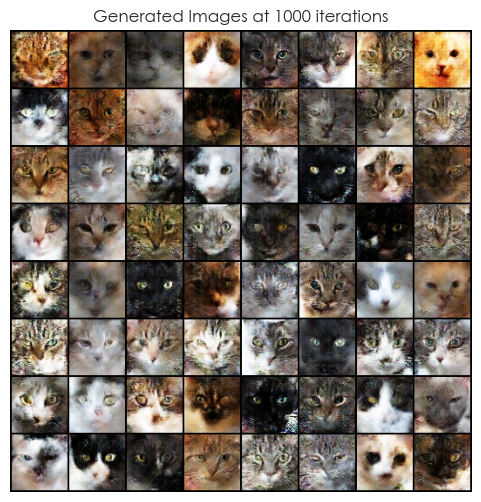

[31/200][10/32] 	Loss_D: -0.1230 | Loss_G: -0.4574 | Iteration Time: 1.2986 sec
[31/200][15/32] 	Loss_D: 0.0085 | Loss_G: -0.6737 | Iteration Time: 0.8431 sec
[31/200][20/32] 	Loss_D: -0.1227 | Loss_G: -0.3899 | Iteration Time: 1.3707 sec
[31/200][25/32] 	Loss_D: -0.1482 | Loss_G: -0.4090 | Iteration Time: 0.7441 sec
[31/200][30/32] 	Loss_D: -0.1012 | Loss_G: -0.2844 | Iteration Time: 1.2077 sec


Training Progress:  16%|█▌        | 32/200 [19:01<1:42:49, 36.72s/it]

[32/200][0/32] 	Loss_D: -0.1380 | Loss_G: -0.3945 | Iteration Time: 1.0881 sec
[32/200][5/32] 	Loss_D: -0.1394 | Loss_G: -0.4123 | Iteration Time: 1.3671 sec
[32/200][10/32] 	Loss_D: -0.0324 | Loss_G: -0.3179 | Iteration Time: 0.9291 sec
[32/200][15/32] 	Loss_D: -0.1501 | Loss_G: -0.4130 | Iteration Time: 0.7588 sec
[32/200][20/32] 	Loss_D: -0.1131 | Loss_G: -0.3086 | Iteration Time: 1.2842 sec
[32/200][25/32] 	Loss_D: -0.1451 | Loss_G: -0.4464 | Iteration Time: 0.8121 sec
[32/200][30/32] 	Loss_D: -0.1238 | Loss_G: -0.4457 | Iteration Time: 1.2291 sec


Training Progress:  16%|█▋        | 33/200 [19:35<1:40:00, 35.93s/it]

[33/200][0/32] 	Loss_D: -0.1162 | Loss_G: -0.4053 | Iteration Time: 1.0653 sec
[33/200][5/32] 	Loss_D: -0.1460 | Loss_G: -0.2458 | Iteration Time: 0.9459 sec
[33/200][10/32] 	Loss_D: -0.1256 | Loss_G: -0.3978 | Iteration Time: 0.8236 sec
[33/200][15/32] 	Loss_D: -0.0268 | Loss_G: -0.6757 | Iteration Time: 1.0814 sec
[33/200][20/32] 	Loss_D: -0.1435 | Loss_G: -0.4613 | Iteration Time: 0.9476 sec
[33/200][25/32] 	Loss_D: -0.0848 | Loss_G: -0.4919 | Iteration Time: 1.2676 sec
[33/200][30/32] 	Loss_D: -0.1448 | Loss_G: -0.4389 | Iteration Time: 1.1786 sec


Training Progress:  17%|█▋        | 34/200 [20:10<1:38:19, 35.54s/it]

[34/200][0/32] 	Loss_D: -0.1379 | Loss_G: -0.4014 | Iteration Time: 1.1731 sec
[34/200][5/32] 	Loss_D: -0.1464 | Loss_G: -0.4336 | Iteration Time: 1.3753 sec
[34/200][10/32] 	Loss_D: -0.1511 | Loss_G: -0.3779 | Iteration Time: 0.9826 sec
[34/200][15/32] 	Loss_D: -0.1430 | Loss_G: -0.4547 | Iteration Time: 0.7521 sec
[34/200][20/32] 	Loss_D: -0.1480 | Loss_G: -0.3796 | Iteration Time: 1.2623 sec
[34/200][25/32] 	Loss_D: -0.0978 | Loss_G: -0.3783 | Iteration Time: 0.8106 sec
[34/200][30/32] 	Loss_D: -0.1286 | Loss_G: -0.4222 | Iteration Time: 1.2361 sec


Training Progress:  18%|█▊        | 35/200 [20:44<1:36:35, 35.13s/it]

[35/200][0/32] 	Loss_D: -0.1609 | Loss_G: -0.4190 | Iteration Time: 1.0751 sec
[35/200][5/32] 	Loss_D: -0.1336 | Loss_G: -0.4420 | Iteration Time: 0.9435 sec
[35/200][10/32] 	Loss_D: -0.1020 | Loss_G: -0.3592 | Iteration Time: 0.8261 sec
[35/200][15/32] 	Loss_D: -0.0852 | Loss_G: -0.3847 | Iteration Time: 1.0807 sec
[35/200][20/32] 	Loss_D: -0.1517 | Loss_G: -0.4061 | Iteration Time: 0.9466 sec
[35/200][25/32] 	Loss_D: -0.1613 | Loss_G: -0.3961 | Iteration Time: 1.1919 sec
[35/200][30/32] 	Loss_D: -0.1257 | Loss_G: -0.3542 | Iteration Time: 1.1881 sec


Training Progress:  18%|█▊        | 36/200 [21:18<1:35:26, 34.92s/it]

[36/200][0/32] 	Loss_D: -0.1304 | Loss_G: -0.5063 | Iteration Time: 1.1602 sec
[36/200][5/32] 	Loss_D: -0.1232 | Loss_G: -0.4268 | Iteration Time: 1.3736 sec
[36/200][10/32] 	Loss_D: -0.1135 | Loss_G: -0.4240 | Iteration Time: 1.0091 sec
[36/200][15/32] 	Loss_D: -0.1247 | Loss_G: -0.5044 | Iteration Time: 0.7446 sec
[36/200][20/32] 	Loss_D: -0.1557 | Loss_G: -0.4394 | Iteration Time: 1.2716 sec
[36/200][25/32] 	Loss_D: -0.1237 | Loss_G: -0.3037 | Iteration Time: 0.8029 sec
[36/200][30/32] 	Loss_D: -0.1259 | Loss_G: -0.4034 | Iteration Time: 1.3166 sec


Training Progress:  18%|█▊        | 37/200 [21:53<1:34:27, 34.77s/it]

[37/200][0/32] 	Loss_D: -0.1437 | Loss_G: -0.4121 | Iteration Time: 1.0666 sec
[37/200][5/32] 	Loss_D: -0.1473 | Loss_G: -0.3279 | Iteration Time: 0.9376 sec
[37/200][10/32] 	Loss_D: -0.0838 | Loss_G: -0.1950 | Iteration Time: 0.8581 sec
[37/200][15/32] 	Loss_D: -0.1716 | Loss_G: -0.3707 | Iteration Time: 1.0931 sec
[37/200][20/32] 	Loss_D: -0.1368 | Loss_G: -0.4705 | Iteration Time: 0.9541 sec
[37/200][25/32] 	Loss_D: -0.0980 | Loss_G: -0.2981 | Iteration Time: 1.2072 sec
[37/200][30/32] 	Loss_D: -0.1514 | Loss_G: -0.3881 | Iteration Time: 1.2211 sec


Training Progress:  19%|█▉        | 38/200 [22:27<1:33:49, 34.75s/it]

[38/200][0/32] 	Loss_D: -0.1463 | Loss_G: -0.4081 | Iteration Time: 1.1468 sec
[38/200][5/32] 	Loss_D: -0.0727 | Loss_G: -0.4921 | Iteration Time: 1.3826 sec
[38/200][10/32] 	Loss_D: -0.1532 | Loss_G: -0.3880 | Iteration Time: 1.0176 sec
[38/200][15/32] 	Loss_D: -0.1213 | Loss_G: -0.3993 | Iteration Time: 0.7471 sec
[38/200][20/32] 	Loss_D: -0.1580 | Loss_G: -0.4377 | Iteration Time: 1.2666 sec
[38/200][25/32] 	Loss_D: -0.1238 | Loss_G: -0.4415 | Iteration Time: 0.8016 sec
[38/200][30/32] 	Loss_D: -0.1517 | Loss_G: -0.4110 | Iteration Time: 1.2918 sec


Training Progress:  20%|█▉        | 39/200 [23:02<1:32:56, 34.64s/it]

[39/200][0/32] 	Loss_D: -0.1542 | Loss_G: -0.4112 | Iteration Time: 1.0812 sec
[39/200][5/32] 	Loss_D: -0.1351 | Loss_G: -0.2681 | Iteration Time: 0.9411 sec
[39/200][10/32] 	Loss_D: -0.1772 | Loss_G: -0.3860 | Iteration Time: 0.8236 sec
[39/200][15/32] 	Loss_D: -0.1744 | Loss_G: -0.3921 | Iteration Time: 1.0827 sec
[39/200][20/32] 	Loss_D: -0.1158 | Loss_G: -0.3606 | Iteration Time: 0.9601 sec
[39/200][25/32] 	Loss_D: -0.1112 | Loss_G: -0.5701 | Iteration Time: 1.1936 sec
[39/200][30/32] 	Loss_D: -0.1208 | Loss_G: -0.3973 | Iteration Time: 1.2006 sec


Training Progress:  20%|██        | 40/200 [23:36<1:32:06, 34.54s/it]

[40/200][0/32] 	Loss_D: -0.1608 | Loss_G: -0.3669 | Iteration Time: 1.1687 sec
[40/200][5/32] 	Loss_D: -0.1493 | Loss_G: -0.4258 | Iteration Time: 1.3296 sec
[40/200][10/32] 	Loss_D: -0.1147 | Loss_G: -0.3061 | Iteration Time: 1.0095 sec
[40/200][15/32] 	Loss_D: -0.1318 | Loss_G: -0.2954 | Iteration Time: 0.7596 sec
[40/200][20/32] 	Loss_D: -0.1566 | Loss_G: -0.4210 | Iteration Time: 1.2722 sec
[40/200][25/32] 	Loss_D: -0.1250 | Loss_G: -0.4788 | Iteration Time: 0.7935 sec
[40/200][30/32] 	Loss_D: -0.1608 | Loss_G: -0.3872 | Iteration Time: 1.4182 sec


Training Progress:  20%|██        | 41/200 [24:11<1:31:41, 34.60s/it]

[41/200][0/32] 	Loss_D: -0.1620 | Loss_G: -0.3792 | Iteration Time: 1.1466 sec
[41/200][5/32] 	Loss_D: -0.1470 | Loss_G: -0.4205 | Iteration Time: 0.9791 sec
[41/200][10/32] 	Loss_D: -0.1461 | Loss_G: -0.4444 | Iteration Time: 0.9556 sec
[41/200][15/32] 	Loss_D: 0.0311 | Loss_G: -0.7389 | Iteration Time: 0.9948 sec
[41/200][20/32] 	Loss_D: -0.1551 | Loss_G: -0.3427 | Iteration Time: 0.8367 sec
[41/200][25/32] 	Loss_D: -0.1527 | Loss_G: -0.3908 | Iteration Time: 1.3512 sec
[41/200][30/32] 	Loss_D: -0.1255 | Loss_G: -0.4338 | Iteration Time: 1.2026 sec


Training Progress:  21%|██        | 42/200 [24:46<1:31:24, 34.71s/it]

[42/200][0/32] 	Loss_D: -0.1878 | Loss_G: -0.4479 | Iteration Time: 1.2272 sec
[42/200][5/32] 	Loss_D: -0.1562 | Loss_G: -0.4037 | Iteration Time: 1.4367 sec
[42/200][10/32] 	Loss_D: -0.1507 | Loss_G: -0.4324 | Iteration Time: 0.9538 sec
[42/200][15/32] 	Loss_D: -0.1650 | Loss_G: -0.4404 | Iteration Time: 0.7181 sec
[42/200][20/32] 	Loss_D: -0.1120 | Loss_G: -0.3602 | Iteration Time: 1.1226 sec
[42/200][25/32] 	Loss_D: -0.1527 | Loss_G: -0.4040 | Iteration Time: 0.7091 sec
[42/200][30/32] 	Loss_D: -0.0986 | Loss_G: -0.4513 | Iteration Time: 1.0941 sec


Training Progress:  22%|██▏       | 43/200 [25:18<1:29:14, 34.11s/it]

[43/200][0/32] 	Loss_D: -0.1648 | Loss_G: -0.3911 | Iteration Time: 1.0652 sec
[43/200][5/32] 	Loss_D: -0.1681 | Loss_G: -0.4331 | Iteration Time: 0.9573 sec
[43/200][10/32] 	Loss_D: -0.1502 | Loss_G: -0.4035 | Iteration Time: 0.7807 sec
[43/200][15/32] 	Loss_D: -0.1675 | Loss_G: -0.3165 | Iteration Time: 1.0303 sec
[43/200][20/32] 	Loss_D: -0.1475 | Loss_G: -0.4059 | Iteration Time: 0.8964 sec
[43/200][25/32] 	Loss_D: -0.1772 | Loss_G: -0.4118 | Iteration Time: 1.1311 sec
[43/200][30/32] 	Loss_D: -0.1747 | Loss_G: -0.4039 | Iteration Time: 1.1227 sec


Training Progress:  22%|██▏       | 44/200 [25:51<1:27:45, 33.75s/it]

[44/200][0/32] 	Loss_D: -0.1465 | Loss_G: -0.4177 | Iteration Time: 1.1741 sec
[44/200][5/32] 	Loss_D: -0.1714 | Loss_G: -0.3986 | Iteration Time: 1.3672 sec
[44/200][10/32] 	Loss_D: -0.1692 | Loss_G: -0.4263 | Iteration Time: 0.9536 sec
[44/200][15/32] 	Loss_D: -0.1755 | Loss_G: -0.3875 | Iteration Time: 0.8156 sec
[44/200][20/32] 	Loss_D: -0.1487 | Loss_G: -0.3237 | Iteration Time: 1.3777 sec
[44/200][25/32] 	Loss_D: -0.1581 | Loss_G: -0.2854 | Iteration Time: 0.9201 sec
[44/200][30/32] 	Loss_D: -0.1807 | Loss_G: -0.3785 | Iteration Time: 1.4757 sec


Training Progress:  22%|██▎       | 45/200 [26:28<1:29:37, 34.70s/it]

[45/200][0/32] 	Loss_D: -0.1633 | Loss_G: -0.4151 | Iteration Time: 1.0366 sec
[45/200][5/32] 	Loss_D: -0.1631 | Loss_G: -0.4127 | Iteration Time: 0.8606 sec
[45/200][10/32] 	Loss_D: -0.1147 | Loss_G: -0.2572 | Iteration Time: 0.8421 sec
[45/200][15/32] 	Loss_D: -0.1350 | Loss_G: -0.3029 | Iteration Time: 1.1782 sec
[45/200][20/32] 	Loss_D: -0.1354 | Loss_G: -0.3581 | Iteration Time: 0.9516 sec
[45/200][25/32] 	Loss_D: -0.1471 | Loss_G: -0.2645 | Iteration Time: 1.1946 sec
[45/200][30/32] 	Loss_D: -0.1531 | Loss_G: -0.3601 | Iteration Time: 1.3476 sec


Training Progress:  23%|██▎       | 46/200 [27:03<1:28:55, 34.65s/it]

[46/200][0/32] 	Loss_D: -0.1201 | Loss_G: -0.4594 | Iteration Time: 1.2211 sec
[46/200][5/32] 	Loss_D: -0.1670 | Loss_G: -0.4303 | Iteration Time: 1.3572 sec
[46/200][10/32] 	Loss_D: -0.1808 | Loss_G: -0.4356 | Iteration Time: 1.1336 sec
[46/200][15/32] 	Loss_D: -0.1694 | Loss_G: -0.3496 | Iteration Time: 0.7981 sec
[46/200][20/32] 	Loss_D: -0.1613 | Loss_G: -0.4315 | Iteration Time: 1.3031 sec
[46/200][25/32] 	Loss_D: -0.1715 | Loss_G: -0.4314 | Iteration Time: 0.8276 sec
Current scores at iteration 1500 | FID: 101.88894653320312 | IS: 2.2773938179016113


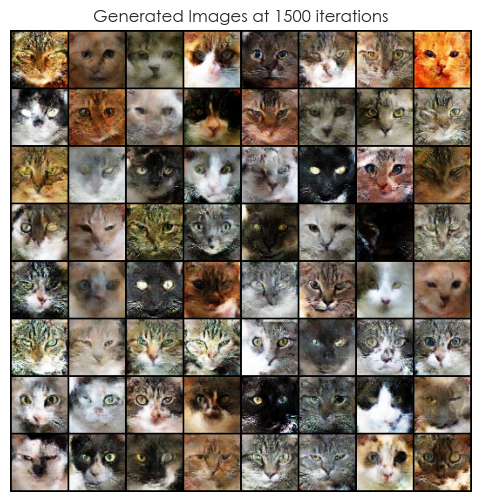

Training Progress:  24%|██▎       | 47/200 [27:44<1:33:06, 36.51s/it]

[46/200][30/32] 	Loss_D: -0.1246 | Loss_G: -0.4690 | Iteration Time: 0.8581 sec
[47/200][0/32] 	Loss_D: -0.1578 | Loss_G: -0.4183 | Iteration Time: 1.0631 sec
[47/200][5/32] 	Loss_D: 0.0360 | Loss_G: -0.7379 | Iteration Time: 1.2841 sec
[47/200][10/32] 	Loss_D: -0.1605 | Loss_G: -0.3659 | Iteration Time: 1.0531 sec
[47/200][15/32] 	Loss_D: -0.1610 | Loss_G: -0.3732 | Iteration Time: 1.4093 sec
[47/200][20/32] 	Loss_D: -0.1636 | Loss_G: -0.4710 | Iteration Time: 0.8356 sec
[47/200][25/32] 	Loss_D: -0.1623 | Loss_G: -0.3900 | Iteration Time: 1.0522 sec
[47/200][30/32] 	Loss_D: -0.1488 | Loss_G: -0.2930 | Iteration Time: 0.9641 sec


Training Progress:  24%|██▍       | 48/200 [28:20<1:32:21, 36.46s/it]

[48/200][0/32] 	Loss_D: -0.1701 | Loss_G: -0.4042 | Iteration Time: 1.0387 sec
[48/200][5/32] 	Loss_D: -0.1696 | Loss_G: -0.3928 | Iteration Time: 1.1136 sec
[48/200][10/32] 	Loss_D: -0.1527 | Loss_G: -0.3983 | Iteration Time: 0.9884 sec
[48/200][15/32] 	Loss_D: -0.1465 | Loss_G: -0.4858 | Iteration Time: 1.3806 sec
[48/200][20/32] 	Loss_D: -0.1590 | Loss_G: -0.4402 | Iteration Time: 1.2727 sec
[48/200][25/32] 	Loss_D: -0.1688 | Loss_G: -0.4214 | Iteration Time: 1.2506 sec


Training Progress:  24%|██▍       | 49/200 [28:57<1:32:26, 36.73s/it]

[48/200][30/32] 	Loss_D: -0.1752 | Loss_G: -0.4040 | Iteration Time: 0.9611 sec
[49/200][0/32] 	Loss_D: -0.0829 | Loss_G: -0.3914 | Iteration Time: 1.0266 sec
[49/200][5/32] 	Loss_D: -0.1570 | Loss_G: -0.4462 | Iteration Time: 1.1341 sec
[49/200][10/32] 	Loss_D: -0.1815 | Loss_G: -0.3657 | Iteration Time: 0.9849 sec
[49/200][15/32] 	Loss_D: -0.1365 | Loss_G: -0.3595 | Iteration Time: 1.3836 sec
[49/200][20/32] 	Loss_D: -0.1566 | Loss_G: -0.3898 | Iteration Time: 1.2796 sec
[49/200][25/32] 	Loss_D: -0.0503 | Loss_G: -0.6776 | Iteration Time: 1.2577 sec


Training Progress:  25%|██▌       | 50/200 [29:35<1:32:27, 36.98s/it]

[49/200][30/32] 	Loss_D: -0.0920 | Loss_G: -0.2360 | Iteration Time: 0.9456 sec
[50/200][0/32] 	Loss_D: -0.1676 | Loss_G: -0.4296 | Iteration Time: 1.0241 sec
[50/200][5/32] 	Loss_D: -0.1571 | Loss_G: -0.3895 | Iteration Time: 1.1146 sec
[50/200][10/32] 	Loss_D: -0.1419 | Loss_G: -0.3722 | Iteration Time: 0.9931 sec
[50/200][15/32] 	Loss_D: 0.1408 | Loss_G: -0.7314 | Iteration Time: 1.4516 sec
[50/200][20/32] 	Loss_D: -0.1845 | Loss_G: -0.4167 | Iteration Time: 1.4632 sec
[50/200][25/32] 	Loss_D: -0.1812 | Loss_G: -0.3621 | Iteration Time: 1.3631 sec


Training Progress:  26%|██▌       | 51/200 [30:14<1:33:24, 37.61s/it]

[50/200][30/32] 	Loss_D: -0.1572 | Loss_G: -0.3494 | Iteration Time: 0.9506 sec
[51/200][0/32] 	Loss_D: -0.1212 | Loss_G: -0.3385 | Iteration Time: 1.0151 sec
[51/200][5/32] 	Loss_D: -0.1783 | Loss_G: -0.3929 | Iteration Time: 1.1096 sec
[51/200][10/32] 	Loss_D: -0.1545 | Loss_G: -0.3230 | Iteration Time: 1.0024 sec
[51/200][15/32] 	Loss_D: -0.1329 | Loss_G: -0.5975 | Iteration Time: 1.3764 sec
[51/200][20/32] 	Loss_D: -0.1703 | Loss_G: -0.3863 | Iteration Time: 1.2896 sec
[51/200][25/32] 	Loss_D: -0.1375 | Loss_G: -0.2386 | Iteration Time: 1.2641 sec


Training Progress:  26%|██▌       | 52/200 [30:52<1:32:46, 37.61s/it]

[51/200][30/32] 	Loss_D: -0.1797 | Loss_G: -0.4390 | Iteration Time: 1.0711 sec
[52/200][0/32] 	Loss_D: -0.1172 | Loss_G: -0.5133 | Iteration Time: 1.1506 sec
[52/200][5/32] 	Loss_D: -0.1770 | Loss_G: -0.3508 | Iteration Time: 1.1886 sec
[52/200][10/32] 	Loss_D: -0.1457 | Loss_G: -0.3027 | Iteration Time: 1.0367 sec
[52/200][15/32] 	Loss_D: -0.1759 | Loss_G: -0.4118 | Iteration Time: 1.4467 sec
[52/200][20/32] 	Loss_D: -0.1471 | Loss_G: -0.4448 | Iteration Time: 1.3851 sec
[52/200][25/32] 	Loss_D: -0.1440 | Loss_G: -0.3885 | Iteration Time: 1.3707 sec


Training Progress:  26%|██▋       | 53/200 [31:32<1:34:26, 38.55s/it]

[52/200][30/32] 	Loss_D: -0.1795 | Loss_G: -0.3888 | Iteration Time: 1.0316 sec
[53/200][0/32] 	Loss_D: -0.1818 | Loss_G: -0.4518 | Iteration Time: 1.0717 sec
[53/200][5/32] 	Loss_D: -0.1807 | Loss_G: -0.3515 | Iteration Time: 1.1716 sec
[53/200][10/32] 	Loss_D: -0.1807 | Loss_G: -0.3262 | Iteration Time: 1.0280 sec
[53/200][15/32] 	Loss_D: -0.1592 | Loss_G: -0.4351 | Iteration Time: 1.4677 sec
[53/200][20/32] 	Loss_D: -0.1447 | Loss_G: -0.2925 | Iteration Time: 1.3646 sec
[53/200][25/32] 	Loss_D: -0.1708 | Loss_G: -0.4560 | Iteration Time: 1.3311 sec


Training Progress:  27%|██▋       | 54/200 [32:12<1:34:37, 38.88s/it]

[53/200][30/32] 	Loss_D: -0.1677 | Loss_G: -0.4087 | Iteration Time: 1.0231 sec
[54/200][0/32] 	Loss_D: -0.1763 | Loss_G: -0.4104 | Iteration Time: 1.1147 sec
[54/200][5/32] 	Loss_D: -0.1687 | Loss_G: -0.4140 | Iteration Time: 1.1957 sec
[54/200][10/32] 	Loss_D: -0.1671 | Loss_G: -0.4211 | Iteration Time: 1.0576 sec
[54/200][15/32] 	Loss_D: -0.1648 | Loss_G: -0.3257 | Iteration Time: 1.5452 sec
[54/200][20/32] 	Loss_D: -0.1562 | Loss_G: -0.3872 | Iteration Time: 1.5127 sec
[54/200][25/32] 	Loss_D: -0.1794 | Loss_G: -0.4712 | Iteration Time: 1.4387 sec


Training Progress:  28%|██▊       | 55/200 [32:52<1:35:08, 39.37s/it]

[54/200][30/32] 	Loss_D: -0.1290 | Loss_G: -0.4120 | Iteration Time: 0.9301 sec
[55/200][0/32] 	Loss_D: -0.1755 | Loss_G: -0.4045 | Iteration Time: 0.9956 sec
[55/200][5/32] 	Loss_D: -0.1588 | Loss_G: -0.3469 | Iteration Time: 1.1006 sec
[55/200][10/32] 	Loss_D: -0.0700 | Loss_G: -0.2431 | Iteration Time: 0.9806 sec
[55/200][15/32] 	Loss_D: -0.1630 | Loss_G: -0.3435 | Iteration Time: 1.3742 sec
[55/200][20/32] 	Loss_D: -0.1473 | Loss_G: -0.3206 | Iteration Time: 1.2512 sec
[55/200][25/32] 	Loss_D: -0.1435 | Loss_G: -0.2413 | Iteration Time: 1.2262 sec


Training Progress:  28%|██▊       | 56/200 [33:30<1:32:53, 38.70s/it]

[55/200][30/32] 	Loss_D: -0.1690 | Loss_G: -0.4449 | Iteration Time: 0.9176 sec
[56/200][0/32] 	Loss_D: -0.1825 | Loss_G: -0.3759 | Iteration Time: 0.9831 sec
[56/200][5/32] 	Loss_D: -0.1772 | Loss_G: -0.3430 | Iteration Time: 1.1236 sec
[56/200][10/32] 	Loss_D: -0.1831 | Loss_G: -0.4037 | Iteration Time: 1.0761 sec
[56/200][15/32] 	Loss_D: -0.1815 | Loss_G: -0.3968 | Iteration Time: 1.5192 sec
[56/200][20/32] 	Loss_D: -0.1787 | Loss_G: -0.4098 | Iteration Time: 1.4312 sec
[56/200][25/32] 	Loss_D: -0.1533 | Loss_G: -0.4514 | Iteration Time: 1.4188 sec


Training Progress:  28%|██▊       | 57/200 [34:10<1:33:42, 39.32s/it]

[56/200][30/32] 	Loss_D: -0.1695 | Loss_G: -0.3675 | Iteration Time: 1.0727 sec
[57/200][0/32] 	Loss_D: -0.1677 | Loss_G: -0.4254 | Iteration Time: 1.1582 sec
[57/200][5/32] 	Loss_D: -0.1573 | Loss_G: -0.3829 | Iteration Time: 1.2092 sec
[57/200][10/32] 	Loss_D: -0.1010 | Loss_G: -0.3290 | Iteration Time: 1.0716 sec
[57/200][15/32] 	Loss_D: -0.0736 | Loss_G: -0.5659 | Iteration Time: 1.4957 sec
[57/200][20/32] 	Loss_D: -0.1782 | Loss_G: -0.4112 | Iteration Time: 1.3771 sec
[57/200][25/32] 	Loss_D: -0.1881 | Loss_G: -0.3746 | Iteration Time: 1.5372 sec


Training Progress:  29%|██▉       | 58/200 [34:51<1:33:59, 39.71s/it]

[57/200][30/32] 	Loss_D: -0.1833 | Loss_G: -0.3893 | Iteration Time: 1.0321 sec
[58/200][0/32] 	Loss_D: -0.1662 | Loss_G: -0.4019 | Iteration Time: 0.9656 sec
[58/200][5/32] 	Loss_D: -0.1398 | Loss_G: -0.2843 | Iteration Time: 1.0817 sec
[58/200][10/32] 	Loss_D: -0.1890 | Loss_G: -0.4009 | Iteration Time: 1.0031 sec
[58/200][15/32] 	Loss_D: -0.1745 | Loss_G: -0.3849 | Iteration Time: 1.4071 sec
[58/200][20/32] 	Loss_D: -0.1795 | Loss_G: -0.4382 | Iteration Time: 1.2776 sec
[58/200][25/32] 	Loss_D: -0.1435 | Loss_G: -0.4103 | Iteration Time: 1.2166 sec


Training Progress:  30%|██▉       | 59/200 [35:28<1:31:27, 38.92s/it]

[58/200][30/32] 	Loss_D: -0.1757 | Loss_G: -0.3928 | Iteration Time: 0.9266 sec
[59/200][0/32] 	Loss_D: -0.1457 | Loss_G: -0.4367 | Iteration Time: 0.9897 sec
[59/200][5/32] 	Loss_D: -0.2041 | Loss_G: -0.3299 | Iteration Time: 1.0766 sec
[59/200][10/32] 	Loss_D: -0.1733 | Loss_G: -0.2679 | Iteration Time: 0.9690 sec
[59/200][15/32] 	Loss_D: -0.1816 | Loss_G: -0.3922 | Iteration Time: 1.3621 sec
[59/200][20/32] 	Loss_D: -0.1795 | Loss_G: -0.3498 | Iteration Time: 1.3176 sec
[59/200][25/32] 	Loss_D: -0.1521 | Loss_G: -0.4042 | Iteration Time: 1.2286 sec


Training Progress:  30%|███       | 60/200 [36:05<1:29:21, 38.30s/it]

[59/200][30/32] 	Loss_D: -0.1635 | Loss_G: -0.3944 | Iteration Time: 0.9801 sec
[60/200][0/32] 	Loss_D: -0.1999 | Loss_G: -0.3708 | Iteration Time: 1.0706 sec
[60/200][5/32] 	Loss_D: -0.1695 | Loss_G: -0.3595 | Iteration Time: 1.0956 sec
[60/200][10/32] 	Loss_D: -0.1931 | Loss_G: -0.4460 | Iteration Time: 0.9861 sec
[60/200][15/32] 	Loss_D: -0.1748 | Loss_G: -0.3790 | Iteration Time: 1.5237 sec
[60/200][20/32] 	Loss_D: -0.1732 | Loss_G: -0.3363 | Iteration Time: 1.2617 sec
[60/200][25/32] 	Loss_D: -0.1806 | Loss_G: -0.4186 | Iteration Time: 1.3181 sec


Training Progress:  30%|███       | 61/200 [36:43<1:28:27, 38.18s/it]

[60/200][30/32] 	Loss_D: -0.1124 | Loss_G: -0.1934 | Iteration Time: 0.9041 sec
[61/200][0/32] 	Loss_D: -0.1510 | Loss_G: -0.4881 | Iteration Time: 0.9631 sec
[61/200][5/32] 	Loss_D: -0.1849 | Loss_G: -0.4170 | Iteration Time: 1.0947 sec
[61/200][10/32] 	Loss_D: -0.1587 | Loss_G: -0.4709 | Iteration Time: 1.0282 sec
[61/200][15/32] 	Loss_D: -0.1830 | Loss_G: -0.4517 | Iteration Time: 1.5977 sec
[61/200][20/32] 	Loss_D: -0.1656 | Loss_G: -0.4270 | Iteration Time: 1.4266 sec
[61/200][25/32] 	Loss_D: -0.1572 | Loss_G: -0.6869 | Iteration Time: 1.3866 sec


Training Progress:  31%|███       | 62/200 [37:23<1:29:02, 38.72s/it]

[61/200][30/32] 	Loss_D: -0.1724 | Loss_G: -0.3735 | Iteration Time: 1.0761 sec
[62/200][0/32] 	Loss_D: -0.1883 | Loss_G: -0.3915 | Iteration Time: 1.1672 sec
[62/200][5/32] 	Loss_D: -0.1875 | Loss_G: -0.3828 | Iteration Time: 1.2106 sec
[62/200][10/32] 	Loss_D: -0.1847 | Loss_G: -0.3413 | Iteration Time: 1.1146 sec
[62/200][15/32] 	Loss_D: -0.1520 | Loss_G: -0.4441 | Iteration Time: 1.3311 sec
Current scores at iteration 2000 | FID: 86.91372680664062 | IS: 2.449937105178833


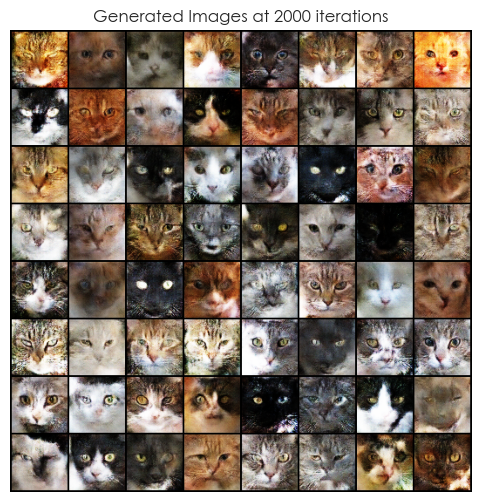

[62/200][20/32] 	Loss_D: -0.1846 | Loss_G: -0.3697 | Iteration Time: 0.9486 sec
[62/200][25/32] 	Loss_D: -0.1970 | Loss_G: -0.3766 | Iteration Time: 1.1121 sec
[62/200][30/32] 	Loss_D: 0.0903 | Loss_G: -0.2575 | Iteration Time: 1.1942 sec


Training Progress:  32%|███▏      | 63/200 [38:08<1:32:46, 40.63s/it]

[63/200][0/32] 	Loss_D: -0.1769 | Loss_G: -0.3962 | Iteration Time: 1.0706 sec
[63/200][5/32] 	Loss_D: -0.1620 | Loss_G: -0.3861 | Iteration Time: 1.0851 sec
[63/200][10/32] 	Loss_D: -0.1606 | Loss_G: -0.4461 | Iteration Time: 0.8636 sec
[63/200][15/32] 	Loss_D: -0.2054 | Loss_G: -0.3216 | Iteration Time: 1.2821 sec
[63/200][20/32] 	Loss_D: -0.1474 | Loss_G: -0.5177 | Iteration Time: 0.7501 sec
[63/200][25/32] 	Loss_D: -0.1388 | Loss_G: -0.5270 | Iteration Time: 1.0536 sec
[63/200][30/32] 	Loss_D: -0.1724 | Loss_G: -0.3504 | Iteration Time: 1.1541 sec


Training Progress:  32%|███▏      | 64/200 [38:41<1:27:05, 38.42s/it]

[64/200][0/32] 	Loss_D: -0.1860 | Loss_G: -0.4655 | Iteration Time: 1.0401 sec
[64/200][5/32] 	Loss_D: -0.1759 | Loss_G: -0.3626 | Iteration Time: 1.1352 sec
[64/200][10/32] 	Loss_D: -0.1450 | Loss_G: -0.3788 | Iteration Time: 0.7901 sec
[64/200][15/32] 	Loss_D: -0.1793 | Loss_G: -0.4751 | Iteration Time: 1.2356 sec
[64/200][20/32] 	Loss_D: -0.1439 | Loss_G: -0.2148 | Iteration Time: 0.7346 sec
[64/200][25/32] 	Loss_D: -0.1949 | Loss_G: -0.3421 | Iteration Time: 1.0511 sec
[64/200][30/32] 	Loss_D: -0.1960 | Loss_G: -0.4061 | Iteration Time: 1.1231 sec


Training Progress:  32%|███▎      | 65/200 [39:13<1:22:04, 36.48s/it]

[65/200][0/32] 	Loss_D: -0.1414 | Loss_G: -0.2690 | Iteration Time: 1.0351 sec
[65/200][5/32] 	Loss_D: -0.1908 | Loss_G: -0.3791 | Iteration Time: 1.0966 sec
[65/200][10/32] 	Loss_D: -0.2006 | Loss_G: -0.3351 | Iteration Time: 0.8211 sec
[65/200][15/32] 	Loss_D: -0.1899 | Loss_G: -0.3891 | Iteration Time: 1.3251 sec
[65/200][20/32] 	Loss_D: -0.1587 | Loss_G: -0.4711 | Iteration Time: 0.7656 sec
[65/200][25/32] 	Loss_D: -0.1893 | Loss_G: -0.4182 | Iteration Time: 1.0731 sec
[65/200][30/32] 	Loss_D: -0.1695 | Loss_G: -0.3925 | Iteration Time: 1.2272 sec


Training Progress:  33%|███▎      | 66/200 [39:46<1:19:02, 35.39s/it]

[66/200][0/32] 	Loss_D: -0.1745 | Loss_G: -0.4718 | Iteration Time: 1.0686 sec
[66/200][5/32] 	Loss_D: -0.2125 | Loss_G: -0.3671 | Iteration Time: 1.1531 sec
[66/200][10/32] 	Loss_D: -0.2040 | Loss_G: -0.3532 | Iteration Time: 0.7761 sec
[66/200][15/32] 	Loss_D: -0.1858 | Loss_G: -0.3474 | Iteration Time: 1.2946 sec
[66/200][20/32] 	Loss_D: -0.1816 | Loss_G: -0.4722 | Iteration Time: 0.8221 sec
[66/200][25/32] 	Loss_D: -0.1739 | Loss_G: -0.3894 | Iteration Time: 1.0651 sec
[66/200][30/32] 	Loss_D: -0.1874 | Loss_G: -0.3689 | Iteration Time: 1.1521 sec


Training Progress:  34%|███▎      | 67/200 [40:19<1:16:59, 34.74s/it]

[67/200][0/32] 	Loss_D: -0.1984 | Loss_G: -0.3729 | Iteration Time: 1.0571 sec
[67/200][5/32] 	Loss_D: -0.1833 | Loss_G: -0.3599 | Iteration Time: 1.0891 sec
[67/200][10/32] 	Loss_D: -0.1917 | Loss_G: -0.3893 | Iteration Time: 0.7571 sec
[67/200][15/32] 	Loss_D: -0.2039 | Loss_G: -0.4706 | Iteration Time: 1.3101 sec
[67/200][20/32] 	Loss_D: -0.1719 | Loss_G: -0.4008 | Iteration Time: 0.8346 sec
[67/200][25/32] 	Loss_D: -0.1103 | Loss_G: -0.4678 | Iteration Time: 1.0901 sec
[67/200][30/32] 	Loss_D: -0.1779 | Loss_G: -0.4692 | Iteration Time: 1.1636 sec


Training Progress:  34%|███▍      | 68/200 [40:52<1:14:59, 34.08s/it]

[68/200][0/32] 	Loss_D: -0.1642 | Loss_G: -0.4440 | Iteration Time: 1.0976 sec
[68/200][5/32] 	Loss_D: -0.2000 | Loss_G: -0.3790 | Iteration Time: 1.1071 sec
[68/200][10/32] 	Loss_D: -0.2027 | Loss_G: -0.3316 | Iteration Time: 0.7706 sec
[68/200][15/32] 	Loss_D: -0.1776 | Loss_G: -0.2843 | Iteration Time: 1.3672 sec
[68/200][20/32] 	Loss_D: -0.2064 | Loss_G: -0.3642 | Iteration Time: 0.7526 sec
[68/200][25/32] 	Loss_D: -0.1655 | Loss_G: -0.6098 | Iteration Time: 1.0701 sec
[68/200][30/32] 	Loss_D: -0.1951 | Loss_G: -0.3846 | Iteration Time: 1.1521 sec


Training Progress:  34%|███▍      | 69/200 [41:24<1:13:33, 33.69s/it]

[69/200][0/32] 	Loss_D: -0.1984 | Loss_G: -0.4009 | Iteration Time: 1.0846 sec
[69/200][5/32] 	Loss_D: -0.1813 | Loss_G: -0.3896 | Iteration Time: 1.0726 sec
[69/200][10/32] 	Loss_D: -0.1695 | Loss_G: -0.2601 | Iteration Time: 0.7626 sec
[69/200][15/32] 	Loss_D: -0.1397 | Loss_G: -0.2276 | Iteration Time: 1.2512 sec
[69/200][20/32] 	Loss_D: -0.1875 | Loss_G: -0.3597 | Iteration Time: 0.7351 sec
[69/200][25/32] 	Loss_D: -0.1768 | Loss_G: -0.4939 | Iteration Time: 1.0762 sec
[69/200][30/32] 	Loss_D: -0.1289 | Loss_G: -0.2100 | Iteration Time: 1.1346 sec


Training Progress:  35%|███▌      | 70/200 [41:57<1:12:05, 33.27s/it]

[70/200][0/32] 	Loss_D: -0.1987 | Loss_G: -0.4012 | Iteration Time: 1.0996 sec
[70/200][5/32] 	Loss_D: -0.1882 | Loss_G: -0.3948 | Iteration Time: 1.0801 sec
[70/200][10/32] 	Loss_D: -0.1795 | Loss_G: -0.4457 | Iteration Time: 0.8361 sec
[70/200][15/32] 	Loss_D: -0.2210 | Loss_G: -0.4042 | Iteration Time: 1.2897 sec
[70/200][20/32] 	Loss_D: -0.1952 | Loss_G: -0.4133 | Iteration Time: 0.8241 sec
[70/200][25/32] 	Loss_D: -0.2020 | Loss_G: -0.3229 | Iteration Time: 1.1661 sec
[70/200][30/32] 	Loss_D: -0.1825 | Loss_G: -0.3841 | Iteration Time: 1.2641 sec


Training Progress:  36%|███▌      | 71/200 [42:31<1:11:53, 33.44s/it]

[71/200][0/32] 	Loss_D: -0.0968 | Loss_G: -0.3628 | Iteration Time: 1.1896 sec
[71/200][5/32] 	Loss_D: -0.2202 | Loss_G: -0.4265 | Iteration Time: 1.0911 sec
[71/200][10/32] 	Loss_D: -0.1694 | Loss_G: -0.4033 | Iteration Time: 0.7867 sec
[71/200][15/32] 	Loss_D: -0.1610 | Loss_G: -0.4161 | Iteration Time: 1.2876 sec
[71/200][20/32] 	Loss_D: -0.1846 | Loss_G: -0.3678 | Iteration Time: 0.7286 sec
[71/200][25/32] 	Loss_D: -0.1906 | Loss_G: -0.4038 | Iteration Time: 1.0461 sec
[71/200][30/32] 	Loss_D: -0.1872 | Loss_G: -0.3982 | Iteration Time: 1.1812 sec


Training Progress:  36%|███▌      | 72/200 [43:03<1:10:50, 33.21s/it]

[72/200][0/32] 	Loss_D: -0.1715 | Loss_G: -0.4186 | Iteration Time: 1.1316 sec
[72/200][5/32] 	Loss_D: -0.2111 | Loss_G: -0.5622 | Iteration Time: 1.1976 sec
[72/200][10/32] 	Loss_D: -0.1807 | Loss_G: -0.4446 | Iteration Time: 0.8061 sec
[72/200][15/32] 	Loss_D: -0.1998 | Loss_G: -0.3541 | Iteration Time: 1.2541 sec
[72/200][20/32] 	Loss_D: -0.1481 | Loss_G: -0.4237 | Iteration Time: 0.8206 sec
[72/200][25/32] 	Loss_D: -0.0673 | Loss_G: -0.2123 | Iteration Time: 1.2051 sec
[72/200][30/32] 	Loss_D: -0.1873 | Loss_G: -0.3956 | Iteration Time: 1.2816 sec


Training Progress:  36%|███▋      | 73/200 [43:38<1:11:05, 33.59s/it]

[73/200][0/32] 	Loss_D: -0.2011 | Loss_G: -0.3853 | Iteration Time: 1.1536 sec
[73/200][5/32] 	Loss_D: -0.2038 | Loss_G: -0.3642 | Iteration Time: 1.2141 sec
[73/200][10/32] 	Loss_D: -0.1526 | Loss_G: -0.3698 | Iteration Time: 0.8466 sec
[73/200][15/32] 	Loss_D: -0.1619 | Loss_G: -0.7025 | Iteration Time: 1.3827 sec
[73/200][20/32] 	Loss_D: -0.1904 | Loss_G: -0.3914 | Iteration Time: 0.8426 sec
[73/200][25/32] 	Loss_D: -0.1784 | Loss_G: -0.5530 | Iteration Time: 1.2041 sec
[73/200][30/32] 	Loss_D: -0.1964 | Loss_G: -0.3951 | Iteration Time: 1.2081 sec


Training Progress:  37%|███▋      | 74/200 [44:13<1:11:29, 34.04s/it]

[74/200][0/32] 	Loss_D: -0.1879 | Loss_G: -0.3867 | Iteration Time: 1.2216 sec
[74/200][5/32] 	Loss_D: -0.1569 | Loss_G: -0.4363 | Iteration Time: 1.2186 sec
[74/200][10/32] 	Loss_D: -0.1820 | Loss_G: -0.4054 | Iteration Time: 0.8436 sec
[74/200][15/32] 	Loss_D: -0.2054 | Loss_G: -0.3287 | Iteration Time: 1.3751 sec
[74/200][20/32] 	Loss_D: -0.1858 | Loss_G: -0.2900 | Iteration Time: 0.7281 sec
[74/200][25/32] 	Loss_D: -0.2070 | Loss_G: -0.2704 | Iteration Time: 1.0836 sec
[74/200][30/32] 	Loss_D: -0.1641 | Loss_G: -0.3644 | Iteration Time: 1.2222 sec


Training Progress:  38%|███▊      | 75/200 [44:47<1:10:51, 34.01s/it]

[75/200][0/32] 	Loss_D: -0.2142 | Loss_G: -0.3980 | Iteration Time: 1.1641 sec
[75/200][5/32] 	Loss_D: -0.1912 | Loss_G: -0.4058 | Iteration Time: 1.2232 sec
[75/200][10/32] 	Loss_D: -0.1554 | Loss_G: -0.2129 | Iteration Time: 0.7641 sec
[75/200][15/32] 	Loss_D: -0.2123 | Loss_G: -0.3146 | Iteration Time: 1.2576 sec
[75/200][20/32] 	Loss_D: -0.1727 | Loss_G: -0.4265 | Iteration Time: 0.7696 sec
[75/200][25/32] 	Loss_D: -0.1338 | Loss_G: -0.1450 | Iteration Time: 1.0586 sec
[75/200][30/32] 	Loss_D: -0.1769 | Loss_G: -0.4577 | Iteration Time: 1.1623 sec


Training Progress:  38%|███▊      | 76/200 [45:20<1:09:31, 33.64s/it]

[76/200][0/32] 	Loss_D: -0.2001 | Loss_G: -0.3375 | Iteration Time: 1.0901 sec
[76/200][5/32] 	Loss_D: -0.1785 | Loss_G: -0.3573 | Iteration Time: 1.0671 sec
[76/200][10/32] 	Loss_D: -0.0660 | Loss_G: -0.7262 | Iteration Time: 0.7656 sec
[76/200][15/32] 	Loss_D: -0.2200 | Loss_G: -0.3901 | Iteration Time: 1.2682 sec
[76/200][20/32] 	Loss_D: -0.1726 | Loss_G: -0.2343 | Iteration Time: 0.7576 sec
[76/200][25/32] 	Loss_D: -0.2183 | Loss_G: -0.3115 | Iteration Time: 1.0636 sec
[76/200][30/32] 	Loss_D: -0.2165 | Loss_G: -0.3668 | Iteration Time: 1.1941 sec


Training Progress:  38%|███▊      | 77/200 [45:52<1:08:03, 33.20s/it]

[77/200][0/32] 	Loss_D: -0.1946 | Loss_G: -0.3882 | Iteration Time: 1.0481 sec
[77/200][5/32] 	Loss_D: -0.1942 | Loss_G: -0.2672 | Iteration Time: 1.1136 sec
[77/200][10/32] 	Loss_D: -0.1945 | Loss_G: -0.3413 | Iteration Time: 0.7721 sec
[77/200][15/32] 	Loss_D: -0.1890 | Loss_G: -0.4162 | Iteration Time: 1.2277 sec
[77/200][20/32] 	Loss_D: -0.2080 | Loss_G: -0.3443 | Iteration Time: 0.7551 sec
[77/200][25/32] 	Loss_D: -0.1726 | Loss_G: -0.3831 | Iteration Time: 1.0741 sec
[77/200][30/32] 	Loss_D: -0.1810 | Loss_G: -0.2557 | Iteration Time: 1.2126 sec


Training Progress:  39%|███▉      | 78/200 [46:24<1:06:51, 32.88s/it]

[78/200][0/32] 	Loss_D: -0.1708 | Loss_G: -0.4628 | Iteration Time: 1.1031 sec
Current scores at iteration 2500 | FID: 91.93374633789062 | IS: 2.5088324546813965


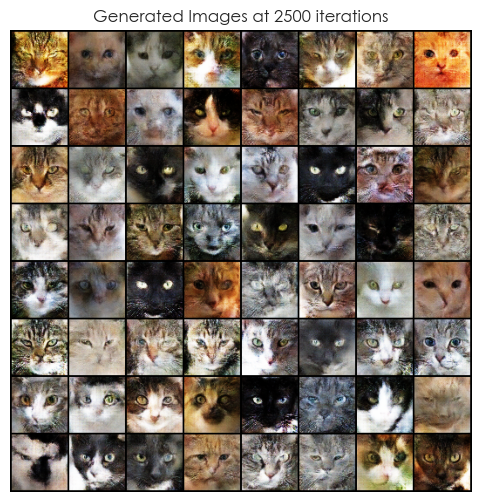

[78/200][5/32] 	Loss_D: -0.1905 | Loss_G: -0.5468 | Iteration Time: 1.4357 sec
[78/200][10/32] 	Loss_D: -0.1494 | Loss_G: -0.6368 | Iteration Time: 1.0652 sec
[78/200][15/32] 	Loss_D: -0.0711 | Loss_G: -0.5713 | Iteration Time: 1.0011 sec
[78/200][20/32] 	Loss_D: -0.1644 | Loss_G: -0.2336 | Iteration Time: 0.6436 sec
[78/200][25/32] 	Loss_D: -0.2138 | Loss_G: -0.3589 | Iteration Time: 1.1366 sec


Training Progress:  40%|███▉      | 79/200 [46:57<1:06:36, 33.03s/it]

[78/200][30/32] 	Loss_D: -0.1929 | Loss_G: -0.4205 | Iteration Time: 0.5365 sec
[79/200][0/32] 	Loss_D: -0.2020 | Loss_G: -0.3909 | Iteration Time: 1.0676 sec
[79/200][5/32] 	Loss_D: -0.2069 | Loss_G: -0.3951 | Iteration Time: 1.0931 sec
[79/200][10/32] 	Loss_D: -0.1544 | Loss_G: -0.3360 | Iteration Time: 0.4195 sec
[79/200][15/32] 	Loss_D: -0.2190 | Loss_G: -0.3626 | Iteration Time: 1.1972 sec
[79/200][20/32] 	Loss_D: -0.2086 | Loss_G: -0.3561 | Iteration Time: 0.8051 sec
[79/200][25/32] 	Loss_D: -0.1656 | Loss_G: -0.3817 | Iteration Time: 1.0732 sec
[79/200][30/32] 	Loss_D: -0.2083 | Loss_G: -0.3952 | Iteration Time: 1.0351 sec


Training Progress:  40%|████      | 80/200 [47:26<1:03:16, 31.64s/it]

[80/200][0/32] 	Loss_D: -0.1956 | Loss_G: -0.3891 | Iteration Time: 0.9701 sec
[80/200][5/32] 	Loss_D: -0.1828 | Loss_G: -0.5316 | Iteration Time: 0.9236 sec
[80/200][10/32] 	Loss_D: -0.2010 | Loss_G: -0.4129 | Iteration Time: 0.5371 sec
[80/200][15/32] 	Loss_D: -0.0867 | Loss_G: -0.1995 | Iteration Time: 0.4170 sec
[80/200][20/32] 	Loss_D: -0.1977 | Loss_G: -0.4395 | Iteration Time: 0.9096 sec
[80/200][25/32] 	Loss_D: -0.2163 | Loss_G: -0.3545 | Iteration Time: 0.5766 sec


Training Progress:  40%|████      | 81/200 [47:52<59:21, 29.93s/it]  

[80/200][30/32] 	Loss_D: -0.1955 | Loss_G: -0.2933 | Iteration Time: 0.9121 sec
[81/200][0/32] 	Loss_D: -0.2158 | Loss_G: -0.3819 | Iteration Time: 1.0447 sec
[81/200][5/32] 	Loss_D: -0.2061 | Loss_G: -0.3718 | Iteration Time: 0.8982 sec
[81/200][10/32] 	Loss_D: -0.2106 | Loss_G: -0.2813 | Iteration Time: 0.8521 sec
[81/200][15/32] 	Loss_D: -0.1610 | Loss_G: -0.1583 | Iteration Time: 0.8167 sec
[81/200][20/32] 	Loss_D: -0.2121 | Loss_G: -0.3679 | Iteration Time: 0.4020 sec
[81/200][25/32] 	Loss_D: -0.1966 | Loss_G: -0.3633 | Iteration Time: 0.9116 sec


Training Progress:  41%|████      | 82/200 [48:20<57:48, 29.40s/it]

[81/200][30/32] 	Loss_D: -0.1705 | Loss_G: -0.3253 | Iteration Time: 0.8161 sec
[82/200][0/32] 	Loss_D: -0.1796 | Loss_G: -0.2895 | Iteration Time: 1.0296 sec
[82/200][5/32] 	Loss_D: 0.1625 | Loss_G: -0.6011 | Iteration Time: 1.0756 sec
[82/200][10/32] 	Loss_D: -0.2371 | Loss_G: -0.3707 | Iteration Time: 0.4296 sec
[82/200][15/32] 	Loss_D: -0.2037 | Loss_G: -0.3566 | Iteration Time: 1.2292 sec
[82/200][20/32] 	Loss_D: -0.1996 | Loss_G: -0.3924 | Iteration Time: 0.8166 sec
[82/200][25/32] 	Loss_D: -0.1578 | Loss_G: -0.4543 | Iteration Time: 1.0671 sec
[82/200][30/32] 	Loss_D: -0.2124 | Loss_G: -0.3928 | Iteration Time: 1.0416 sec


Training Progress:  42%|████▏     | 83/200 [48:48<56:42, 29.08s/it]

[83/200][0/32] 	Loss_D: -0.2114 | Loss_G: -0.4384 | Iteration Time: 0.9742 sec
[83/200][5/32] 	Loss_D: -0.2150 | Loss_G: -0.3524 | Iteration Time: 0.9011 sec
[83/200][10/32] 	Loss_D: -0.1924 | Loss_G: -0.2141 | Iteration Time: 0.5401 sec
[83/200][15/32] 	Loss_D: -0.2140 | Loss_G: -0.4753 | Iteration Time: 0.4145 sec
[83/200][20/32] 	Loss_D: -0.1781 | Loss_G: -0.3215 | Iteration Time: 0.9021 sec
[83/200][25/32] 	Loss_D: -0.1836 | Loss_G: -0.3968 | Iteration Time: 0.6086 sec


Training Progress:  42%|████▏     | 84/200 [49:14<54:25, 28.15s/it]

[83/200][30/32] 	Loss_D: -0.1870 | Loss_G: -0.3757 | Iteration Time: 0.8761 sec
[84/200][0/32] 	Loss_D: -0.1743 | Loss_G: -0.4338 | Iteration Time: 0.9176 sec
[84/200][5/32] 	Loss_D: -0.2268 | Loss_G: -0.4860 | Iteration Time: 0.9771 sec
[84/200][10/32] 	Loss_D: -0.1795 | Loss_G: -0.5050 | Iteration Time: 0.8636 sec
[84/200][15/32] 	Loss_D: -0.2057 | Loss_G: -0.4710 | Iteration Time: 0.8801 sec
[84/200][20/32] 	Loss_D: -0.2116 | Loss_G: -0.4198 | Iteration Time: 0.4786 sec
[84/200][25/32] 	Loss_D: -0.1289 | Loss_G: -0.2645 | Iteration Time: 1.0452 sec


Training Progress:  42%|████▎     | 85/200 [49:45<55:28, 28.95s/it]

[84/200][30/32] 	Loss_D: -0.2035 | Loss_G: -0.3826 | Iteration Time: 0.9666 sec
[85/200][0/32] 	Loss_D: -0.2093 | Loss_G: -0.4160 | Iteration Time: 1.1356 sec
[85/200][5/32] 	Loss_D: -0.2098 | Loss_G: -0.3777 | Iteration Time: 1.1996 sec
[85/200][10/32] 	Loss_D: -0.2345 | Loss_G: -0.3284 | Iteration Time: 0.4690 sec
[85/200][15/32] 	Loss_D: -0.2006 | Loss_G: -0.3230 | Iteration Time: 1.3241 sec
[85/200][20/32] 	Loss_D: -0.2142 | Loss_G: -0.4375 | Iteration Time: 0.9236 sec
[85/200][25/32] 	Loss_D: -0.2233 | Loss_G: -0.2645 | Iteration Time: 1.2171 sec
[85/200][30/32] 	Loss_D: -0.1930 | Loss_G: -0.6012 | Iteration Time: 1.1846 sec


Training Progress:  43%|████▎     | 86/200 [50:17<56:34, 29.78s/it]

[86/200][0/32] 	Loss_D: -0.2288 | Loss_G: -0.4493 | Iteration Time: 1.1241 sec
[86/200][5/32] 	Loss_D: -0.1954 | Loss_G: -0.3970 | Iteration Time: 1.0661 sec
[86/200][10/32] 	Loss_D: -0.2103 | Loss_G: -0.3952 | Iteration Time: 0.5971 sec
[86/200][15/32] 	Loss_D: -0.1789 | Loss_G: -0.3797 | Iteration Time: 0.5146 sec
[86/200][20/32] 	Loss_D: -0.2374 | Loss_G: -0.2878 | Iteration Time: 1.0551 sec
[86/200][25/32] 	Loss_D: -0.2208 | Loss_G: -0.3587 | Iteration Time: 0.6356 sec


Training Progress:  44%|████▎     | 87/200 [50:46<56:02, 29.76s/it]

[86/200][30/32] 	Loss_D: -0.1712 | Loss_G: -0.1819 | Iteration Time: 1.0091 sec
[87/200][0/32] 	Loss_D: -0.1973 | Loss_G: -0.3949 | Iteration Time: 1.0286 sec
[87/200][5/32] 	Loss_D: -0.2014 | Loss_G: -0.4213 | Iteration Time: 1.0261 sec
[87/200][10/32] 	Loss_D: -0.2176 | Loss_G: -0.3359 | Iteration Time: 0.9726 sec
[87/200][15/32] 	Loss_D: -0.1770 | Loss_G: -0.1788 | Iteration Time: 0.9506 sec
[87/200][20/32] 	Loss_D: -0.1950 | Loss_G: -0.3272 | Iteration Time: 0.5031 sec
[87/200][25/32] 	Loss_D: -0.1464 | Loss_G: -0.4644 | Iteration Time: 1.0701 sec


Training Progress:  44%|████▍     | 88/200 [51:19<57:04, 30.58s/it]

[87/200][30/32] 	Loss_D: -0.1974 | Loss_G: -0.3294 | Iteration Time: 0.9971 sec
[88/200][0/32] 	Loss_D: -0.2133 | Loss_G: -0.2965 | Iteration Time: 1.1137 sec
[88/200][5/32] 	Loss_D: -0.2302 | Loss_G: -0.3021 | Iteration Time: 1.2077 sec
[88/200][10/32] 	Loss_D: -0.1982 | Loss_G: -0.2705 | Iteration Time: 0.4816 sec
[88/200][15/32] 	Loss_D: -0.1360 | Loss_G: -0.3847 | Iteration Time: 1.2727 sec
[88/200][20/32] 	Loss_D: -0.2397 | Loss_G: -0.4201 | Iteration Time: 0.8956 sec
[88/200][25/32] 	Loss_D: -0.2351 | Loss_G: -0.3576 | Iteration Time: 1.1421 sec
[88/200][30/32] 	Loss_D: -0.2111 | Loss_G: -0.3397 | Iteration Time: 1.1156 sec


Training Progress:  44%|████▍     | 89/200 [51:50<56:41, 30.64s/it]

[89/200][0/32] 	Loss_D: -0.2070 | Loss_G: -0.4506 | Iteration Time: 1.0601 sec
[89/200][5/32] 	Loss_D: -0.1395 | Loss_G: -0.3199 | Iteration Time: 0.9886 sec
[89/200][10/32] 	Loss_D: -0.2526 | Loss_G: -0.3976 | Iteration Time: 0.5881 sec
[89/200][15/32] 	Loss_D: -0.2108 | Loss_G: -0.3846 | Iteration Time: 0.4611 sec
[89/200][20/32] 	Loss_D: -0.0463 | Loss_G: -0.2024 | Iteration Time: 0.9831 sec
[89/200][25/32] 	Loss_D: -0.2002 | Loss_G: -0.5520 | Iteration Time: 0.5971 sec


Training Progress:  45%|████▌     | 90/200 [52:17<54:26, 29.69s/it]

[89/200][30/32] 	Loss_D: -0.1901 | Loss_G: -0.3784 | Iteration Time: 0.9501 sec
[90/200][0/32] 	Loss_D: -0.2153 | Loss_G: -0.3485 | Iteration Time: 0.9621 sec
[90/200][5/32] 	Loss_D: -0.2251 | Loss_G: -0.3833 | Iteration Time: 0.9371 sec
[90/200][10/32] 	Loss_D: -0.1608 | Loss_G: -0.3756 | Iteration Time: 0.8846 sec
[90/200][15/32] 	Loss_D: -0.0328 | Loss_G: -0.4326 | Iteration Time: 0.9321 sec
[90/200][20/32] 	Loss_D: -0.1897 | Loss_G: -0.5450 | Iteration Time: 0.4480 sec
[90/200][25/32] 	Loss_D: -0.2025 | Loss_G: -0.4616 | Iteration Time: 1.0351 sec


Training Progress:  46%|████▌     | 91/200 [52:47<54:14, 29.86s/it]

[90/200][30/32] 	Loss_D: 0.0287 | Loss_G: -0.2818 | Iteration Time: 0.9046 sec
[91/200][0/32] 	Loss_D: -0.2056 | Loss_G: -0.3949 | Iteration Time: 1.0641 sec
[91/200][5/32] 	Loss_D: -0.1308 | Loss_G: -0.3601 | Iteration Time: 1.1351 sec
[91/200][10/32] 	Loss_D: -0.1305 | Loss_G: -0.6543 | Iteration Time: 0.4275 sec
[91/200][15/32] 	Loss_D: -0.1379 | Loss_G: -0.2342 | Iteration Time: 1.2966 sec
[91/200][20/32] 	Loss_D: -0.2036 | Loss_G: -0.2471 | Iteration Time: 0.8691 sec
[91/200][25/32] 	Loss_D: -0.2028 | Loss_G: -0.4082 | Iteration Time: 1.1311 sec
[91/200][30/32] 	Loss_D: -0.2146 | Loss_G: -0.2630 | Iteration Time: 1.1366 sec


Training Progress:  46%|████▌     | 92/200 [53:17<53:48, 29.90s/it]

[92/200][0/32] 	Loss_D: -0.2245 | Loss_G: -0.3852 | Iteration Time: 1.0196 sec
[92/200][5/32] 	Loss_D: -0.1805 | Loss_G: -0.3571 | Iteration Time: 1.0001 sec
[92/200][10/32] 	Loss_D: -0.1701 | Loss_G: -0.3859 | Iteration Time: 0.5746 sec
[92/200][15/32] 	Loss_D: -0.2131 | Loss_G: -0.2801 | Iteration Time: 0.4612 sec
[92/200][20/32] 	Loss_D: -0.2073 | Loss_G: -0.5649 | Iteration Time: 1.0141 sec
[92/200][25/32] 	Loss_D: -0.2094 | Loss_G: -0.3663 | Iteration Time: 0.6126 sec


Training Progress:  46%|████▋     | 93/200 [53:45<52:13, 29.29s/it]

[92/200][30/32] 	Loss_D: -0.2183 | Loss_G: -0.3963 | Iteration Time: 0.9066 sec
[93/200][0/32] 	Loss_D: -0.2361 | Loss_G: -0.3743 | Iteration Time: 0.9496 sec
[93/200][5/32] 	Loss_D: -0.2272 | Loss_G: -0.3026 | Iteration Time: 0.9176 sec
[93/200][10/32] 	Loss_D: -0.2115 | Loss_G: -0.3656 | Iteration Time: 0.9031 sec
[93/200][15/32] 	Loss_D: -0.1885 | Loss_G: -0.2437 | Iteration Time: 0.8836 sec
[93/200][20/32] 	Loss_D: -0.1716 | Loss_G: -0.4147 | Iteration Time: 0.4430 sec
Current scores at iteration 3000 | FID: 85.62892150878906 | IS: 2.295743465423584


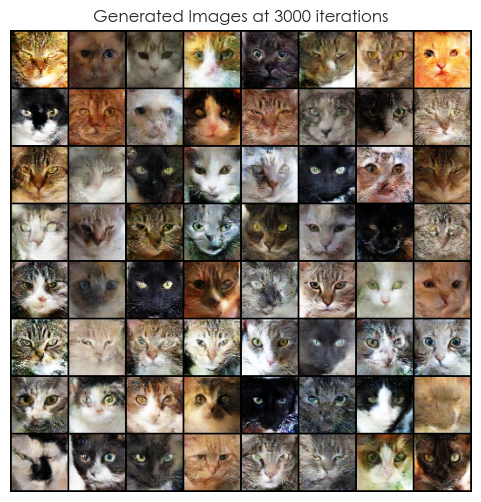

[93/200][25/32] 	Loss_D: -0.2078 | Loss_G: -0.3967 | Iteration Time: 1.6107 sec


Training Progress:  47%|████▋     | 94/200 [54:22<55:31, 31.43s/it]

[93/200][30/32] 	Loss_D: -0.2194 | Loss_G: -0.4584 | Iteration Time: 1.2197 sec
[94/200][0/32] 	Loss_D: -0.2598 | Loss_G: -0.3588 | Iteration Time: 1.0346 sec
[94/200][5/32] 	Loss_D: -0.2328 | Loss_G: -0.3685 | Iteration Time: 0.5796 sec
[94/200][10/32] 	Loss_D: -0.1936 | Loss_G: -0.2774 | Iteration Time: 0.8511 sec
[94/200][15/32] 	Loss_D: -0.2266 | Loss_G: -0.4394 | Iteration Time: 0.6346 sec
[94/200][20/32] 	Loss_D: -0.1908 | Loss_G: -0.3753 | Iteration Time: 0.9021 sec
[94/200][25/32] 	Loss_D: -0.2113 | Loss_G: -0.3082 | Iteration Time: 0.7196 sec


Training Progress:  48%|████▊     | 95/200 [54:49<52:52, 30.21s/it]

[94/200][30/32] 	Loss_D: -0.2010 | Loss_G: -0.3383 | Iteration Time: 1.1511 sec
[95/200][0/32] 	Loss_D: -0.1958 | Loss_G: -0.4010 | Iteration Time: 1.0211 sec
[95/200][5/32] 	Loss_D: -0.2037 | Loss_G: -0.2884 | Iteration Time: 0.5941 sec
[95/200][10/32] 	Loss_D: -0.2684 | Loss_G: -0.3783 | Iteration Time: 0.8541 sec
[95/200][15/32] 	Loss_D: -0.2177 | Loss_G: -0.2458 | Iteration Time: 0.6831 sec
[95/200][20/32] 	Loss_D: -0.2000 | Loss_G: -0.4422 | Iteration Time: 0.8961 sec
[95/200][25/32] 	Loss_D: -0.2056 | Loss_G: -0.3496 | Iteration Time: 0.7341 sec


Training Progress:  48%|████▊     | 96/200 [55:16<50:55, 29.38s/it]

[95/200][30/32] 	Loss_D: -0.2059 | Loss_G: -0.3147 | Iteration Time: 1.1506 sec
[96/200][0/32] 	Loss_D: -0.2172 | Loss_G: -0.4236 | Iteration Time: 1.0101 sec
[96/200][5/32] 	Loss_D: -0.1986 | Loss_G: -0.4483 | Iteration Time: 0.5746 sec
[96/200][10/32] 	Loss_D: -0.2331 | Loss_G: -0.3561 | Iteration Time: 0.8551 sec
[96/200][15/32] 	Loss_D: -0.2031 | Loss_G: -0.4115 | Iteration Time: 0.6216 sec
[96/200][20/32] 	Loss_D: -0.2227 | Loss_G: -0.3267 | Iteration Time: 0.8811 sec
[96/200][25/32] 	Loss_D: -0.2309 | Loss_G: -0.3381 | Iteration Time: 0.7171 sec


Training Progress:  48%|████▊     | 97/200 [55:44<49:23, 28.78s/it]

[96/200][30/32] 	Loss_D: -0.2184 | Loss_G: -0.2390 | Iteration Time: 1.1656 sec
[97/200][0/32] 	Loss_D: -0.2291 | Loss_G: -0.3673 | Iteration Time: 1.0157 sec
[97/200][5/32] 	Loss_D: -0.2077 | Loss_G: -0.2788 | Iteration Time: 0.5706 sec
[97/200][10/32] 	Loss_D: -0.2153 | Loss_G: -0.3887 | Iteration Time: 0.8571 sec
[97/200][15/32] 	Loss_D: -0.2218 | Loss_G: -0.3479 | Iteration Time: 0.6346 sec
[97/200][20/32] 	Loss_D: -0.2339 | Loss_G: -0.4846 | Iteration Time: 0.8876 sec
[97/200][25/32] 	Loss_D: -0.0856 | Loss_G: -0.4228 | Iteration Time: 0.7276 sec


Training Progress:  49%|████▉     | 98/200 [56:11<48:10, 28.34s/it]

[97/200][30/32] 	Loss_D: -0.2242 | Loss_G: -0.3441 | Iteration Time: 1.1516 sec
[98/200][0/32] 	Loss_D: -0.2233 | Loss_G: -0.3429 | Iteration Time: 1.0216 sec
[98/200][5/32] 	Loss_D: -0.2401 | Loss_G: -0.4096 | Iteration Time: 0.5896 sec
[98/200][10/32] 	Loss_D: -0.2322 | Loss_G: -0.3846 | Iteration Time: 0.8641 sec
[98/200][15/32] 	Loss_D: -0.2248 | Loss_G: -0.2895 | Iteration Time: 0.6301 sec
[98/200][20/32] 	Loss_D: -0.2224 | Loss_G: -0.2713 | Iteration Time: 0.9016 sec
[98/200][25/32] 	Loss_D: -0.1692 | Loss_G: -0.3688 | Iteration Time: 0.7271 sec


Training Progress:  50%|████▉     | 99/200 [56:38<47:13, 28.05s/it]

[98/200][30/32] 	Loss_D: -0.2051 | Loss_G: -0.2583 | Iteration Time: 1.1556 sec
[99/200][0/32] 	Loss_D: -0.2466 | Loss_G: -0.3929 | Iteration Time: 1.0161 sec
[99/200][5/32] 	Loss_D: -0.2237 | Loss_G: -0.4387 | Iteration Time: 0.5791 sec
[99/200][10/32] 	Loss_D: -0.1989 | Loss_G: -0.2990 | Iteration Time: 0.8591 sec
[99/200][15/32] 	Loss_D: -0.2259 | Loss_G: -0.3978 | Iteration Time: 0.6351 sec
[99/200][20/32] 	Loss_D: -0.2029 | Loss_G: -0.3223 | Iteration Time: 0.8846 sec
[99/200][25/32] 	Loss_D: -0.2062 | Loss_G: -0.2777 | Iteration Time: 0.7091 sec


Training Progress:  50%|█████     | 100/200 [57:06<46:24, 27.85s/it]

[99/200][30/32] 	Loss_D: -0.2073 | Loss_G: -0.3237 | Iteration Time: 1.1716 sec
[100/200][0/32] 	Loss_D: -0.2217 | Loss_G: -0.4547 | Iteration Time: 1.0126 sec
[100/200][5/32] 	Loss_D: -0.2379 | Loss_G: -0.3447 | Iteration Time: 0.5830 sec
[100/200][10/32] 	Loss_D: -0.2064 | Loss_G: -0.3892 | Iteration Time: 0.8651 sec
[100/200][15/32] 	Loss_D: -0.2306 | Loss_G: -0.3922 | Iteration Time: 0.6321 sec
[100/200][20/32] 	Loss_D: -0.2254 | Loss_G: -0.3678 | Iteration Time: 0.8921 sec
[100/200][25/32] 	Loss_D: -0.1596 | Loss_G: -0.3332 | Iteration Time: 0.7326 sec


Training Progress:  50%|█████     | 101/200 [57:33<45:44, 27.72s/it]

[100/200][30/32] 	Loss_D: -0.2242 | Loss_G: -0.4423 | Iteration Time: 1.1721 sec
[101/200][0/32] 	Loss_D: -0.1986 | Loss_G: -0.3631 | Iteration Time: 1.0071 sec
[101/200][5/32] 	Loss_D: -0.2396 | Loss_G: -0.3693 | Iteration Time: 0.5841 sec
[101/200][10/32] 	Loss_D: -0.2320 | Loss_G: -0.3735 | Iteration Time: 0.8501 sec
[101/200][15/32] 	Loss_D: -0.2205 | Loss_G: -0.4531 | Iteration Time: 0.6337 sec
[101/200][20/32] 	Loss_D: -0.2282 | Loss_G: -0.3929 | Iteration Time: 0.8841 sec
[101/200][25/32] 	Loss_D: -0.1886 | Loss_G: -0.3619 | Iteration Time: 0.7296 sec


Training Progress:  51%|█████     | 102/200 [58:01<45:04, 27.60s/it]

[101/200][30/32] 	Loss_D: -0.1643 | Loss_G: -0.1498 | Iteration Time: 1.1616 sec
[102/200][0/32] 	Loss_D: -0.2187 | Loss_G: -0.3680 | Iteration Time: 1.0191 sec
[102/200][5/32] 	Loss_D: -0.2088 | Loss_G: -0.3070 | Iteration Time: 0.5771 sec
[102/200][10/32] 	Loss_D: -0.1947 | Loss_G: -0.3853 | Iteration Time: 0.8371 sec
[102/200][15/32] 	Loss_D: -0.2419 | Loss_G: -0.3442 | Iteration Time: 0.7141 sec
[102/200][20/32] 	Loss_D: -0.2192 | Loss_G: -0.2890 | Iteration Time: 0.9546 sec
[102/200][25/32] 	Loss_D: -0.2327 | Loss_G: -0.3072 | Iteration Time: 0.7701 sec


Training Progress:  52%|█████▏    | 103/200 [58:30<45:16, 28.00s/it]

[102/200][30/32] 	Loss_D: -0.2021 | Loss_G: -0.4683 | Iteration Time: 1.2671 sec
[103/200][0/32] 	Loss_D: -0.2312 | Loss_G: -0.4098 | Iteration Time: 1.0781 sec
[103/200][5/32] 	Loss_D: -0.2405 | Loss_G: -0.3305 | Iteration Time: 0.6036 sec
[103/200][10/32] 	Loss_D: -0.2241 | Loss_G: -0.4391 | Iteration Time: 0.8911 sec
[103/200][15/32] 	Loss_D: -0.2292 | Loss_G: -0.4868 | Iteration Time: 0.6851 sec
[103/200][20/32] 	Loss_D: -0.2341 | Loss_G: -0.3644 | Iteration Time: 0.9461 sec
[103/200][25/32] 	Loss_D: -0.2345 | Loss_G: -0.5382 | Iteration Time: 0.7666 sec
[103/200][30/32] 	Loss_D: -0.1925 | Loss_G: -0.4433 | Iteration Time: 1.2391 sec


Training Progress:  52%|█████▏    | 104/200 [58:59<45:22, 28.36s/it]

[104/200][0/32] 	Loss_D: -0.2157 | Loss_G: -0.3568 | Iteration Time: 1.1042 sec
[104/200][5/32] 	Loss_D: -0.2330 | Loss_G: -0.3429 | Iteration Time: 0.6291 sec
[104/200][10/32] 	Loss_D: -0.2372 | Loss_G: -0.3441 | Iteration Time: 0.8876 sec
[104/200][15/32] 	Loss_D: -0.2376 | Loss_G: -0.3136 | Iteration Time: 0.6966 sec
[104/200][20/32] 	Loss_D: -0.1518 | Loss_G: -0.3157 | Iteration Time: 0.9382 sec
[104/200][25/32] 	Loss_D: -0.0642 | Loss_G: -0.2158 | Iteration Time: 0.7642 sec


Training Progress:  52%|█████▎    | 105/200 [59:28<45:14, 28.57s/it]

[104/200][30/32] 	Loss_D: -0.2279 | Loss_G: -0.3444 | Iteration Time: 1.2226 sec
[105/200][0/32] 	Loss_D: -0.2205 | Loss_G: -0.3558 | Iteration Time: 1.0921 sec
[105/200][5/32] 	Loss_D: -0.1994 | Loss_G: -0.6738 | Iteration Time: 0.6101 sec
[105/200][10/32] 	Loss_D: -0.1673 | Loss_G: -0.1593 | Iteration Time: 0.9106 sec
[105/200][15/32] 	Loss_D: -0.2160 | Loss_G: -0.4569 | Iteration Time: 0.6911 sec
[105/200][20/32] 	Loss_D: -0.1153 | Loss_G: -0.3446 | Iteration Time: 0.9566 sec
[105/200][25/32] 	Loss_D: -0.2072 | Loss_G: -0.3794 | Iteration Time: 0.7681 sec


Training Progress:  53%|█████▎    | 106/200 [59:57<45:03, 28.76s/it]

[105/200][30/32] 	Loss_D: -0.2350 | Loss_G: -0.3545 | Iteration Time: 1.2456 sec
[106/200][0/32] 	Loss_D: -0.2417 | Loss_G: -0.3772 | Iteration Time: 1.0586 sec
[106/200][5/32] 	Loss_D: -0.1978 | Loss_G: -0.2318 | Iteration Time: 0.6131 sec
[106/200][10/32] 	Loss_D: -0.2310 | Loss_G: -0.3594 | Iteration Time: 0.9181 sec
[106/200][15/32] 	Loss_D: -0.2385 | Loss_G: -0.3427 | Iteration Time: 0.7006 sec
[106/200][20/32] 	Loss_D: -0.1623 | Loss_G: -0.4401 | Iteration Time: 0.9536 sec
[106/200][25/32] 	Loss_D: -0.2261 | Loss_G: -0.2903 | Iteration Time: 0.7696 sec


Training Progress:  54%|█████▎    | 107/200 [1:00:26<44:44, 28.87s/it]

[106/200][30/32] 	Loss_D: -0.2340 | Loss_G: -0.2998 | Iteration Time: 1.2432 sec
[107/200][0/32] 	Loss_D: -0.2218 | Loss_G: -0.3845 | Iteration Time: 1.0751 sec
[107/200][5/32] 	Loss_D: -0.2369 | Loss_G: -0.3609 | Iteration Time: 0.6186 sec
[107/200][10/32] 	Loss_D: -0.2108 | Loss_G: -0.3463 | Iteration Time: 0.9071 sec
[107/200][15/32] 	Loss_D: -0.2078 | Loss_G: -0.3651 | Iteration Time: 0.6771 sec
[107/200][20/32] 	Loss_D: -0.2125 | Loss_G: -0.4383 | Iteration Time: 0.9491 sec
[107/200][25/32] 	Loss_D: -0.2358 | Loss_G: -0.2629 | Iteration Time: 0.7661 sec


Training Progress:  54%|█████▍    | 108/200 [1:00:55<44:26, 28.98s/it]

[107/200][30/32] 	Loss_D: -0.2144 | Loss_G: -0.2379 | Iteration Time: 1.2547 sec
[108/200][0/32] 	Loss_D: -0.1993 | Loss_G: -0.3635 | Iteration Time: 1.0916 sec
[108/200][5/32] 	Loss_D: -0.2418 | Loss_G: -0.3398 | Iteration Time: 0.6151 sec
[108/200][10/32] 	Loss_D: -0.2420 | Loss_G: -0.4008 | Iteration Time: 0.9026 sec
[108/200][15/32] 	Loss_D: -0.2280 | Loss_G: -0.4662 | Iteration Time: 0.6791 sec
[108/200][20/32] 	Loss_D: -0.2332 | Loss_G: -0.3898 | Iteration Time: 0.9611 sec
[108/200][25/32] 	Loss_D: -0.2413 | Loss_G: -0.3248 | Iteration Time: 0.7536 sec
[108/200][30/32] 	Loss_D: -0.2394 | Loss_G: -0.3934 | Iteration Time: 1.2346 sec


Training Progress:  55%|█████▍    | 109/200 [1:01:24<44:00, 29.02s/it]

[109/200][0/32] 	Loss_D: -0.2002 | Loss_G: -0.3177 | Iteration Time: 1.0926 sec
[109/200][5/32] 	Loss_D: -0.2375 | Loss_G: -0.3304 | Iteration Time: 0.6231 sec
[109/200][10/32] 	Loss_D: -0.2413 | Loss_G: -0.3966 | Iteration Time: 0.9111 sec
Current scores at iteration 3500 | FID: 74.44414520263672 | IS: 2.2794289588928223


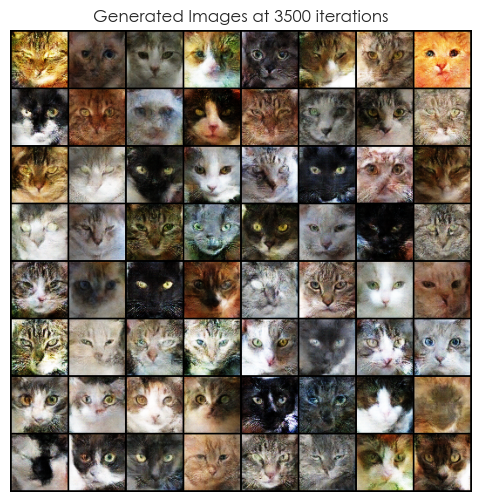

[109/200][15/32] 	Loss_D: -0.1855 | Loss_G: -0.2217 | Iteration Time: 1.1467 sec
[109/200][20/32] 	Loss_D: -0.0614 | Loss_G: -0.5847 | Iteration Time: 0.8201 sec
[109/200][25/32] 	Loss_D: -0.2385 | Loss_G: -0.3763 | Iteration Time: 1.0866 sec
[109/200][30/32] 	Loss_D: -0.2342 | Loss_G: -0.3776 | Iteration Time: 1.2251 sec


Training Progress:  55%|█████▌    | 110/200 [1:02:01<47:05, 31.40s/it]

[110/200][0/32] 	Loss_D: -0.2045 | Loss_G: -0.3834 | Iteration Time: 1.0211 sec
[110/200][5/32] 	Loss_D: -0.2341 | Loss_G: -0.4305 | Iteration Time: 1.1901 sec
[110/200][10/32] 	Loss_D: -0.2379 | Loss_G: -0.4176 | Iteration Time: 1.2676 sec
[110/200][15/32] 	Loss_D: -0.2364 | Loss_G: -0.2839 | Iteration Time: 0.8606 sec
[110/200][20/32] 	Loss_D: -0.2523 | Loss_G: -0.3626 | Iteration Time: 0.9516 sec
[110/200][25/32] 	Loss_D: -0.2326 | Loss_G: -0.3262 | Iteration Time: 0.9796 sec
[110/200][30/32] 	Loss_D: -0.2306 | Loss_G: -0.3879 | Iteration Time: 0.7961 sec


Training Progress:  56%|█████▌    | 111/200 [1:02:36<47:48, 32.23s/it]

[111/200][0/32] 	Loss_D: -0.2432 | Loss_G: -0.3606 | Iteration Time: 1.0776 sec
[111/200][5/32] 	Loss_D: -0.2032 | Loss_G: -0.6294 | Iteration Time: 0.7826 sec
[111/200][10/32] 	Loss_D: -0.2416 | Loss_G: -0.4062 | Iteration Time: 1.0606 sec
[111/200][15/32] 	Loss_D: -0.2382 | Loss_G: -0.3983 | Iteration Time: 0.9461 sec
[111/200][20/32] 	Loss_D: -0.2382 | Loss_G: -0.5962 | Iteration Time: 1.1122 sec
[111/200][25/32] 	Loss_D: -0.2270 | Loss_G: -0.2788 | Iteration Time: 1.2992 sec
[111/200][30/32] 	Loss_D: -0.2324 | Loss_G: -0.3446 | Iteration Time: 1.2561 sec


Training Progress:  56%|█████▌    | 112/200 [1:03:09<47:46, 32.57s/it]

[112/200][0/32] 	Loss_D: -0.2405 | Loss_G: -0.3614 | Iteration Time: 0.9466 sec
[112/200][5/32] 	Loss_D: -0.2217 | Loss_G: -0.2865 | Iteration Time: 1.2521 sec
[112/200][10/32] 	Loss_D: -0.2137 | Loss_G: -0.3584 | Iteration Time: 0.7776 sec
[112/200][15/32] 	Loss_D: -0.2685 | Loss_G: -0.3764 | Iteration Time: 1.2021 sec
[112/200][20/32] 	Loss_D: -0.2152 | Loss_G: -0.4149 | Iteration Time: 0.7756 sec
[112/200][25/32] 	Loss_D: -0.2502 | Loss_G: -0.3494 | Iteration Time: 1.3012 sec
[112/200][30/32] 	Loss_D: -0.1938 | Loss_G: -0.3358 | Iteration Time: 1.1071 sec


Training Progress:  56%|█████▋    | 113/200 [1:03:42<47:19, 32.63s/it]

[113/200][0/32] 	Loss_D: -0.2321 | Loss_G: -0.4370 | Iteration Time: 1.1052 sec
[113/200][5/32] 	Loss_D: -0.2490 | Loss_G: -0.3716 | Iteration Time: 0.7691 sec
[113/200][10/32] 	Loss_D: -0.2226 | Loss_G: -0.3499 | Iteration Time: 1.0836 sec
[113/200][15/32] 	Loss_D: -0.2100 | Loss_G: -0.2725 | Iteration Time: 0.9121 sec
[113/200][20/32] 	Loss_D: -0.2354 | Loss_G: -0.3066 | Iteration Time: 1.1246 sec
[113/200][25/32] 	Loss_D: -0.2310 | Loss_G: -0.3591 | Iteration Time: 1.2651 sec
[113/200][30/32] 	Loss_D: -0.2255 | Loss_G: -0.2974 | Iteration Time: 1.2571 sec


Training Progress:  57%|█████▋    | 114/200 [1:04:15<47:02, 32.82s/it]

[114/200][0/32] 	Loss_D: -0.2235 | Loss_G: -0.5789 | Iteration Time: 0.9521 sec
[114/200][5/32] 	Loss_D: -0.2162 | Loss_G: -0.2428 | Iteration Time: 1.2526 sec
[114/200][10/32] 	Loss_D: -0.2320 | Loss_G: -0.3016 | Iteration Time: 0.7671 sec
[114/200][15/32] 	Loss_D: -0.2525 | Loss_G: -0.3833 | Iteration Time: 1.2101 sec
[114/200][20/32] 	Loss_D: -0.2469 | Loss_G: -0.3718 | Iteration Time: 0.7541 sec
[114/200][25/32] 	Loss_D: -0.1928 | Loss_G: -0.3668 | Iteration Time: 1.3217 sec
[114/200][30/32] 	Loss_D: -0.2301 | Loss_G: -0.2696 | Iteration Time: 1.1416 sec


Training Progress:  57%|█████▊    | 115/200 [1:04:48<46:35, 32.88s/it]

[115/200][0/32] 	Loss_D: -0.2101 | Loss_G: -0.3793 | Iteration Time: 1.0652 sec
[115/200][5/32] 	Loss_D: -0.1937 | Loss_G: -0.3104 | Iteration Time: 0.7756 sec
[115/200][10/32] 	Loss_D: -0.2044 | Loss_G: -0.4021 | Iteration Time: 1.0666 sec
[115/200][15/32] 	Loss_D: -0.2194 | Loss_G: -0.3802 | Iteration Time: 0.8981 sec
[115/200][20/32] 	Loss_D: -0.2078 | Loss_G: -0.3792 | Iteration Time: 1.1016 sec
[115/200][25/32] 	Loss_D: -0.2502 | Loss_G: -0.3612 | Iteration Time: 1.2511 sec
[115/200][30/32] 	Loss_D: -0.2017 | Loss_G: -0.3593 | Iteration Time: 1.2587 sec


Training Progress:  58%|█████▊    | 116/200 [1:05:21<46:04, 32.91s/it]

[116/200][0/32] 	Loss_D: -0.1806 | Loss_G: -0.4537 | Iteration Time: 0.9652 sec
[116/200][5/32] 	Loss_D: -0.2546 | Loss_G: -0.3780 | Iteration Time: 1.2751 sec
[116/200][10/32] 	Loss_D: -0.2627 | Loss_G: -0.3212 | Iteration Time: 0.7746 sec
[116/200][15/32] 	Loss_D: -0.2225 | Loss_G: -0.4467 | Iteration Time: 1.2121 sec
[116/200][20/32] 	Loss_D: -0.2633 | Loss_G: -0.3252 | Iteration Time: 0.7626 sec
[116/200][25/32] 	Loss_D: -0.2227 | Loss_G: -0.3542 | Iteration Time: 1.3136 sec
[116/200][30/32] 	Loss_D: -0.2329 | Loss_G: -0.3901 | Iteration Time: 1.1176 sec


Training Progress:  58%|█████▊    | 117/200 [1:05:54<45:32, 32.93s/it]

[117/200][0/32] 	Loss_D: -0.2181 | Loss_G: -0.3529 | Iteration Time: 1.0401 sec
[117/200][5/32] 	Loss_D: -0.2316 | Loss_G: -0.3351 | Iteration Time: 0.7461 sec
[117/200][10/32] 	Loss_D: -0.2444 | Loss_G: -0.3901 | Iteration Time: 1.0836 sec
[117/200][15/32] 	Loss_D: -0.2488 | Loss_G: -0.3377 | Iteration Time: 0.8971 sec
[117/200][20/32] 	Loss_D: -0.2268 | Loss_G: -0.2846 | Iteration Time: 1.1116 sec
[117/200][25/32] 	Loss_D: -0.1854 | Loss_G: -0.3927 | Iteration Time: 1.2561 sec
[117/200][30/32] 	Loss_D: -0.2129 | Loss_G: -0.4161 | Iteration Time: 1.2552 sec


Training Progress:  59%|█████▉    | 118/200 [1:06:27<45:10, 33.05s/it]

[118/200][0/32] 	Loss_D: -0.2234 | Loss_G: -0.1972 | Iteration Time: 0.9526 sec
[118/200][5/32] 	Loss_D: -0.2099 | Loss_G: -0.5818 | Iteration Time: 1.2707 sec
[118/200][10/32] 	Loss_D: -0.2287 | Loss_G: -0.3905 | Iteration Time: 0.7736 sec
[118/200][15/32] 	Loss_D: -0.2475 | Loss_G: -0.2631 | Iteration Time: 1.2052 sec
[118/200][20/32] 	Loss_D: -0.1686 | Loss_G: -0.4935 | Iteration Time: 0.7741 sec
[118/200][25/32] 	Loss_D: -0.2529 | Loss_G: -0.3465 | Iteration Time: 1.3276 sec
[118/200][30/32] 	Loss_D: -0.2265 | Loss_G: -0.4465 | Iteration Time: 1.1261 sec


Training Progress:  60%|█████▉    | 119/200 [1:07:00<44:35, 33.03s/it]

[119/200][0/32] 	Loss_D: -0.2339 | Loss_G: -0.3715 | Iteration Time: 1.0826 sec
[119/200][5/32] 	Loss_D: -0.2387 | Loss_G: -0.3318 | Iteration Time: 0.7946 sec
[119/200][10/32] 	Loss_D: -0.2481 | Loss_G: -0.4062 | Iteration Time: 1.0741 sec
[119/200][15/32] 	Loss_D: -0.2494 | Loss_G: -0.3683 | Iteration Time: 0.9131 sec
[119/200][20/32] 	Loss_D: -0.2396 | Loss_G: -0.4680 | Iteration Time: 1.1231 sec
[119/200][25/32] 	Loss_D: -0.2132 | Loss_G: -0.3014 | Iteration Time: 1.2657 sec
[119/200][30/32] 	Loss_D: -0.2370 | Loss_G: -0.4015 | Iteration Time: 1.2546 sec


Training Progress:  60%|██████    | 120/200 [1:07:33<44:04, 33.06s/it]

[120/200][0/32] 	Loss_D: -0.1963 | Loss_G: -0.5959 | Iteration Time: 0.9606 sec
[120/200][5/32] 	Loss_D: -0.2228 | Loss_G: -0.3359 | Iteration Time: 1.2571 sec
[120/200][10/32] 	Loss_D: -0.2207 | Loss_G: -0.2168 | Iteration Time: 0.8046 sec
[120/200][15/32] 	Loss_D: -0.2460 | Loss_G: -0.3460 | Iteration Time: 1.2016 sec
[120/200][20/32] 	Loss_D: -0.2304 | Loss_G: -0.4728 | Iteration Time: 0.7791 sec
[120/200][25/32] 	Loss_D: -0.2029 | Loss_G: -0.2317 | Iteration Time: 1.3192 sec
[120/200][30/32] 	Loss_D: -0.1811 | Loss_G: -0.3646 | Iteration Time: 1.1146 sec


Training Progress:  60%|██████    | 121/200 [1:08:06<43:26, 33.00s/it]

[121/200][0/32] 	Loss_D: -0.2303 | Loss_G: -0.3633 | Iteration Time: 1.0771 sec
[121/200][5/32] 	Loss_D: -0.2309 | Loss_G: -0.5662 | Iteration Time: 0.7686 sec
[121/200][10/32] 	Loss_D: -0.2374 | Loss_G: -0.3945 | Iteration Time: 1.0536 sec
[121/200][15/32] 	Loss_D: -0.2523 | Loss_G: -0.3973 | Iteration Time: 0.8866 sec
[121/200][20/32] 	Loss_D: -0.2353 | Loss_G: -0.3738 | Iteration Time: 1.1296 sec
[121/200][25/32] 	Loss_D: -0.2511 | Loss_G: -0.4028 | Iteration Time: 1.2666 sec
[121/200][30/32] 	Loss_D: -0.1946 | Loss_G: -0.2999 | Iteration Time: 1.2513 sec


Training Progress:  61%|██████    | 122/200 [1:08:39<42:54, 33.01s/it]

[122/200][0/32] 	Loss_D: -0.2673 | Loss_G: -0.3671 | Iteration Time: 0.9351 sec
[122/200][5/32] 	Loss_D: -0.2686 | Loss_G: -0.3228 | Iteration Time: 1.2771 sec
[122/200][10/32] 	Loss_D: -0.2477 | Loss_G: -0.3912 | Iteration Time: 0.7546 sec
[122/200][15/32] 	Loss_D: -0.2261 | Loss_G: -0.3643 | Iteration Time: 1.2012 sec
[122/200][20/32] 	Loss_D: -0.2005 | Loss_G: -0.2420 | Iteration Time: 0.7551 sec
[122/200][25/32] 	Loss_D: -0.2441 | Loss_G: -0.3544 | Iteration Time: 1.3301 sec
[122/200][30/32] 	Loss_D: -0.2498 | Loss_G: -0.3801 | Iteration Time: 1.1236 sec


Training Progress:  62%|██████▏   | 123/200 [1:09:12<42:12, 32.89s/it]

[123/200][0/32] 	Loss_D: -0.2247 | Loss_G: -0.3543 | Iteration Time: 1.0751 sec
[123/200][5/32] 	Loss_D: -0.2319 | Loss_G: -0.3224 | Iteration Time: 0.7736 sec
[123/200][10/32] 	Loss_D: -0.2458 | Loss_G: -0.3220 | Iteration Time: 1.0826 sec
[123/200][15/32] 	Loss_D: -0.2369 | Loss_G: -0.2495 | Iteration Time: 0.8952 sec
[123/200][20/32] 	Loss_D: -0.2307 | Loss_G: -0.3789 | Iteration Time: 1.1387 sec
[123/200][25/32] 	Loss_D: -0.2055 | Loss_G: -0.4294 | Iteration Time: 1.2662 sec
[123/200][30/32] 	Loss_D: -0.1178 | Loss_G: -0.2975 | Iteration Time: 1.2617 sec


Training Progress:  62%|██████▏   | 124/200 [1:09:45<41:48, 33.00s/it]

[124/200][0/32] 	Loss_D: -0.2472 | Loss_G: -0.2946 | Iteration Time: 0.9261 sec
[124/200][5/32] 	Loss_D: -0.1981 | Loss_G: -0.2726 | Iteration Time: 1.2611 sec
[124/200][10/32] 	Loss_D: -0.2382 | Loss_G: -0.3434 | Iteration Time: 0.7736 sec
[124/200][15/32] 	Loss_D: -0.1929 | Loss_G: -0.4405 | Iteration Time: 1.2106 sec
[124/200][20/32] 	Loss_D: -0.2230 | Loss_G: -0.3578 | Iteration Time: 0.8001 sec
[124/200][25/32] 	Loss_D: -0.1951 | Loss_G: -0.2167 | Iteration Time: 1.3192 sec
[124/200][30/32] 	Loss_D: -0.2524 | Loss_G: -0.2938 | Iteration Time: 1.1261 sec


Training Progress:  62%|██████▎   | 125/200 [1:10:18<41:12, 32.97s/it]

[125/200][0/32] 	Loss_D: -0.2309 | Loss_G: -0.3363 | Iteration Time: 1.0976 sec
Current scores at iteration 4000 | FID: 80.17213439941406 | IS: 2.289193630218506


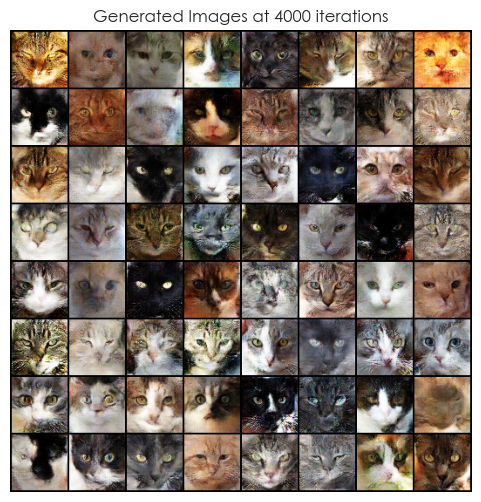

[125/200][5/32] 	Loss_D: -0.2334 | Loss_G: -0.2217 | Iteration Time: 1.2126 sec
[125/200][10/32] 	Loss_D: -0.2495 | Loss_G: -0.3592 | Iteration Time: 1.4262 sec
[125/200][15/32] 	Loss_D: -0.2595 | Loss_G: -0.3877 | Iteration Time: 1.1671 sec
[125/200][20/32] 	Loss_D: -0.2419 | Loss_G: -0.3736 | Iteration Time: 1.5497 sec
[125/200][25/32] 	Loss_D: -0.2436 | Loss_G: -0.3750 | Iteration Time: 1.2171 sec


Training Progress:  63%|██████▎   | 126/200 [1:11:08<46:48, 37.95s/it]

[125/200][30/32] 	Loss_D: -0.1341 | Loss_G: -0.2067 | Iteration Time: 1.4741 sec
[126/200][0/32] 	Loss_D: -0.2281 | Loss_G: -0.3701 | Iteration Time: 1.1521 sec
[126/200][5/32] 	Loss_D: -0.2333 | Loss_G: -0.3170 | Iteration Time: 1.4907 sec
[126/200][10/32] 	Loss_D: -0.2606 | Loss_G: -0.2559 | Iteration Time: 1.4387 sec
[126/200][15/32] 	Loss_D: -0.2514 | Loss_G: -0.4038 | Iteration Time: 1.1502 sec
[126/200][20/32] 	Loss_D: -0.2285 | Loss_G: -0.3899 | Iteration Time: 1.4367 sec
[126/200][25/32] 	Loss_D: -0.2540 | Loss_G: -0.3303 | Iteration Time: 1.2256 sec


Training Progress:  64%|██████▎   | 127/200 [1:11:50<47:52, 39.34s/it]

[126/200][30/32] 	Loss_D: -0.2279 | Loss_G: -0.3350 | Iteration Time: 1.3907 sec
[127/200][0/32] 	Loss_D: -0.2435 | Loss_G: -0.3409 | Iteration Time: 1.1506 sec
[127/200][5/32] 	Loss_D: -0.2438 | Loss_G: -0.4623 | Iteration Time: 1.4242 sec
[127/200][10/32] 	Loss_D: -0.2599 | Loss_G: -0.3332 | Iteration Time: 1.3417 sec
[127/200][15/32] 	Loss_D: -0.1913 | Loss_G: -0.3141 | Iteration Time: 1.1331 sec
[127/200][20/32] 	Loss_D: -0.2611 | Loss_G: -0.3085 | Iteration Time: 1.3997 sec
[127/200][25/32] 	Loss_D: -0.2468 | Loss_G: -0.3787 | Iteration Time: 1.0646 sec


Training Progress:  64%|██████▍   | 128/200 [1:12:31<47:40, 39.73s/it]

[127/200][30/32] 	Loss_D: -0.2497 | Loss_G: -0.3459 | Iteration Time: 1.3777 sec
[128/200][0/32] 	Loss_D: -0.1859 | Loss_G: -0.4599 | Iteration Time: 1.1006 sec
[128/200][5/32] 	Loss_D: -0.2824 | Loss_G: -0.3453 | Iteration Time: 1.4394 sec
[128/200][10/32] 	Loss_D: -0.2186 | Loss_G: -0.3033 | Iteration Time: 1.3782 sec
[128/200][15/32] 	Loss_D: -0.2351 | Loss_G: -0.3754 | Iteration Time: 1.1732 sec
[128/200][20/32] 	Loss_D: -0.1708 | Loss_G: -0.4040 | Iteration Time: 1.4307 sec
[128/200][25/32] 	Loss_D: -0.2133 | Loss_G: -0.2326 | Iteration Time: 1.1561 sec


Training Progress:  64%|██████▍   | 129/200 [1:13:12<47:41, 40.30s/it]

[128/200][30/32] 	Loss_D: -0.2588 | Loss_G: -0.3602 | Iteration Time: 1.3732 sec
[129/200][0/32] 	Loss_D: -0.1865 | Loss_G: -0.3979 | Iteration Time: 1.1061 sec
[129/200][5/32] 	Loss_D: -0.2384 | Loss_G: -0.3647 | Iteration Time: 1.4487 sec
[129/200][10/32] 	Loss_D: -0.2604 | Loss_G: -0.3639 | Iteration Time: 1.4136 sec
[129/200][15/32] 	Loss_D: -0.2270 | Loss_G: -0.4836 | Iteration Time: 1.0982 sec
[129/200][20/32] 	Loss_D: -0.2433 | Loss_G: -0.2422 | Iteration Time: 1.4067 sec
[129/200][25/32] 	Loss_D: -0.2088 | Loss_G: -0.2171 | Iteration Time: 1.0821 sec


Training Progress:  65%|██████▌   | 130/200 [1:13:53<47:13, 40.47s/it]

[129/200][30/32] 	Loss_D: -0.1188 | Loss_G: -0.6977 | Iteration Time: 1.3811 sec
[130/200][0/32] 	Loss_D: -0.2464 | Loss_G: -0.3485 | Iteration Time: 1.0711 sec
[130/200][5/32] 	Loss_D: -0.2438 | Loss_G: -0.3864 | Iteration Time: 1.4592 sec
[130/200][10/32] 	Loss_D: -0.2787 | Loss_G: -0.4311 | Iteration Time: 1.3446 sec
[130/200][15/32] 	Loss_D: -0.2383 | Loss_G: -0.3490 | Iteration Time: 1.0791 sec
[130/200][20/32] 	Loss_D: -0.1842 | Loss_G: -0.6480 | Iteration Time: 1.3346 sec
[130/200][25/32] 	Loss_D: -0.2143 | Loss_G: -0.3571 | Iteration Time: 1.1622 sec


Training Progress:  66%|██████▌   | 131/200 [1:14:34<46:30, 40.45s/it]

[130/200][30/32] 	Loss_D: -0.2274 | Loss_G: -0.2844 | Iteration Time: 1.3342 sec
[131/200][0/32] 	Loss_D: -0.2247 | Loss_G: -0.4460 | Iteration Time: 1.1321 sec
[131/200][5/32] 	Loss_D: -0.2505 | Loss_G: -0.4810 | Iteration Time: 1.4101 sec
[131/200][10/32] 	Loss_D: -0.2568 | Loss_G: -0.3706 | Iteration Time: 1.3086 sec
[131/200][15/32] 	Loss_D: -0.2683 | Loss_G: -0.3992 | Iteration Time: 1.0576 sec
[131/200][20/32] 	Loss_D: -0.2415 | Loss_G: -0.4140 | Iteration Time: 1.3727 sec
[131/200][25/32] 	Loss_D: -0.2613 | Loss_G: -0.3685 | Iteration Time: 1.0601 sec


Training Progress:  66%|██████▌   | 132/200 [1:15:13<45:31, 40.17s/it]

[131/200][30/32] 	Loss_D: -0.2592 | Loss_G: -0.3110 | Iteration Time: 1.2911 sec
[132/200][0/32] 	Loss_D: -0.2590 | Loss_G: -0.4036 | Iteration Time: 1.0361 sec
[132/200][5/32] 	Loss_D: -0.2531 | Loss_G: -0.4566 | Iteration Time: 1.5628 sec
[132/200][10/32] 	Loss_D: -0.2686 | Loss_G: -0.3740 | Iteration Time: 1.3667 sec
[132/200][15/32] 	Loss_D: -0.2299 | Loss_G: -0.6123 | Iteration Time: 1.0656 sec
[132/200][20/32] 	Loss_D: -0.2488 | Loss_G: -0.2836 | Iteration Time: 1.3151 sec
[132/200][25/32] 	Loss_D: 0.0516 | Loss_G: -0.2989 | Iteration Time: 1.0537 sec


Training Progress:  66%|██████▋   | 133/200 [1:15:53<44:44, 40.07s/it]

[132/200][30/32] 	Loss_D: -0.2409 | Loss_G: -0.4026 | Iteration Time: 1.3131 sec
[133/200][0/32] 	Loss_D: -0.2459 | Loss_G: -0.3488 | Iteration Time: 1.0216 sec
[133/200][5/32] 	Loss_D: -0.2682 | Loss_G: -0.3162 | Iteration Time: 1.4602 sec
[133/200][10/32] 	Loss_D: -0.2291 | Loss_G: -0.2265 | Iteration Time: 1.4632 sec
[133/200][15/32] 	Loss_D: -0.2563 | Loss_G: -0.3581 | Iteration Time: 1.0796 sec
[133/200][20/32] 	Loss_D: -0.2346 | Loss_G: -0.3907 | Iteration Time: 1.3957 sec
[133/200][25/32] 	Loss_D: -0.2243 | Loss_G: -0.3685 | Iteration Time: 1.0646 sec


Training Progress:  67%|██████▋   | 134/200 [1:16:35<44:31, 40.48s/it]

[133/200][30/32] 	Loss_D: -0.2466 | Loss_G: -0.3670 | Iteration Time: 1.2986 sec
[134/200][0/32] 	Loss_D: -0.2279 | Loss_G: -0.3728 | Iteration Time: 1.1196 sec
[134/200][5/32] 	Loss_D: -0.2557 | Loss_G: -0.1971 | Iteration Time: 1.4607 sec
[134/200][10/32] 	Loss_D: -0.2390 | Loss_G: -0.4700 | Iteration Time: 1.4097 sec
[134/200][15/32] 	Loss_D: -0.2252 | Loss_G: -0.3440 | Iteration Time: 1.0716 sec
[134/200][20/32] 	Loss_D: -0.2530 | Loss_G: -0.3656 | Iteration Time: 1.3267 sec
[134/200][25/32] 	Loss_D: -0.2290 | Loss_G: -0.2761 | Iteration Time: 1.0621 sec


Training Progress:  68%|██████▊   | 135/200 [1:17:15<43:48, 40.43s/it]

[134/200][30/32] 	Loss_D: -0.2460 | Loss_G: -0.3617 | Iteration Time: 1.2901 sec
[135/200][0/32] 	Loss_D: -0.2603 | Loss_G: -0.4133 | Iteration Time: 1.0231 sec
[135/200][5/32] 	Loss_D: -0.2583 | Loss_G: -0.3988 | Iteration Time: 1.6792 sec
[135/200][10/32] 	Loss_D: -0.2805 | Loss_G: -0.3895 | Iteration Time: 1.2211 sec
[135/200][15/32] 	Loss_D: -0.2333 | Loss_G: -0.3865 | Iteration Time: 1.0741 sec
[135/200][20/32] 	Loss_D: -0.1595 | Loss_G: -0.3239 | Iteration Time: 1.2377 sec
[135/200][25/32] 	Loss_D: -0.2131 | Loss_G: -0.4758 | Iteration Time: 1.0011 sec


Training Progress:  68%|██████▊   | 136/200 [1:17:55<43:09, 40.46s/it]

[135/200][30/32] 	Loss_D: -0.2587 | Loss_G: -0.3901 | Iteration Time: 1.2318 sec
[136/200][0/32] 	Loss_D: -0.2621 | Loss_G: -0.3229 | Iteration Time: 1.0317 sec
[136/200][5/32] 	Loss_D: -0.2624 | Loss_G: -0.3537 | Iteration Time: 1.4187 sec
[136/200][10/32] 	Loss_D: -0.2644 | Loss_G: -0.2892 | Iteration Time: 1.2567 sec
[136/200][15/32] 	Loss_D: -0.2642 | Loss_G: -0.4374 | Iteration Time: 1.0042 sec
[136/200][20/32] 	Loss_D: -0.1395 | Loss_G: -0.2072 | Iteration Time: 1.2334 sec
[136/200][25/32] 	Loss_D: -0.2371 | Loss_G: -0.3507 | Iteration Time: 1.0089 sec


Training Progress:  68%|██████▊   | 137/200 [1:18:35<42:03, 40.05s/it]

[136/200][30/32] 	Loss_D: -0.2540 | Loss_G: -0.3206 | Iteration Time: 1.2537 sec
[137/200][0/32] 	Loss_D: -0.2273 | Loss_G: -0.2561 | Iteration Time: 0.9908 sec
[137/200][5/32] 	Loss_D: -0.2579 | Loss_G: -0.3136 | Iteration Time: 1.3424 sec
[137/200][10/32] 	Loss_D: -0.2077 | Loss_G: -0.3085 | Iteration Time: 1.2349 sec
[137/200][15/32] 	Loss_D: -0.2543 | Loss_G: -0.3717 | Iteration Time: 1.0188 sec
[137/200][20/32] 	Loss_D: -0.2519 | Loss_G: -0.3589 | Iteration Time: 1.2469 sec
[137/200][25/32] 	Loss_D: -0.1694 | Loss_G: -0.1965 | Iteration Time: 1.0160 sec


Training Progress:  69%|██████▉   | 138/200 [1:19:13<40:58, 39.66s/it]

[137/200][30/32] 	Loss_D: -0.2283 | Loss_G: -0.4726 | Iteration Time: 1.3945 sec
[138/200][0/32] 	Loss_D: -0.2604 | Loss_G: -0.3203 | Iteration Time: 1.1323 sec
[138/200][5/32] 	Loss_D: -0.2786 | Loss_G: -0.3606 | Iteration Time: 1.3172 sec
[138/200][10/32] 	Loss_D: -0.2772 | Loss_G: -0.3883 | Iteration Time: 1.2405 sec
[138/200][15/32] 	Loss_D: -0.2563 | Loss_G: -0.3985 | Iteration Time: 1.0082 sec
[138/200][20/32] 	Loss_D: -0.2630 | Loss_G: -0.3443 | Iteration Time: 1.2543 sec
[138/200][25/32] 	Loss_D: -0.2568 | Loss_G: -0.3795 | Iteration Time: 1.0309 sec


Training Progress:  70%|██████▉   | 139/200 [1:19:52<40:06, 39.45s/it]

[138/200][30/32] 	Loss_D: -0.2694 | Loss_G: -0.3333 | Iteration Time: 1.2425 sec
[139/200][0/32] 	Loss_D: -0.2750 | Loss_G: -0.3655 | Iteration Time: 1.0003 sec
[139/200][5/32] 	Loss_D: -0.2463 | Loss_G: -0.3044 | Iteration Time: 1.3628 sec
[139/200][10/32] 	Loss_D: -0.2614 | Loss_G: -0.3204 | Iteration Time: 1.4403 sec
[139/200][15/32] 	Loss_D: -0.2457 | Loss_G: -0.3616 | Iteration Time: 1.0156 sec
[139/200][20/32] 	Loss_D: -0.1043 | Loss_G: -0.6791 | Iteration Time: 1.3408 sec
[139/200][25/32] 	Loss_D: -0.2728 | Loss_G: -0.4252 | Iteration Time: 1.0672 sec


Training Progress:  70%|███████   | 140/200 [1:20:32<39:28, 39.47s/it]

[139/200][30/32] 	Loss_D: -0.2264 | Loss_G: -0.4066 | Iteration Time: 1.2668 sec
[140/200][0/32] 	Loss_D: -0.2457 | Loss_G: -0.3808 | Iteration Time: 1.0272 sec
[140/200][5/32] 	Loss_D: -0.2238 | Loss_G: -0.3123 | Iteration Time: 1.3442 sec
[140/200][10/32] 	Loss_D: -0.2554 | Loss_G: -0.3820 | Iteration Time: 1.2552 sec
[140/200][15/32] 	Loss_D: -0.2609 | Loss_G: -0.3109 | Iteration Time: 1.0440 sec
[140/200][20/32] 	Loss_D: -0.2449 | Loss_G: -0.5948 | Iteration Time: 1.2706 sec
Current scores at iteration 4500 | FID: 80.69862365722656 | IS: 2.372429847717285


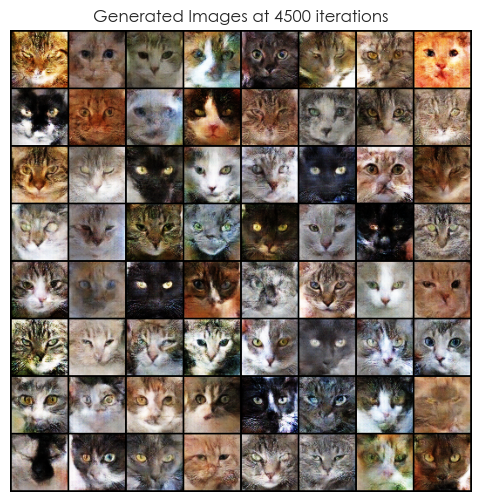

[140/200][25/32] 	Loss_D: -0.2622 | Loss_G: -0.3551 | Iteration Time: 1.1863 sec


Training Progress:  70%|███████   | 141/200 [1:21:28<43:54, 44.65s/it]

[140/200][30/32] 	Loss_D: -0.2297 | Loss_G: -0.5959 | Iteration Time: 1.4428 sec
[141/200][0/32] 	Loss_D: -0.2696 | Loss_G: -0.3322 | Iteration Time: 1.0832 sec
[141/200][5/32] 	Loss_D: -0.2099 | Loss_G: -0.3207 | Iteration Time: 1.3827 sec
[141/200][10/32] 	Loss_D: -0.2434 | Loss_G: -0.4123 | Iteration Time: 1.5822 sec
[141/200][15/32] 	Loss_D: -0.2162 | Loss_G: -0.4425 | Iteration Time: 1.3342 sec
[141/200][20/32] 	Loss_D: -0.2630 | Loss_G: -0.3742 | Iteration Time: 1.4037 sec
[141/200][25/32] 	Loss_D: -0.2526 | Loss_G: -0.3856 | Iteration Time: 1.1557 sec


Training Progress:  71%|███████   | 142/200 [1:22:11<42:39, 44.14s/it]

[141/200][30/32] 	Loss_D: -0.2635 | Loss_G: -0.4529 | Iteration Time: 1.6402 sec
[142/200][0/32] 	Loss_D: -0.2131 | Loss_G: -0.4464 | Iteration Time: 1.2162 sec
[142/200][5/32] 	Loss_D: -0.2506 | Loss_G: -0.4609 | Iteration Time: 1.1157 sec
[142/200][10/32] 	Loss_D: -0.2351 | Loss_G: -0.3309 | Iteration Time: 1.8208 sec
[142/200][15/32] 	Loss_D: -0.2462 | Loss_G: -0.2191 | Iteration Time: 1.8588 sec
[142/200][20/32] 	Loss_D: -0.2579 | Loss_G: -0.2624 | Iteration Time: 1.0047 sec
[142/200][25/32] 	Loss_D: -0.2633 | Loss_G: -0.4149 | Iteration Time: 1.2177 sec


Training Progress:  72%|███████▏  | 143/200 [1:22:56<42:10, 44.39s/it]

[142/200][30/32] 	Loss_D: -0.2431 | Loss_G: -0.3017 | Iteration Time: 1.6408 sec
[143/200][0/32] 	Loss_D: -0.2496 | Loss_G: -0.3664 | Iteration Time: 1.2452 sec
[143/200][5/32] 	Loss_D: -0.2622 | Loss_G: -0.3656 | Iteration Time: 1.2762 sec
[143/200][10/32] 	Loss_D: -0.2376 | Loss_G: -0.3678 | Iteration Time: 1.2297 sec
[143/200][15/32] 	Loss_D: -0.2679 | Loss_G: -0.3566 | Iteration Time: 1.1532 sec
[143/200][20/32] 	Loss_D: -0.2716 | Loss_G: -0.3868 | Iteration Time: 1.2991 sec
[143/200][25/32] 	Loss_D: -0.2672 | Loss_G: -0.2301 | Iteration Time: 1.8185 sec


Training Progress:  72%|███████▏  | 144/200 [1:23:41<41:32, 44.51s/it]

[143/200][30/32] 	Loss_D: -0.2489 | Loss_G: -0.3813 | Iteration Time: 1.7381 sec
[144/200][0/32] 	Loss_D: -0.2385 | Loss_G: -0.3885 | Iteration Time: 1.3295 sec
[144/200][5/32] 	Loss_D: -0.2582 | Loss_G: -0.2974 | Iteration Time: 1.2229 sec
[144/200][10/32] 	Loss_D: -0.2523 | Loss_G: -0.2551 | Iteration Time: 1.1287 sec
[144/200][15/32] 	Loss_D: -0.2218 | Loss_G: -0.4391 | Iteration Time: 1.6033 sec
[144/200][20/32] 	Loss_D: -0.2463 | Loss_G: -0.4734 | Iteration Time: 1.1083 sec
[144/200][25/32] 	Loss_D: -0.2537 | Loss_G: -0.5012 | Iteration Time: 1.2359 sec


Training Progress:  72%|███████▎  | 145/200 [1:24:27<41:05, 44.83s/it]

[144/200][30/32] 	Loss_D: -0.2408 | Loss_G: -0.3099 | Iteration Time: 1.7730 sec
[145/200][0/32] 	Loss_D: -0.2092 | Loss_G: -0.3849 | Iteration Time: 1.2864 sec
[145/200][5/32] 	Loss_D: -0.2366 | Loss_G: -0.5013 | Iteration Time: 1.4133 sec
[145/200][10/32] 	Loss_D: -0.2535 | Loss_G: -0.2283 | Iteration Time: 1.2569 sec
[145/200][15/32] 	Loss_D: -0.2625 | Loss_G: -0.2754 | Iteration Time: 1.3813 sec
[145/200][20/32] 	Loss_D: -0.2633 | Loss_G: -0.3014 | Iteration Time: 1.3873 sec
[145/200][25/32] 	Loss_D: -0.2523 | Loss_G: -0.3689 | Iteration Time: 1.7758 sec


Training Progress:  73%|███████▎  | 146/200 [1:25:13<40:47, 45.32s/it]

[145/200][30/32] 	Loss_D: -0.2503 | Loss_G: -0.3228 | Iteration Time: 1.8694 sec
[146/200][0/32] 	Loss_D: -0.2429 | Loss_G: -0.3497 | Iteration Time: 1.3413 sec
[146/200][5/32] 	Loss_D: -0.2434 | Loss_G: -0.3627 | Iteration Time: 1.2117 sec
[146/200][10/32] 	Loss_D: -0.2557 | Loss_G: -0.4114 | Iteration Time: 1.1972 sec
[146/200][15/32] 	Loss_D: -0.2674 | Loss_G: -0.4369 | Iteration Time: 1.5127 sec
[146/200][20/32] 	Loss_D: -0.2013 | Loss_G: -0.5358 | Iteration Time: 1.0902 sec
[146/200][25/32] 	Loss_D: -0.1989 | Loss_G: -0.5985 | Iteration Time: 1.2287 sec


Training Progress:  74%|███████▎  | 147/200 [1:25:59<40:04, 45.37s/it]

[146/200][30/32] 	Loss_D: -0.2425 | Loss_G: -0.3825 | Iteration Time: 1.7828 sec
[147/200][0/32] 	Loss_D: -0.2560 | Loss_G: -0.3531 | Iteration Time: 1.3687 sec
[147/200][5/32] 	Loss_D: -0.2634 | Loss_G: -0.3457 | Iteration Time: 1.2702 sec
[147/200][10/32] 	Loss_D: -0.2600 | Loss_G: -0.3022 | Iteration Time: 1.1883 sec
[147/200][15/32] 	Loss_D: -0.2609 | Loss_G: -0.3781 | Iteration Time: 1.1663 sec
[147/200][20/32] 	Loss_D: -0.2368 | Loss_G: -0.4125 | Iteration Time: 1.4273 sec
[147/200][25/32] 	Loss_D: -0.2521 | Loss_G: -0.4372 | Iteration Time: 1.6638 sec


Training Progress:  74%|███████▍  | 148/200 [1:26:43<38:56, 44.93s/it]

[147/200][30/32] 	Loss_D: -0.2597 | Loss_G: -0.2918 | Iteration Time: 1.7378 sec
[148/200][0/32] 	Loss_D: -0.2260 | Loss_G: -0.2818 | Iteration Time: 1.2797 sec
[148/200][5/32] 	Loss_D: -0.2395 | Loss_G: -0.3679 | Iteration Time: 1.2127 sec
[148/200][10/32] 	Loss_D: -0.2485 | Loss_G: -0.3777 | Iteration Time: 1.0882 sec
[148/200][15/32] 	Loss_D: -0.2791 | Loss_G: -0.2969 | Iteration Time: 1.5633 sec
[148/200][20/32] 	Loss_D: -0.2537 | Loss_G: -0.2152 | Iteration Time: 1.0887 sec
[148/200][25/32] 	Loss_D: -0.1942 | Loss_G: -0.1787 | Iteration Time: 1.2392 sec


Training Progress:  74%|███████▍  | 149/200 [1:27:27<37:56, 44.64s/it]

[148/200][30/32] 	Loss_D: -0.2692 | Loss_G: -0.2935 | Iteration Time: 1.6849 sec
[149/200][0/32] 	Loss_D: -0.2609 | Loss_G: -0.4512 | Iteration Time: 1.2625 sec
[149/200][5/32] 	Loss_D: -0.2759 | Loss_G: -0.3592 | Iteration Time: 1.2627 sec
[149/200][10/32] 	Loss_D: -0.2762 | Loss_G: -0.3359 | Iteration Time: 1.1758 sec
[149/200][15/32] 	Loss_D: -0.2687 | Loss_G: -0.4044 | Iteration Time: 1.2047 sec
[149/200][20/32] 	Loss_D: -0.2789 | Loss_G: -0.2917 | Iteration Time: 1.2997 sec
[149/200][25/32] 	Loss_D: -0.2526 | Loss_G: -0.3774 | Iteration Time: 1.6988 sec


Training Progress:  75%|███████▌  | 150/200 [1:28:10<36:53, 44.26s/it]

[149/200][30/32] 	Loss_D: -0.1776 | Loss_G: -0.2351 | Iteration Time: 1.7648 sec
[150/200][0/32] 	Loss_D: -0.2422 | Loss_G: -0.3929 | Iteration Time: 1.2707 sec
[150/200][5/32] 	Loss_D: -0.2948 | Loss_G: -0.2493 | Iteration Time: 1.4338 sec
[150/200][10/32] 	Loss_D: -0.2676 | Loss_G: -0.4775 | Iteration Time: 1.0782 sec
[150/200][15/32] 	Loss_D: -0.2624 | Loss_G: -0.3940 | Iteration Time: 1.4922 sec
[150/200][20/32] 	Loss_D: -0.1881 | Loss_G: -0.6947 | Iteration Time: 1.0947 sec
[150/200][25/32] 	Loss_D: -0.1543 | Loss_G: -0.2986 | Iteration Time: 1.2297 sec


Training Progress:  76%|███████▌  | 151/200 [1:28:54<35:58, 44.05s/it]

[150/200][30/32] 	Loss_D: -0.2583 | Loss_G: -0.2775 | Iteration Time: 1.6904 sec
[151/200][0/32] 	Loss_D: -0.2386 | Loss_G: -0.3820 | Iteration Time: 1.3172 sec
[151/200][5/32] 	Loss_D: -0.1965 | Loss_G: -0.3049 | Iteration Time: 1.2858 sec
[151/200][10/32] 	Loss_D: -0.2665 | Loss_G: -0.3740 | Iteration Time: 1.1632 sec
[151/200][15/32] 	Loss_D: -0.2684 | Loss_G: -0.3060 | Iteration Time: 1.1472 sec
[151/200][20/32] 	Loss_D: -0.2400 | Loss_G: -0.3761 | Iteration Time: 1.2712 sec
[151/200][25/32] 	Loss_D: -0.2827 | Loss_G: -0.3078 | Iteration Time: 1.6758 sec


Training Progress:  76%|███████▌  | 152/200 [1:29:36<34:52, 43.60s/it]

[151/200][30/32] 	Loss_D: -0.2634 | Loss_G: -0.2602 | Iteration Time: 1.7302 sec
[152/200][0/32] 	Loss_D: -0.2470 | Loss_G: -0.3361 | Iteration Time: 1.2777 sec
[152/200][5/32] 	Loss_D: -0.2666 | Loss_G: -0.3320 | Iteration Time: 1.1862 sec
[152/200][10/32] 	Loss_D: -0.2493 | Loss_G: -0.4721 | Iteration Time: 1.2532 sec
[152/200][15/32] 	Loss_D: -0.2512 | Loss_G: -0.2245 | Iteration Time: 1.5708 sec
[152/200][20/32] 	Loss_D: -0.2202 | Loss_G: -0.5279 | Iteration Time: 1.2233 sec
[152/200][25/32] 	Loss_D: -0.1897 | Loss_G: -0.3379 | Iteration Time: 1.2733 sec


Training Progress:  76%|███████▋  | 153/200 [1:30:22<34:39, 44.24s/it]

[152/200][30/32] 	Loss_D: -0.2557 | Loss_G: -0.3555 | Iteration Time: 1.6884 sec
[153/200][0/32] 	Loss_D: -0.2831 | Loss_G: -0.3721 | Iteration Time: 1.2965 sec
[153/200][5/32] 	Loss_D: -0.2338 | Loss_G: -0.4380 | Iteration Time: 1.5374 sec
[153/200][10/32] 	Loss_D: -0.2792 | Loss_G: -0.3915 | Iteration Time: 1.1917 sec
[153/200][15/32] 	Loss_D: -0.2340 | Loss_G: -0.3302 | Iteration Time: 1.1737 sec
[153/200][20/32] 	Loss_D: -0.2332 | Loss_G: -0.3489 | Iteration Time: 1.4065 sec
[153/200][25/32] 	Loss_D: -0.2725 | Loss_G: -0.3335 | Iteration Time: 1.7310 sec


Training Progress:  77%|███████▋  | 154/200 [1:31:07<34:01, 44.38s/it]

[153/200][30/32] 	Loss_D: -0.2355 | Loss_G: -0.3113 | Iteration Time: 1.7482 sec
[154/200][0/32] 	Loss_D: -0.2558 | Loss_G: -0.3503 | Iteration Time: 1.2984 sec
[154/200][5/32] 	Loss_D: -0.2766 | Loss_G: -0.2796 | Iteration Time: 1.2618 sec
[154/200][10/32] 	Loss_D: -0.2503 | Loss_G: -0.1853 | Iteration Time: 1.1103 sec
[154/200][15/32] 	Loss_D: -0.2580 | Loss_G: -0.2865 | Iteration Time: 1.5563 sec
[154/200][20/32] 	Loss_D: -0.2484 | Loss_G: -0.4692 | Iteration Time: 1.0972 sec
[154/200][25/32] 	Loss_D: -0.2919 | Loss_G: -0.3172 | Iteration Time: 1.2293 sec


Training Progress:  78%|███████▊  | 155/200 [1:31:51<33:23, 44.53s/it]

[154/200][30/32] 	Loss_D: -0.2697 | Loss_G: -0.3347 | Iteration Time: 1.6712 sec
[155/200][0/32] 	Loss_D: -0.2413 | Loss_G: -0.2585 | Iteration Time: 1.2687 sec
[155/200][5/32] 	Loss_D: -0.2299 | Loss_G: -0.6141 | Iteration Time: 1.2633 sec
[155/200][10/32] 	Loss_D: -0.2582 | Loss_G: -0.2645 | Iteration Time: 1.1673 sec
[155/200][15/32] 	Loss_D: -0.2572 | Loss_G: -0.3061 | Iteration Time: 1.1368 sec
[155/200][20/32] 	Loss_D: -0.2675 | Loss_G: -0.3613 | Iteration Time: 1.2851 sec
[155/200][25/32] 	Loss_D: -0.2625 | Loss_G: -0.3140 | Iteration Time: 1.6958 sec


Training Progress:  78%|███████▊  | 156/200 [1:32:35<32:21, 44.11s/it]

[155/200][30/32] 	Loss_D: -0.2789 | Loss_G: -0.3844 | Iteration Time: 1.7134 sec
[156/200][0/32] 	Loss_D: -0.2302 | Loss_G: -0.3864 | Iteration Time: 1.3383 sec
[156/200][5/32] 	Loss_D: -0.2455 | Loss_G: -0.3886 | Iteration Time: 1.1977 sec
Current scores at iteration 5000 | FID: 80.43878936767578 | IS: 2.3544535636901855


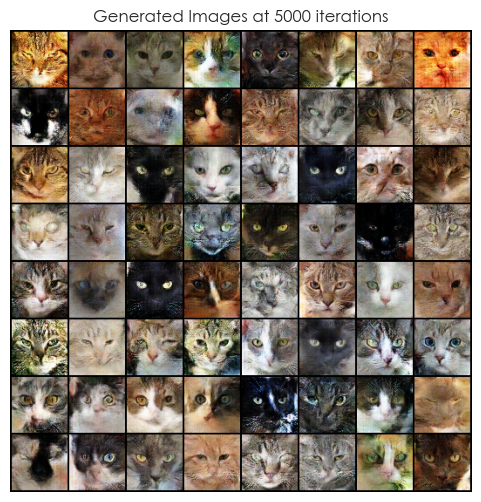

[156/200][10/32] 	Loss_D: -0.2952 | Loss_G: -0.4769 | Iteration Time: 1.3828 sec
[156/200][15/32] 	Loss_D: -0.1316 | Loss_G: -0.1840 | Iteration Time: 1.0904 sec
[156/200][20/32] 	Loss_D: -0.2845 | Loss_G: -0.3242 | Iteration Time: 1.6761 sec
[156/200][25/32] 	Loss_D: -0.2465 | Loss_G: -0.3056 | Iteration Time: 0.9812 sec
[156/200][30/32] 	Loss_D: -0.2788 | Loss_G: -0.3257 | Iteration Time: 1.8059 sec


Training Progress:  78%|███████▊  | 157/200 [1:33:33<34:43, 48.45s/it]

[157/200][0/32] 	Loss_D: -0.2477 | Loss_G: -0.3393 | Iteration Time: 1.5529 sec
[157/200][5/32] 	Loss_D: -0.2686 | Loss_G: -0.3049 | Iteration Time: 1.6438 sec
[157/200][10/32] 	Loss_D: -0.2311 | Loss_G: -0.3934 | Iteration Time: 0.9684 sec
[157/200][15/32] 	Loss_D: -0.2584 | Loss_G: -0.3146 | Iteration Time: 1.7105 sec
[157/200][20/32] 	Loss_D: -0.2753 | Loss_G: -0.3313 | Iteration Time: 1.0633 sec
[157/200][25/32] 	Loss_D: -0.2758 | Loss_G: -0.3609 | Iteration Time: 1.6900 sec
[157/200][30/32] 	Loss_D: -0.2847 | Loss_G: -0.3234 | Iteration Time: 0.9943 sec


Training Progress:  79%|███████▉  | 158/200 [1:34:17<33:02, 47.21s/it]

[158/200][0/32] 	Loss_D: -0.2394 | Loss_G: -0.3913 | Iteration Time: 1.5042 sec
[158/200][5/32] 	Loss_D: -0.2424 | Loss_G: -0.2270 | Iteration Time: 1.5363 sec
[158/200][10/32] 	Loss_D: -0.2472 | Loss_G: -0.3684 | Iteration Time: 1.0127 sec
[158/200][15/32] 	Loss_D: -0.2817 | Loss_G: -0.3335 | Iteration Time: 1.8699 sec
[158/200][20/32] 	Loss_D: -0.2750 | Loss_G: -0.2921 | Iteration Time: 0.9136 sec
[158/200][25/32] 	Loss_D: -0.1570 | Loss_G: -0.2008 | Iteration Time: 1.8533 sec
[158/200][30/32] 	Loss_D: -0.2627 | Loss_G: -0.3499 | Iteration Time: 1.0357 sec


Training Progress:  80%|███████▉  | 159/200 [1:35:02<31:37, 46.28s/it]

[159/200][0/32] 	Loss_D: -0.2369 | Loss_G: -0.3473 | Iteration Time: 1.5653 sec
[159/200][5/32] 	Loss_D: -0.2853 | Loss_G: -0.3809 | Iteration Time: 1.5648 sec
[159/200][10/32] 	Loss_D: -0.2610 | Loss_G: -0.3638 | Iteration Time: 1.0827 sec
[159/200][15/32] 	Loss_D: -0.2559 | Loss_G: -0.3328 | Iteration Time: 1.6737 sec
[159/200][20/32] 	Loss_D: -0.2748 | Loss_G: -0.3667 | Iteration Time: 0.9061 sec
[159/200][25/32] 	Loss_D: -0.2730 | Loss_G: -0.3191 | Iteration Time: 1.7348 sec
[159/200][30/32] 	Loss_D: -0.2651 | Loss_G: -0.3968 | Iteration Time: 1.1917 sec


Training Progress:  80%|████████  | 160/200 [1:35:45<30:16, 45.41s/it]

[160/200][0/32] 	Loss_D: -0.2578 | Loss_G: -0.3393 | Iteration Time: 1.4912 sec
[160/200][5/32] 	Loss_D: -0.1563 | Loss_G: -0.2978 | Iteration Time: 1.7493 sec
[160/200][10/32] 	Loss_D: -0.2796 | Loss_G: -0.2604 | Iteration Time: 1.2243 sec
[160/200][15/32] 	Loss_D: -0.2692 | Loss_G: -0.3351 | Iteration Time: 1.7243 sec
[160/200][20/32] 	Loss_D: -0.2724 | Loss_G: -0.3063 | Iteration Time: 0.9192 sec
[160/200][25/32] 	Loss_D: -0.2595 | Loss_G: -0.3080 | Iteration Time: 1.9469 sec
[160/200][30/32] 	Loss_D: -0.2489 | Loss_G: -0.4501 | Iteration Time: 1.1652 sec


Training Progress:  80%|████████  | 161/200 [1:36:30<29:32, 45.46s/it]

[161/200][0/32] 	Loss_D: -0.2538 | Loss_G: -0.3672 | Iteration Time: 1.6618 sec
[161/200][5/32] 	Loss_D: -0.2529 | Loss_G: -0.3665 | Iteration Time: 1.5497 sec
[161/200][10/32] 	Loss_D: -0.2236 | Loss_G: -0.2105 | Iteration Time: 1.0542 sec
[161/200][15/32] 	Loss_D: -0.2874 | Loss_G: -0.3152 | Iteration Time: 1.8498 sec
[161/200][20/32] 	Loss_D: -0.2822 | Loss_G: -0.3121 | Iteration Time: 0.9142 sec
[161/200][25/32] 	Loss_D: -0.2491 | Loss_G: -0.3881 | Iteration Time: 1.7563 sec
[161/200][30/32] 	Loss_D: -0.2569 | Loss_G: -0.3191 | Iteration Time: 1.0472 sec


Training Progress:  81%|████████  | 162/200 [1:37:16<28:52, 45.60s/it]

[162/200][0/32] 	Loss_D: -0.2362 | Loss_G: -0.3420 | Iteration Time: 1.4918 sec
[162/200][5/32] 	Loss_D: -0.2663 | Loss_G: -0.3423 | Iteration Time: 1.5307 sec
[162/200][10/32] 	Loss_D: -0.2655 | Loss_G: -0.4147 | Iteration Time: 1.0472 sec
[162/200][15/32] 	Loss_D: -0.2553 | Loss_G: -0.3655 | Iteration Time: 1.7918 sec
[162/200][20/32] 	Loss_D: -0.2856 | Loss_G: -0.3616 | Iteration Time: 0.8982 sec
[162/200][25/32] 	Loss_D: -0.2803 | Loss_G: -0.3056 | Iteration Time: 1.7213 sec
[162/200][30/32] 	Loss_D: -0.2597 | Loss_G: -0.3785 | Iteration Time: 1.2147 sec


Training Progress:  82%|████████▏ | 163/200 [1:38:01<27:52, 45.21s/it]

[163/200][0/32] 	Loss_D: -0.2724 | Loss_G: -0.3306 | Iteration Time: 1.7609 sec
[163/200][5/32] 	Loss_D: -0.2894 | Loss_G: -0.3750 | Iteration Time: 1.5563 sec
[163/200][10/32] 	Loss_D: -0.2977 | Loss_G: -0.4526 | Iteration Time: 1.0897 sec
[163/200][15/32] 	Loss_D: -0.2800 | Loss_G: -0.3314 | Iteration Time: 1.6850 sec
[163/200][20/32] 	Loss_D: -0.2672 | Loss_G: -0.2638 | Iteration Time: 0.9094 sec
[163/200][25/32] 	Loss_D: -0.2386 | Loss_G: -0.2038 | Iteration Time: 1.7556 sec
[163/200][30/32] 	Loss_D: -0.2152 | Loss_G: -0.3804 | Iteration Time: 1.0763 sec


Training Progress:  82%|████████▏ | 164/200 [1:38:45<26:58, 44.96s/it]

[164/200][0/32] 	Loss_D: -0.1894 | Loss_G: -0.4375 | Iteration Time: 1.5039 sec
[164/200][5/32] 	Loss_D: -0.2702 | Loss_G: -0.4299 | Iteration Time: 1.6878 sec
[164/200][10/32] 	Loss_D: -0.2851 | Loss_G: -0.3616 | Iteration Time: 1.0587 sec
[164/200][15/32] 	Loss_D: -0.2809 | Loss_G: -0.4985 | Iteration Time: 1.8940 sec
[164/200][20/32] 	Loss_D: -0.2620 | Loss_G: -0.1506 | Iteration Time: 0.8688 sec
[164/200][25/32] 	Loss_D: -0.2778 | Loss_G: -0.3570 | Iteration Time: 1.7551 sec
[164/200][30/32] 	Loss_D: -0.2590 | Loss_G: -0.3270 | Iteration Time: 1.0797 sec


Training Progress:  82%|████████▎ | 165/200 [1:39:30<26:11, 44.91s/it]

[165/200][0/32] 	Loss_D: -0.2853 | Loss_G: -0.3959 | Iteration Time: 1.5968 sec
[165/200][5/32] 	Loss_D: -0.2902 | Loss_G: -0.2875 | Iteration Time: 1.5788 sec
[165/200][10/32] 	Loss_D: -0.2627 | Loss_G: -0.4233 | Iteration Time: 1.0437 sec
[165/200][15/32] 	Loss_D: -0.2678 | Loss_G: -0.2746 | Iteration Time: 1.6893 sec
[165/200][20/32] 	Loss_D: -0.2868 | Loss_G: -0.2767 | Iteration Time: 0.9422 sec
[165/200][25/32] 	Loss_D: -0.2283 | Loss_G: -0.2405 | Iteration Time: 2.0704 sec
[165/200][30/32] 	Loss_D: -0.2686 | Loss_G: -0.3324 | Iteration Time: 1.0257 sec


Training Progress:  83%|████████▎ | 166/200 [1:40:13<25:12, 44.49s/it]

[166/200][0/32] 	Loss_D: -0.2691 | Loss_G: -0.3817 | Iteration Time: 1.4282 sec
[166/200][5/32] 	Loss_D: -0.2324 | Loss_G: -0.3913 | Iteration Time: 1.5157 sec
[166/200][10/32] 	Loss_D: -0.2239 | Loss_G: -0.5188 | Iteration Time: 1.0312 sec
[166/200][15/32] 	Loss_D: -0.1914 | Loss_G: -0.6482 | Iteration Time: 1.8788 sec
[166/200][20/32] 	Loss_D: -0.2477 | Loss_G: -0.4108 | Iteration Time: 0.8876 sec
[166/200][25/32] 	Loss_D: -0.2862 | Loss_G: -0.2781 | Iteration Time: 1.9304 sec
[166/200][30/32] 	Loss_D: -0.1871 | Loss_G: -0.5546 | Iteration Time: 1.0452 sec


Training Progress:  84%|████████▎ | 167/200 [1:40:56<24:08, 43.89s/it]

[167/200][0/32] 	Loss_D: -0.2726 | Loss_G: -0.3839 | Iteration Time: 1.4343 sec
[167/200][5/32] 	Loss_D: -0.2634 | Loss_G: -0.5835 | Iteration Time: 1.7554 sec
[167/200][10/32] 	Loss_D: -0.3051 | Loss_G: -0.3825 | Iteration Time: 1.1112 sec
[167/200][15/32] 	Loss_D: -0.2936 | Loss_G: -0.3237 | Iteration Time: 1.8483 sec
[167/200][20/32] 	Loss_D: -0.2932 | Loss_G: -0.3684 | Iteration Time: 0.8992 sec
[167/200][25/32] 	Loss_D: -0.2689 | Loss_G: -0.3941 | Iteration Time: 1.7410 sec
[167/200][30/32] 	Loss_D: -0.2525 | Loss_G: -0.3449 | Iteration Time: 1.0378 sec


Training Progress:  84%|████████▍ | 168/200 [1:41:40<23:26, 43.95s/it]

[168/200][0/32] 	Loss_D: -0.2607 | Loss_G: -0.3620 | Iteration Time: 1.5225 sec
[168/200][5/32] 	Loss_D: -0.2520 | Loss_G: -0.3300 | Iteration Time: 1.5424 sec
[168/200][10/32] 	Loss_D: -0.2248 | Loss_G: -0.3591 | Iteration Time: 1.0478 sec
[168/200][15/32] 	Loss_D: -0.2653 | Loss_G: -0.3637 | Iteration Time: 1.6975 sec
[168/200][20/32] 	Loss_D: -0.2215 | Loss_G: -0.5466 | Iteration Time: 1.0298 sec
[168/200][25/32] 	Loss_D: -0.2463 | Loss_G: -0.3959 | Iteration Time: 1.7788 sec
[168/200][30/32] 	Loss_D: -0.2833 | Loss_G: -0.3039 | Iteration Time: 1.0312 sec


Training Progress:  84%|████████▍ | 169/200 [1:42:24<22:43, 43.97s/it]

[169/200][0/32] 	Loss_D: -0.2644 | Loss_G: -0.3385 | Iteration Time: 1.4417 sec
[169/200][5/32] 	Loss_D: -0.2304 | Loss_G: -0.2787 | Iteration Time: 1.7188 sec
[169/200][10/32] 	Loss_D: -0.2771 | Loss_G: -0.3371 | Iteration Time: 1.1957 sec
[169/200][15/32] 	Loss_D: -0.2174 | Loss_G: -0.3673 | Iteration Time: 1.6653 sec
[169/200][20/32] 	Loss_D: -0.2677 | Loss_G: -0.4630 | Iteration Time: 1.0722 sec
[169/200][25/32] 	Loss_D: -0.2877 | Loss_G: -0.2902 | Iteration Time: 1.7208 sec
[169/200][30/32] 	Loss_D: -0.2616 | Loss_G: -0.4471 | Iteration Time: 1.0292 sec


Training Progress:  85%|████████▌ | 170/200 [1:43:08<22:04, 44.14s/it]

[170/200][0/32] 	Loss_D: -0.2443 | Loss_G: -0.3567 | Iteration Time: 1.4272 sec
[170/200][5/32] 	Loss_D: -0.2567 | Loss_G: -0.2469 | Iteration Time: 1.5202 sec
[170/200][10/32] 	Loss_D: -0.2656 | Loss_G: -0.3506 | Iteration Time: 1.1777 sec
[170/200][15/32] 	Loss_D: -0.2686 | Loss_G: -0.3653 | Iteration Time: 1.9523 sec
[170/200][20/32] 	Loss_D: -0.2751 | Loss_G: -0.2702 | Iteration Time: 0.9742 sec
[170/200][25/32] 	Loss_D: -0.2777 | Loss_G: -0.2970 | Iteration Time: 1.7153 sec
[170/200][30/32] 	Loss_D: -0.2329 | Loss_G: -0.2886 | Iteration Time: 1.1957 sec


Training Progress:  86%|████████▌ | 171/200 [1:43:52<21:17, 44.05s/it]

[171/200][0/32] 	Loss_D: -0.2326 | Loss_G: -0.3558 | Iteration Time: 1.4863 sec
[171/200][5/32] 	Loss_D: -0.2597 | Loss_G: -0.2944 | Iteration Time: 1.5383 sec
[171/200][10/32] 	Loss_D: -0.1415 | Loss_G: -0.2494 | Iteration Time: 1.0503 sec
[171/200][15/32] 	Loss_D: -0.2809 | Loss_G: -0.3325 | Iteration Time: 1.6627 sec
[171/200][20/32] 	Loss_D: -0.2757 | Loss_G: -0.3352 | Iteration Time: 0.9187 sec
[171/200][25/32] 	Loss_D: -0.2258 | Loss_G: -0.1999 | Iteration Time: 1.7542 sec
Current scores at iteration 5500 | FID: 92.03517150878906 | IS: 2.432176113128662


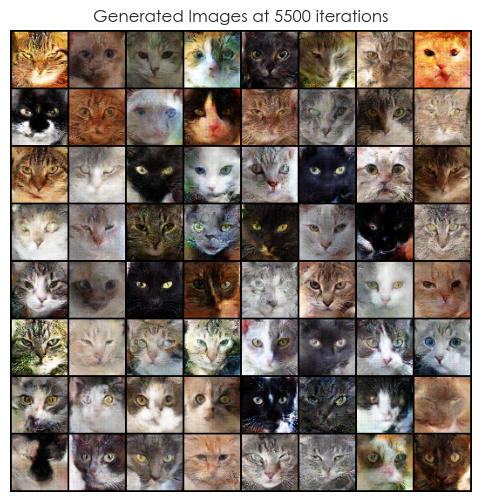

Training Progress:  86%|████████▌ | 172/200 [1:44:40<21:03, 45.14s/it]

[171/200][30/32] 	Loss_D: -0.2366 | Loss_G: -0.2203 | Iteration Time: 0.9416 sec
[172/200][0/32] 	Loss_D: -0.1980 | Loss_G: -0.4199 | Iteration Time: 1.4202 sec
[172/200][5/32] 	Loss_D: -0.2998 | Loss_G: -0.2712 | Iteration Time: 0.8546 sec
[172/200][10/32] 	Loss_D: -0.2774 | Loss_G: -0.3582 | Iteration Time: 1.3137 sec
[172/200][15/32] 	Loss_D: -0.3022 | Loss_G: -0.3292 | Iteration Time: 0.8411 sec
[172/200][20/32] 	Loss_D: -0.2437 | Loss_G: -0.1862 | Iteration Time: 0.8946 sec
[172/200][25/32] 	Loss_D: -0.2534 | Loss_G: -0.5277 | Iteration Time: 0.9147 sec


Training Progress:  86%|████████▋ | 173/200 [1:45:11<18:25, 40.94s/it]

[172/200][30/32] 	Loss_D: -0.2076 | Loss_G: -0.1951 | Iteration Time: 1.1451 sec
[173/200][0/32] 	Loss_D: -0.2789 | Loss_G: -0.3471 | Iteration Time: 1.3827 sec
[173/200][5/32] 	Loss_D: -0.2477 | Loss_G: -0.3551 | Iteration Time: 0.9946 sec
[173/200][10/32] 	Loss_D: -0.2777 | Loss_G: -0.4041 | Iteration Time: 0.8081 sec
[173/200][15/32] 	Loss_D: -0.2802 | Loss_G: -0.3127 | Iteration Time: 0.8686 sec
[173/200][20/32] 	Loss_D: -0.2690 | Loss_G: -0.3734 | Iteration Time: 1.1106 sec
[173/200][25/32] 	Loss_D: -0.2405 | Loss_G: -0.2984 | Iteration Time: 0.9396 sec


Training Progress:  87%|████████▋ | 174/200 [1:45:41<16:14, 37.50s/it]

[173/200][30/32] 	Loss_D: -0.2736 | Loss_G: -0.3411 | Iteration Time: 0.8251 sec
[174/200][0/32] 	Loss_D: -0.2768 | Loss_G: -0.3029 | Iteration Time: 1.3417 sec
[174/200][5/32] 	Loss_D: -0.2736 | Loss_G: -0.2448 | Iteration Time: 0.8146 sec
[174/200][10/32] 	Loss_D: -0.2854 | Loss_G: -0.3259 | Iteration Time: 0.8681 sec
[174/200][15/32] 	Loss_D: -0.3083 | Loss_G: -0.3119 | Iteration Time: 1.1551 sec
[174/200][20/32] 	Loss_D: -0.2028 | Loss_G: -0.5877 | Iteration Time: 0.8471 sec
[174/200][25/32] 	Loss_D: -0.2550 | Loss_G: -0.3866 | Iteration Time: 0.8251 sec


Training Progress:  88%|████████▊ | 175/200 [1:46:11<14:44, 35.39s/it]

[174/200][30/32] 	Loss_D: -0.2704 | Loss_G: -0.3940 | Iteration Time: 0.8896 sec
[175/200][0/32] 	Loss_D: -0.2600 | Loss_G: -0.3390 | Iteration Time: 1.3252 sec
[175/200][5/32] 	Loss_D: -0.2822 | Loss_G: -0.4030 | Iteration Time: 0.8916 sec
[175/200][10/32] 	Loss_D: -0.2710 | Loss_G: -0.3880 | Iteration Time: 0.8921 sec
[175/200][15/32] 	Loss_D: -0.2907 | Loss_G: -0.3183 | Iteration Time: 1.1626 sec
[175/200][20/32] 	Loss_D: -0.2674 | Loss_G: -0.4593 | Iteration Time: 0.8516 sec
[175/200][25/32] 	Loss_D: -0.2922 | Loss_G: -0.4155 | Iteration Time: 0.8601 sec


Training Progress:  88%|████████▊ | 176/200 [1:46:42<13:39, 34.16s/it]

[175/200][30/32] 	Loss_D: -0.2656 | Loss_G: -0.2979 | Iteration Time: 1.0471 sec
[176/200][0/32] 	Loss_D: -0.2682 | Loss_G: -0.2884 | Iteration Time: 1.4912 sec
[176/200][5/32] 	Loss_D: -0.2766 | Loss_G: -0.2673 | Iteration Time: 0.8356 sec
[176/200][10/32] 	Loss_D: -0.2515 | Loss_G: -0.4201 | Iteration Time: 1.0866 sec
[176/200][15/32] 	Loss_D: -0.2918 | Loss_G: -0.4324 | Iteration Time: 1.3027 sec
[176/200][20/32] 	Loss_D: -0.2648 | Loss_G: -0.2438 | Iteration Time: 1.0616 sec
[176/200][25/32] 	Loss_D: -0.2636 | Loss_G: -0.2847 | Iteration Time: 0.9416 sec


Training Progress:  88%|████████▊ | 177/200 [1:47:15<12:56, 33.78s/it]

[176/200][30/32] 	Loss_D: -0.2726 | Loss_G: -0.3086 | Iteration Time: 0.8691 sec
[177/200][0/32] 	Loss_D: -0.2708 | Loss_G: -0.3704 | Iteration Time: 1.3402 sec
[177/200][5/32] 	Loss_D: -0.2075 | Loss_G: -0.2884 | Iteration Time: 0.8111 sec
[177/200][10/32] 	Loss_D: -0.3051 | Loss_G: -0.3390 | Iteration Time: 0.9541 sec
[177/200][15/32] 	Loss_D: -0.2407 | Loss_G: -0.4933 | Iteration Time: 1.3507 sec
[177/200][20/32] 	Loss_D: -0.3053 | Loss_G: -0.2272 | Iteration Time: 1.0651 sec
[177/200][25/32] 	Loss_D: -0.2805 | Loss_G: -0.2274 | Iteration Time: 0.8331 sec


Training Progress:  89%|████████▉ | 178/200 [1:47:47<12:11, 33.26s/it]

[177/200][30/32] 	Loss_D: -0.2716 | Loss_G: -0.3946 | Iteration Time: 0.8851 sec
[178/200][0/32] 	Loss_D: -0.0702 | Loss_G: -0.3027 | Iteration Time: 1.4002 sec
[178/200][5/32] 	Loss_D: -0.2749 | Loss_G: -0.1794 | Iteration Time: 0.9271 sec
[178/200][10/32] 	Loss_D: -0.2697 | Loss_G: -0.3617 | Iteration Time: 1.0081 sec
[178/200][15/32] 	Loss_D: -0.2661 | Loss_G: -0.3333 | Iteration Time: 1.1686 sec
[178/200][20/32] 	Loss_D: -0.2664 | Loss_G: -0.5852 | Iteration Time: 0.9896 sec
[178/200][25/32] 	Loss_D: -0.2545 | Loss_G: -0.4138 | Iteration Time: 1.0131 sec


Training Progress:  90%|████████▉ | 179/200 [1:48:21<11:41, 33.41s/it]

[178/200][30/32] 	Loss_D: -0.2408 | Loss_G: -0.2411 | Iteration Time: 0.9306 sec
[179/200][0/32] 	Loss_D: -0.2829 | Loss_G: -0.2352 | Iteration Time: 1.3891 sec
[179/200][5/32] 	Loss_D: -0.2927 | Loss_G: -0.3268 | Iteration Time: 0.8676 sec
[179/200][10/32] 	Loss_D: -0.2739 | Loss_G: -0.4583 | Iteration Time: 0.9251 sec
[179/200][15/32] 	Loss_D: -0.2954 | Loss_G: -0.2881 | Iteration Time: 1.1866 sec
[179/200][20/32] 	Loss_D: -0.2552 | Loss_G: -0.5153 | Iteration Time: 0.9036 sec
[179/200][25/32] 	Loss_D: -0.2824 | Loss_G: -0.3819 | Iteration Time: 1.0626 sec


Training Progress:  90%|█████████ | 180/200 [1:48:53<11:01, 33.06s/it]

[179/200][30/32] 	Loss_D: -0.2434 | Loss_G: -0.2842 | Iteration Time: 1.0656 sec
[180/200][0/32] 	Loss_D: -0.2704 | Loss_G: -0.3683 | Iteration Time: 1.5817 sec
[180/200][5/32] 	Loss_D: -0.2753 | Loss_G: -0.3401 | Iteration Time: 0.9556 sec
[180/200][10/32] 	Loss_D: -0.2821 | Loss_G: -0.3619 | Iteration Time: 1.0796 sec
[180/200][15/32] 	Loss_D: -0.2389 | Loss_G: -0.3289 | Iteration Time: 1.1486 sec
[180/200][20/32] 	Loss_D: -0.2640 | Loss_G: -0.4058 | Iteration Time: 0.8926 sec
[180/200][25/32] 	Loss_D: -0.2527 | Loss_G: -0.3548 | Iteration Time: 0.8591 sec


Training Progress:  90%|█████████ | 181/200 [1:49:26<10:26, 32.99s/it]

[180/200][30/32] 	Loss_D: -0.2288 | Loss_G: -0.3804 | Iteration Time: 0.8806 sec
[181/200][0/32] 	Loss_D: -0.2959 | Loss_G: -0.3704 | Iteration Time: 1.3003 sec
[181/200][5/32] 	Loss_D: -0.3078 | Loss_G: -0.3204 | Iteration Time: 0.8282 sec
[181/200][10/32] 	Loss_D: -0.2965 | Loss_G: -0.3300 | Iteration Time: 0.8532 sec
[181/200][15/32] 	Loss_D: -0.2750 | Loss_G: -0.3420 | Iteration Time: 1.1022 sec
[181/200][20/32] 	Loss_D: -0.2604 | Loss_G: -0.3515 | Iteration Time: 1.0347 sec
[181/200][25/32] 	Loss_D: -0.2893 | Loss_G: -0.3971 | Iteration Time: 0.8477 sec
[181/200][30/32] 	Loss_D: -0.2669 | Loss_G: -0.5300 | Iteration Time: 1.1268 sec


Training Progress:  91%|█████████ | 182/200 [1:49:59<09:50, 32.83s/it]

[182/200][0/32] 	Loss_D: -0.3062 | Loss_G: -0.3493 | Iteration Time: 1.4623 sec
[182/200][5/32] 	Loss_D: -0.2614 | Loss_G: -0.3779 | Iteration Time: 1.0222 sec
[182/200][10/32] 	Loss_D: -0.0194 | Loss_G: -0.6530 | Iteration Time: 1.0517 sec
[182/200][15/32] 	Loss_D: -0.2754 | Loss_G: -0.3638 | Iteration Time: 1.3422 sec
[182/200][20/32] 	Loss_D: -0.2429 | Loss_G: -0.2768 | Iteration Time: 1.0397 sec
[182/200][25/32] 	Loss_D: -0.2226 | Loss_G: -0.5134 | Iteration Time: 0.9592 sec


Training Progress:  92%|█████████▏| 183/200 [1:50:35<09:36, 33.90s/it]

[182/200][30/32] 	Loss_D: -0.2706 | Loss_G: -0.3889 | Iteration Time: 1.0441 sec
[183/200][0/32] 	Loss_D: -0.2910 | Loss_G: -0.2660 | Iteration Time: 1.6248 sec
[183/200][5/32] 	Loss_D: -0.1008 | Loss_G: -0.6020 | Iteration Time: 0.9972 sec
[183/200][10/32] 	Loss_D: -0.2680 | Loss_G: -0.2240 | Iteration Time: 1.0182 sec
[183/200][15/32] 	Loss_D: -0.1937 | Loss_G: -0.6068 | Iteration Time: 1.1882 sec
[183/200][20/32] 	Loss_D: -0.3016 | Loss_G: -0.4445 | Iteration Time: 1.0552 sec
[183/200][25/32] 	Loss_D: -0.2560 | Loss_G: -0.3334 | Iteration Time: 0.9497 sec


Training Progress:  92%|█████████▏| 184/200 [1:51:10<09:08, 34.28s/it]

[183/200][30/32] 	Loss_D: -0.2739 | Loss_G: -0.2104 | Iteration Time: 1.0197 sec
[184/200][0/32] 	Loss_D: -0.2722 | Loss_G: -0.3396 | Iteration Time: 1.5858 sec
[184/200][5/32] 	Loss_D: -0.2918 | Loss_G: -0.4577 | Iteration Time: 0.9387 sec
[184/200][10/32] 	Loss_D: -0.1527 | Loss_G: -0.6810 | Iteration Time: 1.0282 sec
[184/200][15/32] 	Loss_D: -0.2673 | Loss_G: -0.3012 | Iteration Time: 1.2947 sec
[184/200][20/32] 	Loss_D: -0.2954 | Loss_G: -0.3482 | Iteration Time: 1.0507 sec
[184/200][25/32] 	Loss_D: -0.2594 | Loss_G: -0.3118 | Iteration Time: 0.9051 sec


Training Progress:  92%|█████████▎| 185/200 [1:51:45<08:34, 34.31s/it]

[184/200][30/32] 	Loss_D: -0.2817 | Loss_G: -0.2482 | Iteration Time: 0.9066 sec
[185/200][0/32] 	Loss_D: -0.2762 | Loss_G: -0.3549 | Iteration Time: 1.3822 sec
[185/200][5/32] 	Loss_D: -0.3002 | Loss_G: -0.3437 | Iteration Time: 0.8562 sec
[185/200][10/32] 	Loss_D: -0.2906 | Loss_G: -0.3325 | Iteration Time: 0.8967 sec
[185/200][15/32] 	Loss_D: -0.2615 | Loss_G: -0.3201 | Iteration Time: 1.1502 sec
[185/200][20/32] 	Loss_D: -0.2787 | Loss_G: -0.2003 | Iteration Time: 0.8827 sec
[185/200][25/32] 	Loss_D: -0.2705 | Loss_G: -0.3467 | Iteration Time: 0.8551 sec


Training Progress:  93%|█████████▎| 186/200 [1:52:15<07:44, 33.19s/it]

[185/200][30/32] 	Loss_D: -0.1455 | Loss_G: -0.2630 | Iteration Time: 0.8816 sec
[186/200][0/32] 	Loss_D: -0.2730 | Loss_G: -0.3212 | Iteration Time: 1.3657 sec
[186/200][5/32] 	Loss_D: -0.2831 | Loss_G: -0.3407 | Iteration Time: 0.8471 sec
[186/200][10/32] 	Loss_D: -0.3032 | Loss_G: -0.3571 | Iteration Time: 0.8836 sec
[186/200][15/32] 	Loss_D: -0.2664 | Loss_G: -0.3416 | Iteration Time: 1.1332 sec
[186/200][20/32] 	Loss_D: -0.2936 | Loss_G: -0.3661 | Iteration Time: 0.9056 sec
[186/200][25/32] 	Loss_D: -0.2902 | Loss_G: -0.2914 | Iteration Time: 0.8516 sec


Training Progress:  94%|█████████▎| 187/200 [1:52:46<07:03, 32.57s/it]

[186/200][30/32] 	Loss_D: -0.2826 | Loss_G: -0.2924 | Iteration Time: 1.0232 sec
[187/200][0/32] 	Loss_D: -0.2767 | Loss_G: -0.3043 | Iteration Time: 1.5853 sec
[187/200][5/32] 	Loss_D: -0.2921 | Loss_G: -0.3411 | Iteration Time: 0.9536 sec
[187/200][10/32] 	Loss_D: -0.2694 | Loss_G: -0.3216 | Iteration Time: 1.0257 sec
[187/200][15/32] 	Loss_D: -0.3050 | Loss_G: -0.3373 | Iteration Time: 1.2937 sec
Current scores at iteration 6000 | FID: 82.63716125488281 | IS: 2.360400676727295


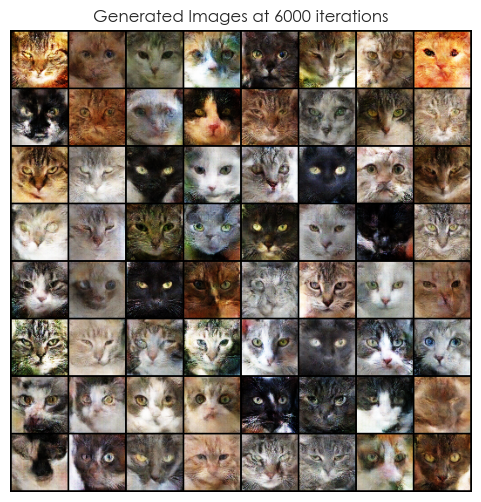

[187/200][20/32] 	Loss_D: -0.2732 | Loss_G: -0.2722 | Iteration Time: 0.6016 sec
[187/200][25/32] 	Loss_D: -0.2812 | Loss_G: -0.2858 | Iteration Time: 1.4188 sec


Training Progress:  94%|█████████▍| 188/200 [1:53:27<06:59, 34.99s/it]

[187/200][30/32] 	Loss_D: -0.3045 | Loss_G: -0.2878 | Iteration Time: 1.2892 sec
[188/200][0/32] 	Loss_D: -0.2345 | Loss_G: -0.3486 | Iteration Time: 0.9492 sec
[188/200][5/32] 	Loss_D: -0.3050 | Loss_G: -0.3768 | Iteration Time: 1.0383 sec
[188/200][10/32] 	Loss_D: -0.2769 | Loss_G: -0.3409 | Iteration Time: 1.1427 sec
[188/200][15/32] 	Loss_D: -0.2990 | Loss_G: -0.2314 | Iteration Time: 1.0912 sec
[188/200][20/32] 	Loss_D: -0.2956 | Loss_G: -0.4641 | Iteration Time: 0.8071 sec
[188/200][25/32] 	Loss_D: -0.3115 | Loss_G: -0.3340 | Iteration Time: 1.0542 sec


Training Progress:  94%|█████████▍| 189/200 [1:53:59<06:14, 34.03s/it]

[188/200][30/32] 	Loss_D: -0.2977 | Loss_G: -0.3407 | Iteration Time: 0.8896 sec
[189/200][0/32] 	Loss_D: -0.2933 | Loss_G: -0.3354 | Iteration Time: 0.8026 sec
[189/200][5/32] 	Loss_D: -0.2409 | Loss_G: -0.5460 | Iteration Time: 1.1572 sec
[189/200][10/32] 	Loss_D: -0.2741 | Loss_G: -0.3450 | Iteration Time: 1.1907 sec
[189/200][15/32] 	Loss_D: -0.2351 | Loss_G: -0.6139 | Iteration Time: 0.9862 sec
[189/200][20/32] 	Loss_D: -0.2890 | Loss_G: -0.3767 | Iteration Time: 0.8802 sec
[189/200][25/32] 	Loss_D: -0.2415 | Loss_G: -0.2095 | Iteration Time: 1.0587 sec


Training Progress:  95%|█████████▌| 190/200 [1:54:31<05:34, 33.44s/it]

[189/200][30/32] 	Loss_D: -0.2693 | Loss_G: -0.3194 | Iteration Time: 0.9177 sec
[190/200][0/32] 	Loss_D: -0.3097 | Loss_G: -0.3245 | Iteration Time: 0.8097 sec
[190/200][5/32] 	Loss_D: -0.1781 | Loss_G: -0.3125 | Iteration Time: 1.2552 sec
[190/200][10/32] 	Loss_D: -0.2815 | Loss_G: -0.2099 | Iteration Time: 1.1307 sec
[190/200][15/32] 	Loss_D: -0.2838 | Loss_G: -0.2868 | Iteration Time: 0.9672 sec
[190/200][20/32] 	Loss_D: -0.2466 | Loss_G: -0.4390 | Iteration Time: 0.8436 sec
[190/200][25/32] 	Loss_D: -0.2829 | Loss_G: -0.3624 | Iteration Time: 1.0962 sec


Training Progress:  96%|█████████▌| 191/200 [1:55:03<04:58, 33.20s/it]

[190/200][30/32] 	Loss_D: -0.2700 | Loss_G: -0.2242 | Iteration Time: 1.0257 sec
[191/200][0/32] 	Loss_D: -0.2738 | Loss_G: -0.3552 | Iteration Time: 0.8672 sec
[191/200][5/32] 	Loss_D: -0.2734 | Loss_G: -0.3648 | Iteration Time: 1.0572 sec
[191/200][10/32] 	Loss_D: -0.3192 | Loss_G: -0.3272 | Iteration Time: 1.2582 sec
[191/200][15/32] 	Loss_D: -0.2732 | Loss_G: -0.3626 | Iteration Time: 0.9776 sec
[191/200][20/32] 	Loss_D: -0.2669 | Loss_G: -0.3933 | Iteration Time: 0.8577 sec
[191/200][25/32] 	Loss_D: -0.2988 | Loss_G: -0.3101 | Iteration Time: 1.0562 sec


Training Progress:  96%|█████████▌| 192/200 [1:55:35<04:22, 32.78s/it]

[191/200][30/32] 	Loss_D: -0.2695 | Loss_G: -0.2766 | Iteration Time: 0.9537 sec
[192/200][0/32] 	Loss_D: -0.2899 | Loss_G: -0.3349 | Iteration Time: 0.8457 sec
[192/200][5/32] 	Loss_D: -0.2879 | Loss_G: -0.4499 | Iteration Time: 1.0532 sec
[192/200][10/32] 	Loss_D: -0.2712 | Loss_G: -0.3666 | Iteration Time: 1.1262 sec
[192/200][15/32] 	Loss_D: -0.2970 | Loss_G: -0.4423 | Iteration Time: 1.0307 sec
[192/200][20/32] 	Loss_D: -0.3211 | Loss_G: -0.3186 | Iteration Time: 0.8632 sec
[192/200][25/32] 	Loss_D: -0.2718 | Loss_G: -0.4757 | Iteration Time: 1.1087 sec


Training Progress:  96%|█████████▋| 193/200 [1:56:07<03:47, 32.54s/it]

[192/200][30/32] 	Loss_D: -0.2712 | Loss_G: -0.2423 | Iteration Time: 0.9251 sec
[193/200][0/32] 	Loss_D: -0.2992 | Loss_G: -0.3579 | Iteration Time: 0.9387 sec
[193/200][5/32] 	Loss_D: -0.2862 | Loss_G: -0.4109 | Iteration Time: 1.1072 sec
[193/200][10/32] 	Loss_D: -0.2532 | Loss_G: -0.2449 | Iteration Time: 1.1447 sec
[193/200][15/32] 	Loss_D: -0.3004 | Loss_G: -0.2118 | Iteration Time: 0.9927 sec
[193/200][20/32] 	Loss_D: -0.1145 | Loss_G: -0.3189 | Iteration Time: 0.8447 sec
[193/200][25/32] 	Loss_D: -0.2787 | Loss_G: -0.2107 | Iteration Time: 1.1322 sec


Training Progress:  97%|█████████▋| 194/200 [1:56:39<03:13, 32.30s/it]

[193/200][30/32] 	Loss_D: -0.2876 | Loss_G: -0.3190 | Iteration Time: 0.9067 sec
[194/200][0/32] 	Loss_D: -0.2964 | Loss_G: -0.3425 | Iteration Time: 0.8082 sec
[194/200][5/32] 	Loss_D: -0.2920 | Loss_G: -0.3495 | Iteration Time: 1.0352 sec
[194/200][10/32] 	Loss_D: -0.2258 | Loss_G: -0.2413 | Iteration Time: 1.1212 sec
[194/200][15/32] 	Loss_D: -0.2837 | Loss_G: -0.3945 | Iteration Time: 0.9962 sec
[194/200][20/32] 	Loss_D: -0.2887 | Loss_G: -0.3047 | Iteration Time: 0.8336 sec
[194/200][25/32] 	Loss_D: -0.2900 | Loss_G: -0.3829 | Iteration Time: 1.1362 sec


Training Progress:  98%|█████████▊| 195/200 [1:57:10<02:39, 31.99s/it]

[194/200][30/32] 	Loss_D: -0.2817 | Loss_G: -0.2044 | Iteration Time: 0.8887 sec
[195/200][0/32] 	Loss_D: -0.2527 | Loss_G: -0.3680 | Iteration Time: 0.8177 sec
[195/200][5/32] 	Loss_D: -0.2761 | Loss_G: -0.3678 | Iteration Time: 1.0377 sec
[195/200][10/32] 	Loss_D: -0.3027 | Loss_G: -0.3723 | Iteration Time: 1.1072 sec
[195/200][15/32] 	Loss_D: -0.2872 | Loss_G: -0.3055 | Iteration Time: 0.9822 sec
[195/200][20/32] 	Loss_D: -0.3197 | Loss_G: -0.3104 | Iteration Time: 0.8591 sec
[195/200][25/32] 	Loss_D: -0.2649 | Loss_G: -0.3898 | Iteration Time: 1.1332 sec


Training Progress:  98%|█████████▊| 196/200 [1:57:42<02:07, 31.92s/it]

[195/200][30/32] 	Loss_D: -0.2691 | Loss_G: -0.3877 | Iteration Time: 0.8947 sec
[196/200][0/32] 	Loss_D: -0.2818 | Loss_G: -0.3438 | Iteration Time: 0.8352 sec
[196/200][5/32] 	Loss_D: -0.2843 | Loss_G: -0.2056 | Iteration Time: 1.0642 sec
[196/200][10/32] 	Loss_D: -0.3241 | Loss_G: -0.4841 | Iteration Time: 1.1367 sec
[196/200][15/32] 	Loss_D: -0.2789 | Loss_G: -0.3484 | Iteration Time: 0.9742 sec
[196/200][20/32] 	Loss_D: -0.2625 | Loss_G: -0.3533 | Iteration Time: 0.9717 sec
[196/200][25/32] 	Loss_D: -0.2792 | Loss_G: -0.3379 | Iteration Time: 1.0742 sec


Training Progress:  98%|█████████▊| 197/200 [1:58:14<01:35, 31.82s/it]

[196/200][30/32] 	Loss_D: -0.2602 | Loss_G: -0.3318 | Iteration Time: 0.9262 sec
[197/200][0/32] 	Loss_D: -0.2810 | Loss_G: -0.3488 | Iteration Time: 0.9897 sec
[197/200][5/32] 	Loss_D: -0.2498 | Loss_G: -0.4733 | Iteration Time: 1.1272 sec
[197/200][10/32] 	Loss_D: -0.2906 | Loss_G: -0.3831 | Iteration Time: 1.1642 sec
[197/200][15/32] 	Loss_D: -0.2061 | Loss_G: -0.2257 | Iteration Time: 0.9847 sec
[197/200][20/32] 	Loss_D: -0.2546 | Loss_G: -0.3266 | Iteration Time: 0.8221 sec
[197/200][25/32] 	Loss_D: -0.2928 | Loss_G: -0.2973 | Iteration Time: 1.0722 sec


Training Progress:  99%|█████████▉| 198/200 [1:58:45<01:03, 31.80s/it]

[197/200][30/32] 	Loss_D: -0.2306 | Loss_G: -0.3055 | Iteration Time: 0.9286 sec
[198/200][0/32] 	Loss_D: -0.2824 | Loss_G: -0.2960 | Iteration Time: 0.8457 sec
[198/200][5/32] 	Loss_D: -0.2997 | Loss_G: -0.3170 | Iteration Time: 1.0507 sec
[198/200][10/32] 	Loss_D: -0.2745 | Loss_G: -0.3119 | Iteration Time: 1.1607 sec
[198/200][15/32] 	Loss_D: -0.2646 | Loss_G: -0.3531 | Iteration Time: 1.0017 sec
[198/200][20/32] 	Loss_D: -0.1958 | Loss_G: -0.2574 | Iteration Time: 0.8176 sec
[198/200][25/32] 	Loss_D: -0.2650 | Loss_G: -0.2720 | Iteration Time: 1.0672 sec


Training Progress: 100%|█████████▉| 199/200 [1:59:16<00:31, 31.62s/it]

[198/200][30/32] 	Loss_D: -0.1730 | Loss_G: -0.4902 | Iteration Time: 0.8922 sec
[199/200][0/32] 	Loss_D: -0.2714 | Loss_G: -0.3228 | Iteration Time: 0.8147 sec
[199/200][5/32] 	Loss_D: -0.2766 | Loss_G: -0.3242 | Iteration Time: 1.0668 sec
[199/200][10/32] 	Loss_D: -0.2983 | Loss_G: -0.3973 | Iteration Time: 1.1232 sec
[199/200][15/32] 	Loss_D: -0.2946 | Loss_G: -0.2840 | Iteration Time: 1.0062 sec
[199/200][20/32] 	Loss_D: -0.2785 | Loss_G: -0.3239 | Iteration Time: 0.8071 sec
[199/200][25/32] 	Loss_D: -0.2821 | Loss_G: -0.3296 | Iteration Time: 1.0602 sec
[199/200][30/32] 	Loss_D: -0.2994 | Loss_G: -0.3301 | Iteration Time: 1.0032 sec
Current scores at iteration 6399 | FID: 140.8679656982422 | IS: 1.508641242980957


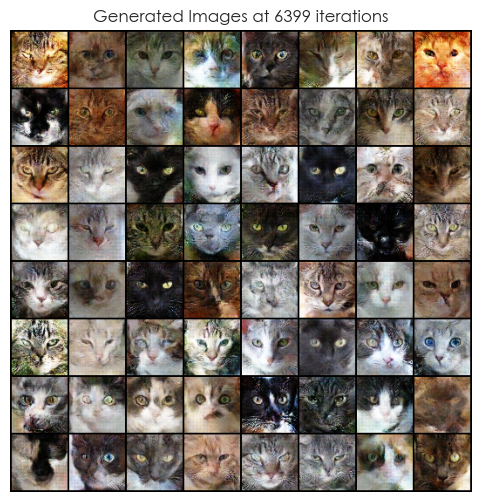

Training Progress: 100%|██████████| 200/200 [1:59:52<00:00, 35.96s/it]


In [72]:
wgangp_trainer = WGANGPTrainer(critic, netG, cat_dataloader, device, fixed_noise, real_label, fake_label, nz, optimizerC, optimizerG, EPOCHS, CRITIC_ITERATIONS, lambda_gp)
wgangp_trainer.train()

#### LOSS PLOT

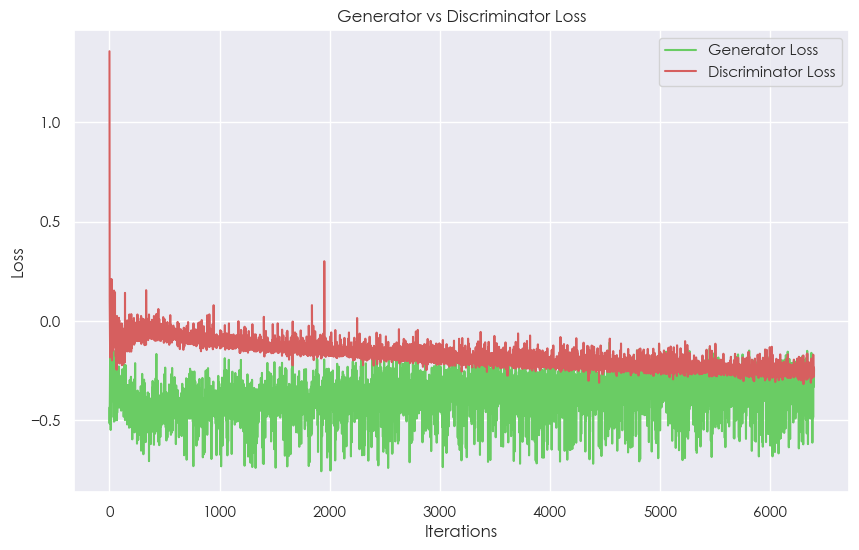

In [83]:
wgangp_trainer.plot_loss()

#### SCORE PLOT

Minimum FID Score of 74.44414520263672 obtained at iteration of 3500.
Maximum IS Score of 2.5484938621520996.


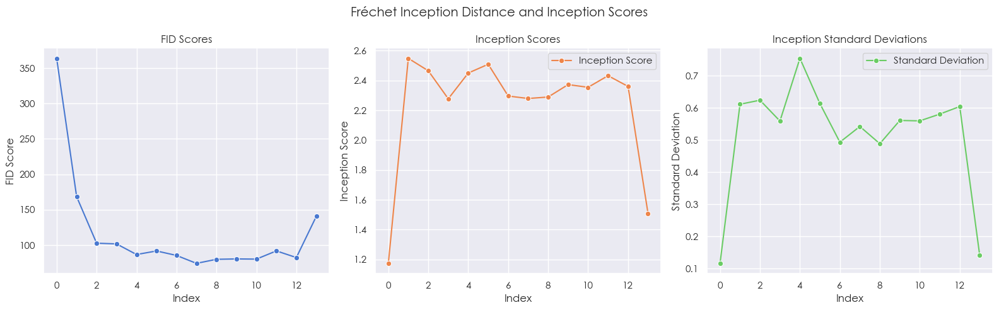

In [84]:
wgangp_trainer.plot_scores()

### EVALUATE BEST WEIGHTS

#### LOAD BEST MODELS

##### WGAN

In [85]:
# File directory
directory = 'wgan_weights/'
# Get file names
files = os.listdir(directory)
# Get generator files with their iteration number
generator_files = [(file, int(re.search(r'generator-(\d+)', file).group(1)))
                   for file in files if re.match(r'generator-\d+', file)]
# Sort descending by iteration number as highest number will be best weight
generator_files.sort(key=lambda x: x[1], reverse=True)
# Grab best weights file
if generator_files:
    best_weights = generator_files[0][0]
    print(f"The file with the best weights is: {best_weights}")
else:
    print("No files found.")
# Load best weights
best_wgan = torch.load(directory + best_weights)
summary(best_wgan,verbose=0,device=device)

The file with the best weights is: generator-6000.pth


Layer (type:depth-idx)                   Param #
├─Sequential: 1-1                        --
|    └─Sequential: 2-1                   --
|    |    └─ConvTranspose2d: 3-1         1,638,400
|    |    └─BatchNorm2d: 3-2             2,048
|    |    └─LeakyReLU: 3-3               --
|    └─Sequential: 2-2                   --
|    |    └─ConvTranspose2d: 3-4         8,388,608
|    |    └─BatchNorm2d: 3-5             1,024
|    |    └─LeakyReLU: 3-6               --
|    └─Sequential: 2-3                   --
|    |    └─ConvTranspose2d: 3-7         2,097,152
|    |    └─BatchNorm2d: 3-8             512
|    |    └─LeakyReLU: 3-9               --
|    └─Sequential: 2-4                   --
|    |    └─ConvTranspose2d: 3-10        524,288
|    |    └─BatchNorm2d: 3-11            256
|    |    └─LeakyReLU: 3-12              --
|    └─ConvTranspose2d: 2-5              6,144
|    └─Tanh: 2-6                         --
Total params: 12,658,432
Trainable params: 12,658,432
Non-trainable params: 0

##### WGAN-GP

In [86]:
# File directory
directory = 'wgan-gp_weights/'
# Get file names
files = os.listdir(directory)
# Get generator files with their iteration number
generator_files = [(file, int(re.search(r'generator-(\d+)', file).group(1)))
                   for file in files if re.match(r'generator-\d+', file)]
# Sort descending by iteration number as highest number will be best weight
generator_files.sort(key=lambda x: x[1], reverse=True)
# Grab best weights file
if generator_files:
    best_weights = generator_files[0][0]
    print(f"The file with the best weights is: {best_weights}")
else:
    print("No files found.")
# Load best weights
best_wgangp = torch.load(directory + best_weights)
summary(best_wgangp,verbose=0,device=device)

The file with the best weights is: generator-3500.pth


Layer (type:depth-idx)                   Param #
├─Sequential: 1-1                        --
|    └─Sequential: 2-1                   --
|    |    └─ConvTranspose2d: 3-1         819,200
|    |    └─BatchNorm2d: 3-2             1,024
|    |    └─LeakyReLU: 3-3               --
|    └─Sequential: 2-2                   --
|    |    └─ConvTranspose2d: 3-4         2,097,152
|    |    └─BatchNorm2d: 3-5             512
|    |    └─LeakyReLU: 3-6               --
|    └─Sequential: 2-3                   --
|    |    └─ConvTranspose2d: 3-7         524,288
|    |    └─BatchNorm2d: 3-8             256
|    |    └─LeakyReLU: 3-9               --
|    └─Sequential: 2-4                   --
|    |    └─ConvTranspose2d: 3-10        131,072
|    |    └─BatchNorm2d: 3-11            128
|    |    └─LeakyReLU: 3-12              --
|    └─ConvTranspose2d: 2-5              3,072
|    └─Tanh: 2-6                         --
Total params: 3,576,704
Trainable params: 3,576,704
Non-trainable params: 0

#### EVALUATE QUANTITATIVE METRICS

In [87]:

# Evaluation Metric Calculation Function
def calculate_metrics(fake, real, model_name, device='cpu'):
    # Instantiate Metrics Calculation Functions from Torchmetrics
    fid = FrechetInceptionDistance(feature=2048, normalize=True).to(device)
    inception = InceptionScore(normalize=True).to(device)

    # Move the real and fake images to CPU
    real = real.to(device)
    fake = fake.to(device)

    # FID Score calculation
    real_images_norm = GANMonitor.transform(real)
    fid.update(real_images_norm, real=True)
    fake_images_norm = GANMonitor.transform(fake)
    fid.update(fake_images_norm, real=False)
    fid_score = fid.compute().detach()

    # Inception Score calculation
    norm_imgs = GANMonitor.transform(fake.to(device))
    scaled_imgs = (norm_imgs * 255).clamp(0, 255).to(torch.uint8)
    inception.update(scaled_imgs)
    inception_score, _ = inception.compute()
    inception_score = inception_score.detach()

    # Compile the results into a DataFrame
    results_df = pd.DataFrame({
        'FID Score': [fid_score.item()],
        'Inception Score': [inception_score.item()]
    })
    results_df.rename(index={0: model_name}, inplace=True)

    # Return DataFrame
    return results_df

WGAN

In [88]:
# Fixed noise (latent vectors)
fixed_noise = torch.randn(1000, nz, 1, 1, device=device)
# Generate images
generated_images = best_wgan(fixed_noise)
# Calculate metrics compared to test images
calculate_metrics(fake=generated_images, real=images[:1000], model_name='WGAN')

,FID Score,Inception Score
WGAN,97.612839,3.647007


WGAN-GP

In [89]:
# Fixed noise (latent vectors)
fixed_noise = torch.randn(1000, nz, 1, 1, device=device)
# Generate images
generated_images = best_wgangp(fixed_noise)
# Calculate metrics compared to test images
calculate_metrics(fake=generated_images, real=images[:1000],model_name='WGAN-GP')

,FID Score,Inception Score
WGAN-GP,46.479527,3.593866


#### EVALUATE IMAGES GENERATED

In [90]:
def generate_and_plot_single_image(best_gen, images_per_plot=64, batch_size=8, model_name="model"):
    plt.figure(figsize=(8, 8))  # Adjust figure size if needed
    image_count = 0
    while image_count < images_per_plot:
        fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)  # Ensure nz and device are defined elsewhere
        batch_images = best_gen(fixed_noise)
        size = batch_images.size(0)
        batch_images = normalize_images(batch_images)
        for i in range(size):
            if image_count >= images_per_plot:
                break
            img = batch_images[i]
            img_np = np.transpose(img.cpu().detach().numpy().clip(0, 1), (1, 2, 0))
            plt.subplot(8, 8, image_count + 1)  # Changed to 8x8 grid
            plt.imshow(img_np)
            plt.axis('off')
            image_count += 1
    plt.tight_layout()
    plt.savefig(f'./images/{model_name}_image_plot.png')
    plt.show()

WGAN

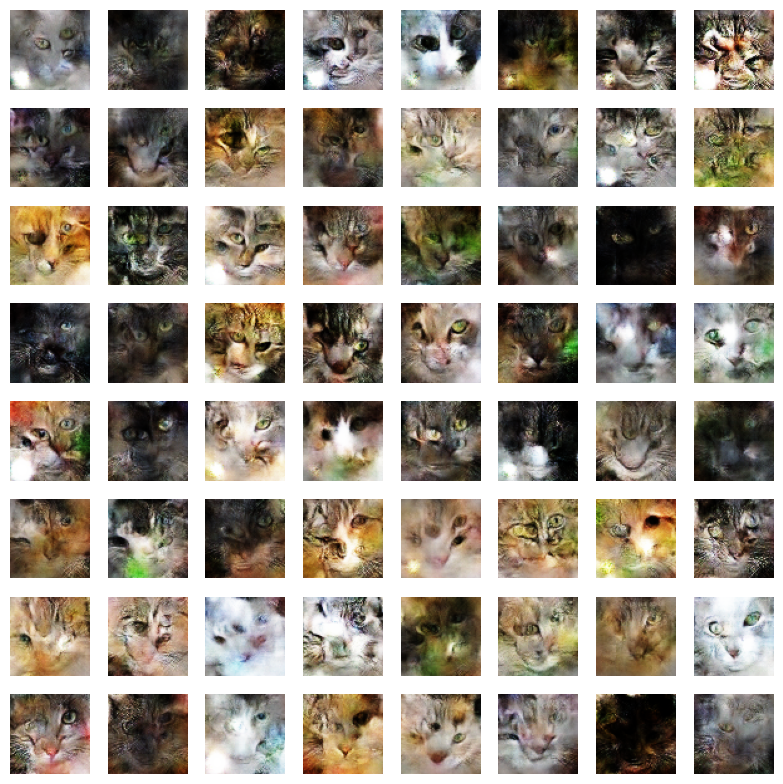

In [91]:
generate_and_plot_single_image(best_wgan, model_name='WGAN')

WGAN-GP

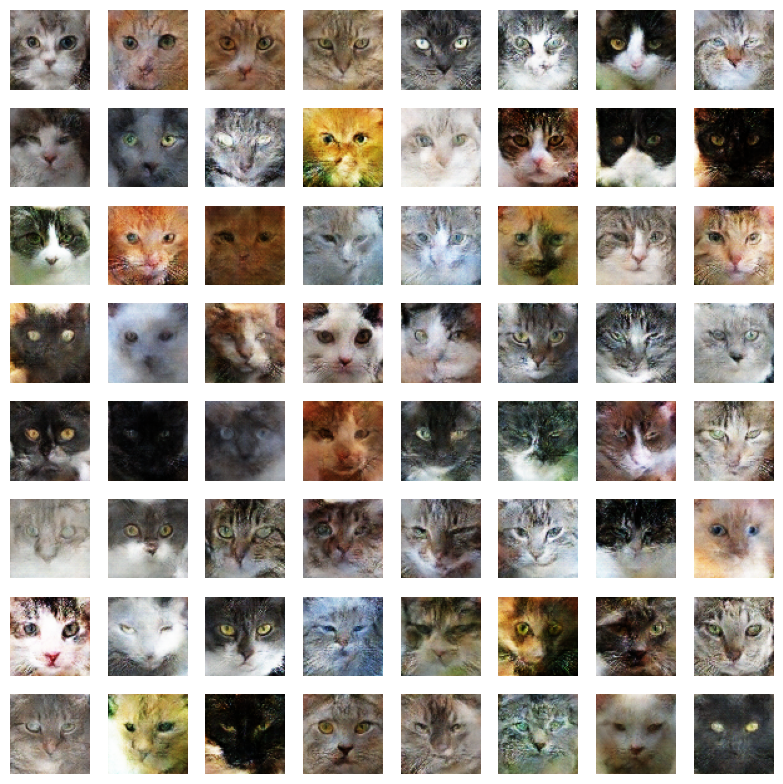

In [92]:
generate_and_plot_single_image(best_wgangp, model_name='WGAN-GP')